!pip install simpleitk
!pip install numpy
!pip install pynrrd
!pip install opencv-python

In [1]:
import matplotlib.pyplot as plt
import numpy as np
import SimpleITK as sitk
import os as os
import nrrd as reader
import pandas as pd
import cv2 
import csv
from tqdm import tqdm
from tabulate import tabulate
from skimage import morphology
from skimage import measure
from skimage import segmentation
from skimage.segmentation import flood, flood_fill
from skimage.measure import label
from skimage.segmentation import active_contour
from skimage import data, io, img_as_ubyte,filters
from time import sleep
from IPython.display import clear_output

# #CODE SEC --------------------------------------------------

In [397]:
#       // PATIENT DCM // MSK SEG NRRD // DCM NORMALIZATION // IMG PROCESSOR // FLE PROCESSOR

In [3]:
def join(one, two):
    return os.path.join(one, two)

def check_path(path):
    count=0
    for files in sorted(os.listdir(path)):
        image_path = os.path.join(path,files)
        count+=1
    return count

num_patients = int(check_path(join(os.getcwd(), "dataset")))
folder_path=join(os.getcwd(), "dataset")

for patient in sorted(os.listdir(folder_path)):
    patient_path = join(folder_path, patient)
    InputImage=sitk.ReadImage(sitk.ImageSeriesReader_GetGDCMSeriesFileNames(patient_path)) 
    inputs = np.empty((num_patients * InputImage.GetSize()[2], int(InputImage.GetSize()[0]/2), int(InputImage.GetSize()[1]), 1))
    sortedpatients= sorted(os.listdir(folder_path))
    
slicesperpatient=InputImage.GetSize()[2]
totalslices=(num_patients * InputImage.GetSize()[2])
slicesperpatient=InputImage.GetSize()[2]

In [4]:
def dcm_to_np(path):
    global dic_count
    try:
        slice_filenames = sitk.ImageSeriesReader_GetGDCMSeriesFileNames(path)
        image = sitk.ReadImage(slice_filenames)
        for x in range(slicesperpatient):
            current_slice = image[:, :, x]
            current_array = sitk.GetArrayFromImage(current_slice)
            split_array = current_array[:,:-256]
            inputs[dic_count] = split_array[:, :, np.newaxis]
            dic_count+=1
        print(f'{patient} {R}/{num_patients}')
    except Exception as e:
        print(e)

def nrrd_to_np(meta_object,outputs):
    global ann_count
    try:
        data = sitk.GetArrayFromImage(meta_object)
        for p in range(slicesperpatient):
            current_seg = data[p, :, :]
            half_seg= current_seg[:,:-256]
            black = np.zeros([256, 256, 9])
            for y, a in enumerate(half_seg):
                for x, b in enumerate(a):
                    if b>0:
                        black[y][x][b-1] = 1
            outputs[ann_count] = black
            ann_count+=1
        print("Segmentation Imported")
    except Exception as e:
        print(e)

def fle_to_np(meta_object,outputs):
    global fle_count
    try:
        data = sitk.GetArrayFromImage(meta_object)
        for p in range(slicesperpatient):
            outputs[fle_count] = np.expand_dims(np.where(data[p, :, :256] == 1, 1, 0), axis=2)
            fle_count+=1
        print('FLE IMPORTED')        
    except Exception as e:
        print(e)

mskoutputs = np.empty((num_patients * InputImage.GetSize()[2], int(InputImage.GetSize()[0]/2), int(InputImage.GetSize()[1]), 9))
fleoutputs=np.empty((num_patients * InputImage.GetSize()[2], int(InputImage.GetSize()[0]/2), int(InputImage.GetSize()[1]), 1))
fle_count = 0
dic_count = 0
ann_count = 0
R=1
try:
    for patient in sorted(os.listdir(folder_path)):
        clear_output(wait=True)
        patient_path = join(folder_path, patient)
        nrrd_folder = join(patient_path, "NRRD")
        dcm_to_np(patient_path)
        for nrrd in os.listdir(nrrd_folder):
            if(".nrrd" in nrrd):
                segmentation = sitk.ReadImage(join(nrrd_folder, nrrd))
                nrrd_to_np(segmentation,mskoutputs)
        fle_folder = join(patient_path, "FLE")
        for fle in os.listdir(fle_folder):
            if(".nrrd" in fle):
                flesegmentation = sitk.ReadImage(join(fle_folder, fle))
                fle_to_np(flesegmentation,fleoutputs)
        R+=1
except Exception as e:
    print(e)

9458237 134/134
Segmentation Imported
FLE IMPORTED


In [7]:
#functions for inhomogeneity correction 
def correct_roi(image):
    inputImage=sitk.GetImageFromArray(image)
    inputImage = sitk.Cast(inputImage, sitk.sitkFloat32 )
    corrector = sitk.N4BiasFieldCorrectionImageFilter()
    output = corrector.Execute( inputImage)
    image_c= sitk.GetArrayFromImage(output)
    image_c=cv2.normalize(src=image_c, dst=None, alpha=0.0, beta=255.0, norm_type=cv2.NORM_MINMAX, dtype=cv2.CV_8U) #need to normalize, not direct conversion by "np.uint8"
    return image_c

def npnormalization (inputimage):
    for x in range (totalslices): #NumPy Normalization  
        clear_output(wait=True)
        temp = inputimage[x].reshape(256, 256)
        temp1= correct_roi(temp)
        np.linalg.norm(temp1)
        inputs[x]=temp1[:, :, np.newaxis]
        print(f'{x+1}/{totalslices} Slices |{round((x/totalslices)*100)}%|')
    print(f'Normalization Complete')
    return inputs

ImportedArray = np.empty((num_patients * InputImage.GetSize()[2], int(InputImage.GetSize()[0]/2), int(InputImage.GetSize()[1]), 1))
ImportedArray = npnormalization (inputs)

2010/2010 Slices |100%|
Normalization Complete


Processing DICOMs with Imported Segmentations... Please Wait...
Pre Process-------------------------------------------


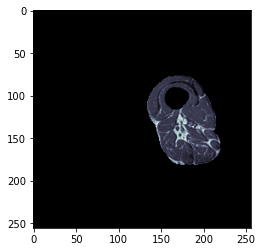

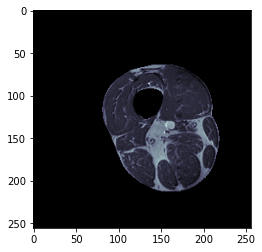

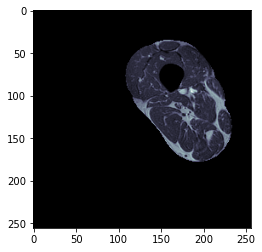

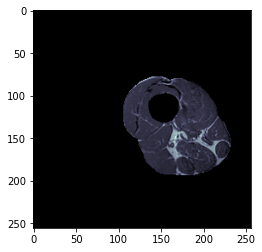

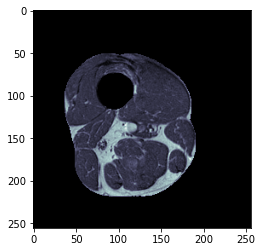

...

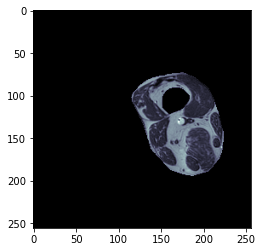

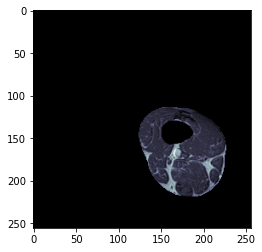

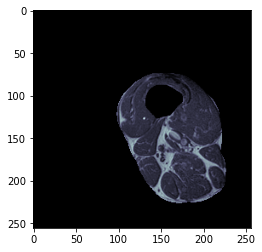

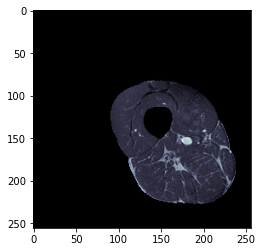

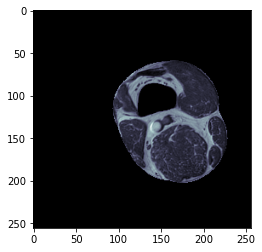

Post Process-------------------------------------------


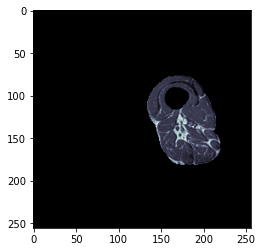

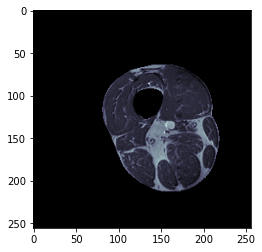

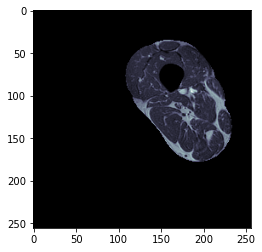

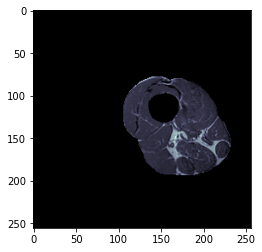

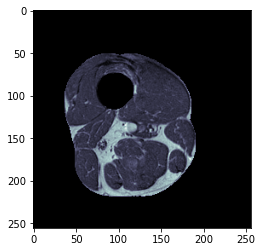

...

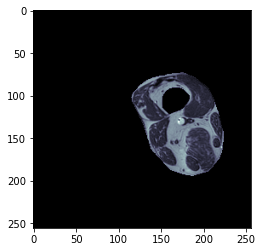

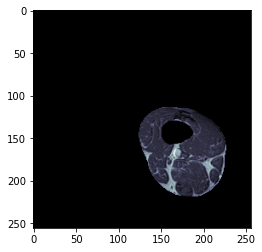

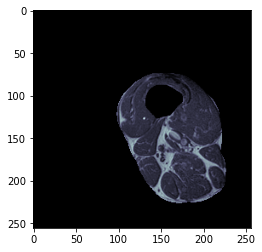

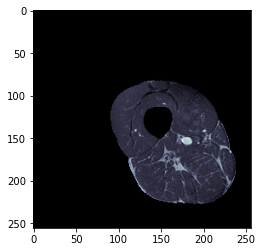

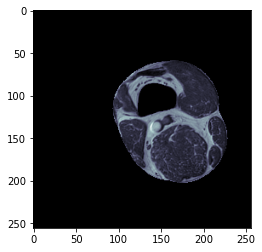

In [14]:
def imageprocessor(Array,Image,Segmentations,FLESegmentations):
    print("Processing DICOMs with Imported Segmentations... Please Wait...")
    imageI = Array[:, :, :, 0] #Inputs Variable 
    ArrayI = np.empty((num_patients * Image.GetSize()[2], int(Image.GetSize()[0]/2), int(Image.GetSize()[1]), 1))
    mskROI = np.empty((num_patients * Image.GetSize()[2], int(Image.GetSize()[0]/2), int(Image.GetSize()[1]), 1))
    fleoutputsI = np.empty((num_patients * InputImage.GetSize()[2], int(InputImage.GetSize()[0]/2), int(InputImage.GetSize()[1]), 1))
    boneremoval = np.empty((num_patients * InputImage.GetSize()[2], int(InputImage.GetSize()[0]/2), int(InputImage.GetSize()[1]), 1))
    for x in range (totalslices): 
        for i in range (9):
            if i !=2:
                ArrayI[x,:,:,0]+=Segmentations[x,:,:,i] #Merged MSK Mask
    FArrayI = FLESegmentations[:,:,:,0]
    boneremoval = Segmentations[:,:,:,2]
    ArrayII = ArrayI[:, :, :, 0] # Get rid of [:,:,:,1]
    INVArrayI = 1 - FArrayI #Invered Mask
    INVArrayII = INVArrayI * imageI #Mask multipled with array
    INVArrayIII = np.where(INVArrayII > (10), 1, 0)
    FArrayII = INVArrayIII + FArrayI #Add both the merged msk and inv msk together
    
    print("Pre Process-------------------------------------------")
    for i in range (0,totalslices,slicesperpatient):
        plt.imshow(imageI[i],cmap=plt.cm.bone,vmin=0,vmax=255)
        plt.show()
        
    FinalArray = FArrayII * imageI #Multiply new mask with original image
    mskROI = imageI * ArrayII
    fleROI = imageI * (FArrayI-boneremoval)
    print("Post Process-------------------------------------------")
    for i in range (0,totalslices,slicesperpatient):
        plt.imshow(FinalArray[i],cmap=plt.cm.bone,vmin=0,vmax=255)
        plt.show()
        
    return FinalArray,mskROI,fleROI,ArrayII

thigharray=np.empty((num_patients * InputImage.GetSize()[2], int(InputImage.GetSize()[0]/2), int(InputImage.GetSize()[1])))
ROI_MSK=np.empty((num_patients * InputImage.GetSize()[2], int(InputImage.GetSize()[0]/2), int(InputImage.GetSize()[1])))
ROI_FLE=np.empty((num_patients * InputImage.GetSize()[2], int(InputImage.GetSize()[0]/2), int(InputImage.GetSize()[1])))
OG_VOL=np.empty((num_patients * InputImage.GetSize()[2], int(InputImage.GetSize()[0]/2), int(InputImage.GetSize()[1])))
thigharray,ROI_MSK,ROI_FLE,OG_VOL=imageprocessor(ImportedArray,InputImage,mskoutputs,fleoutputs)


(-0.5, 255.5, 255.5, -0.5)

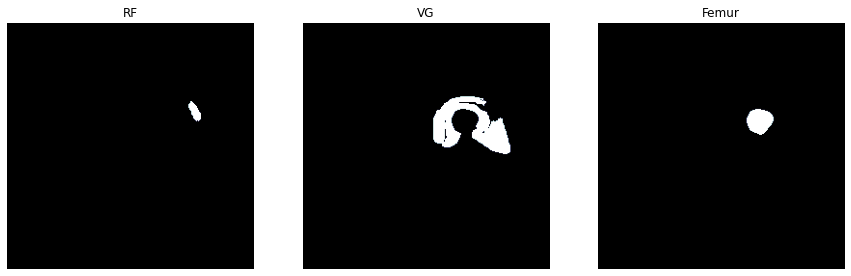

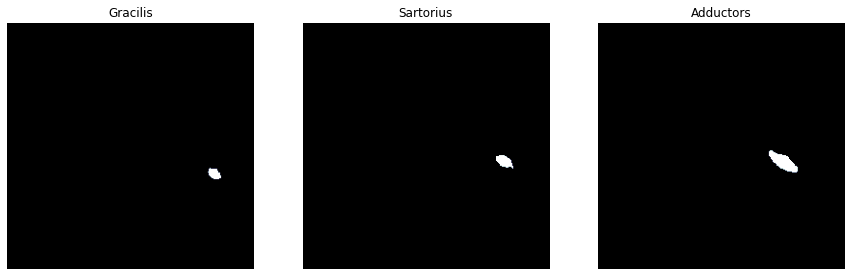

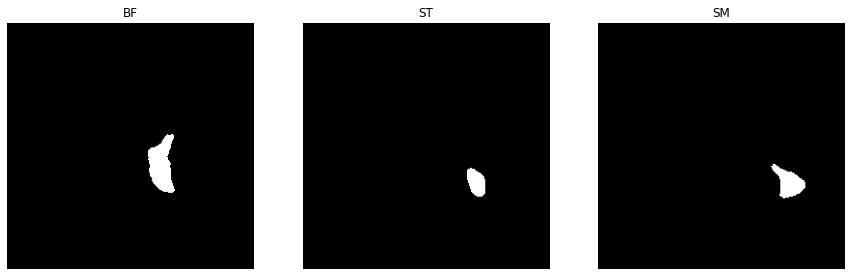

In [9]:
fig, axs=plt.subplots (1,3, figsize=(15,10))
axs[0].imshow(mskoutputs[1,:,:,0],"bone",vmin=0,vmax=1)
axs[0].set_title("RF")
axs[0].axis("off")
axs[1].imshow(mskoutputs[1,:,:,1],"bone",vmin=0,vmax=1)
axs[1].set_title('VG')
axs[1].axis("off")
axs[2].imshow(mskoutputs[1,:,:,2],"bone",vmin=0,vmax=1)
axs[2].set_title('Femur')
axs[2].axis("off")

fig, axs=plt.subplots (1,3, figsize=(15,10))
axs[0].imshow(mskoutputs[1,:,:,3],"bone",vmin=0,vmax=1)
axs[0].set_title("Gracilis")
axs[0].axis("off")
axs[1].imshow(mskoutputs[1,:,:,4],"bone",vmin=0,vmax=1)
axs[1].set_title('Sartorius')
axs[1].axis("off")
axs[2].imshow(mskoutputs[1,:,:,5],"bone",vmin=0,vmax=1)
axs[2].set_title('Adductors')
axs[2].axis("off")
    
fig, axs=plt.subplots (1,3, figsize=(15,10))
axs[0].imshow(mskoutputs[1,:,:,6],"bone",vmin=0,vmax=1)
axs[0].set_title("BF")
axs[0].axis("off")
axs[1].imshow(mskoutputs[1,:,:,7],"bone",vmin=0,vmax=1)
axs[1].set_title('ST')
axs[1].axis("off")
axs[2].imshow(mskoutputs[1,:,:,8],"bone",vmin=0,vmax=1)
axs[2].set_title('SM')
axs[2].axis("off")


In [10]:
CorrectedFascia = np.empty((num_patients * InputImage.GetSize()[2], int(InputImage.GetSize()[0]/2), int(InputImage.GetSize()[1]), 1))
CorrectedFascia = npnormalization (ROI_FLE)
CorrectedFascia=CorrectedFascia[:,:,:,0]

2010/2010 Slices |100%|
Normalization Complete


ITSA Round 1 Initiation...
Slice #1 Iteration=1
	ThPrev=112.060546875
	ThRev=101.87116134301166

Slice #1 Iteration=2
	ThPrev=101.87116134301166
	ThRev=98.78791127255731

Slice #1 Iteration=3
	ThPrev=98.78791127255731
	ThRev=97.83445524837691

Slice #1 Iteration=4
	ThPrev=97.83445524837691
	ThRev=97.64644957986772

Slice #1 Iteration=5
	ThPrev=97.64644957986772
	ThRev=97.64644957986772

Slice #1 Round 1 Th1 = 97.64644957986772
-----------------------------------------------------------
Slice #2 Iteration=1
	ThPrev=96.123046875
	ThRev=83.7619379782438

Slice #2 Iteration=2
	ThPrev=83.7619379782438
	ThRev=80.29071553072556

Slice #2 Iteration=3
	ThPrev=80.29071553072556
	ThRev=79.38318895427719

Slice #2 Iteration=4
	ThPrev=79.38318895427719
	ThRev=79.0923465930912

Slice #2 Iteration=5
	ThPrev=79.0923465930912
	ThRev=79.0923465930912

Slice #2 Round 1 Th1 = 79.0923465930912
-----------------------------------------------------------
Slice #3 Iteration=1
	ThPrev=108.076171875
	ThRev=93.7

Slice #20 Iteration=2
	ThPrev=102.23757956175804
	ThRev=98.98969339923994

Slice #20 Iteration=3
	ThPrev=98.98969339923994
	ThRev=97.93357257210437

Slice #20 Iteration=4
	ThPrev=97.93357257210437
	ThRev=97.5994744260395

Slice #20 Iteration=5
	ThPrev=97.5994744260395
	ThRev=97.5994744260395

Slice #20 Round 1 Th1 = 97.5994744260395
-----------------------------------------------------------
Slice #21 Iteration=1
	ThPrev=112.060546875
	ThRev=99.79850714740375

Slice #21 Iteration=2
	ThPrev=99.79850714740375
	ThRev=96.48948624017102

Slice #21 Iteration=3
	ThPrev=96.48948624017102
	ThRev=95.48504336886175

Slice #21 Iteration=4
	ThPrev=95.48504336886175
	ThRev=95.19331020903181

Slice #21 Iteration=5
	ThPrev=95.19331020903181
	ThRev=95.19331020903181

Slice #21 Round 1 Th1 = 95.19331020903181
-----------------------------------------------------------
Slice #22 Iteration=1
	ThPrev=112.060546875
	ThRev=99.65836127586759

Slice #22 Iteration=2
	ThPrev=99.65836127586759
	ThRev=96.390514698

<ipython-input-12-a723b4cafc06>:38: UserWarning: Only one label was provided to `remove_small_objects`. Did you mean to use a boolean array?
  nonZ_keep = (morphology.remove_small_objects(nonZ,min_size=8, connectivity=1))


Slice #34 Iteration=4
	ThPrev=94.47647743899539
	ThRev=94.19829455523536

Slice #34 Iteration=5
	ThPrev=94.19829455523536
	ThRev=94.19829455523536

Slice #34 Round 1 Th1 = 94.19829455523536
-----------------------------------------------------------
Slice #35 Iteration=1
	ThPrev=117.041015625
	ThRev=103.96715181530118

Slice #35 Iteration=2
	ThPrev=103.96715181530118
	ThRev=100.06294850738709

Slice #35 Iteration=3
	ThPrev=100.06294850738709
	ThRev=99.1467377362664

Slice #35 Iteration=4
	ThPrev=99.1467377362664
	ThRev=98.81605208974237

Slice #35 Iteration=5
	ThPrev=98.81605208974237
	ThRev=98.56330709505107

Slice #35 Iteration=6
	ThPrev=98.56330709505107
	ThRev=98.56330709505107

Slice #35 Round 1 Th1 = 98.56330709505107
-----------------------------------------------------------
Slice #36 Iteration=1
	ThPrev=114.052734375
	ThRev=101.15398849997177

Slice #36 Iteration=2
	ThPrev=101.15398849997177
	ThRev=97.89238590066287

Slice #36 Iteration=3
	ThPrev=97.89238590066287
	ThRev=96.66

Slice #54 Iteration=3
	ThPrev=99.79614228738653
	ThRev=99.14924405441086

Slice #54 Iteration=4
	ThPrev=99.14924405441086
	ThRev=99.14924405441086

Slice #54 Round 1 Th1 = 99.14924405441086
-----------------------------------------------------------
Slice #55 Iteration=1
	ThPrev=108.076171875
	ThRev=100.86084515441998

Slice #55 Iteration=2
	ThPrev=100.86084515441998
	ThRev=98.70571534244348

Slice #55 Iteration=3
	ThPrev=98.70571534244348
	ThRev=97.93247050246056

Slice #55 Iteration=4
	ThPrev=97.93247050246056
	ThRev=97.72133442915924

Slice #55 Iteration=5
	ThPrev=97.72133442915924
	ThRev=97.72133442915924

Slice #55 Round 1 Th1 = 97.72133442915924
-----------------------------------------------------------
Slice #56 Iteration=1
	ThPrev=98.115234375
	ThRev=92.18469204980818

Slice #56 Iteration=2
	ThPrev=92.18469204980818
	ThRev=90.65259124029588

Slice #56 Iteration=3
	ThPrev=90.65259124029588
	ThRev=90.04790322056022

Slice #56 Iteration=4
	ThPrev=90.04790322056022
	ThRev=90.04790

Slice #73 Iteration=3
	ThPrev=102.60154910792414
	ThRev=101.99201641673399

Slice #73 Iteration=4
	ThPrev=101.99201641673399
	ThRev=101.76394900306362

Slice #73 Iteration=5
	ThPrev=101.76394900306362
	ThRev=101.76394900306362

Slice #73 Round 1 Th1 = 101.76394900306362
-----------------------------------------------------------
Slice #74 Iteration=1
	ThPrev=122.021484375
	ThRev=108.06408111011947

Slice #74 Iteration=2
	ThPrev=108.06408111011947
	ThRev=105.35477501363307

Slice #74 Iteration=3
	ThPrev=105.35477501363307
	ThRev=104.65708577621963

Slice #74 Iteration=4
	ThPrev=104.65708577621963
	ThRev=104.41283249296728

Slice #74 Iteration=5
	ThPrev=104.41283249296728
	ThRev=104.41283249296728

Slice #74 Round 1 Th1 = 104.41283249296728
-----------------------------------------------------------
Slice #75 Iteration=1
	ThPrev=122.021484375
	ThRev=111.29986318010017

Slice #75 Iteration=2
	ThPrev=111.29986318010017
	ThRev=108.87408229507706

Slice #75 Iteration=3
	ThPrev=108.8740822950

Slice #94 Iteration=5
	ThPrev=94.54334723048981
	ThRev=94.54334723048981

Slice #94 Round 1 Th1 = 94.54334723048981
-----------------------------------------------------------
Slice #95 Iteration=1
	ThPrev=110.068359375
	ThRev=98.15586292028182

Slice #95 Iteration=2
	ThPrev=98.15586292028182
	ThRev=95.47802461089653

Slice #95 Iteration=3
	ThPrev=95.47802461089653
	ThRev=94.61679110376005

Slice #95 Iteration=4
	ThPrev=94.61679110376005
	ThRev=94.41957055099921

Slice #95 Iteration=5
	ThPrev=94.41957055099921
	ThRev=94.41957055099921

Slice #95 Round 1 Th1 = 94.41957055099921
-----------------------------------------------------------
Slice #96 Iteration=1
	ThPrev=113.056640625
	ThRev=100.13573102954082

Slice #96 Iteration=2
	ThPrev=100.13573102954082
	ThRev=96.84625846186802

Slice #96 Iteration=3
	ThPrev=96.84625846186802
	ThRev=95.64033004494739

Slice #96 Iteration=4
	ThPrev=95.64033004494739
	ThRev=95.38317083382108

Slice #96 Iteration=5
	ThPrev=95.38317083382108
	ThRev=95.3831

Slice #112 Iteration=1
	ThPrev=110.068359375
	ThRev=97.89949652360166

Slice #112 Iteration=2
	ThPrev=97.89949652360166
	ThRev=93.61476824702683

Slice #112 Iteration=3
	ThPrev=93.61476824702683
	ThRev=92.309416825508

Slice #112 Iteration=4
	ThPrev=92.309416825508
	ThRev=91.98528321784553

Slice #112 Iteration=5
	ThPrev=91.98528321784553
	ThRev=91.56352885379052

Slice #112 Iteration=6
	ThPrev=91.56352885379052
	ThRev=91.56352885379052

Slice #112 Round 1 Th1 = 91.56352885379052
-----------------------------------------------------------
Slice #113 Iteration=1
	ThPrev=102.099609375
	ThRev=93.74767061133228

Slice #113 Iteration=2
	ThPrev=93.74767061133228
	ThRev=90.75934460128602

Slice #113 Iteration=3
	ThPrev=90.75934460128602
	ThRev=89.68522626127913

Slice #113 Iteration=4
	ThPrev=89.68522626127913
	ThRev=89.3131547050627

Slice #113 Iteration=5
	ThPrev=89.3131547050627
	ThRev=89.3131547050627

Slice #113 Round 1 Th1 = 89.3131547050627
---------------------------------------------

Slice #132 Iteration=5
	ThPrev=99.0097461450974
	ThRev=99.0097461450974

Slice #132 Round 1 Th1 = 99.0097461450974
-----------------------------------------------------------
Slice #133 Iteration=1
	ThPrev=114.052734375
	ThRev=101.07652029305868

Slice #133 Iteration=2
	ThPrev=101.07652029305868
	ThRev=98.25121633882978

Slice #133 Iteration=3
	ThPrev=98.25121633882978
	ThRev=97.56538087410985

Slice #133 Iteration=4
	ThPrev=97.56538087410985
	ThRev=97.3266829858023

Slice #133 Iteration=5
	ThPrev=97.3266829858023
	ThRev=97.3266829858023

Slice #133 Round 1 Th1 = 97.3266829858023
-----------------------------------------------------------
Slice #134 Iteration=1
	ThPrev=123.017578125
	ThRev=107.50084664246334

Slice #134 Iteration=2
	ThPrev=107.50084664246334
	ThRev=104.05034001629572

Slice #134 Iteration=3
	ThPrev=104.05034001629572
	ThRev=103.19756839357272

Slice #134 Iteration=4
	ThPrev=103.19756839357272
	ThRev=102.86192664285134

Slice #134 Iteration=5
	ThPrev=102.86192664285134


Slice #151 Iteration=1
	ThPrev=104.091796875
	ThRev=97.1232493295712

Slice #151 Iteration=2
	ThPrev=97.1232493295712
	ThRev=95.31789079410993

Slice #151 Iteration=3
	ThPrev=95.31789079410993
	ThRev=94.84070938519918

Slice #151 Iteration=4
	ThPrev=94.84070938519918
	ThRev=94.6099734531611

Slice #151 Iteration=5
	ThPrev=94.6099734531611
	ThRev=94.6099734531611

Slice #151 Round 1 Th1 = 94.6099734531611
-----------------------------------------------------------
Slice #152 Iteration=1
	ThPrev=103.095703125
	ThRev=97.26250097455797

Slice #152 Iteration=2
	ThPrev=97.26250097455797
	ThRev=95.6288322707206

Slice #152 Iteration=3
	ThPrev=95.6288322707206
	ThRev=95.17893261719475

Slice #152 Iteration=4
	ThPrev=95.17893261719475
	ThRev=95.17893261719475

Slice #152 Round 1 Th1 = 95.17893261719475
-----------------------------------------------------------
Slice #153 Iteration=1
	ThPrev=109.072265625
	ThRev=101.5268310364246

Slice #153 Iteration=2
	ThPrev=101.5268310364246
	ThRev=99.71681

Slice #174 Iteration=4
	ThPrev=75.20764580344168
	ThRev=75.20764580344168

Slice #174 Round 1 Th1 = 75.20764580344168
-----------------------------------------------------------
Slice #175 Iteration=1
	ThPrev=102.099609375
	ThRev=93.48405849234567

Slice #175 Iteration=2
	ThPrev=93.48405849234567
	ThRev=91.30456006212064

Slice #175 Iteration=3
	ThPrev=91.30456006212064
	ThRev=90.79903540170145

Slice #175 Iteration=4
	ThPrev=90.79903540170145
	ThRev=90.56511759465845

Slice #175 Iteration=5
	ThPrev=90.56511759465845
	ThRev=90.56511759465845

Slice #175 Round 1 Th1 = 90.56511759465845
-----------------------------------------------------------
Slice #176 Iteration=1
	ThPrev=95.126953125
	ThRev=88.17978528348877

Slice #176 Iteration=2
	ThPrev=88.17978528348877
	ThRev=86.44106925026782

Slice #176 Iteration=3
	ThPrev=86.44106925026782
	ThRev=85.78391674348879

Slice #176 Iteration=4
	ThPrev=85.78391674348879
	ThRev=85.51952811821887

Slice #176 Iteration=5
	ThPrev=85.51952811821887
	ThR

Slice #193 Iteration=5
	ThPrev=97.72017738128274
	ThRev=97.72017738128274

Slice #193 Round 1 Th1 = 97.72017738128274
-----------------------------------------------------------
Slice #194 Iteration=1
	ThPrev=105.087890625
	ThRev=93.88465209061688

Slice #194 Iteration=2
	ThPrev=93.88465209061688
	ThRev=91.52271480552513

Slice #194 Iteration=3
	ThPrev=91.52271480552513
	ThRev=91.02646832290093

Slice #194 Iteration=4
	ThPrev=91.02646832290093
	ThRev=91.02646832290093

Slice #194 Round 1 Th1 = 91.02646832290093
-----------------------------------------------------------
Slice #195 Iteration=1
	ThPrev=110.068359375
	ThRev=102.40000254055518

Slice #195 Iteration=2
	ThPrev=102.40000254055518
	ThRev=100.55480377787175

Slice #195 Iteration=3
	ThPrev=100.55480377787175
	ThRev=100.16971122599833

Slice #195 Iteration=4
	ThPrev=100.16971122599833
	ThRev=100.16971122599833

Slice #195 Round 1 Th1 = 100.16971122599833
-----------------------------------------------------------
Slice #196 Itera

Slice #213 Iteration=2
	ThPrev=104.49985470833384
	ThRev=103.57040742378078

Slice #213 Iteration=3
	ThPrev=103.57040742378078
	ThRev=103.23642858331091

Slice #213 Iteration=4
	ThPrev=103.23642858331091
	ThRev=103.23642858331091

Slice #213 Round 1 Th1 = 103.23642858331091
-----------------------------------------------------------
Slice #214 Iteration=1
	ThPrev=100.107421875
	ThRev=98.32277799822316

Slice #214 Iteration=2
	ThPrev=98.32277799822316
	ThRev=97.77454648402968

Slice #214 Iteration=3
	ThPrev=97.77454648402968
	ThRev=97.47350819093867

Slice #214 Iteration=4
	ThPrev=97.47350819093867
	ThRev=97.47350819093867

Slice #214 Round 1 Th1 = 97.47350819093867
-----------------------------------------------------------
Slice #215 Iteration=1
	ThPrev=95.126953125
	ThRev=93.78181854800145

Slice #215 Iteration=2
	ThPrev=93.78181854800145
	ThRev=93.16865027704816

Slice #215 Iteration=3
	ThPrev=93.16865027704816
	ThRev=93.16865027704816

Slice #215 Round 1 Th1 = 93.16865027704816
---

Slice #239 Iteration=1
	ThPrev=110.068359375
	ThRev=101.86775688077562

Slice #239 Iteration=2
	ThPrev=101.86775688077562
	ThRev=99.54698335590956

Slice #239 Iteration=3
	ThPrev=99.54698335590956
	ThRev=98.95844019484804

Slice #239 Iteration=4
	ThPrev=98.95844019484804
	ThRev=98.50923890429956

Slice #239 Iteration=5
	ThPrev=98.50923890429956
	ThRev=98.50923890429956

Slice #239 Round 1 Th1 = 98.50923890429956
-----------------------------------------------------------
Slice #240 Iteration=1
	ThPrev=102.099609375
	ThRev=96.93984792501303

Slice #240 Iteration=2
	ThPrev=96.93984792501303
	ThRev=95.07704257456419

Slice #240 Iteration=3
	ThPrev=95.07704257456419
	ThRev=94.79251452854125

Slice #240 Iteration=4
	ThPrev=94.79251452854125
	ThRev=94.39238015924947

Slice #240 Iteration=5
	ThPrev=94.39238015924947
	ThRev=94.39238015924947

Slice #240 Round 1 Th1 = 94.39238015924947
-----------------------------------------------------------
Slice #241 Iteration=1
	ThPrev=100.107421875
	ThRe

Slice #259 Iteration=2
	ThPrev=104.52369011112002
	ThRev=101.43836143155147

Slice #259 Iteration=3
	ThPrev=101.43836143155147
	ThRev=100.33462165767759

Slice #259 Iteration=4
	ThPrev=100.33462165767759
	ThRev=99.9677496956807

Slice #259 Iteration=5
	ThPrev=99.9677496956807
	ThRev=99.61296626633371

Slice #259 Iteration=6
	ThPrev=99.61296626633371
	ThRev=99.61296626633371

Slice #259 Round 1 Th1 = 99.61296626633371
-----------------------------------------------------------
Slice #260 Iteration=1
	ThPrev=115.048828125
	ThRev=106.2370327416878

Slice #260 Iteration=2
	ThPrev=106.2370327416878
	ThRev=103.3179582919684

Slice #260 Iteration=3
	ThPrev=103.3179582919684
	ThRev=102.26485121062825

Slice #260 Iteration=4
	ThPrev=102.26485121062825
	ThRev=102.02990731375624

Slice #260 Iteration=5
	ThPrev=102.02990731375624
	ThRev=102.02990731375624

Slice #260 Round 1 Th1 = 102.02990731375624
-----------------------------------------------------------
Slice #261 Iteration=1
	ThPrev=113.0566

Slice #277 Iteration=5
	ThPrev=100.28869538500972
	ThRev=100.28869538500972

Slice #277 Round 1 Th1 = 100.28869538500972
-----------------------------------------------------------
Slice #278 Iteration=1
	ThPrev=119.033203125
	ThRev=108.62056013108105

Slice #278 Iteration=2
	ThPrev=108.62056013108105
	ThRev=105.14974176140541

Slice #278 Iteration=3
	ThPrev=105.14974176140541
	ThRev=104.16844067527249

Slice #278 Iteration=4
	ThPrev=104.16844067527249
	ThRev=103.83013831784476

Slice #278 Iteration=5
	ThPrev=103.83013831784476
	ThRev=103.49034495870059

Slice #278 Iteration=6
	ThPrev=103.49034495870059
	ThRev=103.49034495870059

Slice #278 Round 1 Th1 = 103.49034495870059
-----------------------------------------------------------
Slice #279 Iteration=1
	ThPrev=101.103515625
	ThRev=92.96216764091987

Slice #279 Iteration=2
	ThPrev=92.96216764091987
	ThRev=90.13688020274886

Slice #279 Iteration=3
	ThPrev=90.13688020274886
	ThRev=89.42509082232569

Slice #279 Iteration=4
	ThPrev=89.425

Slice #297 Iteration=5
	ThPrev=96.08020547054936
	ThRev=96.08020547054936

Slice #297 Round 1 Th1 = 96.08020547054936
-----------------------------------------------------------
Slice #298 Iteration=1
	ThPrev=117.041015625
	ThRev=100.10321363646344

Slice #298 Iteration=2
	ThPrev=100.10321363646344
	ThRev=96.66767043091438

Slice #298 Iteration=3
	ThPrev=96.66767043091438
	ThRev=95.78215318035353

Slice #298 Iteration=4
	ThPrev=95.78215318035353
	ThRev=95.49673423398403

Slice #298 Iteration=5
	ThPrev=95.49673423398403
	ThRev=95.49673423398403

Slice #298 Round 1 Th1 = 95.49673423398403
-----------------------------------------------------------
Slice #299 Iteration=1
	ThPrev=120.029296875
	ThRev=103.8241232902948

Slice #299 Iteration=2
	ThPrev=103.8241232902948
	ThRev=100.30397426101594

Slice #299 Iteration=3
	ThPrev=100.30397426101594
	ThRev=99.47067573432611

Slice #299 Iteration=4
	ThPrev=99.47067573432611
	ThRev=99.22663258232615

Slice #299 Iteration=5
	ThPrev=99.22663258232615

Slice #317 Iteration=1
	ThPrev=93.134765625
	ThRev=82.86925141230124

Slice #317 Iteration=2
	ThPrev=82.86925141230124
	ThRev=79.60258731455673

Slice #317 Iteration=3
	ThPrev=79.60258731455673
	ThRev=78.670028408822

Slice #317 Iteration=4
	ThPrev=78.670028408822
	ThRev=78.36589803168313

Slice #317 Iteration=5
	ThPrev=78.36589803168313
	ThRev=78.36589803168313

Slice #317 Round 1 Th1 = 78.36589803168313
-----------------------------------------------------------
Slice #318 Iteration=1
	ThPrev=104.091796875
	ThRev=93.51947147882484

Slice #318 Iteration=2
	ThPrev=93.51947147882484
	ThRev=90.23430765017018

Slice #318 Iteration=3
	ThPrev=90.23430765017018
	ThRev=89.12312871469236

Slice #318 Iteration=4
	ThPrev=89.12312871469236
	ThRev=88.74754714407423

Slice #318 Iteration=5
	ThPrev=88.74754714407423
	ThRev=88.54744802696567

Slice #318 Iteration=6
	ThPrev=88.54744802696567
	ThRev=88.54744802696567

Slice #318 Round 1 Th1 = 88.54744802696567
------------------------------------------

Slice #337 Iteration=1
	ThPrev=122.021484375
	ThRev=111.44033275884816

Slice #337 Iteration=2
	ThPrev=111.44033275884816
	ThRev=108.38560111342463

Slice #337 Iteration=3
	ThPrev=108.38560111342463
	ThRev=107.7465558699327

Slice #337 Iteration=4
	ThPrev=107.7465558699327
	ThRev=107.47459759521878

Slice #337 Iteration=5
	ThPrev=107.47459759521878
	ThRev=107.47459759521878

Slice #337 Round 1 Th1 = 107.47459759521878
-----------------------------------------------------------
Slice #338 Iteration=1
	ThPrev=103.095703125
	ThRev=95.82416793770012

Slice #338 Iteration=2
	ThPrev=95.82416793770012
	ThRev=93.63091536440236

Slice #338 Iteration=3
	ThPrev=93.63091536440236
	ThRev=93.0115676056098

Slice #338 Iteration=4
	ThPrev=93.0115676056098
	ThRev=93.0115676056098

Slice #338 Round 1 Th1 = 93.0115676056098
-----------------------------------------------------------
Slice #339 Iteration=1
	ThPrev=99.111328125
	ThRev=92.30849062031514

Slice #339 Iteration=2
	ThPrev=92.30849062031514
	ThR

Slice #354 Iteration=4
	ThPrev=84.95910501521358
	ThRev=84.57424147282367

Slice #354 Iteration=5
	ThPrev=84.57424147282367
	ThRev=84.57424147282367

Slice #354 Round 1 Th1 = 84.57424147282367
-----------------------------------------------------------
Slice #355 Iteration=1
	ThPrev=113.056640625
	ThRev=109.05085902156124

Slice #355 Iteration=2
	ThPrev=109.05085902156124
	ThRev=107.46242981698734

Slice #355 Iteration=3
	ThPrev=107.46242981698734
	ThRev=106.58050365355994

Slice #355 Iteration=4
	ThPrev=106.58050365355994
	ThRev=106.18763864927925

Slice #355 Iteration=5
	ThPrev=106.18763864927925
	ThRev=106.18763864927925

Slice #355 Round 1 Th1 = 106.18763864927925
-----------------------------------------------------------
Slice #356 Iteration=1
	ThPrev=118.037109375
	ThRev=113.9614148787034

Slice #356 Iteration=2
	ThPrev=113.9614148787034
	ThRev=112.01404316366634

Slice #356 Iteration=3
	ThPrev=112.01404316366634
	ThRev=111.70806840767197

Slice #356 Iteration=4
	ThPrev=111.7080

Slice #375 Iteration=2
	ThPrev=78.40172834750071
	ThRev=76.4861364817579

Slice #375 Iteration=3
	ThPrev=76.4861364817579
	ThRev=75.92243601749705

Slice #375 Iteration=4
	ThPrev=75.92243601749705
	ThRev=75.77234405470593

Slice #375 Iteration=5
	ThPrev=75.77234405470593
	ThRev=75.77234405470593

Slice #375 Round 1 Th1 = 75.77234405470593
-----------------------------------------------------------
Slice #376 Iteration=1
	ThPrev=98.115234375
	ThRev=92.6493467165847

Slice #376 Iteration=2
	ThPrev=92.6493467165847
	ThRev=89.6279922389172

Slice #376 Iteration=3
	ThPrev=89.6279922389172
	ThRev=88.22102355246388

Slice #376 Iteration=4
	ThPrev=88.22102355246388
	ThRev=87.73281602637962

Slice #376 Iteration=5
	ThPrev=87.73281602637962
	ThRev=87.21777552232201

Slice #376 Iteration=6
	ThPrev=87.21777552232201
	ThRev=87.21777552232201

Slice #376 Round 1 Th1 = 87.21777552232201
-----------------------------------------------------------
Slice #377 Iteration=1
	ThPrev=125.009765625
	ThRev=117

Slice #391 Iteration=1
	ThPrev=101.103515625
	ThRev=85.47363473212309

Slice #391 Iteration=2
	ThPrev=85.47363473212309
	ThRev=82.624140577587

Slice #391 Iteration=3
	ThPrev=82.624140577587
	ThRev=81.79462604107947

Slice #391 Iteration=4
	ThPrev=81.79462604107947
	ThRev=81.53969560958596

Slice #391 Iteration=5
	ThPrev=81.53969560958596
	ThRev=81.53969560958596

Slice #391 Round 1 Th1 = 81.53969560958596
-----------------------------------------------------------
Slice #392 Iteration=1
	ThPrev=120.029296875
	ThRev=99.94153304505254

Slice #392 Iteration=2
	ThPrev=99.94153304505254
	ThRev=96.3105372858442

Slice #392 Iteration=3
	ThPrev=96.3105372858442
	ThRev=95.66626343371021

Slice #392 Iteration=4
	ThPrev=95.66626343371021
	ThRev=95.40081750836436

Slice #392 Iteration=5
	ThPrev=95.40081750836436
	ThRev=95.40081750836436

Slice #392 Round 1 Th1 = 95.40081750836436
-----------------------------------------------------------
Slice #393 Iteration=1
	ThPrev=118.037109375
	ThRev=100.01

Slice #409 Iteration=5
	ThPrev=92.28866446033226
	ThRev=92.28866446033226

Slice #409 Round 1 Th1 = 92.28866446033226
-----------------------------------------------------------
Slice #410 Iteration=1
	ThPrev=102.099609375
	ThRev=89.23359292768087

Slice #410 Iteration=2
	ThPrev=89.23359292768087
	ThRev=86.46294114375493

Slice #410 Iteration=3
	ThPrev=86.46294114375493
	ThRev=85.6394221279589

Slice #410 Iteration=4
	ThPrev=85.6394221279589
	ThRev=85.40153963123448

Slice #410 Iteration=5
	ThPrev=85.40153963123448
	ThRev=85.40153963123448

Slice #410 Round 1 Th1 = 85.40153963123448
-----------------------------------------------------------
Slice #411 Iteration=1
	ThPrev=98.115234375
	ThRev=85.8715993016109

Slice #411 Iteration=2
	ThPrev=85.8715993016109
	ThRev=83.16122118813931

Slice #411 Iteration=3
	ThPrev=83.16122118813931
	ThRev=82.6345607373511

Slice #411 Iteration=4
	ThPrev=82.6345607373511
	ThRev=82.3749782058246

Slice #411 Iteration=5
	ThPrev=82.3749782058246
	ThRev=82.37

Slice #431 Iteration=1
	ThPrev=113.056640625
	ThRev=108.83590709570518

Slice #431 Iteration=2
	ThPrev=108.83590709570518
	ThRev=107.12727985997962

Slice #431 Iteration=3
	ThPrev=107.12727985997962
	ThRev=106.76063977933738

Slice #431 Iteration=4
	ThPrev=106.76063977933738
	ThRev=106.3114537098214

Slice #431 Iteration=5
	ThPrev=106.3114537098214
	ThRev=106.3114537098214

Slice #431 Round 1 Th1 = 106.3114537098214
-----------------------------------------------------------
Slice #432 Iteration=1
	ThPrev=111.064453125
	ThRev=108.83619829359404

Slice #432 Iteration=2
	ThPrev=108.83619829359404
	ThRev=107.96219600810495

Slice #432 Iteration=3
	ThPrev=107.96219600810495
	ThRev=107.57006332270396

Slice #432 Iteration=4
	ThPrev=107.57006332270396
	ThRev=107.57006332270396

Slice #432 Round 1 Th1 = 107.57006332270396
-----------------------------------------------------------
Slice #433 Iteration=1
	ThPrev=103.095703125
	ThRev=97.72797321565741

Slice #433 Iteration=2
	ThPrev=97.72797321

Slice #448 Iteration=4
	ThPrev=94.9568860341557
	ThRev=94.22052221300592

Slice #448 Iteration=5
	ThPrev=94.22052221300592
	ThRev=94.22052221300592

Slice #448 Round 1 Th1 = 94.22052221300592
-----------------------------------------------------------
Slice #449 Iteration=1
	ThPrev=106.083984375
	ThRev=96.86034343005187

Slice #449 Iteration=2
	ThPrev=96.86034343005187
	ThRev=93.7754212856793

Slice #449 Iteration=3
	ThPrev=93.7754212856793
	ThRev=92.65761722041357

Slice #449 Iteration=4
	ThPrev=92.65761722041357
	ThRev=92.30567206401707

Slice #449 Iteration=5
	ThPrev=92.30567206401707
	ThRev=92.30567206401707

Slice #449 Round 1 Th1 = 92.30567206401707
-----------------------------------------------------------
Slice #450 Iteration=1
	ThPrev=113.056640625
	ThRev=102.96527226581233

Slice #450 Iteration=2
	ThPrev=102.96527226581233
	ThRev=99.3435556419454

Slice #450 Iteration=3
	ThPrev=99.3435556419454
	ThRev=98.28989825632284

Slice #450 Iteration=4
	ThPrev=98.28989825632284
	ThRev

Slice #467 Iteration=4
	ThPrev=87.80119969176779
	ThRev=87.50243006136213

Slice #467 Iteration=5
	ThPrev=87.50243006136213
	ThRev=87.50243006136213

Slice #467 Round 1 Th1 = 87.50243006136213
-----------------------------------------------------------
Slice #468 Iteration=1
	ThPrev=108.076171875
	ThRev=97.0446843341831

Slice #468 Iteration=2
	ThPrev=97.0446843341831
	ThRev=94.48855436636079

Slice #468 Iteration=3
	ThPrev=94.48855436636079
	ThRev=93.70483557720635

Slice #468 Iteration=4
	ThPrev=93.70483557720635
	ThRev=93.36332313011793

Slice #468 Iteration=5
	ThPrev=93.36332313011793
	ThRev=93.36332313011793

Slice #468 Round 1 Th1 = 93.36332313011793
-----------------------------------------------------------
Slice #469 Iteration=1
	ThPrev=101.103515625
	ThRev=90.82528181921776

Slice #469 Iteration=2
	ThPrev=90.82528181921776
	ThRev=87.79929411454647

Slice #469 Iteration=3
	ThPrev=87.79929411454647
	ThRev=87.0513582954955

Slice #469 Iteration=4
	ThPrev=87.0513582954955
	ThRev=

Slice #486 Iteration=2
	ThPrev=106.54237178694873
	ThRev=103.74395312668148

Slice #486 Iteration=3
	ThPrev=103.74395312668148
	ThRev=102.78728835169252

Slice #486 Iteration=4
	ThPrev=102.78728835169252
	ThRev=102.3811453599301

Slice #486 Iteration=5
	ThPrev=102.3811453599301
	ThRev=102.3811453599301

Slice #486 Round 1 Th1 = 102.3811453599301
-----------------------------------------------------------
Slice #487 Iteration=1
	ThPrev=113.056640625
	ThRev=105.63118893787879

Slice #487 Iteration=2
	ThPrev=105.63118893787879
	ThRev=103.3180450695368

Slice #487 Iteration=3
	ThPrev=103.3180450695368
	ThRev=102.64949673741117

Slice #487 Iteration=4
	ThPrev=102.64949673741117
	ThRev=102.38924567869346

Slice #487 Iteration=5
	ThPrev=102.38924567869346
	ThRev=102.38924567869346

Slice #487 Round 1 Th1 = 102.38924567869346
-----------------------------------------------------------
Slice #488 Iteration=1
	ThPrev=117.041015625
	ThRev=111.4720119077852

Slice #488 Iteration=2
	ThPrev=111.4720

Slice #505 Iteration=2
	ThPrev=100.15516125476202
	ThRev=95.42342285132831

Slice #505 Iteration=3
	ThPrev=95.42342285132831
	ThRev=93.88363156723888

Slice #505 Iteration=4
	ThPrev=93.88363156723888
	ThRev=93.36094458299844

Slice #505 Iteration=5
	ThPrev=93.36094458299844
	ThRev=93.36094458299844

Slice #505 Round 1 Th1 = 93.36094458299844
-----------------------------------------------------------
Slice #506 Iteration=1
	ThPrev=125.009765625
	ThRev=106.41912202068012

Slice #506 Iteration=2
	ThPrev=106.41912202068012
	ThRev=101.56928089394822

Slice #506 Iteration=3
	ThPrev=101.56928089394822
	ThRev=99.97788050441308

Slice #506 Iteration=4
	ThPrev=99.97788050441308
	ThRev=99.18519243488996

Slice #506 Iteration=5
	ThPrev=99.18519243488996
	ThRev=99.18519243488996

Slice #506 Round 1 Th1 = 99.18519243488996
-----------------------------------------------------------
Slice #507 Iteration=1
	ThPrev=115.048828125
	ThRev=95.33914784284818

Slice #507 Iteration=2
	ThPrev=95.3391478428481

Slice #525 Iteration=2
	ThPrev=95.33953277439929
	ThRev=94.18756160934564

Slice #525 Iteration=3
	ThPrev=94.18756160934564
	ThRev=93.87792260475759

Slice #525 Iteration=4
	ThPrev=93.87792260475759
	ThRev=93.62991495875126

Slice #525 Iteration=5
	ThPrev=93.62991495875126
	ThRev=93.62991495875126

Slice #525 Round 1 Th1 = 93.62991495875126
-----------------------------------------------------------
Slice #526 Iteration=1
	ThPrev=101.103515625
	ThRev=90.35442841698581

Slice #526 Iteration=2
	ThPrev=90.35442841698581
	ThRev=86.85100374168272

Slice #526 Iteration=3
	ThPrev=86.85100374168272
	ThRev=85.47081814460638

Slice #526 Iteration=4
	ThPrev=85.47081814460638
	ThRev=85.09676277397831

Slice #526 Iteration=5
	ThPrev=85.09676277397831
	ThRev=85.09676277397831

Slice #526 Round 1 Th1 = 85.09676277397831
-----------------------------------------------------------
Slice #527 Iteration=1
	ThPrev=119.033203125
	ThRev=106.90952855646783

Slice #527 Iteration=2
	ThPrev=106.90952855646783
	

Slice #541 Iteration=4
	ThPrev=71.53384200042805
	ThRev=71.16053093672826

Slice #541 Iteration=5
	ThPrev=71.16053093672826
	ThRev=71.16053093672826

Slice #541 Round 1 Th1 = 71.16053093672826
-----------------------------------------------------------
Slice #542 Iteration=1
	ThPrev=114.052734375
	ThRev=101.74850268847392

Slice #542 Iteration=2
	ThPrev=101.74850268847392
	ThRev=97.8450534930263

Slice #542 Iteration=3
	ThPrev=97.8450534930263
	ThRev=96.54579761708939

Slice #542 Iteration=4
	ThPrev=96.54579761708939
	ThRev=96.1544564400703

Slice #542 Iteration=5
	ThPrev=96.1544564400703
	ThRev=96.1544564400703

Slice #542 Round 1 Th1 = 96.1544564400703
-----------------------------------------------------------
Slice #543 Iteration=1
	ThPrev=111.064453125
	ThRev=99.903483912861

Slice #543 Iteration=2
	ThPrev=99.903483912861
	ThRev=95.86680152238145

Slice #543 Iteration=3
	ThPrev=95.86680152238145
	ThRev=94.31049709484682

Slice #543 Iteration=4
	ThPrev=94.31049709484682
	ThRev=93.9

Slice #560 Iteration=3
	ThPrev=100.41612341741707
	ThRev=99.75543776659747

Slice #560 Iteration=4
	ThPrev=99.75543776659747
	ThRev=99.47239244112507

Slice #560 Iteration=5
	ThPrev=99.47239244112507
	ThRev=99.47239244112507

Slice #560 Round 1 Th1 = 99.47239244112507
-----------------------------------------------------------
Slice #561 Iteration=1
	ThPrev=111.064453125
	ThRev=97.83118290101488

Slice #561 Iteration=2
	ThPrev=97.83118290101488
	ThRev=94.8440147966853

Slice #561 Iteration=3
	ThPrev=94.8440147966853
	ThRev=94.0752522951335

Slice #561 Iteration=4
	ThPrev=94.0752522951335
	ThRev=94.0752522951335

Slice #561 Round 1 Th1 = 94.0752522951335
-----------------------------------------------------------
Slice #562 Iteration=1
	ThPrev=111.064453125
	ThRev=98.42905886283118

Slice #562 Iteration=2
	ThPrev=98.42905886283118
	ThRev=95.32069522992452

Slice #562 Iteration=3
	ThPrev=95.32069522992452
	ThRev=94.56999468102353

Slice #562 Iteration=4
	ThPrev=94.56999468102353
	ThRev=9

Slice #581 Iteration=1
	ThPrev=103.095703125
	ThRev=90.17778876942604

Slice #581 Iteration=2
	ThPrev=90.17778876942604
	ThRev=87.30583662216839

Slice #581 Iteration=3
	ThPrev=87.30583662216839
	ThRev=86.72130142509141

Slice #581 Iteration=4
	ThPrev=86.72130142509141
	ThRev=86.4179644663288

Slice #581 Iteration=5
	ThPrev=86.4179644663288
	ThRev=86.4179644663288

Slice #581 Round 1 Th1 = 86.4179644663288
-----------------------------------------------------------
Slice #582 Iteration=1
	ThPrev=107.080078125
	ThRev=94.12365645722346

Slice #582 Iteration=2
	ThPrev=94.12365645722346
	ThRev=91.24238224207237

Slice #582 Iteration=3
	ThPrev=91.24238224207237
	ThRev=90.54400158267637

Slice #582 Iteration=4
	ThPrev=90.54400158267637
	ThRev=90.29389456163034

Slice #582 Iteration=5
	ThPrev=90.29389456163034
	ThRev=90.29389456163034

Slice #582 Round 1 Th1 = 90.29389456163034
-----------------------------------------------------------
Slice #583 Iteration=1
	ThPrev=101.103515625
	ThRev=89.1

Slice #599 Iteration=1
	ThPrev=90.146484375
	ThRev=85.22630326352

Slice #599 Iteration=2
	ThPrev=85.22630326352
	ThRev=83.73923174075247

Slice #599 Iteration=3
	ThPrev=83.73923174075247
	ThRev=83.11332797879133

Slice #599 Iteration=4
	ThPrev=83.11332797879133
	ThRev=83.11332797879133

Slice #599 Round 1 Th1 = 83.11332797879133
-----------------------------------------------------------
Slice #600 Iteration=1
	ThPrev=92.138671875
	ThRev=90.12274331341398

Slice #600 Iteration=2
	ThPrev=90.12274331341398
	ThRev=89.42528633449706

Slice #600 Iteration=3
	ThPrev=89.42528633449706
	ThRev=89.08447311477762

Slice #600 Iteration=4
	ThPrev=89.08447311477762
	ThRev=89.08447311477762

Slice #600 Round 1 Th1 = 89.08447311477762
-----------------------------------------------------------
Slice #601 Iteration=1
	ThPrev=91.142578125
	ThRev=79.34520143210203

Slice #601 Iteration=2
	ThPrev=79.34520143210203
	ThRev=76.53341597097865

Slice #601 Iteration=3
	ThPrev=76.53341597097865
	ThRev=75.744813

Slice #617 Iteration=6
	ThPrev=105.36080799011071
	ThRev=105.36080799011071

Slice #617 Round 1 Th1 = 105.36080799011071
-----------------------------------------------------------
Slice #618 Iteration=1
	ThPrev=114.052734375
	ThRev=106.52380787152427

Slice #618 Iteration=2
	ThPrev=106.52380787152427
	ThRev=103.62939099371489

Slice #618 Iteration=3
	ThPrev=103.62939099371489
	ThRev=102.42415419138098

Slice #618 Iteration=4
	ThPrev=102.42415419138098
	ThRev=101.96694586096719

Slice #618 Iteration=5
	ThPrev=101.96694586096719
	ThRev=101.5987402642125

Slice #618 Iteration=6
	ThPrev=101.5987402642125
	ThRev=101.5987402642125

Slice #618 Round 1 Th1 = 101.5987402642125
-----------------------------------------------------------
Slice #619 Iteration=1
	ThPrev=118.037109375
	ThRev=109.9215102904951

Slice #619 Iteration=2
	ThPrev=109.9215102904951
	ThRev=106.49875655537717

Slice #619 Iteration=3
	ThPrev=106.49875655537717
	ThRev=105.30247397332026

Slice #619 Iteration=4
	ThPrev=105.302

Slice #637 Iteration=4
	ThPrev=101.38951061393416
	ThRev=101.13158418786412

Slice #637 Iteration=5
	ThPrev=101.13158418786412
	ThRev=101.13158418786412

Slice #637 Round 1 Th1 = 101.13158418786412
-----------------------------------------------------------
Slice #638 Iteration=1
	ThPrev=116.044921875
	ThRev=109.17416684363812

Slice #638 Iteration=2
	ThPrev=109.17416684363812
	ThRev=107.14028329646433

Slice #638 Iteration=3
	ThPrev=107.14028329646433
	ThRev=106.62093183041321

Slice #638 Iteration=4
	ThPrev=106.62093183041321
	ThRev=106.38723134027231

Slice #638 Iteration=5
	ThPrev=106.38723134027231
	ThRev=106.38723134027231

Slice #638 Round 1 Th1 = 106.38723134027231
-----------------------------------------------------------
Slice #639 Iteration=1
	ThPrev=98.115234375
	ThRev=92.42513826632758

Slice #639 Iteration=2
	ThPrev=92.42513826632758
	ThRev=90.50095122723549

Slice #639 Iteration=3
	ThPrev=90.50095122723549
	ThRev=89.87684356342184

Slice #639 Iteration=4
	ThPrev=89.8768

Slice #655 Iteration=4
	ThPrev=98.66948127952892
	ThRev=98.39800422196743

Slice #655 Iteration=5
	ThPrev=98.39800422196743
	ThRev=98.39800422196743

Slice #655 Round 1 Th1 = 98.39800422196743
-----------------------------------------------------------
Slice #656 Iteration=1
	ThPrev=117.041015625
	ThRev=103.80852289963016

Slice #656 Iteration=2
	ThPrev=103.80852289963016
	ThRev=100.54231543648577

Slice #656 Iteration=3
	ThPrev=100.54231543648577
	ThRev=99.49542642782585

Slice #656 Iteration=4
	ThPrev=99.49542642782585
	ThRev=99.26669923233536

Slice #656 Iteration=5
	ThPrev=99.26669923233536
	ThRev=99.26669923233536

Slice #656 Round 1 Th1 = 99.26669923233536
-----------------------------------------------------------
Slice #657 Iteration=1
	ThPrev=115.048828125
	ThRev=100.20416610068084

Slice #657 Iteration=2
	ThPrev=100.20416610068084
	ThRev=96.98491032299728

Slice #657 Iteration=3
	ThPrev=96.98491032299728
	ThRev=96.13242209311865

Slice #657 Iteration=4
	ThPrev=96.132422093118

Slice #672 Iteration=1
	ThPrev=226.611328125
	ThRev=179.0734194675283

Slice #672 Iteration=2
	ThPrev=179.0734194675283
	ThRev=99.82122353993684

Slice #672 Iteration=3
	ThPrev=99.82122353993684
	ThRev=66.91418012628525

Slice #672 Iteration=4
	ThPrev=66.91418012628525
	ThRev=52.74461045870973

Slice #672 Iteration=5
	ThPrev=52.74461045870973
	ThRev=45.5332708967535

Slice #672 Iteration=6
	ThPrev=45.5332708967535
	ThRev=43.0719082948823

Slice #672 Iteration=7
	ThPrev=43.0719082948823
	ThRev=43.0719082948823

Slice #672 Round 1 Th1 = 43.0719082948823
-----------------------------------------------------------
Slice #673 Iteration=1
	ThPrev=111.064453125
	ThRev=99.72891463417108

Slice #673 Iteration=2
	ThPrev=99.72891463417108
	ThRev=97.270517634846

Slice #673 Iteration=3
	ThPrev=97.270517634846
	ThRev=96.72658541157135

Slice #673 Iteration=4
	ThPrev=96.72658541157135
	ThRev=96.4414871514829

Slice #673 Iteration=5
	ThPrev=96.4414871514829
	ThRev=96.4414871514829

Slice #673 Round 1

Slice #690 Iteration=1
	ThPrev=116.044921875
	ThRev=108.37161688953525

Slice #690 Iteration=2
	ThPrev=108.37161688953525
	ThRev=105.66542782899853

Slice #690 Iteration=3
	ThPrev=105.66542782899853
	ThRev=104.76466585358844

Slice #690 Iteration=4
	ThPrev=104.76466585358844
	ThRev=104.42584942409054

Slice #690 Iteration=5
	ThPrev=104.42584942409054
	ThRev=104.42584942409054

Slice #690 Round 1 Th1 = 104.42584942409054
-----------------------------------------------------------
Slice #691 Iteration=1
	ThPrev=78.193359375
	ThRev=66.63822896260393

Slice #691 Iteration=2
	ThPrev=66.63822896260393
	ThRev=63.54993727707473

Slice #691 Iteration=3
	ThPrev=63.54993727707473
	ThRev=62.695408291841716

Slice #691 Iteration=4
	ThPrev=62.695408291841716
	ThRev=62.37702075505442

Slice #691 Iteration=5
	ThPrev=62.37702075505442
	ThRev=62.37702075505442

Slice #691 Round 1 Th1 = 62.37702075505442
-----------------------------------------------------------
Slice #692 Iteration=1
	ThPrev=101.103515

Slice #709 Iteration=4
	ThPrev=97.82862471212655
	ThRev=97.56639049922389

Slice #709 Iteration=5
	ThPrev=97.56639049922389
	ThRev=97.56639049922389

Slice #709 Round 1 Th1 = 97.56639049922389
-----------------------------------------------------------
Slice #710 Iteration=1
	ThPrev=119.033203125
	ThRev=101.32677895535821

Slice #710 Iteration=2
	ThPrev=101.32677895535821
	ThRev=98.14505881472722

Slice #710 Iteration=3
	ThPrev=98.14505881472722
	ThRev=97.41755421242118

Slice #710 Iteration=4
	ThPrev=97.41755421242118
	ThRev=97.28246892868852

Slice #710 Iteration=5
	ThPrev=97.28246892868852
	ThRev=97.28246892868852

Slice #710 Round 1 Th1 = 97.28246892868852
-----------------------------------------------------------
Slice #711 Iteration=1
	ThPrev=120.029296875
	ThRev=101.89703148268457

Slice #711 Iteration=2
	ThPrev=101.89703148268457
	ThRev=98.77856268987061

Slice #711 Iteration=3
	ThPrev=98.77856268987061
	ThRev=98.14751702845203

Slice #711 Iteration=4
	ThPrev=98.14751702845203

Slice #729 Iteration=1
	ThPrev=98.115234375
	ThRev=83.92215675815149

Slice #729 Iteration=2
	ThPrev=83.92215675815149
	ThRev=80.5286899946418

Slice #729 Iteration=3
	ThPrev=80.5286899946418
	ThRev=79.70794268488652

Slice #729 Iteration=4
	ThPrev=79.70794268488652
	ThRev=79.48150774024386

Slice #729 Iteration=5
	ThPrev=79.48150774024386
	ThRev=79.48150774024386

Slice #729 Round 1 Th1 = 79.48150774024386
-----------------------------------------------------------
Slice #730 Iteration=1
	ThPrev=112.060546875
	ThRev=94.62691913339039

Slice #730 Iteration=2
	ThPrev=94.62691913339039
	ThRev=90.44339842954957

Slice #730 Iteration=3
	ThPrev=90.44339842954957
	ThRev=89.13880934814976

Slice #730 Iteration=4
	ThPrev=89.13880934814976
	ThRev=88.80126808084462

Slice #730 Iteration=5
	ThPrev=88.80126808084462
	ThRev=88.43981933120129

Slice #730 Iteration=6
	ThPrev=88.43981933120129
	ThRev=88.43981933120129

Slice #730 Round 1 Th1 = 88.43981933120129
----------------------------------------

Slice #746 Iteration=1
	ThPrev=114.052734375
	ThRev=102.47271382734121

Slice #746 Iteration=2
	ThPrev=102.47271382734121
	ThRev=99.31284750764804

Slice #746 Iteration=3
	ThPrev=99.31284750764804
	ThRev=98.44440556890885

Slice #746 Iteration=4
	ThPrev=98.44440556890885
	ThRev=98.0302061984039

Slice #746 Iteration=5
	ThPrev=98.0302061984039
	ThRev=98.0302061984039

Slice #746 Round 1 Th1 = 98.0302061984039
-----------------------------------------------------------
Slice #747 Iteration=1
	ThPrev=112.060546875
	ThRev=100.8029918747292

Slice #747 Iteration=2
	ThPrev=100.8029918747292
	ThRev=97.67772858886624

Slice #747 Iteration=3
	ThPrev=97.67772858886624
	ThRev=96.83233670476261

Slice #747 Iteration=4
	ThPrev=96.83233670476261
	ThRev=96.55665585234387

Slice #747 Iteration=5
	ThPrev=96.55665585234387
	ThRev=96.55665585234387

Slice #747 Round 1 Th1 = 96.55665585234387
-----------------------------------------------------------
Slice #748 Iteration=1
	ThPrev=113.056640625
	ThRev=10

Slice #763 Iteration=4
	ThPrev=90.8730153439336
	ThRev=90.57756530770517

Slice #763 Iteration=5
	ThPrev=90.57756530770517
	ThRev=90.57756530770517

Slice #763 Round 1 Th1 = 90.57756530770517
-----------------------------------------------------------
Slice #764 Iteration=1
	ThPrev=114.052734375
	ThRev=99.42888513965771

Slice #764 Iteration=2
	ThPrev=99.42888513965771
	ThRev=95.8291823569459

Slice #764 Iteration=3
	ThPrev=95.8291823569459
	ThRev=94.79460670250481

Slice #764 Iteration=4
	ThPrev=94.79460670250481
	ThRev=94.47817712577024

Slice #764 Iteration=5
	ThPrev=94.47817712577024
	ThRev=94.47817712577024

Slice #764 Round 1 Th1 = 94.47817712577024
-----------------------------------------------------------
Slice #765 Iteration=1
	ThPrev=116.044921875
	ThRev=103.07504429899859

Slice #765 Iteration=2
	ThPrev=103.07504429899859
	ThRev=100.0393050862919

Slice #765 Iteration=3
	ThPrev=100.0393050862919
	ThRev=99.35784545740937

Slice #765 Iteration=4
	ThPrev=99.35784545740937
	ThR

Slice #780 Iteration=5
	ThPrev=99.4488031596219
	ThRev=99.4488031596219

Slice #780 Round 1 Th1 = 99.4488031596219
-----------------------------------------------------------
Slice #781 Iteration=1
	ThPrev=94.130859375
	ThRev=80.30156300264883

Slice #781 Iteration=2
	ThPrev=80.30156300264883
	ThRev=76.78212366212497

Slice #781 Iteration=3
	ThPrev=76.78212366212497
	ThRev=75.67461949481498

Slice #781 Iteration=4
	ThPrev=75.67461949481498
	ThRev=75.33136972207761

Slice #781 Iteration=5
	ThPrev=75.33136972207761
	ThRev=75.33136972207761

Slice #781 Round 1 Th1 = 75.33136972207761
-----------------------------------------------------------
Slice #782 Iteration=1
	ThPrev=119.033203125
	ThRev=99.4577868043776

Slice #782 Iteration=2
	ThPrev=99.4577868043776
	ThRev=94.08150432094808

Slice #782 Iteration=3
	ThPrev=94.08150432094808
	ThRev=92.75350627265223

Slice #782 Iteration=4
	ThPrev=92.75350627265223
	ThRev=92.07781581090893

Slice #782 Iteration=5
	ThPrev=92.07781581090893
	ThRev=92

Slice #798 Iteration=2
	ThPrev=94.28369923836634
	ThRev=92.34411447551227

Slice #798 Iteration=3
	ThPrev=92.34411447551227
	ThRev=91.88527465728853

Slice #798 Iteration=4
	ThPrev=91.88527465728853
	ThRev=91.63556448286785

Slice #798 Iteration=5
	ThPrev=91.63556448286785
	ThRev=91.63556448286785

Slice #798 Round 1 Th1 = 91.63556448286785
-----------------------------------------------------------
Slice #799 Iteration=1
	ThPrev=107.080078125
	ThRev=97.76531058252228

Slice #799 Iteration=2
	ThPrev=97.76531058252228
	ThRev=95.87667521997597

Slice #799 Iteration=3
	ThPrev=95.87667521997597
	ThRev=95.42347357848479

Slice #799 Iteration=4
	ThPrev=95.42347357848479
	ThRev=95.42347357848479

Slice #799 Round 1 Th1 = 95.42347357848479
-----------------------------------------------------------
Slice #800 Iteration=1
	ThPrev=108.076171875
	ThRev=97.29241351970508

Slice #800 Iteration=2
	ThPrev=97.29241351970508
	ThRev=94.96535208761215

Slice #800 Iteration=3
	ThPrev=94.96535208761215
	Th

Slice #818 Iteration=2
	ThPrev=96.89428891549845
	ThRev=93.72444419172416

Slice #818 Iteration=3
	ThPrev=93.72444419172416
	ThRev=92.8016995121869

Slice #818 Iteration=4
	ThPrev=92.8016995121869
	ThRev=92.43499447422035

Slice #818 Iteration=5
	ThPrev=92.43499447422035
	ThRev=92.43499447422035

Slice #818 Round 1 Th1 = 92.43499447422035
-----------------------------------------------------------
Slice #819 Iteration=1
	ThPrev=97.119140625
	ThRev=87.32526567164322

Slice #819 Iteration=2
	ThPrev=87.32526567164322
	ThRev=84.53310899223767

Slice #819 Iteration=3
	ThPrev=84.53310899223767
	ThRev=83.64741323834282

Slice #819 Iteration=4
	ThPrev=83.64741323834282
	ThRev=83.40287324562851

Slice #819 Iteration=5
	ThPrev=83.40287324562851
	ThRev=83.40287324562851

Slice #819 Round 1 Th1 = 83.40287324562851
-----------------------------------------------------------
Slice #820 Iteration=1
	ThPrev=109.072265625
	ThRev=98.00754102568635

Slice #820 Iteration=2
	ThPrev=98.00754102568635
	ThRev

Slice #835 Iteration=2
	ThPrev=109.64372608307073
	ThRev=105.92752285993046

Slice #835 Iteration=3
	ThPrev=105.92752285993046
	ThRev=104.66515450880145

Slice #835 Iteration=4
	ThPrev=104.66515450880145
	ThRev=104.27806815521807

Slice #835 Iteration=5
	ThPrev=104.27806815521807
	ThRev=104.27806815521807

Slice #835 Round 1 Th1 = 104.27806815521807
-----------------------------------------------------------
Slice #836 Iteration=1
	ThPrev=124.013671875
	ThRev=107.79723767080797

Slice #836 Iteration=2
	ThPrev=107.79723767080797
	ThRev=103.87699142199398

Slice #836 Iteration=3
	ThPrev=103.87699142199398
	ThRev=102.89955424940665

Slice #836 Iteration=4
	ThPrev=102.89955424940665
	ThRev=102.66235526585868

Slice #836 Iteration=5
	ThPrev=102.66235526585868
	ThRev=102.66235526585868

Slice #836 Round 1 Th1 = 102.66235526585868
-----------------------------------------------------------
Slice #837 Iteration=1
	ThPrev=125.009765625
	ThRev=108.92444968761383

Slice #837 Iteration=2
	ThPrev=1

Slice #852 Iteration=5
	ThPrev=92.02917977078882
	ThRev=92.02917977078882

Slice #852 Round 1 Th1 = 92.02917977078882
-----------------------------------------------------------
Slice #853 Iteration=1
	ThPrev=107.080078125
	ThRev=94.39577029271715

Slice #853 Iteration=2
	ThPrev=94.39577029271715
	ThRev=91.17078048828851

Slice #853 Iteration=3
	ThPrev=91.17078048828851
	ThRev=90.33713913868718

Slice #853 Iteration=4
	ThPrev=90.33713913868718
	ThRev=90.0711169974244

Slice #853 Iteration=5
	ThPrev=90.0711169974244
	ThRev=90.0711169974244

Slice #853 Round 1 Th1 = 90.0711169974244
-----------------------------------------------------------
Slice #854 Iteration=1
	ThPrev=103.095703125
	ThRev=90.05499679050612

Slice #854 Iteration=2
	ThPrev=90.05499679050612
	ThRev=87.39311200933999

Slice #854 Iteration=3
	ThPrev=87.39311200933999
	ThRev=86.67021351765119

Slice #854 Iteration=4
	ThPrev=86.67021351765119
	ThRev=86.44866180977918

Slice #854 Iteration=5
	ThPrev=86.44866180977918
	ThRev=

Slice #868 Iteration=5
	ThPrev=100.75948713525554
	ThRev=100.33548675168204

Slice #868 Iteration=6
	ThPrev=100.33548675168204
	ThRev=100.33548675168204

Slice #868 Round 1 Th1 = 100.33548675168204
-----------------------------------------------------------
Slice #869 Iteration=1
	ThPrev=119.033203125
	ThRev=112.96997445366092

Slice #869 Iteration=2
	ThPrev=112.96997445366092
	ThRev=109.49348780876103

Slice #869 Iteration=3
	ThPrev=109.49348780876103
	ThRev=107.85403023169954

Slice #869 Iteration=4
	ThPrev=107.85403023169954
	ThRev=106.85941596449639

Slice #869 Iteration=5
	ThPrev=106.85941596449639
	ThRev=106.35557890588173

Slice #869 Iteration=6
	ThPrev=106.35557890588173
	ThRev=106.35557890588173

Slice #869 Round 1 Th1 = 106.35557890588173
-----------------------------------------------------------
Slice #870 Iteration=1
	ThPrev=119.033203125
	ThRev=113.37228848148905

Slice #870 Iteration=2
	ThPrev=113.37228848148905
	ThRev=110.68573405336883

Slice #870 Iteration=3
	ThPrev=1

Slice #888 Iteration=2
	ThPrev=108.34882786408708
	ThRev=104.95644101820817

Slice #888 Iteration=3
	ThPrev=104.95644101820817
	ThRev=103.79933353214876

Slice #888 Iteration=4
	ThPrev=103.79933353214876
	ThRev=103.48644580994859

Slice #888 Iteration=5
	ThPrev=103.48644580994859
	ThRev=103.48644580994859

Slice #888 Round 1 Th1 = 103.48644580994859
-----------------------------------------------------------
Slice #889 Iteration=1
	ThPrev=123.017578125
	ThRev=109.53352700151281

Slice #889 Iteration=2
	ThPrev=109.53352700151281
	ThRev=105.92618959471125

Slice #889 Iteration=3
	ThPrev=105.92618959471125
	ThRev=104.73133715634853

Slice #889 Iteration=4
	ThPrev=104.73133715634853
	ThRev=104.42241770696528

Slice #889 Iteration=5
	ThPrev=104.42241770696528
	ThRev=104.42241770696528

Slice #889 Round 1 Th1 = 104.42241770696528
-----------------------------------------------------------
Slice #890 Iteration=1
	ThPrev=113.056640625
	ThRev=101.35142894426622

Slice #890 Iteration=2
	ThPrev=1

Slice #908 Iteration=3
	ThPrev=99.28162784714787
	ThRev=98.62251272376515

Slice #908 Iteration=4
	ThPrev=98.62251272376515
	ThRev=98.28236362424839

Slice #908 Iteration=5
	ThPrev=98.28236362424839
	ThRev=98.28236362424839

Slice #908 Round 1 Th1 = 98.28236362424839
-----------------------------------------------------------
Slice #909 Iteration=1
	ThPrev=101.103515625
	ThRev=89.23103939216521

Slice #909 Iteration=2
	ThPrev=89.23103939216521
	ThRev=86.8783238805538

Slice #909 Iteration=3
	ThPrev=86.8783238805538
	ThRev=86.17864505622984

Slice #909 Iteration=4
	ThPrev=86.17864505622984
	ThRev=86.17864505622984

Slice #909 Round 1 Th1 = 86.17864505622984
-----------------------------------------------------------
Slice #910 Iteration=1
	ThPrev=110.068359375
	ThRev=98.02518136702784

Slice #910 Iteration=2
	ThPrev=98.02518136702784
	ThRev=95.17611931541315

Slice #910 Iteration=3
	ThPrev=95.17611931541315
	ThRev=94.45701078115952

Slice #910 Iteration=4
	ThPrev=94.45701078115952
	ThRe

Slice #929 Iteration=3
	ThPrev=91.55542660508794
	ThRev=91.15744842434661

Slice #929 Iteration=4
	ThPrev=91.15744842434661
	ThRev=91.15744842434661

Slice #929 Round 1 Th1 = 91.15744842434661
-----------------------------------------------------------
Slice #930 Iteration=1
	ThPrev=104.091796875
	ThRev=89.72942263087616

Slice #930 Iteration=2
	ThPrev=89.72942263087616
	ThRev=87.60351600979631

Slice #930 Iteration=3
	ThPrev=87.60351600979631
	ThRev=87.15039750218611

Slice #930 Iteration=4
	ThPrev=87.15039750218611
	ThRev=87.15039750218611

Slice #930 Round 1 Th1 = 87.15039750218611
-----------------------------------------------------------
Slice #931 Iteration=1
	ThPrev=108.076171875
	ThRev=96.52774512136386

Slice #931 Iteration=2
	ThPrev=96.52774512136386
	ThRev=94.01864897649352

Slice #931 Iteration=3
	ThPrev=94.01864897649352
	ThRev=93.62380432241608

Slice #931 Iteration=4
	ThPrev=93.62380432241608
	ThRev=93.39492163994052

Slice #931 Iteration=5
	ThPrev=93.39492163994052
	Th

Slice #948 Iteration=2
	ThPrev=52.05460227530508
	ThRev=32.59116223223662

Slice #948 Iteration=3
	ThPrev=32.59116223223662
	ThRev=32.0780451895233

Slice #948 Iteration=4
	ThPrev=32.0780451895233
	ThRev=32.0780451895233

Slice #948 Round 1 Th1 = 32.0780451895233
-----------------------------------------------------------
Slice #949 Iteration=1
	ThPrev=110.068359375
	ThRev=52.55856950307551

Slice #949 Iteration=2
	ThPrev=52.55856950307551
	ThRev=34.03790184632403

Slice #949 Iteration=3
	ThPrev=34.03790184632403
	ThRev=33.492549935812534

Slice #949 Iteration=4
	ThPrev=33.492549935812534
	ThRev=33.484966717446426

Slice #949 Iteration=5
	ThPrev=33.484966717446426
	ThRev=33.484966717446426

Slice #949 Round 1 Th1 = 33.484966717446426
-----------------------------------------------------------
Slice #950 Iteration=1
	ThPrev=110.068359375
	ThRev=101.24526465726764

Slice #950 Iteration=2
	ThPrev=101.24526465726764
	ThRev=98.83425537403528

Slice #950 Iteration=3
	ThPrev=98.83425537403528

Slice #968 Round 1 Th1 = 85.5444970172101
-----------------------------------------------------------
Slice #969 Iteration=1
	ThPrev=92.138671875
	ThRev=82.95802968154987

Slice #969 Iteration=2
	ThPrev=82.95802968154987
	ThRev=80.17412872401222

Slice #969 Iteration=3
	ThPrev=80.17412872401222
	ThRev=79.5415981766017

Slice #969 Iteration=4
	ThPrev=79.5415981766017
	ThRev=79.20898029569429

Slice #969 Iteration=5
	ThPrev=79.20898029569429
	ThRev=79.20898029569429

Slice #969 Round 1 Th1 = 79.20898029569429
-----------------------------------------------------------
Slice #970 Iteration=1
	ThPrev=116.044921875
	ThRev=103.49739601174987

Slice #970 Iteration=2
	ThPrev=103.49739601174987
	ThRev=100.24328759588069

Slice #970 Iteration=3
	ThPrev=100.24328759588069
	ThRev=99.53861929157634

Slice #970 Iteration=4
	ThPrev=99.53861929157634
	ThRev=99.29018419257814

Slice #970 Iteration=5
	ThPrev=99.29018419257814
	ThRev=99.29018419257814

Slice #970 Round 1 Th1 = 99.29018419257814
---------

Slice #988 Iteration=2
	ThPrev=102.15650547199506
	ThRev=98.86420827528649

Slice #988 Iteration=3
	ThPrev=98.86420827528649
	ThRev=97.85148161296956

Slice #988 Iteration=4
	ThPrev=97.85148161296956
	ThRev=97.50064682789963

Slice #988 Iteration=5
	ThPrev=97.50064682789963
	ThRev=97.50064682789963

Slice #988 Round 1 Th1 = 97.50064682789963
-----------------------------------------------------------
Slice #989 Iteration=1
	ThPrev=111.064453125
	ThRev=97.95842418143994

Slice #989 Iteration=2
	ThPrev=97.95842418143994
	ThRev=94.83385055672537

Slice #989 Iteration=3
	ThPrev=94.83385055672537
	ThRev=94.01576100733617

Slice #989 Iteration=4
	ThPrev=94.01576100733617
	ThRev=94.01576100733617

Slice #989 Round 1 Th1 = 94.01576100733617
-----------------------------------------------------------
Slice #990 Iteration=1
	ThPrev=115.048828125
	ThRev=103.70584933526564

Slice #990 Iteration=2
	ThPrev=103.70584933526564
	ThRev=100.70501997992271

Slice #990 Iteration=3
	ThPrev=100.7050199799227

Slice #1006 Round 1 Th1 = 77.6273998479249
-----------------------------------------------------------
Slice #1007 Iteration=1
	ThPrev=97.119140625
	ThRev=86.69473407374745

Slice #1007 Iteration=2
	ThPrev=86.69473407374745
	ThRev=84.38437492471054

Slice #1007 Iteration=3
	ThPrev=84.38437492471054
	ThRev=83.92902846148752

Slice #1007 Iteration=4
	ThPrev=83.92902846148752
	ThRev=83.60213311195113

Slice #1007 Iteration=5
	ThPrev=83.60213311195113
	ThRev=83.60213311195113

Slice #1007 Round 1 Th1 = 83.60213311195113
-----------------------------------------------------------
Slice #1008 Iteration=1
	ThPrev=91.142578125
	ThRev=81.14892647367472

Slice #1008 Iteration=2
	ThPrev=81.14892647367472
	ThRev=78.51261357569075

Slice #1008 Iteration=3
	ThPrev=78.51261357569075
	ThRev=77.61228893255765

Slice #1008 Iteration=4
	ThPrev=77.61228893255765
	ThRev=77.34297116807569

Slice #1008 Iteration=5
	ThPrev=77.34297116807569
	ThRev=77.34297116807569

Slice #1008 Round 1 Th1 = 77.34297116807569

Slice #1029 Round 1 Th1 = 74.65286181792844
-----------------------------------------------------------
Slice #1030 Iteration=1
	ThPrev=105.087890625
	ThRev=91.17422310098989

Slice #1030 Iteration=2
	ThPrev=91.17422310098989
	ThRev=87.79507059711887

Slice #1030 Iteration=3
	ThPrev=87.79507059711887
	ThRev=86.79004456316902

Slice #1030 Iteration=4
	ThPrev=86.79004456316902
	ThRev=86.52160254209929

Slice #1030 Iteration=5
	ThPrev=86.52160254209929
	ThRev=86.52160254209929

Slice #1030 Round 1 Th1 = 86.52160254209929
-----------------------------------------------------------
Slice #1031 Iteration=1
	ThPrev=106.083984375
	ThRev=91.99320288228128

Slice #1031 Iteration=2
	ThPrev=91.99320288228128
	ThRev=88.77826052058187

Slice #1031 Iteration=3
	ThPrev=88.77826052058187
	ThRev=88.08457843616594

Slice #1031 Iteration=4
	ThPrev=88.08457843616594
	ThRev=88.08457843616594

Slice #1031 Round 1 Th1 = 88.08457843616594
-----------------------------------------------------------
Slice #1032 

Slice #1048 Iteration=5
	ThPrev=96.3516516065519
	ThRev=96.3516516065519

Slice #1048 Round 1 Th1 = 96.3516516065519
-----------------------------------------------------------
Slice #1049 Iteration=1
	ThPrev=116.044921875
	ThRev=100.14873059165888

Slice #1049 Iteration=2
	ThPrev=100.14873059165888
	ThRev=96.5166033197848

Slice #1049 Iteration=3
	ThPrev=96.5166033197848
	ThRev=95.54883792111531

Slice #1049 Iteration=4
	ThPrev=95.54883792111531
	ThRev=95.337924794457

Slice #1049 Iteration=5
	ThPrev=95.337924794457
	ThRev=95.337924794457

Slice #1049 Round 1 Th1 = 95.337924794457
-----------------------------------------------------------
Slice #1050 Iteration=1
	ThPrev=119.033203125
	ThRev=106.65058369714248

Slice #1050 Iteration=2
	ThPrev=106.65058369714248
	ThRev=103.87911525686316

Slice #1050 Iteration=3
	ThPrev=103.87911525686316
	ThRev=103.20287777765928

Slice #1050 Iteration=4
	ThPrev=103.20287777765928
	ThRev=103.20287777765928

Slice #1050 Round 1 Th1 = 103.20287777765928

Slice #1067 Iteration=5
	ThPrev=91.32124242821429
	ThRev=91.32124242821429

Slice #1067 Round 1 Th1 = 91.32124242821429
-----------------------------------------------------------
Slice #1068 Iteration=1
	ThPrev=117.041015625
	ThRev=102.05477164737971

Slice #1068 Iteration=2
	ThPrev=102.05477164737971
	ThRev=98.15361719304195

Slice #1068 Iteration=3
	ThPrev=98.15361719304195
	ThRev=97.16342209643652

Slice #1068 Iteration=4
	ThPrev=97.16342209643652
	ThRev=97.02451388172273

Slice #1068 Iteration=5
	ThPrev=97.02451388172273
	ThRev=97.02451388172273

Slice #1068 Round 1 Th1 = 97.02451388172273
-----------------------------------------------------------
Slice #1069 Iteration=1
	ThPrev=117.041015625
	ThRev=102.73586126457195

Slice #1069 Iteration=2
	ThPrev=102.73586126457195
	ThRev=98.81056846565421

Slice #1069 Iteration=3
	ThPrev=98.81056846565421
	ThRev=97.95029803799311

Slice #1069 Iteration=4
	ThPrev=97.95029803799311
	ThRev=97.55408510877278

Slice #1069 Iteration=5
	ThPrev=97.5

Slice #1085 Iteration=2
	ThPrev=95.06419473952417
	ThRev=88.52123472168249

Slice #1085 Iteration=3
	ThPrev=88.52123472168249
	ThRev=86.88757589032518

Slice #1085 Iteration=4
	ThPrev=86.88757589032518
	ThRev=86.0990921526215

Slice #1085 Iteration=5
	ThPrev=86.0990921526215
	ThRev=86.0990921526215

Slice #1085 Round 1 Th1 = 86.0990921526215
-----------------------------------------------------------
Slice #1086 Iteration=1
	ThPrev=117.041015625
	ThRev=97.79412429299296

Slice #1086 Iteration=2
	ThPrev=97.79412429299296
	ThRev=91.63577806582168

Slice #1086 Iteration=3
	ThPrev=91.63577806582168
	ThRev=89.42910437343119

Slice #1086 Iteration=4
	ThPrev=89.42910437343119
	ThRev=88.73140375440325

Slice #1086 Iteration=5
	ThPrev=88.73140375440325
	ThRev=88.32404959592566

Slice #1086 Iteration=6
	ThPrev=88.32404959592566
	ThRev=88.32404959592566

Slice #1086 Round 1 Th1 = 88.32404959592566
-----------------------------------------------------------
Slice #1087 Iteration=1
	ThPrev=117.0410

Slice #1102 Iteration=2
	ThPrev=99.32387499383744
	ThRev=96.81388245118707

Slice #1102 Iteration=3
	ThPrev=96.81388245118707
	ThRev=95.91667631316352

Slice #1102 Iteration=4
	ThPrev=95.91667631316352
	ThRev=95.6147356934838

Slice #1102 Iteration=5
	ThPrev=95.6147356934838
	ThRev=95.6147356934838

Slice #1102 Round 1 Th1 = 95.6147356934838
-----------------------------------------------------------
Slice #1103 Iteration=1
	ThPrev=113.056640625
	ThRev=104.54872544009227

Slice #1103 Iteration=2
	ThPrev=104.54872544009227
	ThRev=102.08593593486769

Slice #1103 Iteration=3
	ThPrev=102.08593593486769
	ThRev=101.50547765960602

Slice #1103 Iteration=4
	ThPrev=101.50547765960602
	ThRev=101.25518839060067

Slice #1103 Iteration=5
	ThPrev=101.25518839060067
	ThRev=101.25518839060067

Slice #1103 Round 1 Th1 = 101.25518839060067
-----------------------------------------------------------
Slice #1104 Iteration=1
	ThPrev=116.044921875
	ThRev=108.73526457250588

Slice #1104 Iteration=2
	ThPrev=1

Slice #1121 Iteration=2
	ThPrev=105.5529023109178
	ThRev=102.37850811917222

Slice #1121 Iteration=3
	ThPrev=102.37850811917222
	ThRev=101.51021752079617

Slice #1121 Iteration=4
	ThPrev=101.51021752079617
	ThRev=101.11988369420854

Slice #1121 Iteration=5
	ThPrev=101.11988369420854
	ThRev=101.11988369420854

Slice #1121 Round 1 Th1 = 101.11988369420854
-----------------------------------------------------------
Slice #1122 Iteration=1
	ThPrev=121.025390625
	ThRev=106.07583986589322

Slice #1122 Iteration=2
	ThPrev=106.07583986589322
	ThRev=102.95512763306859

Slice #1122 Iteration=3
	ThPrev=102.95512763306859
	ThRev=101.89169807811321

Slice #1122 Iteration=4
	ThPrev=101.89169807811321
	ThRev=101.81805440651688

Slice #1122 Iteration=5
	ThPrev=101.81805440651688
	ThRev=101.81805440651688

Slice #1122 Round 1 Th1 = 101.81805440651688
-----------------------------------------------------------
Slice #1123 Iteration=1
	ThPrev=117.041015625
	ThRev=101.34634928011221

Slice #1123 Iteration

Slice #1141 Iteration=3
	ThPrev=95.62809502526363
	ThRev=95.24296972539214

Slice #1141 Iteration=4
	ThPrev=95.24296972539214
	ThRev=95.24296972539214

Slice #1141 Round 1 Th1 = 95.24296972539214
-----------------------------------------------------------
Slice #1142 Iteration=1
	ThPrev=91.142578125
	ThRev=89.80905675721259

Slice #1142 Iteration=2
	ThPrev=89.80905675721259
	ThRev=89.11267870761925

Slice #1142 Iteration=3
	ThPrev=89.11267870761925
	ThRev=89.11267870761925

Slice #1142 Round 1 Th1 = 89.11267870761925
-----------------------------------------------------------
Slice #1143 Iteration=1
	ThPrev=112.060546875
	ThRev=108.31870359551263

Slice #1143 Iteration=2
	ThPrev=108.31870359551263
	ThRev=106.94891370503272

Slice #1143 Iteration=3
	ThPrev=106.94891370503272
	ThRev=106.20357170210806

Slice #1143 Iteration=4
	ThPrev=106.20357170210806
	ThRev=106.20357170210806

Slice #1143 Round 1 Th1 = 106.20357170210806
-----------------------------------------------------------
Slice

Slice #1161 Iteration=2
	ThPrev=93.32793068635735
	ThRev=88.18753078032528

Slice #1161 Iteration=3
	ThPrev=88.18753078032528
	ThRev=86.36790366600984

Slice #1161 Iteration=4
	ThPrev=86.36790366600984
	ThRev=85.60394105089273

Slice #1161 Iteration=5
	ThPrev=85.60394105089273
	ThRev=85.24273970135853

Slice #1161 Iteration=6
	ThPrev=85.24273970135853
	ThRev=85.24273970135853

Slice #1161 Round 1 Th1 = 85.24273970135853
-----------------------------------------------------------
Slice #1162 Iteration=1
	ThPrev=108.076171875
	ThRev=91.73656128047523

Slice #1162 Iteration=2
	ThPrev=91.73656128047523
	ThRev=86.95911934738868

Slice #1162 Iteration=3
	ThPrev=86.95911934738868
	ThRev=85.41964763624578

Slice #1162 Iteration=4
	ThPrev=85.41964763624578
	ThRev=85.11645143739749

Slice #1162 Iteration=5
	ThPrev=85.11645143739749
	ThRev=85.11645143739749

Slice #1162 Round 1 Th1 = 85.11645143739749
-----------------------------------------------------------
Slice #1163 Iteration=1
	ThPrev=111.

Slice #1181 Iteration=2
	ThPrev=99.1281642350647
	ThRev=97.20988140225879

Slice #1181 Iteration=3
	ThPrev=97.20988140225879
	ThRev=96.42066297260425

Slice #1181 Iteration=4
	ThPrev=96.42066297260425
	ThRev=96.00105232554246

Slice #1181 Iteration=5
	ThPrev=96.00105232554246
	ThRev=96.00105232554246

Slice #1181 Round 1 Th1 = 96.00105232554246
-----------------------------------------------------------
Slice #1182 Iteration=1
	ThPrev=112.060546875
	ThRev=103.41413439306912

Slice #1182 Iteration=2
	ThPrev=103.41413439306912
	ThRev=101.35380644414536

Slice #1182 Iteration=3
	ThPrev=101.35380644414536
	ThRev=100.86150890665463

Slice #1182 Iteration=4
	ThPrev=100.86150890665463
	ThRev=100.57408213557368

Slice #1182 Iteration=5
	ThPrev=100.57408213557368
	ThRev=100.57408213557368

Slice #1182 Round 1 Th1 = 100.57408213557368
-----------------------------------------------------------
Slice #1183 Iteration=1
	ThPrev=106.083984375
	ThRev=97.09001656854984

Slice #1183 Iteration=2
	ThPrev

Slice #1198 Iteration=2
	ThPrev=99.4036625360914
	ThRev=96.75856466664122

Slice #1198 Iteration=3
	ThPrev=96.75856466664122
	ThRev=95.82663057766705

Slice #1198 Iteration=4
	ThPrev=95.82663057766705
	ThRev=95.58108056406026

Slice #1198 Iteration=5
	ThPrev=95.58108056406026
	ThRev=95.58108056406026

Slice #1198 Round 1 Th1 = 95.58108056406026
-----------------------------------------------------------
Slice #1199 Iteration=1
	ThPrev=101.103515625
	ThRev=92.54323454966674

Slice #1199 Iteration=2
	ThPrev=92.54323454966674
	ThRev=89.83064980294732

Slice #1199 Iteration=3
	ThPrev=89.83064980294732
	ThRev=88.88482828090427

Slice #1199 Iteration=4
	ThPrev=88.88482828090427
	ThRev=88.63867469001258

Slice #1199 Iteration=5
	ThPrev=88.63867469001258
	ThRev=88.63867469001258

Slice #1199 Round 1 Th1 = 88.63867469001258
-----------------------------------------------------------
Slice #1200 Iteration=1
	ThPrev=74.208984375
	ThRev=69.2359316296829

Slice #1200 Iteration=2
	ThPrev=69.23593162

Slice #1215 Iteration=5
	ThPrev=96.44120635967101
	ThRev=96.44120635967101

Slice #1215 Round 1 Th1 = 96.44120635967101
-----------------------------------------------------------
Slice #1216 Iteration=1
	ThPrev=125.009765625
	ThRev=110.80186710037391

Slice #1216 Iteration=2
	ThPrev=110.80186710037391
	ThRev=106.7715608911586

Slice #1216 Iteration=3
	ThPrev=106.7715608911586
	ThRev=105.37360839777855

Slice #1216 Iteration=4
	ThPrev=105.37360839777855
	ThRev=105.04634954299966

Slice #1216 Iteration=5
	ThPrev=105.04634954299966
	ThRev=105.04634954299966

Slice #1216 Round 1 Th1 = 105.04634954299966
-----------------------------------------------------------
Slice #1217 Iteration=1
	ThPrev=116.044921875
	ThRev=101.43121717858894

Slice #1217 Iteration=2
	ThPrev=101.43121717858894
	ThRev=98.00119051183009

Slice #1217 Iteration=3
	ThPrev=98.00119051183009
	ThRev=97.26191765646071

Slice #1217 Iteration=4
	ThPrev=97.26191765646071
	ThRev=97.00406012335839

Slice #1217 Iteration=5
	ThPre

Slice #1234 Iteration=2
	ThPrev=96.94779594785169
	ThRev=94.77206382136306

Slice #1234 Iteration=3
	ThPrev=94.77206382136306
	ThRev=93.98993400798277

Slice #1234 Iteration=4
	ThPrev=93.98993400798277
	ThRev=93.62355086310968

Slice #1234 Iteration=5
	ThPrev=93.62355086310968
	ThRev=93.62355086310968

Slice #1234 Round 1 Th1 = 93.62355086310968
-----------------------------------------------------------
Slice #1235 Iteration=1
	ThPrev=103.095703125
	ThRev=98.06765770803615

Slice #1235 Iteration=2
	ThPrev=98.06765770803615
	ThRev=96.24187610216144

Slice #1235 Iteration=3
	ThPrev=96.24187610216144
	ThRev=95.43245057383788

Slice #1235 Iteration=4
	ThPrev=95.43245057383788
	ThRev=95.0413458320862

Slice #1235 Iteration=5
	ThPrev=95.0413458320862
	ThRev=95.0413458320862

Slice #1235 Round 1 Th1 = 95.0413458320862
-----------------------------------------------------------
Slice #1236 Iteration=1
	ThPrev=107.080078125
	ThRev=102.59227129131848

Slice #1236 Iteration=2
	ThPrev=102.5922712

Slice #1254 Iteration=2
	ThPrev=81.58936248683017
	ThRev=79.89152372233691

Slice #1254 Iteration=3
	ThPrev=79.89152372233691
	ThRev=79.34455771280619

Slice #1254 Iteration=4
	ThPrev=79.34455771280619
	ThRev=79.34455771280619

Slice #1254 Round 1 Th1 = 79.34455771280619
-----------------------------------------------------------
Slice #1255 Iteration=1
	ThPrev=119.033203125
	ThRev=106.16928442685025

Slice #1255 Iteration=2
	ThPrev=106.16928442685025
	ThRev=103.30082323139945

Slice #1255 Iteration=3
	ThPrev=103.30082323139945
	ThRev=102.5463488888671

Slice #1255 Iteration=4
	ThPrev=102.5463488888671
	ThRev=102.34261221809336

Slice #1255 Iteration=5
	ThPrev=102.34261221809336
	ThRev=102.34261221809336

Slice #1255 Round 1 Th1 = 102.34261221809336
-----------------------------------------------------------
Slice #1256 Iteration=1
	ThPrev=117.041015625
	ThRev=103.91492077559474

Slice #1256 Iteration=2
	ThPrev=103.91492077559474
	ThRev=100.88580731481679

Slice #1256 Iteration=3
	ThPr

Slice #1275 Iteration=4
	ThPrev=91.4920976754037
	ThRev=91.4920976754037

Slice #1275 Round 1 Th1 = 91.4920976754037
-----------------------------------------------------------
Slice #1276 Iteration=1
	ThPrev=117.041015625
	ThRev=99.02390919579781

Slice #1276 Iteration=2
	ThPrev=99.02390919579781
	ThRev=96.20222928192078

Slice #1276 Iteration=3
	ThPrev=96.20222928192078
	ThRev=95.49016614867331

Slice #1276 Iteration=4
	ThPrev=95.49016614867331
	ThRev=95.30939626880756

Slice #1276 Iteration=5
	ThPrev=95.30939626880756
	ThRev=95.30939626880756

Slice #1276 Round 1 Th1 = 95.30939626880756
-----------------------------------------------------------
Slice #1277 Iteration=1
	ThPrev=114.052734375
	ThRev=97.08832624091973

Slice #1277 Iteration=2
	ThPrev=97.08832624091973
	ThRev=93.11928437308669

Slice #1277 Iteration=3
	ThPrev=93.11928437308669
	ThRev=92.25838592460825

Slice #1277 Iteration=4
	ThPrev=92.25838592460825
	ThRev=92.02655714184536

Slice #1277 Iteration=5
	ThPrev=92.02655714

Slice #1297 Iteration=2
	ThPrev=104.56808722030172
	ThRev=102.29077746891531

Slice #1297 Iteration=3
	ThPrev=102.29077746891531
	ThRev=101.54553278711359

Slice #1297 Iteration=4
	ThPrev=101.54553278711359
	ThRev=101.27488296089643

Slice #1297 Iteration=5
	ThPrev=101.27488296089643
	ThRev=101.27488296089643

Slice #1297 Round 1 Th1 = 101.27488296089643
-----------------------------------------------------------
Slice #1298 Iteration=1
	ThPrev=112.060546875
	ThRev=105.29309842149698

Slice #1298 Iteration=2
	ThPrev=105.29309842149698
	ThRev=103.00483432801708

Slice #1298 Iteration=3
	ThPrev=103.00483432801708
	ThRev=102.41902728735903

Slice #1298 Iteration=4
	ThPrev=102.41902728735903
	ThRev=102.20035255953557

Slice #1298 Iteration=5
	ThPrev=102.20035255953557
	ThRev=102.20035255953557

Slice #1298 Round 1 Th1 = 102.20035255953557
-----------------------------------------------------------
Slice #1299 Iteration=1
	ThPrev=115.048828125
	ThRev=108.09625025832034

Slice #1299 Iteratio

Slice #1317 Round 1 Th1 = 98.18994930821418
-----------------------------------------------------------
Slice #1318 Iteration=1
	ThPrev=119.033203125
	ThRev=101.62810669971257

Slice #1318 Iteration=2
	ThPrev=101.62810669971257
	ThRev=98.37258889921415

Slice #1318 Iteration=3
	ThPrev=98.37258889921415
	ThRev=97.57853632964436

Slice #1318 Iteration=4
	ThPrev=97.57853632964436
	ThRev=97.31493261654451

Slice #1318 Iteration=5
	ThPrev=97.31493261654451
	ThRev=97.31493261654451

Slice #1318 Round 1 Th1 = 97.31493261654451
-----------------------------------------------------------
Slice #1319 Iteration=1
	ThPrev=120.029296875
	ThRev=104.10974068046899

Slice #1319 Iteration=2
	ThPrev=104.10974068046899
	ThRev=100.99631387437577

Slice #1319 Iteration=3
	ThPrev=100.99631387437577
	ThRev=99.97903872031708

Slice #1319 Iteration=4
	ThPrev=99.97903872031708
	ThRev=99.7676393331468

Slice #1319 Iteration=5
	ThPrev=99.7676393331468
	ThRev=99.7676393331468

Slice #1319 Round 1 Th1 = 99.76763933

Slice #1336 Iteration=4
	ThPrev=83.74317508887206
	ThRev=83.50124954466264

Slice #1336 Iteration=5
	ThPrev=83.50124954466264
	ThRev=83.50124954466264

Slice #1336 Round 1 Th1 = 83.50124954466264
-----------------------------------------------------------
Slice #1337 Iteration=1
	ThPrev=112.060546875
	ThRev=103.0011761951515

Slice #1337 Iteration=2
	ThPrev=103.0011761951515
	ThRev=100.4463007694325

Slice #1337 Iteration=3
	ThPrev=100.4463007694325
	ThRev=99.45355889802745

Slice #1337 Iteration=4
	ThPrev=99.45355889802745
	ThRev=99.10604792872356

Slice #1337 Iteration=5
	ThPrev=99.10604792872356
	ThRev=99.10604792872356

Slice #1337 Round 1 Th1 = 99.10604792872356
-----------------------------------------------------------
Slice #1338 Iteration=1
	ThPrev=107.080078125
	ThRev=98.24368698004031

Slice #1338 Iteration=2
	ThPrev=98.24368698004031
	ThRev=95.82940610395222

Slice #1338 Iteration=3
	ThPrev=95.82940610395222
	ThRev=94.91278373905621

Slice #1338 Iteration=4
	ThPrev=94.91278

Slice #1357 Iteration=4
	ThPrev=69.61168103209187
	ThRev=69.46187241030395

Slice #1357 Iteration=5
	ThPrev=69.46187241030395
	ThRev=69.46187241030395

Slice #1357 Round 1 Th1 = 69.46187241030395
-----------------------------------------------------------
Slice #1358 Iteration=1
	ThPrev=77.197265625
	ThRev=68.0839253458836

Slice #1358 Iteration=2
	ThPrev=68.0839253458836
	ThRev=66.1419591518193

Slice #1358 Iteration=3
	ThPrev=66.1419591518193
	ThRev=65.6263923796402

Slice #1358 Iteration=4
	ThPrev=65.6263923796402
	ThRev=65.40483556297048

Slice #1358 Iteration=5
	ThPrev=65.40483556297048
	ThRev=65.40483556297048

Slice #1358 Round 1 Th1 = 65.40483556297048
-----------------------------------------------------------
Slice #1359 Iteration=1
	ThPrev=87.158203125
	ThRev=76.9403331819785

Slice #1359 Iteration=2
	ThPrev=76.9403331819785
	ThRev=74.81171575300202

Slice #1359 Iteration=3
	ThPrev=74.81171575300202
	ThRev=74.26495474632638

Slice #1359 Iteration=4
	ThPrev=74.26495474632638


Slice #1376 Iteration=3
	ThPrev=106.49323272506882
	ThRev=105.6807953920264

Slice #1376 Iteration=4
	ThPrev=105.6807953920264
	ThRev=105.41158045456167

Slice #1376 Iteration=5
	ThPrev=105.41158045456167
	ThRev=105.41158045456167

Slice #1376 Round 1 Th1 = 105.41158045456167
-----------------------------------------------------------
Slice #1377 Iteration=1
	ThPrev=122.021484375
	ThRev=111.50132510763049

Slice #1377 Iteration=2
	ThPrev=111.50132510763049
	ThRev=108.96884347893044

Slice #1377 Iteration=3
	ThPrev=108.96884347893044
	ThRev=107.87859932543431

Slice #1377 Iteration=4
	ThPrev=107.87859932543431
	ThRev=107.62658929807236

Slice #1377 Iteration=5
	ThPrev=107.62658929807236
	ThRev=107.62658929807236

Slice #1377 Round 1 Th1 = 107.62658929807236
-----------------------------------------------------------
Slice #1378 Iteration=1
	ThPrev=119.033203125
	ThRev=108.84733427714706

Slice #1378 Iteration=2
	ThPrev=108.84733427714706
	ThRev=106.12570910648986

Slice #1378 Iteration=

Slice #1396 Iteration=4
	ThPrev=83.99527551156766
	ThRev=83.73412554641132

Slice #1396 Iteration=5
	ThPrev=83.73412554641132
	ThRev=83.73412554641132

Slice #1396 Round 1 Th1 = 83.73412554641132
-----------------------------------------------------------
Slice #1397 Iteration=1
	ThPrev=115.048828125
	ThRev=103.10641332361952

Slice #1397 Iteration=2
	ThPrev=103.10641332361952
	ThRev=99.56488229700456

Slice #1397 Iteration=3
	ThPrev=99.56488229700456
	ThRev=98.5618671263648

Slice #1397 Iteration=4
	ThPrev=98.5618671263648
	ThRev=98.2428343043912

Slice #1397 Iteration=5
	ThPrev=98.2428343043912
	ThRev=98.2428343043912

Slice #1397 Round 1 Th1 = 98.2428343043912
-----------------------------------------------------------
Slice #1398 Iteration=1
	ThPrev=116.044921875
	ThRev=102.7495636760481

Slice #1398 Iteration=2
	ThPrev=102.7495636760481
	ThRev=99.23314300657658

Slice #1398 Iteration=3
	ThPrev=99.23314300657658
	ThRev=98.21480587356297

Slice #1398 Iteration=4
	ThPrev=98.214805873

Slice #1414 Iteration=1
	ThPrev=118.037109375
	ThRev=101.89041364694276

Slice #1414 Iteration=2
	ThPrev=101.89041364694276
	ThRev=97.68804867799248

Slice #1414 Iteration=3
	ThPrev=97.68804867799248
	ThRev=96.86460198241186

Slice #1414 Iteration=4
	ThPrev=96.86460198241186
	ThRev=96.6378192014045

Slice #1414 Iteration=5
	ThPrev=96.6378192014045
	ThRev=96.6378192014045

Slice #1414 Round 1 Th1 = 96.6378192014045
-----------------------------------------------------------
Slice #1415 Iteration=1
	ThPrev=113.056640625
	ThRev=98.56202369179387

Slice #1415 Iteration=2
	ThPrev=98.56202369179387
	ThRev=95.00818613282597

Slice #1415 Iteration=3
	ThPrev=95.00818613282597
	ThRev=94.18837271572764

Slice #1415 Iteration=4
	ThPrev=94.18837271572764
	ThRev=93.83580898401388

Slice #1415 Iteration=5
	ThPrev=93.83580898401388
	ThRev=93.50082876255824

Slice #1415 Iteration=6
	ThPrev=93.50082876255824
	ThRev=93.50082876255824

Slice #1415 Round 1 Th1 = 93.50082876255824
--------------------------

Slice #1433 Iteration=2
	ThPrev=88.81540851506661
	ThRev=85.81536885369599

Slice #1433 Iteration=3
	ThPrev=85.81536885369599
	ThRev=85.07109185088606

Slice #1433 Iteration=4
	ThPrev=85.07109185088606
	ThRev=85.07109185088606

Slice #1433 Round 1 Th1 = 85.07109185088606
-----------------------------------------------------------
Slice #1434 Iteration=1
	ThPrev=90.146484375
	ThRev=81.13888906308158

Slice #1434 Iteration=2
	ThPrev=81.13888906308158
	ThRev=79.01275110090234

Slice #1434 Iteration=3
	ThPrev=79.01275110090234
	ThRev=78.42236986370776

Slice #1434 Iteration=4
	ThPrev=78.42236986370776
	ThRev=78.15713799901006

Slice #1434 Iteration=5
	ThPrev=78.15713799901006
	ThRev=78.15713799901006

Slice #1434 Round 1 Th1 = 78.15713799901006
-----------------------------------------------------------
Slice #1435 Iteration=1
	ThPrev=91.142578125
	ThRev=80.43590839864608

Slice #1435 Iteration=2
	ThPrev=80.43590839864608
	ThRev=77.80318438020834

Slice #1435 Iteration=3
	ThPrev=77.8031843

Slice #1452 Iteration=4
	ThPrev=104.69484245933629
	ThRev=104.24880808768555

Slice #1452 Iteration=5
	ThPrev=104.24880808768555
	ThRev=104.24880808768555

Slice #1452 Round 1 Th1 = 104.24880808768555
-----------------------------------------------------------
Slice #1453 Iteration=1
	ThPrev=111.064453125
	ThRev=105.98849217232495

Slice #1453 Iteration=2
	ThPrev=105.98849217232495
	ThRev=103.68172656774024

Slice #1453 Iteration=3
	ThPrev=103.68172656774024
	ThRev=102.89447277872412

Slice #1453 Iteration=4
	ThPrev=102.89447277872412
	ThRev=102.40906955154858

Slice #1453 Iteration=5
	ThPrev=102.40906955154858
	ThRev=102.40906955154858

Slice #1453 Round 1 Th1 = 102.40906955154858
-----------------------------------------------------------
Slice #1454 Iteration=1
	ThPrev=115.048828125
	ThRev=109.62812616271009

Slice #1454 Iteration=2
	ThPrev=109.62812616271009
	ThRev=107.52007096153098

Slice #1454 Iteration=3
	ThPrev=107.52007096153098
	ThRev=106.74957593807711

Slice #1454 Iteratio

Slice #1470 Iteration=4
	ThPrev=100.84823407705406
	ThRev=100.32489603705984

Slice #1470 Iteration=5
	ThPrev=100.32489603705984
	ThRev=100.32489603705984

Slice #1470 Round 1 Th1 = 100.32489603705984
-----------------------------------------------------------
Slice #1471 Iteration=1
	ThPrev=92.138671875
	ThRev=84.72126880859798

Slice #1471 Iteration=2
	ThPrev=84.72126880859798
	ThRev=82.63985123813893

Slice #1471 Iteration=3
	ThPrev=82.63985123813893
	ThRev=82.07999823856302

Slice #1471 Iteration=4
	ThPrev=82.07999823856302
	ThRev=82.07999823856302

Slice #1471 Round 1 Th1 = 82.07999823856302
-----------------------------------------------------------
Slice #1472 Iteration=1
	ThPrev=113.056640625
	ThRev=100.96253516323485

Slice #1472 Iteration=2
	ThPrev=100.96253516323485
	ThRev=97.3255805904473

Slice #1472 Iteration=3
	ThPrev=97.3255805904473
	ThRev=96.634252710322

Slice #1472 Iteration=4
	ThPrev=96.634252710322
	ThRev=96.36321038970216

Slice #1472 Iteration=5
	ThPrev=96.36321

Slice #1487 Iteration=3
	ThPrev=87.35809933109682
	ThRev=86.527751015132

Slice #1487 Iteration=4
	ThPrev=86.527751015132
	ThRev=86.13590796292873

Slice #1487 Iteration=5
	ThPrev=86.13590796292873
	ThRev=86.13590796292873

Slice #1487 Round 1 Th1 = 86.13590796292873
-----------------------------------------------------------
Slice #1488 Iteration=1
	ThPrev=116.044921875
	ThRev=103.29487759261708

Slice #1488 Iteration=2
	ThPrev=103.29487759261708
	ThRev=100.19632238105424

Slice #1488 Iteration=3
	ThPrev=100.19632238105424
	ThRev=99.46433423898078

Slice #1488 Iteration=4
	ThPrev=99.46433423898078
	ThRev=99.12887705747553

Slice #1488 Iteration=5
	ThPrev=99.12887705747553
	ThRev=99.12887705747553

Slice #1488 Round 1 Th1 = 99.12887705747553
-----------------------------------------------------------
Slice #1489 Iteration=1
	ThPrev=113.056640625
	ThRev=100.76819618642199

Slice #1489 Iteration=2
	ThPrev=100.76819618642199
	ThRev=97.40970296476684

Slice #1489 Iteration=3
	ThPrev=97.409

Slice #1504 Iteration=4
	ThPrev=92.1386527632956
	ThRev=91.92558682923453

Slice #1504 Iteration=5
	ThPrev=91.92558682923453
	ThRev=91.69236049953591

Slice #1504 Iteration=6
	ThPrev=91.69236049953591
	ThRev=91.69236049953591

Slice #1504 Round 1 Th1 = 91.69236049953591
-----------------------------------------------------------
Slice #1505 Iteration=1
	ThPrev=121.025390625
	ThRev=98.36015502991614

Slice #1505 Iteration=2
	ThPrev=98.36015502991614
	ThRev=93.572965470309

Slice #1505 Iteration=3
	ThPrev=93.572965470309
	ThRev=92.51785470366633

Slice #1505 Iteration=4
	ThPrev=92.51785470366633
	ThRev=92.37741855395392

Slice #1505 Iteration=5
	ThPrev=92.37741855395392
	ThRev=92.37741855395392

Slice #1505 Round 1 Th1 = 92.37741855395392
-----------------------------------------------------------
Slice #1506 Iteration=1
	ThPrev=116.044921875
	ThRev=95.20559446180941

Slice #1506 Iteration=2
	ThPrev=95.20559446180941
	ThRev=91.21950517125148

Slice #1506 Iteration=3
	ThPrev=91.2195051712

Slice #1521 Iteration=2
	ThPrev=99.65242700046888
	ThRev=95.17434322132739

Slice #1521 Iteration=3
	ThPrev=95.17434322132739
	ThRev=93.90538491166936

Slice #1521 Iteration=4
	ThPrev=93.90538491166936
	ThRev=93.18322219724845

Slice #1521 Iteration=5
	ThPrev=93.18322219724845
	ThRev=93.18322219724845

Slice #1521 Round 1 Th1 = 93.18322219724845
-----------------------------------------------------------
Slice #1522 Iteration=1
	ThPrev=111.064453125
	ThRev=97.5936806410232

Slice #1522 Iteration=2
	ThPrev=97.5936806410232
	ThRev=93.40798708150317

Slice #1522 Iteration=3
	ThPrev=93.40798708150317
	ThRev=92.07873954968382

Slice #1522 Iteration=4
	ThPrev=92.07873954968382
	ThRev=91.68696892173126

Slice #1522 Iteration=5
	ThPrev=91.68696892173126
	ThRev=91.20515647874716

Slice #1522 Iteration=6
	ThPrev=91.20515647874716
	ThRev=91.20515647874716

Slice #1522 Round 1 Th1 = 91.20515647874716
-----------------------------------------------------------
Slice #1523 Iteration=1
	ThPrev=112.06

Slice #1541 Iteration=2
	ThPrev=99.78480207710648
	ThRev=97.64948609310633

Slice #1541 Iteration=3
	ThPrev=97.64948609310633
	ThRev=97.1720722350394

Slice #1541 Iteration=4
	ThPrev=97.1720722350394
	ThRev=97.1720722350394

Slice #1541 Round 1 Th1 = 97.1720722350394
-----------------------------------------------------------
Slice #1542 Iteration=1
	ThPrev=114.052734375
	ThRev=101.73221249633502

Slice #1542 Iteration=2
	ThPrev=101.73221249633502
	ThRev=99.1543067405874

Slice #1542 Iteration=3
	ThPrev=99.1543067405874
	ThRev=98.69435056068559

Slice #1542 Iteration=4
	ThPrev=98.69435056068559
	ThRev=98.40998149902852

Slice #1542 Iteration=5
	ThPrev=98.40998149902852
	ThRev=98.40998149902852

Slice #1542 Round 1 Th1 = 98.40998149902852
-----------------------------------------------------------
Slice #1543 Iteration=1
	ThPrev=118.037109375
	ThRev=105.11470765977577

Slice #1543 Iteration=2
	ThPrev=105.11470765977577
	ThRev=102.8077725589521

Slice #1543 Iteration=3
	ThPrev=102.807772

Slice #1560 Iteration=5
	ThPrev=76.53107751261008
	ThRev=76.53107751261008

Slice #1560 Round 1 Th1 = 76.53107751261008
-----------------------------------------------------------
Slice #1561 Iteration=1
	ThPrev=111.064453125
	ThRev=99.64780078276456

Slice #1561 Iteration=2
	ThPrev=99.64780078276456
	ThRev=95.59774657482104

Slice #1561 Iteration=3
	ThPrev=95.59774657482104
	ThRev=94.16207873114026

Slice #1561 Iteration=4
	ThPrev=94.16207873114026
	ThRev=93.88169077256427

Slice #1561 Iteration=5
	ThPrev=93.88169077256427
	ThRev=93.4531533821058

Slice #1561 Iteration=6
	ThPrev=93.4531533821058
	ThRev=93.4531533821058

Slice #1561 Round 1 Th1 = 93.4531533821058
-----------------------------------------------------------
Slice #1562 Iteration=1
	ThPrev=119.033203125
	ThRev=105.06156392809983

Slice #1562 Iteration=2
	ThPrev=105.06156392809983
	ThRev=100.73220789472983

Slice #1562 Iteration=3
	ThPrev=100.73220789472983
	ThRev=99.2706239594785

Slice #1562 Iteration=4
	ThPrev=99.270623

Slice #1581 Iteration=2
	ThPrev=101.619425171193
	ThRev=99.50045326853314

Slice #1581 Iteration=3
	ThPrev=99.50045326853314
	ThRev=98.91517682262011

Slice #1581 Iteration=4
	ThPrev=98.91517682262011
	ThRev=98.49764707545692

Slice #1581 Iteration=5
	ThPrev=98.49764707545692
	ThRev=98.49764707545692

Slice #1581 Round 1 Th1 = 98.49764707545692
-----------------------------------------------------------
Slice #1582 Iteration=1
	ThPrev=115.048828125
	ThRev=109.41108939471617

Slice #1582 Iteration=2
	ThPrev=109.41108939471617
	ThRev=107.57294469900536

Slice #1582 Iteration=3
	ThPrev=107.57294469900536
	ThRev=106.61343464372713

Slice #1582 Iteration=4
	ThPrev=106.61343464372713
	ThRev=106.37258575004567

Slice #1582 Iteration=5
	ThPrev=106.37258575004567
	ThRev=106.37258575004567

Slice #1582 Round 1 Th1 = 106.37258575004567
-----------------------------------------------------------
Slice #1583 Iteration=1
	ThPrev=112.060546875
	ThRev=108.30764886707486

Slice #1583 Iteration=2
	ThPre

Slice #1602 Iteration=1
	ThPrev=112.060546875
	ThRev=100.83961153983775

Slice #1602 Iteration=2
	ThPrev=100.83961153983775
	ThRev=98.34963588165725

Slice #1602 Iteration=3
	ThPrev=98.34963588165725
	ThRev=97.75848247240218

Slice #1602 Iteration=4
	ThPrev=97.75848247240218
	ThRev=97.52203221138848

Slice #1602 Iteration=5
	ThPrev=97.52203221138848
	ThRev=97.52203221138848

Slice #1602 Round 1 Th1 = 97.52203221138848
-----------------------------------------------------------
Slice #1603 Iteration=1
	ThPrev=111.064453125
	ThRev=99.55194992492173

Slice #1603 Iteration=2
	ThPrev=99.55194992492173
	ThRev=97.01112802264086

Slice #1603 Iteration=3
	ThPrev=97.01112802264086
	ThRev=96.67285085285855

Slice #1603 Iteration=4
	ThPrev=96.67285085285855
	ThRev=96.43316311574227

Slice #1603 Iteration=5
	ThPrev=96.43316311574227
	ThRev=96.43316311574227

Slice #1603 Round 1 Th1 = 96.43316311574227
-----------------------------------------------------------
Slice #1604 Iteration=1
	ThPrev=116.04

Slice #1621 Iteration=3
	ThPrev=87.43527383318994
	ThRev=86.40109869380063

Slice #1621 Iteration=4
	ThPrev=86.40109869380063
	ThRev=86.1578955453427

Slice #1621 Iteration=5
	ThPrev=86.1578955453427
	ThRev=86.1578955453427

Slice #1621 Round 1 Th1 = 86.1578955453427
-----------------------------------------------------------
Slice #1622 Iteration=1
	ThPrev=120.029296875
	ThRev=107.7921460430679

Slice #1622 Iteration=2
	ThPrev=107.7921460430679
	ThRev=103.71311915264913

Slice #1622 Iteration=3
	ThPrev=103.71311915264913
	ThRev=102.43614721399108

Slice #1622 Iteration=4
	ThPrev=102.43614721399108
	ThRev=102.09907488679559

Slice #1622 Iteration=5
	ThPrev=102.09907488679559
	ThRev=102.09907488679559

Slice #1622 Round 1 Th1 = 102.09907488679559
-----------------------------------------------------------
Slice #1623 Iteration=1
	ThPrev=126.005859375
	ThRev=113.41783242060524

Slice #1623 Iteration=2
	ThPrev=113.41783242060524
	ThRev=109.66206728533582

Slice #1623 Iteration=3
	ThPrev=1

Slice #1638 Iteration=3
	ThPrev=99.23187027909502
	ThRev=97.73377286981528

Slice #1638 Iteration=4
	ThPrev=97.73377286981528
	ThRev=96.99688889251452

Slice #1638 Iteration=5
	ThPrev=96.99688889251452
	ThRev=96.73436463021191

Slice #1638 Iteration=6
	ThPrev=96.73436463021191
	ThRev=96.73436463021191

Slice #1638 Round 1 Th1 = 96.73436463021191
-----------------------------------------------------------
Slice #1639 Iteration=1
	ThPrev=122.021484375
	ThRev=106.13541166741207

Slice #1639 Iteration=2
	ThPrev=106.13541166741207
	ThRev=101.62203572590316

Slice #1639 Iteration=3
	ThPrev=101.62203572590316
	ThRev=99.87757287775297

Slice #1639 Iteration=4
	ThPrev=99.87757287775297
	ThRev=99.39443668945626

Slice #1639 Iteration=5
	ThPrev=99.39443668945626
	ThRev=99.39443668945626

Slice #1639 Round 1 Th1 = 99.39443668945626
-----------------------------------------------------------
Slice #1640 Iteration=1
	ThPrev=119.033203125
	ThRev=103.26468040767358

Slice #1640 Iteration=2
	ThPrev=103

Slice #1656 Iteration=6
	ThPrev=91.6220640664767
	ThRev=91.6220640664767

Slice #1656 Round 1 Th1 = 91.6220640664767
-----------------------------------------------------------
Slice #1657 Iteration=1
	ThPrev=86.162109375
	ThRev=76.6970680159013

Slice #1657 Iteration=2
	ThPrev=76.6970680159013
	ThRev=73.87351194312512

Slice #1657 Iteration=3
	ThPrev=73.87351194312512
	ThRev=72.84604590149434

Slice #1657 Iteration=4
	ThPrev=72.84604590149434
	ThRev=72.47138733723574

Slice #1657 Iteration=5
	ThPrev=72.47138733723574
	ThRev=72.47138733723574

Slice #1657 Round 1 Th1 = 72.47138733723574
-----------------------------------------------------------
Slice #1658 Iteration=1
	ThPrev=84.169921875
	ThRev=77.77206711557575

Slice #1658 Iteration=2
	ThPrev=77.77206711557575
	ThRev=75.51982885872165

Slice #1658 Iteration=3
	ThPrev=75.51982885872165
	ThRev=74.8213861106479

Slice #1658 Iteration=4
	ThPrev=74.8213861106479
	ThRev=74.41346614458833

Slice #1658 Iteration=5
	ThPrev=74.41346614458833

Slice #1674 Iteration=2
	ThPrev=85.01412840249363
	ThRev=83.25804929366308

Slice #1674 Iteration=3
	ThPrev=83.25804929366308
	ThRev=82.75736538151726

Slice #1674 Iteration=4
	ThPrev=82.75736538151726
	ThRev=82.46550784139775

Slice #1674 Iteration=5
	ThPrev=82.46550784139775
	ThRev=82.46550784139775

Slice #1674 Round 1 Th1 = 82.46550784139775
-----------------------------------------------------------
Slice #1675 Iteration=1
	ThPrev=111.064453125
	ThRev=101.84652862854841

Slice #1675 Iteration=2
	ThPrev=101.84652862854841
	ThRev=98.8709204898086

Slice #1675 Iteration=3
	ThPrev=98.8709204898086
	ThRev=97.91930020787247

Slice #1675 Iteration=4
	ThPrev=97.91930020787247
	ThRev=97.59502085759458

Slice #1675 Iteration=5
	ThPrev=97.59502085759458
	ThRev=97.59502085759458

Slice #1675 Round 1 Th1 = 97.59502085759458
-----------------------------------------------------------
Slice #1676 Iteration=1
	ThPrev=110.068359375
	ThRev=101.32333028473964

Slice #1676 Iteration=2
	ThPrev=101.323

Slice #1693 Iteration=3
	ThPrev=105.94289340274678
	ThRev=105.07879320043726

Slice #1693 Iteration=4
	ThPrev=105.07879320043726
	ThRev=105.07879320043726

Slice #1693 Round 1 Th1 = 105.07879320043726
-----------------------------------------------------------
Slice #1694 Iteration=1
	ThPrev=86.162109375
	ThRev=82.80280920621595

Slice #1694 Iteration=2
	ThPrev=82.80280920621595
	ThRev=81.30506416392434

Slice #1694 Iteration=3
	ThPrev=81.30506416392434
	ThRev=80.91797248604375

Slice #1694 Iteration=4
	ThPrev=80.91797248604375
	ThRev=80.46665233136625

Slice #1694 Iteration=5
	ThPrev=80.46665233136625
	ThRev=80.46665233136625

Slice #1694 Round 1 Th1 = 80.46665233136625
-----------------------------------------------------------
Slice #1695 Iteration=1
	ThPrev=84.169921875
	ThRev=83.05702819415693

Slice #1695 Iteration=2
	ThPrev=83.05702819415693
	ThRev=82.67088920828489

Slice #1695 Iteration=3
	ThPrev=82.67088920828489
	ThRev=82.23111406563905

Slice #1695 Iteration=4
	ThPrev=82.23

Slice #1713 Iteration=3
	ThPrev=93.17197758363156
	ThRev=92.04644782101914

Slice #1713 Iteration=4
	ThPrev=92.04644782101914
	ThRev=91.76892085352878

Slice #1713 Iteration=5
	ThPrev=91.76892085352878
	ThRev=91.48590297536775

Slice #1713 Iteration=6
	ThPrev=91.48590297536775
	ThRev=91.48590297536775

Slice #1713 Round 1 Th1 = 91.48590297536775
-----------------------------------------------------------
Slice #1714 Iteration=1
	ThPrev=111.064453125
	ThRev=98.33861477144892

Slice #1714 Iteration=2
	ThPrev=98.33861477144892
	ThRev=94.46080776671153

Slice #1714 Iteration=3
	ThPrev=94.46080776671153
	ThRev=93.23921426686843

Slice #1714 Iteration=4
	ThPrev=93.23921426686843
	ThRev=92.92781447453191

Slice #1714 Iteration=5
	ThPrev=92.92781447453191
	ThRev=92.50622153103097

Slice #1714 Iteration=6
	ThPrev=92.50622153103097
	ThRev=92.50622153103097

Slice #1714 Round 1 Th1 = 92.50622153103097
-----------------------------------------------------------
Slice #1715 Iteration=1
	ThPrev=108.

Slice #1731 Iteration=3
	ThPrev=109.10666036948562
	ThRev=108.44171017765339

Slice #1731 Iteration=4
	ThPrev=108.44171017765339
	ThRev=108.11103818209384

Slice #1731 Iteration=5
	ThPrev=108.11103818209384
	ThRev=108.11103818209384

Slice #1731 Round 1 Th1 = 108.11103818209384
-----------------------------------------------------------
Slice #1732 Iteration=1
	ThPrev=115.048828125
	ThRev=104.61248074939124

Slice #1732 Iteration=2
	ThPrev=104.61248074939124
	ThRev=100.86047636432302

Slice #1732 Iteration=3
	ThPrev=100.86047636432302
	ThRev=99.4106864005591

Slice #1732 Iteration=4
	ThPrev=99.4106864005591
	ThRev=99.13328013750899

Slice #1732 Iteration=5
	ThPrev=99.13328013750899
	ThRev=99.13328013750899

Slice #1732 Round 1 Th1 = 99.13328013750899
-----------------------------------------------------------
Slice #1733 Iteration=1
	ThPrev=110.068359375
	ThRev=102.02229640736888

Slice #1733 Iteration=2
	ThPrev=102.02229640736888
	ThRev=99.21552948486787

Slice #1733 Iteration=3
	ThPr

Slice #1749 Iteration=4
	ThPrev=89.41074261254339
	ThRev=89.21634329309985

Slice #1749 Iteration=5
	ThPrev=89.21634329309985
	ThRev=89.21634329309985

Slice #1749 Round 1 Th1 = 89.21634329309985
-----------------------------------------------------------
Slice #1750 Iteration=1
	ThPrev=111.064453125
	ThRev=100.04134720728327

Slice #1750 Iteration=2
	ThPrev=100.04134720728327
	ThRev=97.13061727884164

Slice #1750 Iteration=3
	ThPrev=97.13061727884164
	ThRev=96.27840696354654

Slice #1750 Iteration=4
	ThPrev=96.27840696354654
	ThRev=95.86665764465747

Slice #1750 Iteration=5
	ThPrev=95.86665764465747
	ThRev=95.43711725962886

Slice #1750 Iteration=6
	ThPrev=95.43711725962886
	ThRev=95.43711725962886

Slice #1750 Round 1 Th1 = 95.43711725962886
-----------------------------------------------------------
Slice #1751 Iteration=1
	ThPrev=115.048828125
	ThRev=103.80026798318535

Slice #1751 Iteration=2
	ThPrev=103.80026798318535
	ThRev=100.58791424200193

Slice #1751 Iteration=3
	ThPrev=100

Slice #1770 Iteration=4
	ThPrev=70.9546847813429
	ThRev=70.6830373380488

Slice #1770 Iteration=5
	ThPrev=70.6830373380488
	ThRev=70.6830373380488

Slice #1770 Round 1 Th1 = 70.6830373380488
-----------------------------------------------------------
Slice #1771 Iteration=1
	ThPrev=100.107421875
	ThRev=89.40043082732954

Slice #1771 Iteration=2
	ThPrev=89.40043082732954
	ThRev=86.9716605056931

Slice #1771 Iteration=3
	ThPrev=86.9716605056931
	ThRev=86.08543903046309

Slice #1771 Iteration=4
	ThPrev=86.08543903046309
	ThRev=86.08543903046309

Slice #1771 Round 1 Th1 = 86.08543903046309
-----------------------------------------------------------
Slice #1772 Iteration=1
	ThPrev=108.076171875
	ThRev=94.09280047603232

Slice #1772 Iteration=2
	ThPrev=94.09280047603232
	ThRev=91.12576565108628

Slice #1772 Iteration=3
	ThPrev=91.12576565108628
	ThRev=90.432781368491

Slice #1772 Iteration=4
	ThPrev=90.432781368491
	ThRev=90.30549888986317

Slice #1772 Iteration=5
	ThPrev=90.30549888986317
	

Slice #1789 Iteration=2
	ThPrev=100.279495035778
	ThRev=96.36394162947055

Slice #1789 Iteration=3
	ThPrev=96.36394162947055
	ThRev=94.97572690607335

Slice #1789 Iteration=4
	ThPrev=94.97572690607335
	ThRev=94.19412339161893

Slice #1789 Iteration=5
	ThPrev=94.19412339161893
	ThRev=94.19412339161893

Slice #1789 Round 1 Th1 = 94.19412339161893
-----------------------------------------------------------
Slice #1790 Iteration=1
	ThPrev=110.068359375
	ThRev=99.54732352380866

Slice #1790 Iteration=2
	ThPrev=99.54732352380866
	ThRev=95.82576824945481

Slice #1790 Iteration=3
	ThPrev=95.82576824945481
	ThRev=94.45647396706546

Slice #1790 Iteration=4
	ThPrev=94.45647396706546
	ThRev=94.11858524063055

Slice #1790 Iteration=5
	ThPrev=94.11858524063055
	ThRev=94.11858524063055

Slice #1790 Round 1 Th1 = 94.11858524063055
-----------------------------------------------------------
Slice #1791 Iteration=1
	ThPrev=113.056640625
	ThRev=102.52225654410911

Slice #1791 Iteration=2
	ThPrev=102.5222

Slice #1806 Iteration=3
	ThPrev=101.61962191585535
	ThRev=100.67986669587445

Slice #1806 Iteration=4
	ThPrev=100.67986669587445
	ThRev=100.3610235050173

Slice #1806 Iteration=5
	ThPrev=100.3610235050173
	ThRev=100.3610235050173

Slice #1806 Round 1 Th1 = 100.3610235050173
-----------------------------------------------------------
Slice #1807 Iteration=1
	ThPrev=105.087890625
	ThRev=96.36300270994204

Slice #1807 Iteration=2
	ThPrev=96.36300270994204
	ThRev=94.0263984564692

Slice #1807 Iteration=3
	ThPrev=94.0263984564692
	ThRev=93.60071042295039

Slice #1807 Iteration=4
	ThPrev=93.60071042295039
	ThRev=93.31070654121447

Slice #1807 Iteration=5
	ThPrev=93.31070654121447
	ThRev=93.31070654121447

Slice #1807 Round 1 Th1 = 93.31070654121447
-----------------------------------------------------------
Slice #1808 Iteration=1
	ThPrev=108.076171875
	ThRev=102.01324429750352

Slice #1808 Iteration=2
	ThPrev=102.01324429750352
	ThRev=100.11026928619931

Slice #1808 Iteration=3
	ThPrev=100.

Slice #1823 Iteration=4
	ThPrev=94.86119248702255
	ThRev=94.42774454358951

Slice #1823 Iteration=5
	ThPrev=94.42774454358951
	ThRev=94.42774454358951

Slice #1823 Round 1 Th1 = 94.42774454358951
-----------------------------------------------------------
Slice #1824 Iteration=1
	ThPrev=93.134765625
	ThRev=88.04778469838686

Slice #1824 Iteration=2
	ThPrev=88.04778469838686
	ThRev=86.3872789721503

Slice #1824 Iteration=3
	ThPrev=86.3872789721503
	ThRev=85.71951447595846

Slice #1824 Iteration=4
	ThPrev=85.71951447595846
	ThRev=85.27964738074529

Slice #1824 Iteration=5
	ThPrev=85.27964738074529
	ThRev=85.27964738074529

Slice #1824 Round 1 Th1 = 85.27964738074529
-----------------------------------------------------------
Slice #1825 Iteration=1
	ThPrev=107.080078125
	ThRev=99.78767805389913

Slice #1825 Iteration=2
	ThPrev=99.78767805389913
	ThRev=97.56918425941656

Slice #1825 Iteration=3
	ThPrev=97.56918425941656
	ThRev=97.02570310566963

Slice #1825 Iteration=4
	ThPrev=97.02570310

Slice #1841 Iteration=1
	ThPrev=109.072265625
	ThRev=104.69977508107078

Slice #1841 Iteration=2
	ThPrev=104.69977508107078
	ThRev=102.79806879669415

Slice #1841 Iteration=3
	ThPrev=102.79806879669415
	ThRev=102.08564163341111

Slice #1841 Iteration=4
	ThPrev=102.08564163341111
	ThRev=102.08564163341111

Slice #1841 Round 1 Th1 = 102.08564163341111
-----------------------------------------------------------
Slice #1842 Iteration=1
	ThPrev=108.076171875
	ThRev=103.60402540283512

Slice #1842 Iteration=2
	ThPrev=103.60402540283512
	ThRev=101.72403369154473

Slice #1842 Iteration=3
	ThPrev=101.72403369154473
	ThRev=100.96004251256491

Slice #1842 Iteration=4
	ThPrev=100.96004251256491
	ThRev=100.57105319103042

Slice #1842 Iteration=5
	ThPrev=100.57105319103042
	ThRev=100.57105319103042

Slice #1842 Round 1 Th1 = 100.57105319103042
-----------------------------------------------------------
Slice #1843 Iteration=1
	ThPrev=112.060546875
	ThRev=107.61524525957746

Slice #1843 Iteration=2
	

Slice #1860 Iteration=1
	ThPrev=115.048828125
	ThRev=105.16923370031901

Slice #1860 Iteration=2
	ThPrev=105.16923370031901
	ThRev=102.39758576836434

Slice #1860 Iteration=3
	ThPrev=102.39758576836434
	ThRev=101.55158925337948

Slice #1860 Iteration=4
	ThPrev=101.55158925337948
	ThRev=101.3520579089086

Slice #1860 Iteration=5
	ThPrev=101.3520579089086
	ThRev=101.3520579089086

Slice #1860 Round 1 Th1 = 101.3520579089086
-----------------------------------------------------------
Slice #1861 Iteration=1
	ThPrev=111.064453125
	ThRev=99.73395264323707

Slice #1861 Iteration=2
	ThPrev=99.73395264323707
	ThRev=97.1486749419431

Slice #1861 Iteration=3
	ThPrev=97.1486749419431
	ThRev=96.78934170543789

Slice #1861 Iteration=4
	ThPrev=96.78934170543789
	ThRev=96.55144352643225

Slice #1861 Iteration=5
	ThPrev=96.55144352643225
	ThRev=96.55144352643225

Slice #1861 Round 1 Th1 = 96.55144352643225
-----------------------------------------------------------
Slice #1862 Iteration=1
	ThPrev=119.

Slice #1878 Iteration=3
	ThPrev=98.26439027478604
	ThRev=97.38046215082764

Slice #1878 Iteration=4
	ThPrev=97.38046215082764
	ThRev=97.1492609097257

Slice #1878 Iteration=5
	ThPrev=97.1492609097257
	ThRev=97.1492609097257

Slice #1878 Round 1 Th1 = 97.1492609097257
-----------------------------------------------------------
Slice #1879 Iteration=1
	ThPrev=118.037109375
	ThRev=103.04162013018644

Slice #1879 Iteration=2
	ThPrev=103.04162013018644
	ThRev=99.2011355826796

Slice #1879 Iteration=3
	ThPrev=99.2011355826796
	ThRev=98.07469299892767

Slice #1879 Iteration=4
	ThPrev=98.07469299892767
	ThRev=97.75920922450088

Slice #1879 Iteration=5
	ThPrev=97.75920922450088
	ThRev=97.46202608362876

Slice #1879 Iteration=6
	ThPrev=97.46202608362876
	ThRev=97.46202608362876

Slice #1879 Round 1 Th1 = 97.46202608362876
-----------------------------------------------------------
Slice #1880 Iteration=1
	ThPrev=116.044921875
	ThRev=99.92345625658386

Slice #1880 Iteration=2
	ThPrev=99.923456256

Slice #1896 Iteration=4
	ThPrev=95.27639851541036
	ThRev=95.00800647184641

Slice #1896 Iteration=5
	ThPrev=95.00800647184641
	ThRev=95.00800647184641

Slice #1896 Round 1 Th1 = 95.00800647184641
-----------------------------------------------------------
Slice #1897 Iteration=1
	ThPrev=114.052734375
	ThRev=97.20290242946

Slice #1897 Iteration=2
	ThPrev=97.20290242946
	ThRev=93.17998845780487

Slice #1897 Iteration=3
	ThPrev=93.17998845780487
	ThRev=92.22273429400384

Slice #1897 Iteration=4
	ThPrev=92.22273429400384
	ThRev=91.97114039201341

Slice #1897 Iteration=5
	ThPrev=91.97114039201341
	ThRev=91.70242216597563

Slice #1897 Iteration=6
	ThPrev=91.70242216597563
	ThRev=91.70242216597563

Slice #1897 Round 1 Th1 = 91.70242216597563
-----------------------------------------------------------
Slice #1898 Iteration=1
	ThPrev=120.029296875
	ThRev=105.5366766494444

Slice #1898 Iteration=2
	ThPrev=105.5366766494444
	ThRev=101.94689382089199

Slice #1898 Iteration=3
	ThPrev=101.946893820

Slice #1917 Iteration=2
	ThPrev=103.50804284116673
	ThRev=102.20768314757426

Slice #1917 Iteration=3
	ThPrev=102.20768314757426
	ThRev=101.94721228820762

Slice #1917 Iteration=4
	ThPrev=101.94721228820762
	ThRev=101.65933604411778

Slice #1917 Iteration=5
	ThPrev=101.65933604411778
	ThRev=101.65933604411778

Slice #1917 Round 1 Th1 = 101.65933604411778
-----------------------------------------------------------
Slice #1918 Iteration=1
	ThPrev=113.056640625
	ThRev=107.09326944963045

Slice #1918 Iteration=2
	ThPrev=107.09326944963045
	ThRev=105.79100684554128

Slice #1918 Iteration=3
	ThPrev=105.79100684554128
	ThRev=105.2448205131624

Slice #1918 Iteration=4
	ThPrev=105.2448205131624
	ThRev=105.2448205131624

Slice #1918 Round 1 Th1 = 105.2448205131624
-----------------------------------------------------------
Slice #1919 Iteration=1
	ThPrev=108.076171875
	ThRev=102.45868491522077

Slice #1919 Iteration=2
	ThPrev=102.45868491522077
	ThRev=101.11219718458639

Slice #1919 Iteration=3


Slice #1936 Iteration=2
	ThPrev=88.14276289592829
	ThRev=85.34929899763758

Slice #1936 Iteration=3
	ThPrev=85.34929899763758
	ThRev=84.30240548229509

Slice #1936 Iteration=4
	ThPrev=84.30240548229509
	ThRev=83.96189883035805

Slice #1936 Iteration=5
	ThPrev=83.96189883035805
	ThRev=83.67094741110432

Slice #1936 Iteration=6
	ThPrev=83.67094741110432
	ThRev=83.67094741110432

Slice #1936 Round 1 Th1 = 83.67094741110432
-----------------------------------------------------------
Slice #1937 Iteration=1
	ThPrev=122.021484375
	ThRev=110.16212940165997

Slice #1937 Iteration=2
	ThPrev=110.16212940165997
	ThRev=106.3519526440004

Slice #1937 Iteration=3
	ThPrev=106.3519526440004
	ThRev=104.55042431468928

Slice #1937 Iteration=4
	ThPrev=104.55042431468928
	ThRev=104.07896085478056

Slice #1937 Iteration=5
	ThPrev=104.07896085478056
	ThRev=104.07896085478056

Slice #1937 Round 1 Th1 = 104.07896085478056
-----------------------------------------------------------
Slice #1938 Iteration=1
	ThP

Slice #1956 Iteration=1
	ThPrev=113.056640625
	ThRev=98.60215404765027

Slice #1956 Iteration=2
	ThPrev=98.60215404765027
	ThRev=94.69524663919002

Slice #1956 Iteration=3
	ThPrev=94.69524663919002
	ThRev=93.324967072799

Slice #1956 Iteration=4
	ThPrev=93.324967072799
	ThRev=92.98578596444295

Slice #1956 Iteration=5
	ThPrev=92.98578596444295
	ThRev=92.73556440602013

Slice #1956 Iteration=6
	ThPrev=92.73556440602013
	ThRev=92.73556440602013

Slice #1956 Round 1 Th1 = 92.73556440602013
-----------------------------------------------------------
Slice #1957 Iteration=1
	ThPrev=110.068359375
	ThRev=97.99882797972654

Slice #1957 Iteration=2
	ThPrev=97.99882797972654
	ThRev=94.40828516624491

Slice #1957 Iteration=3
	ThPrev=94.40828516624491
	ThRev=93.47296667542123

Slice #1957 Iteration=4
	ThPrev=93.47296667542123
	ThRev=93.07615801544016

Slice #1957 Iteration=5
	ThPrev=93.07615801544016
	ThRev=93.07615801544016

Slice #1957 Round 1 Th1 = 93.07615801544016
----------------------------

Slice #1976 Iteration=4
	ThPrev=100.31727523108097
	ThRev=100.06746112700483

Slice #1976 Iteration=5
	ThPrev=100.06746112700483
	ThRev=100.06746112700483

Slice #1976 Round 1 Th1 = 100.06746112700483
-----------------------------------------------------------
Slice #1977 Iteration=1
	ThPrev=113.056640625
	ThRev=101.6524783949755

Slice #1977 Iteration=2
	ThPrev=101.6524783949755
	ThRev=99.06226044646247

Slice #1977 Iteration=3
	ThPrev=99.06226044646247
	ThRev=98.57826181391917

Slice #1977 Iteration=4
	ThPrev=98.57826181391917
	ThRev=98.373981638667

Slice #1977 Iteration=5
	ThPrev=98.373981638667
	ThRev=98.373981638667

Slice #1977 Round 1 Th1 = 98.373981638667
-----------------------------------------------------------
Slice #1978 Iteration=1
	ThPrev=110.068359375
	ThRev=101.04395929627005

Slice #1978 Iteration=2
	ThPrev=101.04395929627005
	ThRev=98.71436312795672

Slice #1978 Iteration=3
	ThPrev=98.71436312795672
	ThRev=97.8661522185932

Slice #1978 Iteration=4
	ThPrev=97.8661522

Slice #1996 Iteration=4
	ThPrev=80.32391293127529
	ThRev=80.00670346206479

Slice #1996 Iteration=5
	ThPrev=80.00670346206479
	ThRev=80.00670346206479

Slice #1996 Round 1 Th1 = 80.00670346206479
-----------------------------------------------------------
Slice #1997 Iteration=1
	ThPrev=118.037109375
	ThRev=105.18711172310266

Slice #1997 Iteration=2
	ThPrev=105.18711172310266
	ThRev=101.8833962299357

Slice #1997 Iteration=3
	ThPrev=101.8833962299357
	ThRev=100.81063331505669

Slice #1997 Iteration=4
	ThPrev=100.81063331505669
	ThRev=100.5241398165197

Slice #1997 Iteration=5
	ThPrev=100.5241398165197
	ThRev=100.5241398165197

Slice #1997 Round 1 Th1 = 100.5241398165197
-----------------------------------------------------------
Slice #1998 Iteration=1
	ThPrev=123.017578125
	ThRev=109.31341181033633

Slice #1998 Iteration=2
	ThPrev=109.31341181033633
	ThRev=104.98415100920157

Slice #1998 Iteration=3
	ThPrev=104.98415100920157
	ThRev=103.43464572798051

Slice #1998 Iteration=4
	ThPrev

Slice #1771 Th1 OG/Rev=86.08543903046309
Slice #1772 Th1 OG/Rev=90.30549888986317
Slice #1773 Th1 OG/Rev=97.07680048148934
Slice #1774 Th1 OG/Rev=91.24817837930087
Slice #1775 Th1 OG/Rev=96.67239512891865
Slice #1776 Th1 OG/Rev=95.57778969084009
Slice #1777 Th1 OG/Rev=96.25691833386475
Slice #1778 Th1 OG/Rev=103.00978942901465
Slice #1779 Th1 OG/Rev=94.7153776487846
Slice #1780 Th1 OG/Rev=94.15520129986456
Slice #1781 Th1 OG/Rev=88.50704440016999
Slice #1782 Th1 OG/Rev=93.5209736909151
Slice #1783 Th1 OG/Rev=97.35991867612864
Slice #1784 Th1 OG/Rev=99.41071430410094
Slice #1785 Th1 OG/Rev=92.31068890553136
Slice #1786 Th1 OG/Rev=74.23553244012601
Slice #1787 Th1 OG/Rev=102.03692586639964
Slice #1788 Th1 OG/Rev=101.00390323905256
Slice #1789 Th1 OG/Rev=94.19412339161893
Slice #1790 Th1 OG/Rev=94.11858524063055
Slice #1791 Th1 OG/Rev=97.42586395333694
Slice #1792 Th1 OG/Rev=101.42426429131972
Slice #1793 Th1 OG/Rev=98.43684195214512
Slice #1794 Th1 OG/Rev=80.48361919396386
Slice #1795 Th

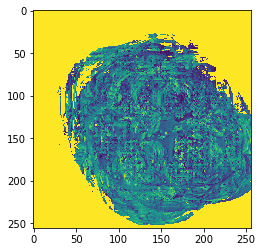

In [12]:
def multi_otsu(image):
    motsuth=filters.threshold_multiotsu(image, classes=3)
    print(motsuth)
    print (f"Slice {i+1} otsu threshold={motsuth[1]}")
    regions=np.digitize(image,bins=motsuth)
    output=img_as_ubyte(regions)
    return motsuth[1] #(fat+ muscle th)

def ITSA(i,InROI, ots, OG_VOL):
    k=1
    ThPrev=0 
    ThRev= ots[i] 
    x=0
    y=0
    
    while ThRev!=ThPrev:
        ThPrev=ThRev
        prefatmask = (InROI[i]>ThRev)
        prefatmask = np.uint8(prefatmask)
        ret, fatmask = cv2.threshold(prefatmask,0,1,cv2.THRESH_BINARY)  #need this??
        if i==0:
            fatcombined_next=OG_VOL[i+1]+fatmask
            ret, fatconnectedparts_next= cv2.threshold(fatcombined_next,1,1,cv2.THRESH_BINARY)
            z_connection=fatconnectedparts_next
        elif i==(totalslices-1):
            fatcombined_prev=OG_VOL[i-1]+fatmask
            ret, fatconnectedparts_prev= cv2.threshold(fatcombined_prev,1,1,cv2.THRESH_BINARY)
            z_connection=fatconnectedparts_prev  
        else:
            fatcombined_prev=OG_VOL[i-1]+fatmask
            fatcombined_next=fatmask+OG_VOL[i+1]
            ret, fatconnectedparts_prev= cv2.threshold(fatcombined_prev,1,1,cv2.THRESH_BINARY)
            ret, fatconnectedparts_next= cv2.threshold(fatcombined_next,1,1,cv2.THRESH_BINARY)

            z_connection=fatconnectedparts_prev+fatconnectedparts_next
            ret, z_connection= cv2.threshold(z_connection,0,1,cv2.THRESH_BINARY)         
        #NEW: find XY connections to Z connected parts
        coordinates= np.argwhere(z_connection ==1) #put coordinates of Z-connections into a list      
        im_ff=fatmask.copy()
        h, w = im_ff.shape[:2] #added
        mask = np.zeros((h+2, w+2), np.uint8)
        for item in range(len(coordinates)):
            cv2.floodFill(im_ff, mask, (coordinates[item][1],coordinates[item][0]), 2) 
        #Remove small islands for Non-Z parts
        nonZ =label(im_ff==1)
        nonZ_keep = (morphology.remove_small_objects(nonZ,min_size=8, connectivity=1))
        ret, nonZ_keep= cv2.threshold(np.uint8(nonZ_keep),0,1,cv2.THRESH_BINARY)
        Z = (im_ff==2)
        prefatseg1=(Z+nonZ_keep) #do we need int cus boolean??
        fatseg1=prefatseg1*InROI[i]
        #Fat and Muscle Quantification
        preMuscSegP=InROI[i]-fatseg1
        MuscSegP=np.ma.masked_where(preMuscSegP == 0, preMuscSegP)
        MuscSeg = InROI[i]*MuscSegP
        FatSegP=np.ma.masked_where(fatseg1==0,fatseg1) 
        MuscSegI=np.mean(MuscSegP)
        FatSegI=np.mean(FatSegP)
        ThRev=(1+((FatSegI-MuscSegI)/FatSegI))*MuscSegI
        print (f"Slice #{i+1} Iteration={k}\n\tThPrev={ThPrev}\n\tThRev={ThRev}\n")

        k+=1
        if k==50:
            break

    thresholds = ThRev
    
    return fatseg1,thresholds


iThreshold=[]
print('Multi Otsu Threshold...')
for i in range(totalslices):
    iThreshold.append([])
    iThreshold[i]=multi_otsu(CorrectedFascia[i])
print ("-----------------------------------------------------------")

#ITSA Threshold Seeking Round 1 
fleROI_R1=np.zeros([thigharray.shape[0], thigharray.shape[1], thigharray.shape[2]], dtype='uint8')
fatseg=np.zeros([thigharray.shape[0], thigharray.shape[1], thigharray.shape[2]], dtype='uint8')
fatsegMASK=np.zeros([thigharray.shape[0], thigharray.shape[1], thigharray.shape[2]], dtype='uint8') #change name
threshold_R1=[] #change name compared to single slice?
print("ITSA Round 1 Initiation...")
for i in range(totalslices):
    threshold_R1.append([])
    fatseg[i],threshold_R1[i]=ITSA(i, CorrectedFascia, iThreshold,OG_VOL )  #fatsegfinalvol_mask_R1=round 1 final fat mask with islands REMOVED
    print (f"Slice #{i+1} Round 1 Th1 = {threshold_R1[i]}")
    print ("-----------------------------------------------------------")
    
for i in range(totalslices):
    print (f"Slice #{i+1} Th1 OG/Rev={threshold_R1[i]}")

<ipython-input-16-b76651ab4edf>:4: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  fig, axs=plt.subplots (1,3, figsize=(15,10))


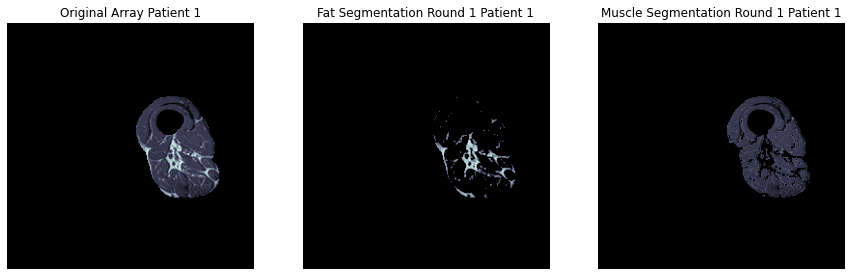

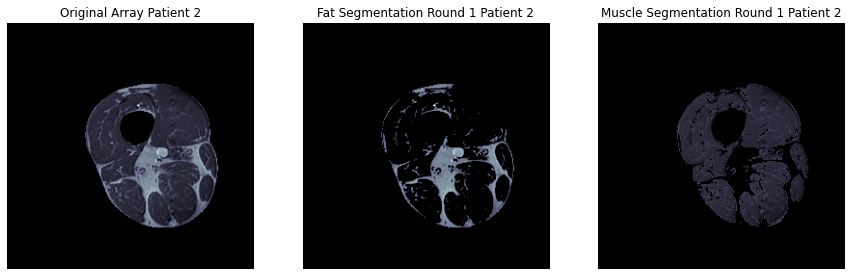

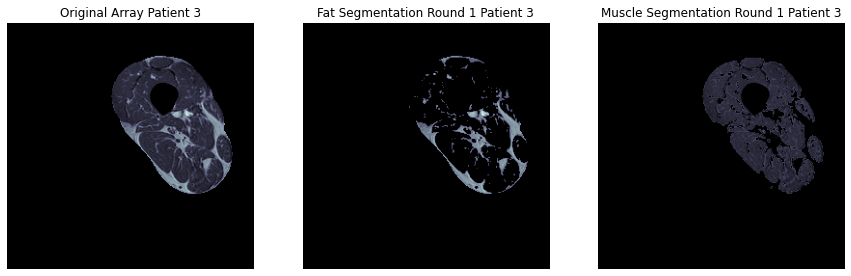

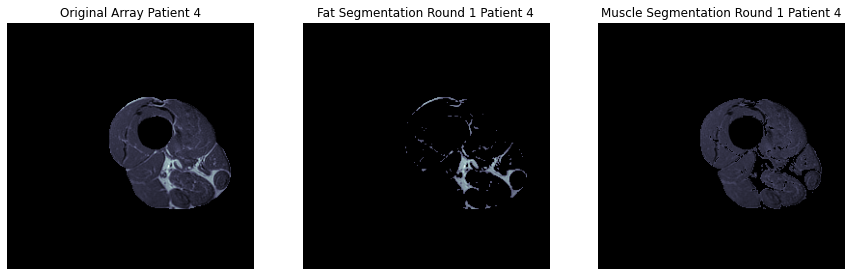

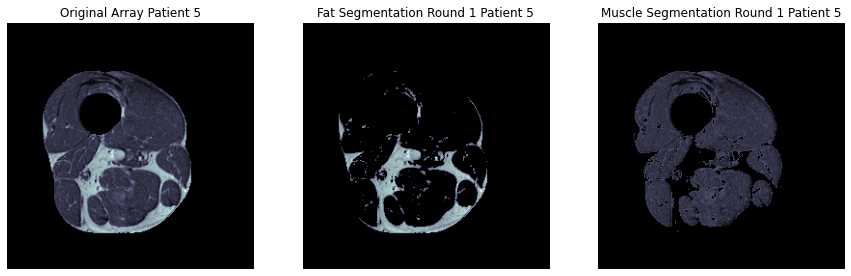

...

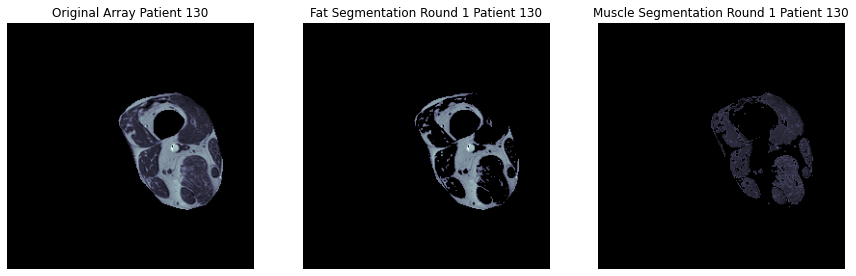

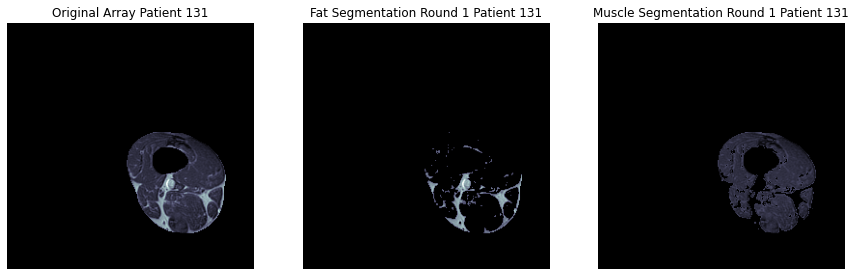

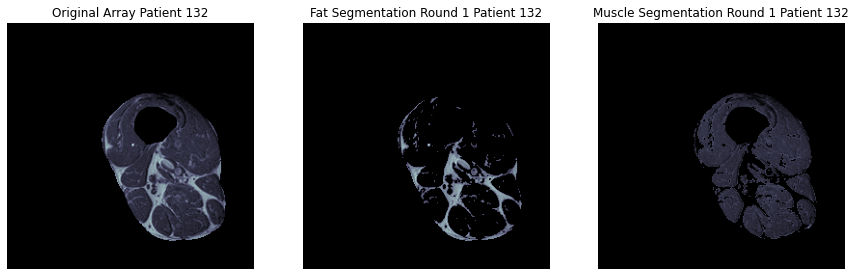

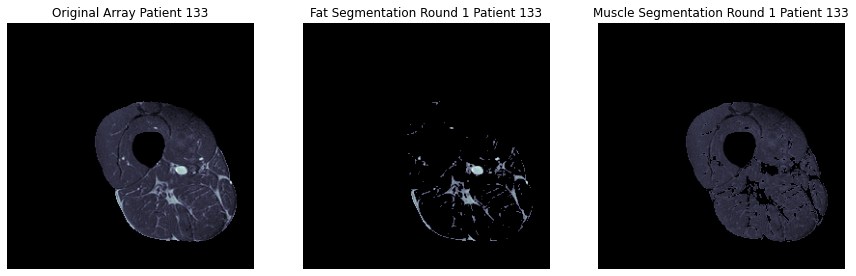

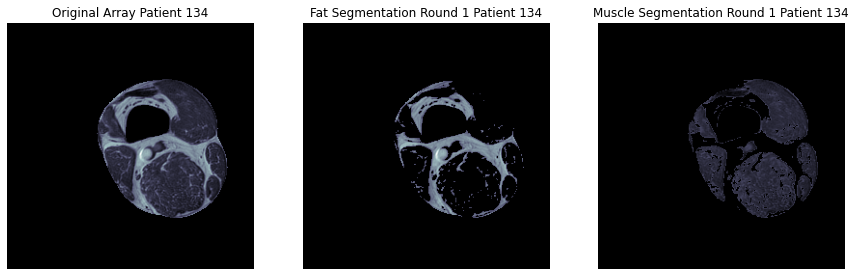

In [16]:
def PatientViewer (Array, ArrayN, Array1, ArrayN1, Array2, ArrayN2):
    s=1
    for i in range (0,totalslices,slicesperpatient):
        fig, axs=plt.subplots (1,3, figsize=(15,10))
        axs[0].imshow(Array[i],"bone",vmin=0,vmax=256)
        axs[0].set_title(f'{ArrayN} Patient {s}')
        axs[0].axis("off")
        axs[1].imshow(Array1[i],"bone",vmax=256)
        axs[1].set_title(f'{ArrayN1} Patient {s}')
        axs[1].axis("off")
        axs[2].imshow(Array2[i],"bone",vmin=0,vmax=255)
        axs[2].set_title(f'{ArrayN2} Patient {s}')
        axs[2].axis("off")
        s+=1

fleROI_R1=CorrectedFascia-fatseg
PatientViewer(CorrectedFascia,"Original Array",fatseg,"Fat Segmentation Round 1",fleROI_R1,"Muscle Segmentation Round 1")

In [17]:
#ITSA Threshold Seeking Round 2
print('Multi Otsu Threshold Round 2...')
iThresholdR2=[]
for i in range(totalslices):
    iThresholdR2.append([])
    iThresholdR2[i]=multi_otsu(fleROI_R1[i])

Multi Otsu Threshold Round 2...
[25.90039062 61.98632812]
Slice 1 otsu threshold=61.986328125
[21.08398438 50.84960938]
Slice 2 otsu threshold=50.849609375
[22.96875 54.90625]
Slice 3 otsu threshold=54.90625
[26.953125 63.671875]
Slice 4 otsu threshold=63.671875
[25.77148438 62.02148438]
Slice 5 otsu threshold=62.021484375
[27.04101562 63.65039062]
Slice 6 otsu threshold=63.650390625
[25.921875 62.015625]
Slice 7 otsu threshold=62.015625
[27.84375 66.09375]
Slice 8 otsu threshold=66.09375
[18.94921875 44.98046875]
Slice 9 otsu threshold=44.98046875
[25.9140625 60.7890625]
Slice 10 otsu threshold=60.7890625
[25.94921875 61.87890625]
Slice 11 otsu threshold=61.87890625
[27.8671875 65.9296875]
Slice 12 otsu threshold=65.9296875
[28.796875 66.796875]
Slice 13 otsu threshold=66.796875
[28.04492188 65.88867188]
Slice 14 otsu threshold=65.888671875
[30.76757812 70.86914062]
Slice 15 otsu threshold=70.869140625
[21.84960938 52.01367188]
Slice 16 otsu threshold=52.013671875
[28.03125 66.21875]


[27.72070312 63.79101562]
Slice 155 otsu threshold=63.791015625
[27.7265625 63.0703125]
Slice 156 otsu threshold=63.0703125
[28.98632812 64.84570312]
Slice 157 otsu threshold=64.845703125
[29.73632812 67.79882812]
Slice 158 otsu threshold=67.798828125
[26.04492188 58.85742188]
Slice 159 otsu threshold=58.857421875
[29.8984375 66.8515625]
Slice 160 otsu threshold=66.8515625
[28.83398438 64.82226562]
Slice 161 otsu threshold=64.822265625
[28.7109375 64.6953125]
Slice 162 otsu threshold=64.6953125
[27.84375 62.90625]
Slice 163 otsu threshold=62.90625
[29.05078125 64.60546875]
Slice 164 otsu threshold=64.60546875
[28.16015625 62.92578125]
Slice 165 otsu threshold=62.92578125
[23.86328125 55.89453125]
Slice 166 otsu threshold=55.89453125
[23.76171875 58.05078125]
Slice 167 otsu threshold=58.05078125
[23.953125 56.765625]
Slice 168 otsu threshold=56.765625
[25.79882812 61.12695312]
Slice 169 otsu threshold=61.126953125
[25.87890625 59.83203125]
Slice 170 otsu threshold=59.83203125
[24.171875

[26.90429688 64.85351562]
Slice 307 otsu threshold=64.853515625
[27.09179688 64.98242188]
Slice 308 otsu threshold=64.982421875
[24.97851562 59.98242188]
Slice 309 otsu threshold=59.982421875
[28.97460938 68.78320312]
Slice 310 otsu threshold=68.783203125
[26.72851562 63.83398438]
Slice 311 otsu threshold=63.833984375
[28.79296875 69.92578125]
Slice 312 otsu threshold=69.92578125
[25.95507812 61.95117188]
Slice 313 otsu threshold=61.951171875
[27.0703125 65.8984375]
Slice 314 otsu threshold=65.8984375
[29.2578125 68.0859375]
Slice 315 otsu threshold=68.0859375
[24.8828125 60.9765625]
Slice 316 otsu threshold=60.9765625
[19.93164062 48.75585938]
Slice 317 otsu threshold=48.755859375
[21.95703125 55.04296875]
Slice 318 otsu threshold=55.04296875
[25.80664062 61.86523438]
Slice 319 otsu threshold=61.865234375
[27.00195312 63.91601562]
Slice 320 otsu threshold=63.916015625
[26.89453125 62.96484375]
Slice 321 otsu threshold=62.96484375
[25.8984375 61.8515625]
Slice 322 otsu threshold=61.851

[23.84765625 56.93359375]
Slice 461 otsu threshold=56.93359375
[24.90234375 58.76953125]
Slice 462 otsu threshold=58.76953125
[24.12890625 57.96484375]
Slice 463 otsu threshold=57.96484375
[24.68359375 58.75390625]
Slice 464 otsu threshold=58.75390625
[26.16796875 59.85546875]
Slice 465 otsu threshold=59.85546875
[19.85351562 46.94335938]
Slice 466 otsu threshold=46.943359375
[24.86914062 58.80273438]
Slice 467 otsu threshold=58.802734375
[25.9375 62.8125]
Slice 468 otsu threshold=62.8125
[24.73632812 57.91210938]
Slice 469 otsu threshold=57.912109375
[21.83203125 52.83984375]
Slice 470 otsu threshold=52.83984375
[21.99023438 52.04882812]
Slice 471 otsu threshold=52.048828125
[22.953125 55.859375]
Slice 472 otsu threshold=55.859375
[22.92773438 54.91992188]
Slice 473 otsu threshold=54.919921875
[20.91796875 48.80859375]
Slice 474 otsu threshold=48.80859375
[23.84375 54.90625]
Slice 475 otsu threshold=54.90625
[21.07617188 48.91992188]
Slice 476 otsu threshold=48.919921875
[20.0390625 4

[27.19335938 62.98632812]
Slice 612 otsu threshold=62.986328125
[24.15820312 57.92773438]
Slice 613 otsu threshold=57.927734375
[27.01757812 63.04101562]
Slice 614 otsu threshold=63.041015625
[26.76953125 64.06640625]
Slice 615 otsu threshold=64.06640625
[29.04882812 71.94335938]
Slice 616 otsu threshold=71.943359375
[28.00390625 69.87890625]
Slice 617 otsu threshold=69.87890625
[26.90429688 67.11914062]
Slice 618 otsu threshold=67.119140625
[28.1640625 69.1796875]
Slice 619 otsu threshold=69.1796875
[27.8515625 69.9921875]
Slice 620 otsu threshold=69.9921875
[28.10742188 70.86914062]
Slice 621 otsu threshold=70.869140625
[28.03710938 68.81835938]
Slice 622 otsu threshold=68.818359375
[29.93359375 73.75390625]
Slice 623 otsu threshold=73.75390625
[22.07617188 54.06054688]
Slice 624 otsu threshold=54.060546875
[26.8828125 67.0859375]
Slice 625 otsu threshold=67.0859375
[27.97265625 70.08203125]
Slice 626 otsu threshold=70.08203125
[27.06445312 66.06054688]
Slice 627 otsu threshold=66.06

[25.05078125 61.90234375]
Slice 762 otsu threshold=61.90234375
[23.93945312 58.80273438]
Slice 763 otsu threshold=58.802734375
[24.82226562 59.78320312]
Slice 764 otsu threshold=59.783203125
[27.05273438 63.79101562]
Slice 765 otsu threshold=63.791015625
[21.97851562 55.03710938]
Slice 766 otsu threshold=55.037109375
[24.88476562 62.88085938]
Slice 767 otsu threshold=62.880859375
[27.72070312 67.79882812]
Slice 768 otsu threshold=67.798828125
[26.0546875 65.0234375]
Slice 769 otsu threshold=65.0234375
[27.02539062 66.09179688]
Slice 770 otsu threshold=66.091796875
[24.140625 58.828125]
Slice 771 otsu threshold=58.828125
[ 0.19921875 23.97265625]
Slice 772 otsu threshold=23.97265625
[26.95703125 66.21484375]
Slice 773 otsu threshold=66.21484375
[25.07421875 59.91015625]
Slice 774 otsu threshold=59.91015625
[25.84179688 62.92773438]
Slice 775 otsu threshold=62.927734375
[25.97265625 64.09765625]
Slice 776 otsu threshold=64.09765625
[25.765625 62.953125]
Slice 777 otsu threshold=62.953125

[25.99804688 61.85742188]
Slice 910 otsu threshold=61.857421875
[28.91601562 66.91992188]
Slice 911 otsu threshold=66.919921875
[26.95898438 62.90429688]
Slice 912 otsu threshold=62.904296875
[28.796875 66.796875]
Slice 913 otsu threshold=66.796875
[26.76953125 62.86328125]
Slice 914 otsu threshold=62.86328125
[28.98632812 66.04101562]
Slice 915 otsu threshold=66.041015625
[26.09765625 61.95703125]
Slice 916 otsu threshold=61.95703125
[25.79101562 62.16992188]
Slice 917 otsu threshold=62.169921875
[25.83007812 63.11523438]
Slice 918 otsu threshold=63.115234375
[28.03710938 65.98632812]
Slice 919 otsu threshold=65.986328125
[21.89648438 51.88085938]
Slice 920 otsu threshold=51.880859375
[25.97460938 61.72460938]
Slice 921 otsu threshold=61.724609375
[23.25 53.25]
Slice 922 otsu threshold=53.25
[19.01757812 44.93164062]
Slice 923 otsu threshold=44.931640625
[23.92578125 54.93359375]
Slice 924 otsu threshold=54.93359375
[26.72851562 60.68945312]
Slice 925 otsu threshold=60.689453125
[25.9

[27.19335938 64.84570312]
Slice 1059 otsu threshold=64.845703125
[29.01757812 66.77539062]
Slice 1060 otsu threshold=66.775390625
[26.8046875 64.9921875]
Slice 1061 otsu threshold=64.9921875
[27.890625 64.921875]
Slice 1062 otsu threshold=64.921875
[27.87890625 65.05078125]
Slice 1063 otsu threshold=65.05078125
[28.83398438 66.75976562]
Slice 1064 otsu threshold=66.759765625
[29.05664062 67.79882812]
Slice 1065 otsu threshold=67.798828125
[29.05078125 67.78515625]
Slice 1066 otsu threshold=67.78515625
[24.85546875 59.80078125]
Slice 1067 otsu threshold=59.80078125
[27.234375 63.984375]
Slice 1068 otsu threshold=63.984375
[26.80664062 64.69335938]
Slice 1069 otsu threshold=64.693359375
[26.16796875 61.05859375]
Slice 1070 otsu threshold=61.05859375
[27.23242188 63.79101562]
Slice 1071 otsu threshold=63.791015625
[26.72851562 61.94726562]
Slice 1072 otsu threshold=61.947265625
[27.8671875 66.9453125]
Slice 1073 otsu threshold=66.9453125
[22.10742188 51.96679688]
Slice 1074 otsu threshold

[22.08007812 53.77148438]
Slice 1209 otsu threshold=53.771484375
[25.921875 62.015625]
Slice 1210 otsu threshold=62.015625
[25.92773438 63.95507812]
Slice 1211 otsu threshold=63.955078125
[25.99804688 61.85742188]
Slice 1212 otsu threshold=61.857421875
[25.12695312 59.03320312]
Slice 1213 otsu threshold=59.033203125
[25.0078125 61.1015625]
Slice 1214 otsu threshold=61.1015625
[27.01757812 63.04101562]
Slice 1215 otsu threshold=63.041015625
[30.015625 71.984375]
Slice 1216 otsu threshold=71.984375
[26.04492188 64.24414062]
Slice 1217 otsu threshold=64.244140625
[27.28125 64.96875]
Slice 1218 otsu threshold=64.96875
[26.15625 62.15625]
Slice 1219 otsu threshold=62.15625
[26.04492188 62.13867188]
Slice 1220 otsu threshold=62.138671875
[28.12304688 66.88085938]
Slice 1221 otsu threshold=66.880859375
[27.09179688 63.95898438]
Slice 1222 otsu threshold=63.958984375
[27.92773438 68.93554688]
Slice 1223 otsu threshold=68.935546875
[24.12890625 57.96484375]
Slice 1224 otsu threshold=57.96484375

[23.00976562 53.22460938]
Slice 1360 otsu threshold=53.224609375
[21.25 50.25]
Slice 1361 otsu threshold=50.25
[20.1640625 47.8046875]
Slice 1362 otsu threshold=47.8046875
[21.1015625 48.8515625]
Slice 1363 otsu threshold=48.8515625
[20.859375 48.984375]
Slice 1364 otsu threshold=48.984375
[22.77539062 53.80273438]
Slice 1365 otsu threshold=53.802734375
[20.96679688 49.21679688]
Slice 1366 otsu threshold=49.216796875
[23.81640625 56.79296875]
Slice 1367 otsu threshold=56.79296875
[25.0078125 61.1015625]
Slice 1368 otsu threshold=61.1015625
[25.23828125 60.73828125]
Slice 1369 otsu threshold=60.73828125
[25.90039062 61.98632812]
Slice 1370 otsu threshold=61.986328125
[27.8671875 63.7421875]
Slice 1371 otsu threshold=63.7421875
[26.6953125 61.7578125]
Slice 1372 otsu threshold=61.7578125
[28.9453125 67.9453125]
Slice 1373 otsu threshold=67.9453125
[20.75390625 48.78515625]
Slice 1374 otsu threshold=48.78515625
[28.88671875 68.30859375]
Slice 1375 otsu threshold=68.30859375
[29.828125 67.

[26.92578125 64.09765625]
Slice 1512 otsu threshold=64.09765625
[24.81445312 60.90820312]
Slice 1513 otsu threshold=60.908203125
[27.08789062 63.99023438]
Slice 1514 otsu threshold=63.990234375
[20.75390625 49.86328125]
Slice 1515 otsu threshold=49.86328125
[19.79882812 50.02929688]
Slice 1516 otsu threshold=50.029296875
[23.98828125 60.10546875]
Slice 1517 otsu threshold=60.10546875
[25.19726562 61.04492188]
Slice 1518 otsu threshold=61.044921875
[24.9609375 60.8203125]
Slice 1519 otsu threshold=60.8203125
[21.0703125 53.0390625]
Slice 1520 otsu threshold=53.0390625
[24.140625 60.234375]
Slice 1521 otsu threshold=60.234375
[23.9765625 59.0390625]
Slice 1522 otsu threshold=59.0390625
[24.81445312 61.20898438]
Slice 1523 otsu threshold=61.208984375
[18.9921875 45.0234375]
Slice 1524 otsu threshold=45.0234375
[24.12890625 59.07421875]
Slice 1525 otsu threshold=59.07421875
[24.86328125 59.93359375]
Slice 1526 otsu threshold=59.93359375
[25.06054688 59.75976562]
Slice 1527 otsu threshold=5

[27.12109375 64.80078125]
Slice 1662 otsu threshold=64.80078125
[26.89453125 63.94921875]
Slice 1663 otsu threshold=63.94921875
[24.03320312 57.88867188]
Slice 1664 otsu threshold=57.888671875
[28.91210938 66.77929688]
Slice 1665 otsu threshold=66.779296875
[27.88671875 66.14453125]
Slice 1666 otsu threshold=66.14453125
[27.76171875 66.03515625]
Slice 1667 otsu threshold=66.03515625
[28.96875 68.90625]
Slice 1668 otsu threshold=68.90625
[27.88867188 66.77929688]
Slice 1669 otsu threshold=66.779296875
[28.80859375 68.91015625]
Slice 1670 otsu threshold=68.91015625
[28.83984375 68.19140625]
Slice 1671 otsu threshold=68.19140625
[28.97460938 68.05664062]
Slice 1672 otsu threshold=68.056640625
[27.80859375 64.23046875]
Slice 1673 otsu threshold=64.23046875
[23.953125 54.796875]
Slice 1674 otsu threshold=54.796875
[27.87890625 65.05078125]
Slice 1675 otsu threshold=65.05078125
[27.2109375 63.9140625]
Slice 1676 otsu threshold=63.9140625
[27.17773438 64.91210938]
Slice 1677 otsu threshold=64

[24.86328125 58.88671875]
Slice 1813 otsu threshold=58.88671875
[20.09179688 47.87304688]
Slice 1814 otsu threshold=47.873046875
[27.06445312 63.73242188]
Slice 1815 otsu threshold=63.732421875
[16.92773438 44.93164062]
Slice 1816 otsu threshold=44.931640625
[21.0703125 52.7890625]
Slice 1817 otsu threshold=52.7890625
[21.9765625 55.9609375]
Slice 1818 otsu threshold=55.9609375
[20.88867188 54.13085938]
Slice 1819 otsu threshold=54.130859375
[20.91796875 53.98828125]
Slice 1820 otsu threshold=53.98828125
[21.74804688 57.05664062]
Slice 1821 otsu threshold=57.056640625
[24.88476562 60.74023438]
Slice 1822 otsu threshold=60.740234375
[23.98828125 60.10546875]
Slice 1823 otsu threshold=60.10546875
[21.10742188 54.12695312]
Slice 1824 otsu threshold=54.126953125
[26.26171875 62.96484375]
Slice 1825 otsu threshold=62.96484375
[26.96484375 65.22265625]
Slice 1826 otsu threshold=65.22265625
[27.88867188 66.77929688]
Slice 1827 otsu threshold=66.779296875
[24.9453125 60.7890625]
Slice 1828 ots

[28.69335938 66.72070312]
Slice 1965 otsu threshold=66.720703125
[22.08007812 52.21289062]
Slice 1966 otsu threshold=52.212890625
[26.75585938 64.16210938]
Slice 1967 otsu threshold=64.162109375
[26.04492188 62.13867188]
Slice 1968 otsu threshold=62.138671875
[27.02539062 65.02148438]
Slice 1969 otsu threshold=65.021484375
[25.921875 62.015625]
Slice 1970 otsu threshold=62.015625
[25.79101562 61.08398438]
Slice 1971 otsu threshold=61.083984375
[27.0703125 63.1640625]
Slice 1972 otsu threshold=63.1640625
[31.11523438 71.66992188]
Slice 1973 otsu threshold=71.669921875
[28.09570312 65.02148438]
Slice 1974 otsu threshold=65.021484375
[28.10742188 66.04101562]
Slice 1975 otsu threshold=66.041015625
[28.20898438 65.07617188]
Slice 1976 otsu threshold=65.076171875
[27.26367188 63.06445312]
Slice 1977 otsu threshold=63.064453125
[27.98632812 63.83398438]
Slice 1978 otsu threshold=63.833984375
[27.24609375 62.98828125]
Slice 1979 otsu threshold=62.98828125
[29.74414062 68.99414062]
Slice 1980 

In [18]:
fatsegR2=np.zeros([thigharray.shape[0], thigharray.shape[1], thigharray.shape[2]], dtype='uint8') 
threshold_R2=[] 
for i in range(totalslices):
    threshold_R2.append([])
    fatsegR2[i], threshold_R2[i]=ITSA(i, fleROI_R1, iThresholdR2, OG_VOL)  #fatsegfinalvol_mask_R1=round 1 final fat mask with islands REMOVED
    
    print (f"Slice #{i+1} Round 2 Threshold = {threshold_R2[i]}")
    print ("-----------------------------------------------------------")
for i in range(totalslices):
    print (f"Slice #{i+1} Th2 OG/Rev={threshold_R2[i]}")

Slice #1 Iteration=1
	ThPrev=61.986328125
	ThRev=64.99614243726609

Slice #1 Iteration=2
	ThPrev=64.99614243726609
	ThRev=67.87708377564084

Slice #1 Iteration=3
	ThPrev=67.87708377564084
	ThRev=70.65224735728354

Slice #1 Iteration=4
	ThPrev=70.65224735728354
	ThRev=73.1433003134169

Slice #1 Iteration=5
	ThPrev=73.1433003134169
	ThRev=75.28419291430833

Slice #1 Iteration=6
	ThPrev=75.28419291430833
	ThRev=76.4263761183978

Slice #1 Iteration=7
	ThPrev=76.4263761183978
	ThRev=76.95183406650213

Slice #1 Iteration=8
	ThPrev=76.95183406650213
	ThRev=76.95183406650213

Slice #1 Round 2 Threshold = 76.95183406650213
-----------------------------------------------------------
Slice #2 Iteration=1
	ThPrev=50.849609375
	ThRev=53.351273999574694

Slice #2 Iteration=2
	ThPrev=53.351273999574694
	ThRev=55.87901657906379

Slice #2 Iteration=3
	ThPrev=55.87901657906379
	ThRev=57.37728913809887

Slice #2 Iteration=4
	ThPrev=57.37728913809887
	ThRev=58.878521363009824

Slice #2 Iteration=5
	ThPrev

Slice #15 Iteration=1
	ThPrev=70.869140625
	ThRev=75.06907417617107

Slice #15 Iteration=2
	ThPrev=75.06907417617107
	ThRev=78.90469801203272

Slice #15 Iteration=3
	ThPrev=78.90469801203272
	ThRev=81.09265594267629

Slice #15 Iteration=4
	ThPrev=81.09265594267629
	ThRev=82.94104181379959

Slice #15 Iteration=5
	ThPrev=82.94104181379959
	ThRev=83.46191476158528

Slice #15 Iteration=6
	ThPrev=83.46191476158528
	ThRev=83.90432749090353

Slice #15 Iteration=7
	ThPrev=83.90432749090353
	ThRev=83.90432749090353

Slice #15 Round 2 Threshold = 83.90432749090353
-----------------------------------------------------------
Slice #16 Iteration=1
	ThPrev=52.013671875
	ThRev=55.602341983113206

Slice #16 Iteration=2
	ThPrev=55.602341983113206
	ThRev=57.81353436520138

Slice #16 Iteration=3
	ThPrev=57.81353436520138
	ThRev=59.03811894834473

Slice #16 Iteration=4
	ThPrev=59.03811894834473
	ThRev=59.924134710987154

Slice #16 Iteration=5
	ThPrev=59.924134710987154
	ThRev=59.924134710987154

Slice #16

Slice #31 Iteration=2
	ThPrev=58.12459726470863
	ThRev=60.71714055667501

Slice #31 Iteration=3
	ThPrev=60.71714055667501
	ThRev=61.80717895136571

Slice #31 Iteration=4
	ThPrev=61.80717895136571
	ThRev=62.32829993110536

Slice #31 Iteration=5
	ThPrev=62.32829993110536
	ThRev=62.8382947966372

Slice #31 Iteration=6
	ThPrev=62.8382947966372
	ThRev=62.8382947966372

Slice #31 Round 2 Threshold = 62.8382947966372
-----------------------------------------------------------
Slice #32 Iteration=1
	ThPrev=69.82421875
	ThRev=73.89030530343226

Slice #32 Iteration=2
	ThPrev=73.89030530343226
	ThRev=76.62588839679364

Slice #32 Iteration=3
	ThPrev=76.62588839679364
	ThRev=78.32034089239586

Slice #32 Iteration=4
	ThPrev=78.32034089239586
	ThRev=79.11804160438109

Slice #32 Iteration=5
	ThPrev=79.11804160438109
	ThRev=79.6464901614376

Slice #32 Iteration=6
	ThPrev=79.6464901614376
	ThRev=79.6464901614376

Slice #32 Round 2 Threshold = 79.6464901614376
--------------------------------------------

Slice #45 Iteration=7
	ThPrev=73.20674382805457
	ThRev=73.6807051577037

Slice #45 Iteration=8
	ThPrev=73.6807051577037
	ThRev=73.6807051577037

Slice #45 Round 2 Threshold = 73.6807051577037
-----------------------------------------------------------
Slice #46 Iteration=1
	ThPrev=52.9296875
	ThRev=55.90799847804375

Slice #46 Iteration=2
	ThPrev=55.90799847804375
	ThRev=58.511516849721694

Slice #46 Iteration=3
	ThPrev=58.511516849721694
	ThRev=61.140700867467814

Slice #46 Iteration=4
	ThPrev=61.140700867467814
	ThRev=63.45042409434112

Slice #46 Iteration=5
	ThPrev=63.45042409434112
	ThRev=64.79331720343394

Slice #46 Iteration=6
	ThPrev=64.79331720343394
	ThRev=65.46983911216468

Slice #46 Iteration=7
	ThPrev=65.46983911216468
	ThRev=66.0477110807823

Slice #46 Iteration=8
	ThPrev=66.0477110807823
	ThRev=66.67495001705328

Slice #46 Iteration=9
	ThPrev=66.67495001705328
	ThRev=66.67495001705328

Slice #46 Round 2 Threshold = 66.67495001705328
---------------------------------------

Slice #58 Iteration=7
	ThPrev=76.41670536090679
	ThRev=76.85434053517376

Slice #58 Iteration=8
	ThPrev=76.85434053517376
	ThRev=76.85434053517376

Slice #58 Round 2 Threshold = 76.85434053517376
-----------------------------------------------------------
Slice #59 Iteration=1
	ThPrev=59.689453125
	ThRev=63.26514273099126

Slice #59 Iteration=2
	ThPrev=63.26514273099126
	ThRev=66.8147097420607

Slice #59 Iteration=3
	ThPrev=66.8147097420607
	ThRev=69.09371096305946

Slice #59 Iteration=4
	ThPrev=69.09371096305946
	ThRev=71.0793245862964

Slice #59 Iteration=5
	ThPrev=71.0793245862964
	ThRev=72.36951903961241

Slice #59 Iteration=6
	ThPrev=72.36951903961241
	ThRev=72.95120557165323

Slice #59 Iteration=7
	ThPrev=72.95120557165323
	ThRev=72.95120557165323

Slice #59 Round 2 Threshold = 72.95120557165323
-----------------------------------------------------------
Slice #60 Iteration=1
	ThPrev=59.25
	ThRev=63.336383875177184

Slice #60 Iteration=2
	ThPrev=63.336383875177184
	ThRev=66.86666

Slice #72 Iteration=2
	ThPrev=61.242509957534004
	ThRev=64.27926422721117

Slice #72 Iteration=3
	ThPrev=64.27926422721117
	ThRev=66.38188784207208

Slice #72 Iteration=4
	ThPrev=66.38188784207208
	ThRev=67.68366811917782

Slice #72 Iteration=5
	ThPrev=67.68366811917782
	ThRev=68.2819920527527

Slice #72 Iteration=6
	ThPrev=68.2819920527527
	ThRev=68.83422620471195

Slice #72 Iteration=7
	ThPrev=68.83422620471195
	ThRev=68.83422620471195

Slice #72 Round 2 Threshold = 68.83422620471195
-----------------------------------------------------------
Slice #73 Iteration=1
	ThPrev=65.775390625
	ThRev=69.82744707640785

Slice #73 Iteration=2
	ThPrev=69.82744707640785
	ThRev=72.97453492389374

Slice #73 Iteration=3
	ThPrev=72.97453492389374
	ThRev=74.94506067144948

Slice #73 Iteration=4
	ThPrev=74.94506067144948
	ThRev=76.28027462036987

Slice #73 Iteration=5
	ThPrev=76.28027462036987
	ThRev=77.60053112320932

Slice #73 Iteration=6
	ThPrev=77.60053112320932
	ThRev=78.20690641068224

Slice #73 

Slice #85 Iteration=7
	ThPrev=70.90709282049002
	ThRev=70.90709282049002

Slice #85 Round 2 Threshold = 70.90709282049002
-----------------------------------------------------------
Slice #86 Iteration=1
	ThPrev=61.81640625
	ThRev=65.74303868370733

Slice #86 Iteration=2
	ThPrev=65.74303868370733
	ThRev=69.01205373594526

Slice #86 Iteration=3
	ThPrev=69.01205373594526
	ThRev=71.95576607376782

Slice #86 Iteration=4
	ThPrev=71.95576607376782
	ThRev=73.34896023644693

Slice #86 Iteration=5
	ThPrev=73.34896023644693
	ThRev=74.41805832082656

Slice #86 Iteration=6
	ThPrev=74.41805832082656
	ThRev=74.9340996606127

Slice #86 Iteration=7
	ThPrev=74.9340996606127
	ThRev=74.9340996606127

Slice #86 Round 2 Threshold = 74.9340996606127
-----------------------------------------------------------
Slice #87 Iteration=1
	ThPrev=60.126953125
	ThRev=64.4196893913403

Slice #87 Iteration=2
	ThPrev=64.4196893913403
	ThRev=67.8036745455407

Slice #87 Iteration=3
	ThPrev=67.8036745455407
	ThRev=70.08359

Slice #100 Iteration=6
	ThPrev=75.27527145751644
	ThRev=75.79265194868091

Slice #100 Iteration=7
	ThPrev=75.79265194868091
	ThRev=75.79265194868091

Slice #100 Round 2 Threshold = 75.79265194868091
-----------------------------------------------------------
Slice #101 Iteration=1
	ThPrev=66.87109375
	ThRev=71.08975823871661

Slice #101 Iteration=2
	ThPrev=71.08975823871661
	ThRev=75.02184186217521

Slice #101 Iteration=3
	ThPrev=75.02184186217521
	ThRev=77.22183180510812

Slice #101 Iteration=4
	ThPrev=77.22183180510812
	ThRev=78.04355357603161

Slice #101 Iteration=5
	ThPrev=78.04355357603161
	ThRev=78.54844639676477

Slice #101 Iteration=6
	ThPrev=78.54844639676477
	ThRev=78.54844639676477

Slice #101 Round 2 Threshold = 78.54844639676477
-----------------------------------------------------------
Slice #102 Iteration=1
	ThPrev=66.873046875
	ThRev=70.96170663785081

Slice #102 Iteration=2
	ThPrev=70.96170663785081
	ThRev=73.55252967456315

Slice #102 Iteration=3
	ThPrev=73.552529674

Slice #117 Iteration=1
	ThPrev=40.125
	ThRev=42.98303268165013

Slice #117 Iteration=2
	ThPrev=42.98303268165013
	ThRev=44.30831933397019

Slice #117 Iteration=3
	ThPrev=44.30831933397019
	ThRev=45.53241120777048

Slice #117 Iteration=4
	ThPrev=45.53241120777048
	ThRev=46.06781463249635

Slice #117 Iteration=5
	ThPrev=46.06781463249635
	ThRev=46.64364191023811

Slice #117 Iteration=6
	ThPrev=46.64364191023811
	ThRev=46.64364191023811

Slice #117 Round 2 Threshold = 46.64364191023811
-----------------------------------------------------------
Slice #118 Iteration=1
	ThPrev=55.01953125
	ThRev=59.10038865876445

Slice #118 Iteration=2
	ThPrev=59.10038865876445
	ThRev=61.5400231417545

Slice #118 Iteration=3
	ThPrev=61.5400231417545
	ThRev=62.726172363753676

Slice #118 Iteration=4
	ThPrev=62.726172363753676
	ThRev=63.028987983897096

Slice #118 Iteration=5
	ThPrev=63.028987983897096
	ThRev=63.78263225198941

Slice #118 Iteration=6
	ThPrev=63.78263225198941
	ThRev=63.78263225198941

Slice 

Slice #133 Iteration=4
	ThPrev=73.90435998409642
	ThRev=74.94159456095902

Slice #133 Iteration=5
	ThPrev=74.94159456095902
	ThRev=75.48287291316946

Slice #133 Iteration=6
	ThPrev=75.48287291316946
	ThRev=76.0209811168182

Slice #133 Iteration=7
	ThPrev=76.0209811168182
	ThRev=76.51807176933855

Slice #133 Iteration=8
	ThPrev=76.51807176933855
	ThRev=76.51807176933855

Slice #133 Round 2 Threshold = 76.51807176933855
-----------------------------------------------------------
Slice #134 Iteration=1
	ThPrev=65.693359375
	ThRev=69.79561898734856

Slice #134 Iteration=2
	ThPrev=69.79561898734856
	ThRev=73.25815524088209

Slice #134 Iteration=3
	ThPrev=73.25815524088209
	ThRev=76.29708819659757

Slice #134 Iteration=4
	ThPrev=76.29708819659757
	ThRev=78.3001060424587

Slice #134 Iteration=5
	ThPrev=78.3001060424587
	ThRev=79.44386979958074

Slice #134 Iteration=6
	ThPrev=79.44386979958074
	ThRev=80.05065602521178

Slice #134 Iteration=7
	ThPrev=80.05065602521178
	ThRev=80.54245716545991



Slice #146 Iteration=4
	ThPrev=72.43079608460776
	ThRev=74.6433856113182

Slice #146 Iteration=5
	ThPrev=74.6433856113182
	ThRev=76.30033833367493

Slice #146 Iteration=6
	ThPrev=76.30033833367493
	ThRev=78.00654194025843

Slice #146 Iteration=7
	ThPrev=78.00654194025843
	ThRev=79.03857822671637

Slice #146 Iteration=8
	ThPrev=79.03857822671637
	ThRev=79.8156905366751

Slice #146 Iteration=9
	ThPrev=79.8156905366751
	ThRev=79.8156905366751

Slice #146 Round 2 Threshold = 79.8156905366751
-----------------------------------------------------------
Slice #147 Iteration=1
	ThPrev=59.814453125
	ThRev=63.35831303086356

Slice #147 Iteration=2
	ThPrev=63.35831303086356
	ThRev=66.90331716050078

Slice #147 Iteration=3
	ThPrev=66.90331716050078
	ThRev=69.19846065398049

Slice #147 Iteration=4
	ThPrev=69.19846065398049
	ThRev=71.52896203719662

Slice #147 Iteration=5
	ThPrev=71.52896203719662
	ThRev=73.34532207581431

Slice #147 Iteration=6
	ThPrev=73.34532207581431
	ThRev=75.00321001732554

Sl

Slice #158 Round 2 Threshold = 81.92161381793993
-----------------------------------------------------------
Slice #159 Iteration=1
	ThPrev=58.857421875
	ThRev=62.52081950894782

Slice #159 Iteration=2
	ThPrev=62.52081950894782
	ThRev=66.16024004126828

Slice #159 Iteration=3
	ThPrev=66.16024004126828
	ThRev=68.70013950498665

Slice #159 Iteration=4
	ThPrev=68.70013950498665
	ThRev=70.13824057379108

Slice #159 Iteration=5
	ThPrev=70.13824057379108
	ThRev=70.84641029012664

Slice #159 Iteration=6
	ThPrev=70.84641029012664
	ThRev=70.84641029012664

Slice #159 Round 2 Threshold = 70.84641029012664
-----------------------------------------------------------
Slice #160 Iteration=1
	ThPrev=66.8515625
	ThRev=71.01069691859811

Slice #160 Iteration=2
	ThPrev=71.01069691859811
	ThRev=75.07291855391398

Slice #160 Iteration=3
	ThPrev=75.07291855391398
	ThRev=78.33570182296181

Slice #160 Iteration=4
	ThPrev=78.33570182296181
	ThRev=80.35010543960534

Slice #160 Iteration=5
	ThPrev=80.3501054396

Slice #174 Iteration=1
	ThPrev=47.841796875
	ThRev=51.19913912922429

Slice #174 Iteration=2
	ThPrev=51.19913912922429
	ThRev=54.51155397342505

Slice #174 Iteration=3
	ThPrev=54.51155397342505
	ThRev=56.632125056462016

Slice #174 Iteration=4
	ThPrev=56.632125056462016
	ThRev=57.828598823589886

Slice #174 Iteration=5
	ThPrev=57.828598823589886
	ThRev=58.34857405465151

Slice #174 Iteration=6
	ThPrev=58.34857405465151
	ThRev=58.904669102952084

Slice #174 Iteration=7
	ThPrev=58.904669102952084
	ThRev=58.904669102952084

Slice #174 Round 2 Threshold = 58.904669102952084
-----------------------------------------------------------
Slice #175 Iteration=1
	ThPrev=59.0625
	ThRev=63.76216235025174

Slice #175 Iteration=2
	ThPrev=63.76216235025174
	ThRev=66.76942827352285

Slice #175 Iteration=3
	ThPrev=66.76942827352285
	ThRev=68.75161430539652

Slice #175 Iteration=4
	ThPrev=68.75161430539652
	ThRev=69.96139548411928

Slice #175 Iteration=5
	ThPrev=69.96139548411928
	ThRev=70.49596222556048

Slice #185 Iteration=7
	ThPrev=75.76883982634584
	ThRev=76.46965527161917

Slice #185 Iteration=8
	ThPrev=76.46965527161917
	ThRev=77.01695322664473

Slice #185 Iteration=9
	ThPrev=77.01695322664473
	ThRev=77.47207865341363

Slice #185 Iteration=10
	ThPrev=77.47207865341363
	ThRev=77.47207865341363

Slice #185 Round 2 Threshold = 77.47207865341363
-----------------------------------------------------------
Slice #186 Iteration=1
	ThPrev=60.888671875
	ThRev=64.21207125167835

Slice #186 Iteration=2
	ThPrev=64.21207125167835
	ThRev=67.86505571269083

Slice #186 Iteration=3
	ThPrev=67.86505571269083
	ThRev=70.6078611957701

Slice #186 Iteration=4
	ThPrev=70.6078611957701
	ThRev=73.16795851522102

Slice #186 Iteration=5
	ThPrev=73.16795851522102
	ThRev=75.56182793920173

Slice #186 Iteration=6
	ThPrev=75.56182793920173
	ThRev=77.07800655592565

Slice #186 Iteration=7
	ThPrev=77.07800655592565
	ThRev=78.44401329627608

Slice #186 Iteration=8
	ThPrev=78.44401329627608
	ThRev=79.1085635948152

Slice #198 Iteration=1
	ThPrev=60.994140625
	ThRev=64.8396326460943

Slice #198 Iteration=2
	ThPrev=64.8396326460943
	ThRev=67.50233138734087

Slice #198 Iteration=3
	ThPrev=67.50233138734087
	ThRev=69.39743335155795

Slice #198 Iteration=4
	ThPrev=69.39743335155795
	ThRev=70.65585003970722

Slice #198 Iteration=5
	ThPrev=70.65585003970722
	ThRev=71.16485293850481

Slice #198 Iteration=6
	ThPrev=71.16485293850481
	ThRev=71.74905088979052

Slice #198 Iteration=7
	ThPrev=71.74905088979052
	ThRev=71.74905088979052

Slice #198 Round 2 Threshold = 71.74905088979052
-----------------------------------------------------------
Slice #199 Iteration=1
	ThPrev=61.03125
	ThRev=64.77255697729186

Slice #199 Iteration=2
	ThPrev=64.77255697729186
	ThRev=66.81849582903278

Slice #199 Iteration=3
	ThPrev=66.81849582903278
	ThRev=68.18505113698583

Slice #199 Iteration=4
	ThPrev=68.18505113698583
	ThRev=69.58124903589166

Slice #199 Iteration=5
	ThPrev=69.58124903589166
	ThRev=70.20287934356492

Slice #

Slice #212 Iteration=5
	ThPrev=74.39189757113033
	ThRev=75.8537724491206

Slice #212 Iteration=6
	ThPrev=75.8537724491206
	ThRev=76.44150267209793

Slice #212 Iteration=7
	ThPrev=76.44150267209793
	ThRev=77.10838654645646

Slice #212 Iteration=8
	ThPrev=77.10838654645646
	ThRev=77.74173958171139

Slice #212 Iteration=9
	ThPrev=77.74173958171139
	ThRev=77.74173958171139

Slice #212 Round 2 Threshold = 77.74173958171139
-----------------------------------------------------------
Slice #213 Iteration=1
	ThPrev=68.009765625
	ThRev=72.81490372132521

Slice #213 Iteration=2
	ThPrev=72.81490372132521
	ThRev=76.05568493388319

Slice #213 Iteration=3
	ThPrev=76.05568493388319
	ThRev=79.03892920330092

Slice #213 Iteration=4
	ThPrev=79.03892920330092
	ThRev=81.1621407142049

Slice #213 Iteration=5
	ThPrev=81.1621407142049
	ThRev=82.47175144411587

Slice #213 Iteration=6
	ThPrev=82.47175144411587
	ThRev=82.97839865947152

Slice #213 Iteration=7
	ThPrev=82.97839865947152
	ThRev=82.97839865947152



Slice #226 Iteration=2
	ThPrev=57.785827771205575
	ThRev=60.77942817255579

Slice #226 Iteration=3
	ThPrev=60.77942817255579
	ThRev=63.34130318957856

Slice #226 Iteration=4
	ThPrev=63.34130318957856
	ThRev=65.30278124772376

Slice #226 Iteration=5
	ThPrev=65.30278124772376
	ThRev=66.57577389516543

Slice #226 Iteration=6
	ThPrev=66.57577389516543
	ThRev=66.83445859519605

Slice #226 Iteration=7
	ThPrev=66.83445859519605
	ThRev=66.83445859519605

Slice #226 Round 2 Threshold = 66.83445859519605
-----------------------------------------------------------
Slice #227 Iteration=1
	ThPrev=66.720703125
	ThRev=70.58777199266251

Slice #227 Iteration=2
	ThPrev=70.58777199266251
	ThRev=73.5225129083981

Slice #227 Iteration=3
	ThPrev=73.5225129083981
	ThRev=75.22147480381642

Slice #227 Iteration=4
	ThPrev=75.22147480381642
	ThRev=76.34072593403961

Slice #227 Iteration=5
	ThPrev=76.34072593403961
	ThRev=76.94030982914644

Slice #227 Iteration=6
	ThPrev=76.94030982914644
	ThRev=76.9403098291464

Slice #240 Iteration=4
	ThPrev=74.97770493764702
	ThRev=76.08966147021438

Slice #240 Iteration=5
	ThPrev=76.08966147021438
	ThRev=77.06866497889692

Slice #240 Iteration=6
	ThPrev=77.06866497889692
	ThRev=77.45471495719403

Slice #240 Iteration=7
	ThPrev=77.45471495719403
	ThRev=77.45471495719403

Slice #240 Round 2 Threshold = 77.45471495719403
-----------------------------------------------------------
Slice #241 Iteration=1
	ThPrev=52.873046875
	ThRev=54.93103391591891

Slice #241 Iteration=2
	ThPrev=54.93103391591891
	ThRev=56.632810160706796

Slice #241 Iteration=3
	ThPrev=56.632810160706796
	ThRev=58.01043569421471

Slice #241 Iteration=4
	ThPrev=58.01043569421471
	ThRev=59.43766391384071

Slice #241 Iteration=5
	ThPrev=59.43766391384071
	ThRev=60.05459848125988

Slice #241 Iteration=6
	ThPrev=60.05459848125988
	ThRev=60.616990142852295

Slice #241 Iteration=7
	ThPrev=60.616990142852295
	ThRev=60.616990142852295

Slice #241 Round 2 Threshold = 60.616990142852295
----------------

Slice #252 Iteration=7
	ThPrev=71.10520102616947
	ThRev=71.72010460229687

Slice #252 Iteration=8
	ThPrev=71.72010460229687
	ThRev=71.72010460229687

Slice #252 Round 2 Threshold = 71.72010460229687
-----------------------------------------------------------
Slice #253 Iteration=1
	ThPrev=60.955078125
	ThRev=64.38877171043673

Slice #253 Iteration=2
	ThPrev=64.38877171043673
	ThRev=67.44926493396585

Slice #253 Iteration=3
	ThPrev=67.44926493396585
	ThRev=69.58072741729968

Slice #253 Iteration=4
	ThPrev=69.58072741729968
	ThRev=70.87439947316903

Slice #253 Iteration=5
	ThPrev=70.87439947316903
	ThRev=71.4618159946778

Slice #253 Iteration=6
	ThPrev=71.4618159946778
	ThRev=72.00924208084484

Slice #253 Iteration=7
	ThPrev=72.00924208084484
	ThRev=72.6165050713328

Slice #253 Iteration=8
	ThPrev=72.6165050713328
	ThRev=72.6165050713328

Slice #253 Round 2 Threshold = 72.6165050713328
-----------------------------------------------------------
Slice #254 Iteration=1
	ThPrev=66.775390625

Slice #266 Iteration=5
	ThPrev=73.05438959753648
	ThRev=74.12655472541874

Slice #266 Iteration=6
	ThPrev=74.12655472541874
	ThRev=74.78657059549388

Slice #266 Iteration=7
	ThPrev=74.78657059549388
	ThRev=74.78657059549388

Slice #266 Round 2 Threshold = 74.78657059549388
-----------------------------------------------------------
Slice #267 Iteration=1
	ThPrev=63.01953125
	ThRev=67.6082906055913

Slice #267 Iteration=2
	ThPrev=67.6082906055913
	ThRev=70.49909414519645

Slice #267 Iteration=3
	ThPrev=70.49909414519645
	ThRev=72.58264878713409

Slice #267 Iteration=4
	ThPrev=72.58264878713409
	ThRev=73.88540265778856

Slice #267 Iteration=5
	ThPrev=73.88540265778856
	ThRev=74.5051544540776

Slice #267 Iteration=6
	ThPrev=74.5051544540776
	ThRev=75.05776724076456

Slice #267 Iteration=7
	ThPrev=75.05776724076456
	ThRev=75.56636828646884

Slice #267 Iteration=8
	ThPrev=75.56636828646884
	ThRev=75.56636828646884

Slice #267 Round 2 Threshold = 75.56636828646884
---------------------------

Slice #281 Iteration=1
	ThPrev=68.021484375
	ThRev=72.77576326269738

Slice #281 Iteration=2
	ThPrev=72.77576326269738
	ThRev=75.19778906769028

Slice #281 Iteration=3
	ThPrev=75.19778906769028
	ThRev=77.03327761845242

Slice #281 Iteration=4
	ThPrev=77.03327761845242
	ThRev=78.09499195639069

Slice #281 Iteration=5
	ThPrev=78.09499195639069
	ThRev=78.57881922605534

Slice #281 Iteration=6
	ThPrev=78.57881922605534
	ThRev=78.57881922605534

Slice #281 Round 2 Threshold = 78.57881922605534
-----------------------------------------------------------
Slice #282 Iteration=1
	ThPrev=65.900390625
	ThRev=70.40283830236206

Slice #282 Iteration=2
	ThPrev=70.40283830236206
	ThRev=73.67720618926471

Slice #282 Iteration=3
	ThPrev=73.67720618926471
	ThRev=75.44636617587142

Slice #282 Iteration=4
	ThPrev=75.44636617587142
	ThRev=76.574378676539

Slice #282 Iteration=5
	ThPrev=76.574378676539
	ThRev=77.07802745464531

Slice #282 Iteration=6
	ThPrev=77.07802745464531
	ThRev=77.57930936182564

Slice

Slice #296 Iteration=2
	ThPrev=66.87818167086613
	ThRev=69.86408151752576

Slice #296 Iteration=3
	ThPrev=69.86408151752576
	ThRev=71.98250534072825

Slice #296 Iteration=4
	ThPrev=71.98250534072825
	ThRev=73.23879444352949

Slice #296 Iteration=5
	ThPrev=73.23879444352949
	ThRev=74.37933996404949

Slice #296 Iteration=6
	ThPrev=74.37933996404949
	ThRev=74.92014142709527

Slice #296 Iteration=7
	ThPrev=74.92014142709527
	ThRev=74.92014142709527

Slice #296 Round 2 Threshold = 74.92014142709527
-----------------------------------------------------------
Slice #297 Iteration=1
	ThPrev=61.208984375
	ThRev=65.68521321157341

Slice #297 Iteration=2
	ThPrev=65.68521321157341
	ThRev=68.73060692801346

Slice #297 Iteration=3
	ThPrev=68.73060692801346
	ThRev=70.81238260672073

Slice #297 Iteration=4
	ThPrev=70.81238260672073
	ThRev=72.09067577907055

Slice #297 Iteration=5
	ThPrev=72.09067577907055
	ThRev=73.25815468943381

Slice #297 Iteration=6
	ThPrev=73.25815468943381
	ThRev=73.826649479677

Slice #311 Iteration=4
	ThPrev=72.86628257629206
	ThRev=74.07187871885694

Slice #311 Iteration=5
	ThPrev=74.07187871885694
	ThRev=75.15289486739829

Slice #311 Iteration=6
	ThPrev=75.15289486739829
	ThRev=75.57160417317306

Slice #311 Iteration=7
	ThPrev=75.57160417317306
	ThRev=75.57160417317306

Slice #311 Round 2 Threshold = 75.57160417317306
-----------------------------------------------------------
Slice #312 Iteration=1
	ThPrev=69.92578125
	ThRev=74.60150841030229

Slice #312 Iteration=2
	ThPrev=74.60150841030229
	ThRev=77.97818212939822

Slice #312 Iteration=3
	ThPrev=77.97818212939822
	ThRev=79.83717402009758

Slice #312 Iteration=4
	ThPrev=79.83717402009758
	ThRev=80.91961798724735

Slice #312 Iteration=5
	ThPrev=80.91961798724735
	ThRev=81.37016675170959

Slice #312 Iteration=6
	ThPrev=81.37016675170959
	ThRev=81.96200031405303

Slice #312 Iteration=7
	ThPrev=81.96200031405303
	ThRev=81.96200031405303

Slice #312 Round 2 Threshold = 81.96200031405303
-----------------------

Slice #324 Iteration=2
	ThPrev=46.179226803984164
	ThRev=48.83499496241107

Slice #324 Iteration=3
	ThPrev=48.83499496241107
	ThRev=50.410568143654054

Slice #324 Iteration=4
	ThPrev=50.410568143654054
	ThRev=51.946555346391655

Slice #324 Iteration=5
	ThPrev=51.946555346391655
	ThRev=52.673397588817735

Slice #324 Iteration=6
	ThPrev=52.673397588817735
	ThRev=53.25382028857932

Slice #324 Iteration=7
	ThPrev=53.25382028857932
	ThRev=53.790468944078306

Slice #324 Iteration=8
	ThPrev=53.790468944078306
	ThRev=53.790468944078306

Slice #324 Round 2 Threshold = 53.790468944078306
-----------------------------------------------------------
Slice #325 Iteration=1
	ThPrev=60.7890625
	ThRev=64.65308803987963

Slice #325 Iteration=2
	ThPrev=64.65308803987963
	ThRev=67.80585634953809

Slice #325 Iteration=3
	ThPrev=67.80585634953809
	ThRev=70.10564193211574

Slice #325 Iteration=4
	ThPrev=70.10564193211574
	ThRev=72.24015769386664

Slice #325 Iteration=5
	ThPrev=72.24015769386664
	ThRev=73.521

Slice #340 Iteration=2
	ThPrev=75.35906130736124
	ThRev=78.84463969964128

Slice #340 Iteration=3
	ThPrev=78.84463969964128
	ThRev=80.59966818255673

Slice #340 Iteration=4
	ThPrev=80.59966818255673
	ThRev=81.57352539460986

Slice #340 Iteration=5
	ThPrev=81.57352539460986
	ThRev=82.08189944396511

Slice #340 Iteration=6
	ThPrev=82.08189944396511
	ThRev=82.55131862238508

Slice #340 Iteration=7
	ThPrev=82.55131862238508
	ThRev=82.55131862238508

Slice #340 Round 2 Threshold = 82.55131862238508
-----------------------------------------------------------
Slice #341 Iteration=1
	ThPrev=69.853515625
	ThRev=74.38578433909375

Slice #341 Iteration=2
	ThPrev=74.38578433909375
	ThRev=77.87265653390838

Slice #341 Iteration=3
	ThPrev=77.87265653390838
	ThRev=79.71086431645075

Slice #341 Iteration=4
	ThPrev=79.71086431645075
	ThRev=80.77398548098311

Slice #341 Iteration=5
	ThPrev=80.77398548098311
	ThRev=81.31882333164212

Slice #341 Iteration=6
	ThPrev=81.31882333164212
	ThRev=81.760971056175

Slice #356 Iteration=1
	ThPrev=75.013671875
	ThRev=80.0769835048041

Slice #356 Iteration=2
	ThPrev=80.0769835048041
	ThRev=83.29609348811611

Slice #356 Iteration=3
	ThPrev=83.29609348811611
	ThRev=85.00921543449957

Slice #356 Iteration=4
	ThPrev=85.00921543449957
	ThRev=86.0598843668473

Slice #356 Iteration=5
	ThPrev=86.0598843668473
	ThRev=86.60277763463306

Slice #356 Iteration=6
	ThPrev=86.60277763463306
	ThRev=86.60277763463306

Slice #356 Round 2 Threshold = 86.60277763463306
-----------------------------------------------------------
Slice #357 Iteration=1
	ThPrev=70.9375
	ThRev=74.99179319677884

Slice #357 Iteration=2
	ThPrev=74.99179319677884
	ThRev=77.52952543383509

Slice #357 Iteration=3
	ThPrev=77.52952543383509
	ThRev=79.32287983826228

Slice #357 Iteration=4
	ThPrev=79.32287983826228
	ThRev=80.40905181919965

Slice #357 Iteration=5
	ThPrev=80.40905181919965
	ThRev=80.93114256972315

Slice #357 Iteration=6
	ThPrev=80.93114256972315
	ThRev=80.93114256972315

Slice #357

Slice #372 Iteration=2
	ThPrev=73.51234740426402
	ThRev=77.13212258131192

Slice #372 Iteration=3
	ThPrev=77.13212258131192
	ThRev=79.58776958951621

Slice #372 Iteration=4
	ThPrev=79.58776958951621
	ThRev=80.68183938827484

Slice #372 Iteration=5
	ThPrev=80.68183938827484
	ThRev=81.12529116182337

Slice #372 Iteration=6
	ThPrev=81.12529116182337
	ThRev=81.58202359580773

Slice #372 Iteration=7
	ThPrev=81.58202359580773
	ThRev=81.58202359580773

Slice #372 Round 2 Threshold = 81.58202359580773
-----------------------------------------------------------
Slice #373 Iteration=1
	ThPrev=66.7734375
	ThRev=71.14206667333849

Slice #373 Iteration=2
	ThPrev=71.14206667333849
	ThRev=74.72165798179643

Slice #373 Iteration=3
	ThPrev=74.72165798179643
	ThRev=76.57616610785547

Slice #373 Iteration=4
	ThPrev=76.57616610785547
	ThRev=77.6485423807603

Slice #373 Iteration=5
	ThPrev=77.6485423807603
	ThRev=78.2689739596504

Slice #373 Iteration=6
	ThPrev=78.2689739596504
	ThRev=78.78821485051543

Sl

Slice #389 Iteration=2
	ThPrev=78.80688588527273
	ThRev=81.98422219036615

Slice #389 Iteration=3
	ThPrev=81.98422219036615
	ThRev=83.63481873757318

Slice #389 Iteration=4
	ThPrev=83.63481873757318
	ThRev=84.78747657046061

Slice #389 Iteration=5
	ThPrev=84.78747657046061
	ThRev=85.32087972318556

Slice #389 Iteration=6
	ThPrev=85.32087972318556
	ThRev=85.78303028448678

Slice #389 Iteration=7
	ThPrev=85.78303028448678
	ThRev=85.78303028448678

Slice #389 Round 2 Threshold = 85.78303028448678
-----------------------------------------------------------
Slice #390 Iteration=1
	ThPrev=56.826171875
	ThRev=60.89062130604979

Slice #390 Iteration=2
	ThPrev=60.89062130604979
	ThRev=63.505853789048345

Slice #390 Iteration=3
	ThPrev=63.505853789048345
	ThRev=65.35480826025032

Slice #390 Iteration=4
	ThPrev=65.35480826025032
	ThRev=66.37432711085631

Slice #390 Iteration=5
	ThPrev=66.37432711085631
	ThRev=66.92637187070257

Slice #390 Iteration=6
	ThPrev=66.92637187070257
	ThRev=66.9263718707

Slice #403 Iteration=1
	ThPrev=59.810546875
	ThRev=63.60468184547761

Slice #403 Iteration=2
	ThPrev=63.60468184547761
	ThRev=67.27999153780459

Slice #403 Iteration=3
	ThPrev=67.27999153780459
	ThRev=70.45433238138452

Slice #403 Iteration=4
	ThPrev=70.45433238138452
	ThRev=72.57859380156121

Slice #403 Iteration=5
	ThPrev=72.57859380156121
	ThRev=73.73053108299366

Slice #403 Iteration=6
	ThPrev=73.73053108299366
	ThRev=74.28354311991778

Slice #403 Iteration=7
	ThPrev=74.28354311991778
	ThRev=74.73647261452466

Slice #403 Iteration=8
	ThPrev=74.73647261452466
	ThRev=74.73647261452466

Slice #403 Round 2 Threshold = 74.73647261452466
-----------------------------------------------------------
Slice #404 Iteration=1
	ThPrev=62.19140625
	ThRev=66.67786092864688

Slice #404 Iteration=2
	ThPrev=66.67786092864688
	ThRev=70.41677807875836

Slice #404 Iteration=3
	ThPrev=70.41677807875836
	ThRev=73.61188851545666

Slice #404 Iteration=4
	ThPrev=73.61188851545666
	ThRev=75.47763954983887

Sl

Slice #415 Iteration=3
	ThPrev=64.46909882416892
	ThRev=66.75300573749017

Slice #415 Iteration=4
	ThPrev=66.75300573749017
	ThRev=68.17691254453653

Slice #415 Iteration=5
	ThPrev=68.17691254453653
	ThRev=69.48179914451966

Slice #415 Iteration=6
	ThPrev=69.48179914451966
	ThRev=70.014154037154

Slice #415 Iteration=7
	ThPrev=70.014154037154
	ThRev=70.65181419820928

Slice #415 Iteration=8
	ThPrev=70.65181419820928
	ThRev=70.65181419820928

Slice #415 Round 2 Threshold = 70.65181419820928
-----------------------------------------------------------
Slice #416 Iteration=1
	ThPrev=57.134765625
	ThRev=61.01421566742897

Slice #416 Iteration=2
	ThPrev=61.01421566742897
	ThRev=64.39712056579282

Slice #416 Iteration=3
	ThPrev=64.39712056579282
	ThRev=66.62840127648894

Slice #416 Iteration=4
	ThPrev=66.62840127648894
	ThRev=68.07392824066311

Slice #416 Iteration=5
	ThPrev=68.07392824066311
	ThRev=69.37364986547327

Slice #416 Iteration=6
	ThPrev=69.37364986547327
	ThRev=69.9045150951433

S

Slice #429 Iteration=7
	ThPrev=74.89497733846113
	ThRev=74.89497733846113

Slice #429 Round 2 Threshold = 74.89497733846113
-----------------------------------------------------------
Slice #430 Iteration=1
	ThPrev=70.953125
	ThRev=75.3199165616269

Slice #430 Iteration=2
	ThPrev=75.3199165616269
	ThRev=78.67265549639082

Slice #430 Iteration=3
	ThPrev=78.67265549639082
	ThRev=80.57303968641722

Slice #430 Iteration=4
	ThPrev=80.57303968641722
	ThRev=81.77811070374804

Slice #430 Iteration=5
	ThPrev=81.77811070374804
	ThRev=82.29733067154811

Slice #430 Iteration=6
	ThPrev=82.29733067154811
	ThRev=82.83511824473112

Slice #430 Iteration=7
	ThPrev=82.83511824473112
	ThRev=82.83511824473112

Slice #430 Round 2 Threshold = 82.83511824473112
-----------------------------------------------------------
Slice #431 Iteration=1
	ThPrev=69.8671875
	ThRev=74.27996217511388

Slice #431 Iteration=2
	ThPrev=74.27996217511388
	ThRev=78.08818507191262

Slice #431 Iteration=3
	ThPrev=78.08818507191262


Slice #443 Iteration=4
	ThPrev=66.23179784272043
	ThRev=67.38094360694812

Slice #443 Iteration=5
	ThPrev=67.38094360694812
	ThRev=67.88458918435362

Slice #443 Iteration=6
	ThPrev=67.88458918435362
	ThRev=67.88458918435362

Slice #443 Round 2 Threshold = 67.88458918435362
-----------------------------------------------------------
Slice #444 Iteration=1
	ThPrev=46.89453125
	ThRev=49.33082231529851

Slice #444 Iteration=2
	ThPrev=49.33082231529851
	ThRev=51.30868185495379

Slice #444 Iteration=3
	ThPrev=51.30868185495379
	ThRev=52.467642836347665

Slice #444 Iteration=4
	ThPrev=52.467642836347665
	ThRev=52.972671215867656

Slice #444 Iteration=5
	ThPrev=52.972671215867656
	ThRev=52.972671215867656

Slice #444 Round 2 Threshold = 52.972671215867656
-----------------------------------------------------------
Slice #445 Iteration=1
	ThPrev=58.896484375
	ThRev=62.02885526403142

Slice #445 Iteration=2
	ThPrev=62.02885526403142
	ThRev=64.94154419248487

Slice #445 Iteration=3
	ThPrev=64.941

Slice #458 Iteration=2
	ThPrev=51.512261408137206
	ThRev=53.91551024539951

Slice #458 Iteration=3
	ThPrev=53.91551024539951
	ThRev=55.2961632925597

Slice #458 Iteration=4
	ThPrev=55.2961632925597
	ThRev=56.67970989120509

Slice #458 Iteration=5
	ThPrev=56.67970989120509
	ThRev=57.25541307080587

Slice #458 Iteration=6
	ThPrev=57.25541307080587
	ThRev=57.81315429810646

Slice #458 Iteration=7
	ThPrev=57.81315429810646
	ThRev=57.81315429810646

Slice #458 Round 2 Threshold = 57.81315429810646
-----------------------------------------------------------
Slice #459 Iteration=1
	ThPrev=48.919921875
	ThRev=51.52499985364124

Slice #459 Iteration=2
	ThPrev=51.52499985364124
	ThRev=54.1162661113837

Slice #459 Iteration=3
	ThPrev=54.1162661113837
	ThRev=56.40608255777325

Slice #459 Iteration=4
	ThPrev=56.40608255777325
	ThRev=57.751874733026824

Slice #459 Iteration=5
	ThPrev=57.751874733026824
	ThRev=58.28487569271092

Slice #459 Iteration=6
	ThPrev=58.28487569271092
	ThRev=58.8620366619821

Slice #473 Iteration=6
	ThPrev=67.78445400732731
	ThRev=68.3128462934625

Slice #473 Iteration=7
	ThPrev=68.3128462934625
	ThRev=68.73846824239504

Slice #473 Iteration=8
	ThPrev=68.73846824239504
	ThRev=68.73846824239504

Slice #473 Round 2 Threshold = 68.73846824239504
-----------------------------------------------------------
Slice #474 Iteration=1
	ThPrev=48.80859375
	ThRev=51.96799210635695

Slice #474 Iteration=2
	ThPrev=51.96799210635695
	ThRev=54.75745472195464

Slice #474 Iteration=3
	ThPrev=54.75745472195464
	ThRev=57.31284594722007

Slice #474 Iteration=4
	ThPrev=57.31284594722007
	ThRev=59.46127455963906

Slice #474 Iteration=5
	ThPrev=59.46127455963906
	ThRev=60.800254931337065

Slice #474 Iteration=6
	ThPrev=60.800254931337065
	ThRev=61.25564183665549

Slice #474 Iteration=7
	ThPrev=61.25564183665549
	ThRev=61.67174454001898

Slice #474 Iteration=8
	ThPrev=61.67174454001898
	ThRev=61.67174454001898

Slice #474 Round 2 Threshold = 61.67174454001898
-----------------------

Slice #488 Iteration=1
	ThPrev=71.904296875
	ThRev=76.5549441144857

Slice #488 Iteration=2
	ThPrev=76.5549441144857
	ThRev=80.50044998151658

Slice #488 Iteration=3
	ThPrev=80.50044998151658
	ThRev=83.40752835339538

Slice #488 Iteration=4
	ThPrev=83.40752835339538
	ThRev=85.21410010024695

Slice #488 Iteration=5
	ThPrev=85.21410010024695
	ThRev=86.34670294910056

Slice #488 Iteration=6
	ThPrev=86.34670294910056
	ThRev=86.9002974225617

Slice #488 Iteration=7
	ThPrev=86.9002974225617
	ThRev=86.9002974225617

Slice #488 Round 2 Threshold = 86.9002974225617
-----------------------------------------------------------
Slice #489 Iteration=1
	ThPrev=67.94921875
	ThRev=72.07981764452184

Slice #489 Iteration=2
	ThPrev=72.07981764452184
	ThRev=75.89771863777402

Slice #489 Iteration=3
	ThPrev=75.89771863777402
	ThRev=77.58074773957826

Slice #489 Iteration=4
	ThPrev=77.58074773957826
	ThRev=78.81882378550995

Slice #489 Iteration=5
	ThPrev=78.81882378550995
	ThRev=79.31589094027213

Slice #4

Slice #502 Iteration=5
	ThPrev=70.41635775723607
	ThRev=71.0367179786103

Slice #502 Iteration=6
	ThPrev=71.0367179786103
	ThRev=71.62957656679272

Slice #502 Iteration=7
	ThPrev=71.62957656679272
	ThRev=71.62957656679272

Slice #502 Round 2 Threshold = 71.62957656679272
-----------------------------------------------------------
Slice #503 Iteration=1
	ThPrev=52.77734375
	ThRev=56.036443840769046

Slice #503 Iteration=2
	ThPrev=56.036443840769046
	ThRev=58.532192038834985

Slice #503 Iteration=3
	ThPrev=58.532192038834985
	ThRev=59.97815781551514

Slice #503 Iteration=4
	ThPrev=59.97815781551514
	ThRev=60.580916314643

Slice #503 Iteration=5
	ThPrev=60.580916314643
	ThRev=61.299755281457486

Slice #503 Iteration=6
	ThPrev=61.299755281457486
	ThRev=61.87360024101372

Slice #503 Iteration=7
	ThPrev=61.87360024101372
	ThRev=61.87360024101372

Slice #503 Round 2 Threshold = 61.87360024101372
-----------------------------------------------------------
Slice #504 Iteration=1
	ThPrev=55.0644

Slice #517 Iteration=2
	ThPrev=59.79523181589242
	ThRev=62.579841358121875

Slice #517 Iteration=3
	ThPrev=62.579841358121875
	ThRev=65.09539891767334

Slice #517 Iteration=4
	ThPrev=65.09539891767334
	ThRev=67.40783255997572

Slice #517 Iteration=5
	ThPrev=67.40783255997572
	ThRev=68.43250618303833

Slice #517 Iteration=6
	ThPrev=68.43250618303833
	ThRev=68.94122937059726

Slice #517 Iteration=7
	ThPrev=68.94122937059726
	ThRev=68.94122937059726

Slice #517 Round 2 Threshold = 68.94122937059726
-----------------------------------------------------------
Slice #518 Iteration=1
	ThPrev=56.9765625
	ThRev=59.761011046555296

Slice #518 Iteration=2
	ThPrev=59.761011046555296
	ThRev=62.62995871460881

Slice #518 Iteration=3
	ThPrev=62.62995871460881
	ThRev=65.46336203475846

Slice #518 Iteration=4
	ThPrev=65.46336203475846
	ThRev=68.11102301568026

Slice #518 Iteration=5
	ThPrev=68.11102301568026
	ThRev=70.46443788291243

Slice #518 Iteration=6
	ThPrev=70.46443788291243
	ThRev=71.9764650521

Slice #531 Iteration=1
	ThPrev=61.92578125
	ThRev=65.62233543208393

Slice #531 Iteration=2
	ThPrev=65.62233543208393
	ThRev=68.73806708444926

Slice #531 Iteration=3
	ThPrev=68.73806708444926
	ThRev=70.5911539585275

Slice #531 Iteration=4
	ThPrev=70.5911539585275
	ThRev=71.90296596649861

Slice #531 Iteration=5
	ThPrev=71.90296596649861
	ThRev=72.64599763573126

Slice #531 Iteration=6
	ThPrev=72.64599763573126
	ThRev=73.18660048552991

Slice #531 Iteration=7
	ThPrev=73.18660048552991
	ThRev=73.67805297313022

Slice #531 Iteration=8
	ThPrev=73.67805297313022
	ThRev=73.67805297313022

Slice #531 Round 2 Threshold = 73.67805297313022
-----------------------------------------------------------
Slice #532 Iteration=1
	ThPrev=64.646484375
	ThRev=68.35978248473745

Slice #532 Iteration=2
	ThPrev=68.35978248473745
	ThRev=71.21808880483266

Slice #532 Iteration=3
	ThPrev=71.21808880483266
	ThRev=73.03149612371391

Slice #532 Iteration=4
	ThPrev=73.03149612371391
	ThRev=74.17423047254908

Slic

Slice #546 Iteration=3
	ThPrev=71.30751248270634
	ThRev=72.94598368720828

Slice #546 Iteration=4
	ThPrev=72.94598368720828
	ThRev=73.49320466760578

Slice #546 Iteration=5
	ThPrev=73.49320466760578
	ThRev=74.13127736860693

Slice #546 Iteration=6
	ThPrev=74.13127736860693
	ThRev=74.55265532547975

Slice #546 Iteration=7
	ThPrev=74.55265532547975
	ThRev=74.55265532547975

Slice #546 Round 2 Threshold = 74.55265532547975
-----------------------------------------------------------
Slice #547 Iteration=1
	ThPrev=62.802734375
	ThRev=66.22597146991471

Slice #547 Iteration=2
	ThPrev=66.22597146991471
	ThRev=68.95154452643348

Slice #547 Iteration=3
	ThPrev=68.95154452643348
	ThRev=70.25480590655957

Slice #547 Iteration=4
	ThPrev=70.25480590655957
	ThRev=71.39987102477761

Slice #547 Iteration=5
	ThPrev=71.39987102477761
	ThRev=71.92880268808638

Slice #547 Iteration=6
	ThPrev=71.92880268808638
	ThRev=71.92880268808638

Slice #547 Round 2 Threshold = 71.92880268808638
----------------------

Slice #560 Iteration=3
	ThPrev=70.76187125543244
	ThRev=73.0291840318239

Slice #560 Iteration=4
	ThPrev=73.0291840318239
	ThRev=75.03556647465315

Slice #560 Iteration=5
	ThPrev=75.03556647465315
	ThRev=76.31447785390841

Slice #560 Iteration=6
	ThPrev=76.31447785390841
	ThRev=76.93410695081816

Slice #560 Iteration=7
	ThPrev=76.93410695081816
	ThRev=76.93410695081816

Slice #560 Round 2 Threshold = 76.93410695081816
-----------------------------------------------------------
Slice #561 Iteration=1
	ThPrev=59.1328125
	ThRev=63.326030542407814

Slice #561 Iteration=2
	ThPrev=63.326030542407814
	ThRev=66.52403480415872

Slice #561 Iteration=3
	ThPrev=66.52403480415872
	ThRev=68.75214240759959

Slice #561 Iteration=4
	ThPrev=68.75214240759959
	ThRev=70.19412762332577

Slice #561 Iteration=5
	ThPrev=70.19412762332577
	ThRev=71.51674600215271

Slice #561 Iteration=6
	ThPrev=71.51674600215271
	ThRev=72.15223231480677

Slice #561 Iteration=7
	ThPrev=72.15223231480677
	ThRev=72.70479756473587

Slice #573 Iteration=5
	ThPrev=68.90489451120224
	ThRev=69.39610353762146

Slice #573 Iteration=6
	ThPrev=69.39610353762146
	ThRev=69.91250315773286

Slice #573 Iteration=7
	ThPrev=69.91250315773286
	ThRev=69.91250315773286

Slice #573 Round 2 Threshold = 69.91250315773286
-----------------------------------------------------------
Slice #574 Iteration=1
	ThPrev=53.955078125
	ThRev=57.1112235669662

Slice #574 Iteration=2
	ThPrev=57.1112235669662
	ThRev=60.41555542573033

Slice #574 Iteration=3
	ThPrev=60.41555542573033
	ThRev=62.643717616755126

Slice #574 Iteration=4
	ThPrev=62.643717616755126
	ThRev=64.04937736009929

Slice #574 Iteration=5
	ThPrev=64.04937736009929
	ThRev=65.24433799908884

Slice #574 Iteration=6
	ThPrev=65.24433799908884
	ThRev=65.83036230556044

Slice #574 Iteration=7
	ThPrev=65.83036230556044
	ThRev=65.83036230556044

Slice #574 Round 2 Threshold = 65.83036230556044
-----------------------------------------------------------
Slice #575 Iteration=1
	ThPrev=54.849

Slice #587 Iteration=8
	ThPrev=69.99595825983714
	ThRev=69.99595825983714

Slice #587 Round 2 Threshold = 69.99595825983714
-----------------------------------------------------------
Slice #588 Iteration=1
	ThPrev=56.015625
	ThRev=59.66408905601723

Slice #588 Iteration=2
	ThPrev=59.66408905601723
	ThRev=61.86037491527845

Slice #588 Iteration=3
	ThPrev=61.86037491527845
	ThRev=63.46169028947638

Slice #588 Iteration=4
	ThPrev=63.46169028947638
	ThRev=65.05891760425432

Slice #588 Iteration=5
	ThPrev=65.05891760425432
	ThRev=66.74144820010417

Slice #588 Iteration=6
	ThPrev=66.74144820010417
	ThRev=67.56954458261423

Slice #588 Iteration=7
	ThPrev=67.56954458261423
	ThRev=68.36297440287927

Slice #588 Iteration=8
	ThPrev=68.36297440287927
	ThRev=69.03857094065404

Slice #588 Iteration=9
	ThPrev=69.03857094065404
	ThRev=69.79208801792188

Slice #588 Iteration=10
	ThPrev=69.79208801792188
	ThRev=69.79208801792188

Slice #588 Round 2 Threshold = 69.79208801792188
------------------------

Slice #600 Iteration=3
	ThPrev=63.56256136831191
	ThRev=66.14759197483232

Slice #600 Iteration=4
	ThPrev=66.14759197483232
	ThRev=68.44539157416742

Slice #600 Iteration=5
	ThPrev=68.44539157416742
	ThRev=69.81192804797048

Slice #600 Iteration=6
	ThPrev=69.81192804797048
	ThRev=70.47885999895702

Slice #600 Iteration=7
	ThPrev=70.47885999895702
	ThRev=71.1740358501528

Slice #600 Iteration=8
	ThPrev=71.1740358501528
	ThRev=71.73615118953398

Slice #600 Iteration=9
	ThPrev=71.73615118953398
	ThRev=71.73615118953398

Slice #600 Round 2 Threshold = 71.73615118953398
-----------------------------------------------------------
Slice #601 Iteration=1
	ThPrev=49.951171875
	ThRev=52.48301317382813

Slice #601 Iteration=2
	ThPrev=52.48301317382813
	ThRev=54.8802210649479

Slice #601 Iteration=3
	ThPrev=54.8802210649479
	ThRev=56.27865545270475

Slice #601 Iteration=4
	ThPrev=56.27865545270475
	ThRev=57.5030619965702

Slice #601 Iteration=5
	ThPrev=57.5030619965702
	ThRev=58.003774738075634

S

Slice #613 Iteration=3
	ThPrev=64.82660509138168
	ThRev=67.35351858438347

Slice #613 Iteration=4
	ThPrev=67.35351858438347
	ThRev=69.54566062718851

Slice #613 Iteration=5
	ThPrev=69.54566062718851
	ThRev=70.81693739807996

Slice #613 Iteration=6
	ThPrev=70.81693739807996
	ThRev=71.50057620423308

Slice #613 Iteration=7
	ThPrev=71.50057620423308
	ThRev=72.07557360662838

Slice #613 Iteration=8
	ThPrev=72.07557360662838
	ThRev=72.63850268400124

Slice #613 Iteration=9
	ThPrev=72.63850268400124
	ThRev=72.63850268400124

Slice #613 Round 2 Threshold = 72.63850268400124
-----------------------------------------------------------
Slice #614 Iteration=1
	ThPrev=63.041015625
	ThRev=67.61464351598558

Slice #614 Iteration=2
	ThPrev=67.61464351598558
	ThRev=70.90009646302515

Slice #614 Iteration=3
	ThPrev=70.90009646302515
	ThRev=72.83091011851084

Slice #614 Iteration=4
	ThPrev=72.83091011851084
	ThRev=73.91781331989189

Slice #614 Iteration=5
	ThPrev=73.91781331989189
	ThRev=74.433332566035

Slice #628 Iteration=2
	ThPrev=74.77752636953366
	ThRev=77.90036714794712

Slice #628 Iteration=3
	ThPrev=77.90036714794712
	ThRev=79.67099394377263

Slice #628 Iteration=4
	ThPrev=79.67099394377263
	ThRev=80.80540857007443

Slice #628 Iteration=5
	ThPrev=80.80540857007443
	ThRev=81.35228387270709

Slice #628 Iteration=6
	ThPrev=81.35228387270709
	ThRev=81.90195263173365

Slice #628 Iteration=7
	ThPrev=81.90195263173365
	ThRev=81.90195263173365

Slice #628 Round 2 Threshold = 81.90195263173365
-----------------------------------------------------------
Slice #629 Iteration=1
	ThPrev=63.828125
	ThRev=67.91483175076634

Slice #629 Iteration=2
	ThPrev=67.91483175076634
	ThRev=70.65770883497025

Slice #629 Iteration=3
	ThPrev=70.65770883497025
	ThRev=72.63045399309144

Slice #629 Iteration=4
	ThPrev=72.63045399309144
	ThRev=73.85914044669376

Slice #629 Iteration=5
	ThPrev=73.85914044669376
	ThRev=74.43244679553509

Slice #629 Iteration=6
	ThPrev=74.43244679553509
	ThRev=74.96414948208383


Slice #644 Iteration=3
	ThPrev=79.04523414427608
	ThRev=81.50656649452796

Slice #644 Iteration=4
	ThPrev=81.50656649452796
	ThRev=82.59907502314137

Slice #644 Iteration=5
	ThPrev=82.59907502314137
	ThRev=83.06418863713513

Slice #644 Iteration=6
	ThPrev=83.06418863713513
	ThRev=83.5039656014335

Slice #644 Iteration=7
	ThPrev=83.5039656014335
	ThRev=83.5039656014335

Slice #644 Round 2 Threshold = 83.5039656014335
-----------------------------------------------------------
Slice #645 Iteration=1
	ThPrev=72.947265625
	ThRev=77.31649438465062

Slice #645 Iteration=2
	ThPrev=77.31649438465062
	ThRev=81.19483865887962

Slice #645 Iteration=3
	ThPrev=81.19483865887962
	ThRev=83.70099574472832

Slice #645 Iteration=4
	ThPrev=83.70099574472832
	ThRev=84.82327462272914

Slice #645 Iteration=5
	ThPrev=84.82327462272914
	ThRev=85.37469606741895

Slice #645 Iteration=6
	ThPrev=85.37469606741895
	ThRev=85.94015062773877

Slice #645 Iteration=7
	ThPrev=85.94015062773877
	ThRev=85.94015062773877



Slice #660 Iteration=1
	ThPrev=61.224609375
	ThRev=65.56663530264154

Slice #660 Iteration=2
	ThPrev=65.56663530264154
	ThRev=68.46494710663319

Slice #660 Iteration=3
	ThPrev=68.46494710663319
	ThRev=70.16041790463841

Slice #660 Iteration=4
	ThPrev=70.16041790463841
	ThRev=71.01922252145916

Slice #660 Iteration=5
	ThPrev=71.01922252145916
	ThRev=71.40313250045226

Slice #660 Iteration=6
	ThPrev=71.40313250045226
	ThRev=71.40313250045226

Slice #660 Round 2 Threshold = 71.40313250045226
-----------------------------------------------------------
Slice #661 Iteration=1
	ThPrev=44.876953125
	ThRev=47.153712853484

Slice #661 Iteration=2
	ThPrev=47.153712853484
	ThRev=49.85279129993407

Slice #661 Iteration=3
	ThPrev=49.85279129993407
	ThRev=51.497655580965144

Slice #661 Iteration=4
	ThPrev=51.497655580965144
	ThRev=52.83209386239975

Slice #661 Iteration=5
	ThPrev=52.83209386239975
	ThRev=53.366728243366154

Slice #661 Iteration=6
	ThPrev=53.366728243366154
	ThRev=53.87851198395436

S

Slice #676 Iteration=1
	ThPrev=53.064453125
	ThRev=56.55405465960134

Slice #676 Iteration=2
	ThPrev=56.55405465960134
	ThRev=58.75729438298313

Slice #676 Iteration=3
	ThPrev=58.75729438298313
	ThRev=60.09071272711359

Slice #676 Iteration=4
	ThPrev=60.09071272711359
	ThRev=61.36811404176792

Slice #676 Iteration=5
	ThPrev=61.36811404176792
	ThRev=61.9207875192155

Slice #676 Iteration=6
	ThPrev=61.9207875192155
	ThRev=61.9207875192155

Slice #676 Round 2 Threshold = 61.9207875192155
-----------------------------------------------------------
Slice #677 Iteration=1
	ThPrev=60.0234375
	ThRev=64.52487159236804

Slice #677 Iteration=2
	ThPrev=64.52487159236804
	ThRev=67.33268857745546

Slice #677 Iteration=3
	ThPrev=67.33268857745546
	ThRev=69.2823316289289

Slice #677 Iteration=4
	ThPrev=69.2823316289289
	ThRev=70.32312698818308

Slice #677 Iteration=5
	ThPrev=70.32312698818308
	ThRev=70.88825306169282

Slice #677 Iteration=6
	ThPrev=70.88825306169282
	ThRev=70.88825306169282

Slice #67

Slice #690 Iteration=2
	ThPrev=73.33599749247914
	ThRev=76.86244159827821

Slice #690 Iteration=3
	ThPrev=76.86244159827821
	ThRev=78.81279797788532

Slice #690 Iteration=4
	ThPrev=78.81279797788532
	ThRev=80.05079546439752

Slice #690 Iteration=5
	ThPrev=80.05079546439752
	ThRev=81.14512983167883

Slice #690 Iteration=6
	ThPrev=81.14512983167883
	ThRev=81.69210100828258

Slice #690 Iteration=7
	ThPrev=81.69210100828258
	ThRev=81.69210100828258

Slice #690 Round 2 Threshold = 81.69210100828258
-----------------------------------------------------------
Slice #691 Iteration=1
	ThPrev=39.005859375
	ThRev=40.9562316004795

Slice #691 Iteration=2
	ThPrev=40.9562316004795
	ThRev=41.63835954812466

Slice #691 Iteration=3
	ThPrev=41.63835954812466
	ThRev=42.33622725710159

Slice #691 Iteration=4
	ThPrev=42.33622725710159
	ThRev=42.99223311083117

Slice #691 Iteration=5
	ThPrev=42.99223311083117
	ThRev=42.99223311083117

Slice #691 Round 2 Threshold = 42.99223311083117
------------------------

Slice #704 Iteration=7
	ThPrev=74.80897749228663
	ThRev=74.80897749228663

Slice #704 Round 2 Threshold = 74.80897749228663
-----------------------------------------------------------
Slice #705 Iteration=1
	ThPrev=52.978515625
	ThRev=55.946313246920475

Slice #705 Iteration=2
	ThPrev=55.946313246920475
	ThRev=58.74530990526171

Slice #705 Iteration=3
	ThPrev=58.74530990526171
	ThRev=61.0206495057512

Slice #705 Iteration=4
	ThPrev=61.0206495057512
	ThRev=62.91148315611469

Slice #705 Iteration=5
	ThPrev=62.91148315611469
	ThRev=63.40337875661113

Slice #705 Iteration=6
	ThPrev=63.40337875661113
	ThRev=63.895472784635544

Slice #705 Iteration=7
	ThPrev=63.895472784635544
	ThRev=63.895472784635544

Slice #705 Round 2 Threshold = 63.895472784635544
-----------------------------------------------------------
Slice #706 Iteration=1
	ThPrev=50.091796875
	ThRev=53.30523748276852

Slice #706 Iteration=2
	ThPrev=53.30523748276852
	ThRev=56.3165413480976

Slice #706 Iteration=3
	ThPrev=56.31654

Slice #718 Iteration=7
	ThPrev=73.58737504776956
	ThRev=73.58737504776956

Slice #718 Round 2 Threshold = 73.58737504776956
-----------------------------------------------------------
Slice #719 Iteration=1
	ThPrev=61.865234375
	ThRev=65.88487162463235

Slice #719 Iteration=2
	ThPrev=65.88487162463235
	ThRev=69.65394314027

Slice #719 Iteration=3
	ThPrev=69.65394314027
	ThRev=72.75278438802044

Slice #719 Iteration=4
	ThPrev=72.75278438802044
	ThRev=74.56536744000282

Slice #719 Iteration=5
	ThPrev=74.56536744000282
	ThRev=75.48376226219092

Slice #719 Iteration=6
	ThPrev=75.48376226219092
	ThRev=75.82055745207124

Slice #719 Iteration=7
	ThPrev=75.82055745207124
	ThRev=75.82055745207124

Slice #719 Round 2 Threshold = 75.82055745207124
-----------------------------------------------------------
Slice #720 Iteration=1
	ThPrev=61.638671875
	ThRev=65.81015491298432

Slice #720 Iteration=2
	ThPrev=65.81015491298432
	ThRev=69.49311819788929

Slice #720 Iteration=3
	ThPrev=69.49311819788929

Slice #732 Iteration=7
	ThPrev=69.81318243029553
	ThRev=69.81318243029553

Slice #732 Round 2 Threshold = 69.81318243029553
-----------------------------------------------------------
Slice #733 Iteration=1
	ThPrev=53.115234375
	ThRev=56.608715346866106

Slice #733 Iteration=2
	ThPrev=56.608715346866106
	ThRev=59.30401855880367

Slice #733 Iteration=3
	ThPrev=59.30401855880367
	ThRev=61.850659149738526

Slice #733 Iteration=4
	ThPrev=61.850659149738526
	ThRev=63.468908272859274

Slice #733 Iteration=5
	ThPrev=63.468908272859274
	ThRev=64.92405982027799

Slice #733 Iteration=6
	ThPrev=64.92405982027799
	ThRev=65.64238593070267

Slice #733 Iteration=7
	ThPrev=65.64238593070267
	ThRev=66.26378404311272

Slice #733 Iteration=8
	ThPrev=66.26378404311272
	ThRev=66.87164131172158

Slice #733 Iteration=9
	ThPrev=66.87164131172158
	ThRev=66.87164131172158

Slice #733 Round 2 Threshold = 66.87164131172158
-----------------------------------------------------------
Slice #734 Iteration=1
	ThPrev=

Slice #746 Iteration=3
	ThPrev=71.75350547783147
	ThRev=73.75313638452617

Slice #746 Iteration=4
	ThPrev=73.75313638452617
	ThRev=75.0282704468284

Slice #746 Iteration=5
	ThPrev=75.0282704468284
	ThRev=76.0723321041583

Slice #746 Iteration=6
	ThPrev=76.0723321041583
	ThRev=76.63002115816255

Slice #746 Iteration=7
	ThPrev=76.63002115816255
	ThRev=76.63002115816255

Slice #746 Round 2 Threshold = 76.63002115816255
-----------------------------------------------------------
Slice #747 Iteration=1
	ThPrev=62.015625
	ThRev=66.84486892311944

Slice #747 Iteration=2
	ThPrev=66.84486892311944
	ThRev=69.95069903282055

Slice #747 Iteration=3
	ThPrev=69.95069903282055
	ThRev=72.02545356905637

Slice #747 Iteration=4
	ThPrev=72.02545356905637
	ThRev=73.92934188287549

Slice #747 Iteration=5
	ThPrev=73.92934188287549
	ThRev=74.48061920827

Slice #747 Iteration=6
	ThPrev=74.48061920827
	ThRev=75.03055349635588

Slice #747 Iteration=7
	ThPrev=75.03055349635588
	ThRev=75.54003656446312

Slice #74

Slice #761 Iteration=2
	ThPrev=68.59358770449118
	ThRev=71.4155529387708

Slice #761 Iteration=3
	ThPrev=71.4155529387708
	ThRev=73.24567569692366

Slice #761 Iteration=4
	ThPrev=73.24567569692366
	ThRev=74.35591586285443

Slice #761 Iteration=5
	ThPrev=74.35591586285443
	ThRev=74.92430895860761

Slice #761 Iteration=6
	ThPrev=74.92430895860761
	ThRev=74.92430895860761

Slice #761 Round 2 Threshold = 74.92430895860761
-----------------------------------------------------------
Slice #762 Iteration=1
	ThPrev=61.90234375
	ThRev=65.51732530500843

Slice #762 Iteration=2
	ThPrev=65.51732530500843
	ThRev=68.30947675438547

Slice #762 Iteration=3
	ThPrev=68.30947675438547
	ThRev=70.20860947969716

Slice #762 Iteration=4
	ThPrev=70.20860947969716
	ThRev=71.31334252773462

Slice #762 Iteration=5
	ThPrev=71.31334252773462
	ThRev=71.83497247189412

Slice #762 Iteration=6
	ThPrev=71.83497247189412
	ThRev=71.83497247189412

Slice #762 Round 2 Threshold = 71.83497247189412
-------------------------

<ipython-input-12-a723b4cafc06>:38: UserWarning: Only one label was provided to `remove_small_objects`. Did you mean to use a boolean array?
  nonZ_keep = (morphology.remove_small_objects(nonZ,min_size=8, connectivity=1))


Slice #773 Iteration=3
	ThPrev=73.66151795996105
	ThRev=75.44211686265261

Slice #773 Iteration=4
	ThPrev=75.44211686265261
	ThRev=76.58588084664083

Slice #773 Iteration=5
	ThPrev=76.58588084664083
	ThRev=77.09813699927284

Slice #773 Iteration=6
	ThPrev=77.09813699927284
	ThRev=77.62883323146184

Slice #773 Iteration=7
	ThPrev=77.62883323146184
	ThRev=77.62883323146184

Slice #773 Round 2 Threshold = 77.62883323146184
-----------------------------------------------------------
Slice #774 Iteration=1
	ThPrev=59.91015625
	ThRev=63.3187892762039

Slice #774 Iteration=2
	ThPrev=63.3187892762039
	ThRev=66.21010751068036

Slice #774 Iteration=3
	ThPrev=66.21010751068036
	ThRev=67.98170808121833

Slice #774 Iteration=4
	ThPrev=67.98170808121833
	ThRev=68.50917320387609

Slice #774 Iteration=5
	ThPrev=68.50917320387609
	ThRev=69.05613516567203

Slice #774 Iteration=6
	ThPrev=69.05613516567203
	ThRev=69.50988147074607

Slice #774 Iteration=7
	ThPrev=69.50988147074607
	ThRev=69.50988147074607


Slice #787 Iteration=6
	ThPrev=71.98661541635651
	ThRev=71.98661541635651

Slice #787 Round 2 Threshold = 71.98661541635651
-----------------------------------------------------------
Slice #788 Iteration=1
	ThPrev=64.015625
	ThRev=68.46961090106029

Slice #788 Iteration=2
	ThPrev=68.46961090106029
	ThRev=71.35787314521322

Slice #788 Iteration=3
	ThPrev=71.35787314521322
	ThRev=73.23802469140789

Slice #788 Iteration=4
	ThPrev=73.23802469140789
	ThRev=74.4003579091214

Slice #788 Iteration=5
	ThPrev=74.4003579091214
	ThRev=74.97900200138987

Slice #788 Iteration=6
	ThPrev=74.97900200138987
	ThRev=74.97900200138987

Slice #788 Round 2 Threshold = 74.97900200138987
-----------------------------------------------------------
Slice #789 Iteration=1
	ThPrev=52.880859375
	ThRev=56.028566239307956

Slice #789 Iteration=2
	ThPrev=56.028566239307956
	ThRev=58.75112628793607

Slice #789 Iteration=3
	ThPrev=58.75112628793607
	ThRev=59.9130287461289

Slice #789 Iteration=4
	ThPrev=59.913028746128

Slice #801 Iteration=9
	ThPrev=76.44717500880928
	ThRev=76.44717500880928

Slice #801 Round 2 Threshold = 76.44717500880928
-----------------------------------------------------------
Slice #802 Iteration=1
	ThPrev=62.87109375
	ThRev=66.5348522061944

Slice #802 Iteration=2
	ThPrev=66.5348522061944
	ThRev=70.15558765670048

Slice #802 Iteration=3
	ThPrev=70.15558765670048
	ThRev=73.34745297744466

Slice #802 Iteration=4
	ThPrev=73.34745297744466
	ThRev=75.40437993115658

Slice #802 Iteration=5
	ThPrev=75.40437993115658
	ThRev=76.68566422099369

Slice #802 Iteration=6
	ThPrev=76.68566422099369
	ThRev=77.11538864164395

Slice #802 Iteration=7
	ThPrev=77.11538864164395
	ThRev=77.59577824040353

Slice #802 Iteration=8
	ThPrev=77.59577824040353
	ThRev=77.59577824040353

Slice #802 Round 2 Threshold = 77.59577824040353
-----------------------------------------------------------
Slice #803 Iteration=1
	ThPrev=61.865234375
	ThRev=65.39284789033127

Slice #803 Iteration=2
	ThPrev=65.39284789033

Slice #815 Iteration=2
	ThPrev=62.223150267318154
	ThRev=65.27724674650902

Slice #815 Iteration=3
	ThPrev=65.27724674650902
	ThRev=67.47056068836811

Slice #815 Iteration=4
	ThPrev=67.47056068836811
	ThRev=68.82839891826671

Slice #815 Iteration=5
	ThPrev=68.82839891826671
	ThRev=69.40969840299057

Slice #815 Iteration=6
	ThPrev=69.40969840299057
	ThRev=70.06926556912727

Slice #815 Iteration=7
	ThPrev=70.06926556912727
	ThRev=70.67618842218774

Slice #815 Iteration=8
	ThPrev=70.67618842218774
	ThRev=70.67618842218774

Slice #815 Round 2 Threshold = 70.67618842218774
-----------------------------------------------------------
Slice #816 Iteration=1
	ThPrev=59.869140625
	ThRev=63.30356108267236

Slice #816 Iteration=2
	ThPrev=63.30356108267236
	ThRev=66.46974406529803

Slice #816 Iteration=3
	ThPrev=66.46974406529803
	ThRev=68.74831134004808

Slice #816 Iteration=4
	ThPrev=68.74831134004808
	ThRev=70.10406497436088

Slice #816 Iteration=5
	ThPrev=70.10406497436088
	ThRev=71.34473904352

Slice #828 Iteration=1
	ThPrev=68.767578125
	ThRev=72.75611342835106

Slice #828 Iteration=2
	ThPrev=72.75611342835106
	ThRev=75.67955391411444

Slice #828 Iteration=3
	ThPrev=75.67955391411444
	ThRev=77.46988761347525

Slice #828 Iteration=4
	ThPrev=77.46988761347525
	ThRev=78.33140315104602

Slice #828 Iteration=5
	ThPrev=78.33140315104602
	ThRev=78.67739150610053

Slice #828 Iteration=6
	ThPrev=78.67739150610053
	ThRev=78.67739150610053

Slice #828 Round 2 Threshold = 78.67739150610053
-----------------------------------------------------------
Slice #829 Iteration=1
	ThPrev=65.015625
	ThRev=69.32059623656129

Slice #829 Iteration=2
	ThPrev=69.32059623656129
	ThRev=72.06268350627278

Slice #829 Iteration=3
	ThPrev=72.06268350627278
	ThRev=73.87666435304037

Slice #829 Iteration=4
	ThPrev=73.87666435304037
	ThRev=74.47104087672767

Slice #829 Iteration=5
	ThPrev=74.47104087672767
	ThRev=74.95120295265791

Slice #829 Iteration=6
	ThPrev=74.95120295265791
	ThRev=74.95120295265791

Slic

Slice #843 Iteration=3
	ThPrev=66.47340068349943
	ThRev=68.69252733686473

Slice #843 Iteration=4
	ThPrev=68.69252733686473
	ThRev=70.01518208654498

Slice #843 Iteration=5
	ThPrev=70.01518208654498
	ThRev=70.99762208444037

Slice #843 Iteration=6
	ThPrev=70.99762208444037
	ThRev=70.99762208444037

Slice #843 Round 2 Threshold = 70.99762208444037
-----------------------------------------------------------
Slice #844 Iteration=1
	ThPrev=58.76953125
	ThRev=62.4378876618652

Slice #844 Iteration=2
	ThPrev=62.4378876618652
	ThRev=65.57505802380923

Slice #844 Iteration=3
	ThPrev=65.57505802380923
	ThRev=67.47149155558243

Slice #844 Iteration=4
	ThPrev=67.47149155558243
	ThRev=68.60857050172862

Slice #844 Iteration=5
	ThPrev=68.60857050172862
	ThRev=69.14307226760695

Slice #844 Iteration=6
	ThPrev=69.14307226760695
	ThRev=69.59793317098898

Slice #844 Iteration=7
	ThPrev=69.59793317098898
	ThRev=69.59793317098898

Slice #844 Round 2 Threshold = 69.59793317098898
-------------------------

Slice #856 Iteration=5
	ThPrev=60.58715683850453
	ThRev=61.15530404566148

Slice #856 Iteration=6
	ThPrev=61.15530404566148
	ThRev=61.74489140650918

Slice #856 Iteration=7
	ThPrev=61.74489140650918
	ThRev=61.74489140650918

Slice #856 Round 2 Threshold = 61.74489140650918
-----------------------------------------------------------
Slice #857 Iteration=1
	ThPrev=70.833984375
	ThRev=74.41342533491166

Slice #857 Iteration=2
	ThPrev=74.41342533491166
	ThRev=77.22402329435943

Slice #857 Iteration=3
	ThPrev=77.22402329435943
	ThRev=79.03634945186867

Slice #857 Iteration=4
	ThPrev=79.03634945186867
	ThRev=80.26440131752628

Slice #857 Iteration=5
	ThPrev=80.26440131752628
	ThRev=80.86600848518053

Slice #857 Iteration=6
	ThPrev=80.86600848518053
	ThRev=80.86600848518053

Slice #857 Round 2 Threshold = 80.86600848518053
-----------------------------------------------------------
Slice #858 Iteration=1
	ThPrev=71.88671875
	ThRev=75.94835738484966

Slice #858 Iteration=2
	ThPrev=75.948357384

Slice #871 Iteration=3
	ThPrev=59.35957869399937
	ThRev=61.30029657841295

Slice #871 Iteration=4
	ThPrev=61.30029657841295
	ThRev=62.30204440974893

Slice #871 Iteration=5
	ThPrev=62.30204440974893
	ThRev=62.85618921728077

Slice #871 Iteration=6
	ThPrev=62.85618921728077
	ThRev=62.85618921728077

Slice #871 Round 2 Threshold = 62.85618921728077
-----------------------------------------------------------
Slice #872 Iteration=1
	ThPrev=62.716796875
	ThRev=66.6537220457905

Slice #872 Iteration=2
	ThPrev=66.6537220457905
	ThRev=69.97221575035573

Slice #872 Iteration=3
	ThPrev=69.97221575035573
	ThRev=72.12310269542077

Slice #872 Iteration=4
	ThPrev=72.12310269542077
	ThRev=73.72494516338348

Slice #872 Iteration=5
	ThPrev=73.72494516338348
	ThRev=74.19741369076915

Slice #872 Iteration=6
	ThPrev=74.19741369076915
	ThRev=74.68868039976978

Slice #872 Iteration=7
	ThPrev=74.68868039976978
	ThRev=74.68868039976978

Slice #872 Round 2 Threshold = 74.68868039976978
------------------------

Slice #884 Iteration=6
	ThPrev=74.0818772903966
	ThRev=74.59669308751734

Slice #884 Iteration=7
	ThPrev=74.59669308751734
	ThRev=74.59669308751734

Slice #884 Round 2 Threshold = 74.59669308751734
-----------------------------------------------------------
Slice #885 Iteration=1
	ThPrev=63.0703125
	ThRev=67.68607024950148

Slice #885 Iteration=2
	ThPrev=67.68607024950148
	ThRev=71.26677907317062

Slice #885 Iteration=3
	ThPrev=71.26677907317062
	ThRev=74.48534869136867

Slice #885 Iteration=4
	ThPrev=74.48534869136867
	ThRev=76.41791087429554

Slice #885 Iteration=5
	ThPrev=76.41791087429554
	ThRev=77.80301466798377

Slice #885 Iteration=6
	ThPrev=77.80301466798377
	ThRev=78.33035081657445

Slice #885 Iteration=7
	ThPrev=78.33035081657445
	ThRev=78.8092502708885

Slice #885 Iteration=8
	ThPrev=78.8092502708885
	ThRev=78.8092502708885

Slice #885 Round 2 Threshold = 78.8092502708885
-----------------------------------------------------------
Slice #886 Iteration=1
	ThPrev=57.134765625


Slice #898 Iteration=8
	ThPrev=78.73728972305639
	ThRev=78.73728972305639

Slice #898 Round 2 Threshold = 78.73728972305639
-----------------------------------------------------------
Slice #899 Iteration=1
	ThPrev=62.91796875
	ThRev=66.23013401204015

Slice #899 Iteration=2
	ThPrev=66.23013401204015
	ThRev=69.21654948900445

Slice #899 Iteration=3
	ThPrev=69.21654948900445
	ThRev=71.30914305799247

Slice #899 Iteration=4
	ThPrev=71.30914305799247
	ThRev=72.61827455682983

Slice #899 Iteration=5
	ThPrev=72.61827455682983
	ThRev=73.2761754070802

Slice #899 Iteration=6
	ThPrev=73.2761754070802
	ThRev=73.83931419936359

Slice #899 Iteration=7
	ThPrev=73.83931419936359
	ThRev=73.83931419936359

Slice #899 Round 2 Threshold = 73.83931419936359
-----------------------------------------------------------
Slice #900 Iteration=1
	ThPrev=63.828125
	ThRev=67.17471343112567

Slice #900 Iteration=2
	ThPrev=67.17471343112567
	ThRev=70.33403453646501

Slice #900 Iteration=3
	ThPrev=70.33403453646501

Slice #913 Iteration=5
	ThPrev=78.79013834318198
	ThRev=79.21398033942825

Slice #913 Iteration=6
	ThPrev=79.21398033942825
	ThRev=79.612883961897

Slice #913 Iteration=7
	ThPrev=79.612883961897
	ThRev=79.612883961897

Slice #913 Round 2 Threshold = 79.612883961897
-----------------------------------------------------------
Slice #914 Iteration=1
	ThPrev=62.86328125
	ThRev=66.57108007236768

Slice #914 Iteration=2
	ThPrev=66.57108007236768
	ThRev=69.96857695778343

Slice #914 Iteration=3
	ThPrev=69.96857695778343
	ThRev=72.13480717058462

Slice #914 Iteration=4
	ThPrev=72.13480717058462
	ThRev=74.26911285702525

Slice #914 Iteration=5
	ThPrev=74.26911285702525
	ThRev=75.02534490119776

Slice #914 Iteration=6
	ThPrev=75.02534490119776
	ThRev=75.6294202591784

Slice #914 Iteration=7
	ThPrev=75.6294202591784
	ThRev=75.6294202591784

Slice #914 Round 2 Threshold = 75.6294202591784
-----------------------------------------------------------
Slice #915 Iteration=1
	ThPrev=66.041015625
	ThRev

Slice #928 Iteration=7
	ThPrev=72.46150013812259
	ThRev=72.99959552285418

Slice #928 Iteration=8
	ThPrev=72.99959552285418
	ThRev=72.99959552285418

Slice #928 Round 2 Threshold = 72.99959552285418
-----------------------------------------------------------
Slice #929 Iteration=1
	ThPrev=58.818359375
	ThRev=62.22605773972068

Slice #929 Iteration=2
	ThPrev=62.22605773972068
	ThRev=65.90462340786357

Slice #929 Iteration=3
	ThPrev=65.90462340786357
	ThRev=67.3749974191016

Slice #929 Iteration=4
	ThPrev=67.3749974191016
	ThRev=68.59416518432838

Slice #929 Iteration=5
	ThPrev=68.59416518432838
	ThRev=69.23167161455686

Slice #929 Iteration=6
	ThPrev=69.23167161455686
	ThRev=69.78016078051442

Slice #929 Iteration=7
	ThPrev=69.78016078051442
	ThRev=69.78016078051442

Slice #929 Round 2 Threshold = 69.78016078051442
-----------------------------------------------------------
Slice #930 Iteration=1
	ThPrev=54.7578125
	ThRev=58.19258123707932

Slice #930 Iteration=2
	ThPrev=58.192581237079

Slice #942 Iteration=1
	ThPrev=67.173828125
	ThRev=71.98068270520132

Slice #942 Iteration=2
	ThPrev=71.98068270520132
	ThRev=74.94181360646677

Slice #942 Iteration=3
	ThPrev=74.94181360646677
	ThRev=77.04684730340844

Slice #942 Iteration=4
	ThPrev=77.04684730340844
	ThRev=78.80674536257536

Slice #942 Iteration=5
	ThPrev=78.80674536257536
	ThRev=79.43379800718233

Slice #942 Iteration=6
	ThPrev=79.43379800718233
	ThRev=79.97699385965497

Slice #942 Iteration=7
	ThPrev=79.97699385965497
	ThRev=79.97699385965497

Slice #942 Round 2 Threshold = 79.97699385965497
-----------------------------------------------------------
Slice #943 Iteration=1
	ThPrev=66.947265625
	ThRev=71.03815851645552

Slice #943 Iteration=2
	ThPrev=71.03815851645552
	ThRev=74.74701840553229

Slice #943 Iteration=3
	ThPrev=74.74701840553229
	ThRev=76.72817978512131

Slice #943 Iteration=4
	ThPrev=76.72817978512131
	ThRev=77.94610120169341

Slice #943 Iteration=5
	ThPrev=77.94610120169341
	ThRev=78.58504375038694

S

Slice #955 Iteration=1
	ThPrev=65.759765625
	ThRev=69.75806574030511

Slice #955 Iteration=2
	ThPrev=69.75806574030511
	ThRev=72.79277774717946

Slice #955 Iteration=3
	ThPrev=72.79277774717946
	ThRev=75.1439640388066

Slice #955 Iteration=4
	ThPrev=75.1439640388066
	ThRev=77.52489908736213

Slice #955 Iteration=5
	ThPrev=77.52489908736213
	ThRev=78.95947653407484

Slice #955 Iteration=6
	ThPrev=78.95947653407484
	ThRev=79.60560284453753

Slice #955 Iteration=7
	ThPrev=79.60560284453753
	ThRev=80.18827682118842

Slice #955 Iteration=8
	ThPrev=80.18827682118842
	ThRev=80.65262860853882

Slice #955 Iteration=9
	ThPrev=80.65262860853882
	ThRev=80.65262860853882

Slice #955 Round 2 Threshold = 80.65262860853882
-----------------------------------------------------------
Slice #956 Iteration=1
	ThPrev=62.95703125
	ThRev=66.73067997053111

Slice #956 Iteration=2
	ThPrev=66.73067997053111
	ThRev=70.16753381066812

Slice #956 Iteration=3
	ThPrev=70.16753381066812
	ThRev=73.57680481858887

Slic

Slice #968 Iteration=7
	ThPrev=67.51665425380078
	ThRev=67.51665425380078

Slice #968 Round 2 Threshold = 67.51665425380078
-----------------------------------------------------------
Slice #969 Iteration=1
	ThPrev=53.771484375
	ThRev=57.01154103415522

Slice #969 Iteration=2
	ThPrev=57.01154103415522
	ThRev=59.60323548128465

Slice #969 Iteration=3
	ThPrev=59.60323548128465
	ThRev=60.70894821738141

Slice #969 Iteration=4
	ThPrev=60.70894821738141
	ThRev=61.20114986618907

Slice #969 Iteration=5
	ThPrev=61.20114986618907
	ThRev=61.6544346434616

Slice #969 Iteration=6
	ThPrev=61.6544346434616
	ThRev=61.6544346434616

Slice #969 Round 2 Threshold = 61.6544346434616
-----------------------------------------------------------
Slice #970 Iteration=1
	ThPrev=65.73046875
	ThRev=70.30045276410738

Slice #970 Iteration=2
	ThPrev=70.30045276410738
	ThRev=73.47323499360404

Slice #970 Iteration=3
	ThPrev=73.47323499360404
	ThRev=75.33497740702653

Slice #970 Iteration=4
	ThPrev=75.3349774070265

Slice #984 Iteration=2
	ThPrev=53.938583598573715
	ThRev=56.53719829874573

Slice #984 Iteration=3
	ThPrev=56.53719829874573
	ThRev=58.758984617482646

Slice #984 Iteration=4
	ThPrev=58.758984617482646
	ThRev=60.13863537410354

Slice #984 Iteration=5
	ThPrev=60.13863537410354
	ThRev=61.34161523571442

Slice #984 Iteration=6
	ThPrev=61.34161523571442
	ThRev=61.889232306331685

Slice #984 Iteration=7
	ThPrev=61.889232306331685
	ThRev=61.889232306331685

Slice #984 Round 2 Threshold = 61.889232306331685
-----------------------------------------------------------
Slice #985 Iteration=1
	ThPrev=67.18359375
	ThRev=72.1049853174683

Slice #985 Iteration=2
	ThPrev=72.1049853174683
	ThRev=75.82366369037595

Slice #985 Iteration=3
	ThPrev=75.82366369037595
	ThRev=77.48941076021032

Slice #985 Iteration=4
	ThPrev=77.48941076021032
	ThRev=78.436883623004

Slice #985 Iteration=5
	ThPrev=78.436883623004
	ThRev=78.7656611131902

Slice #985 Iteration=6
	ThPrev=78.7656611131902
	ThRev=78.7656611131902


Slice #998 Round 2 Threshold = 79.53741318638022
-----------------------------------------------------------
Slice #999 Iteration=1
	ThPrev=56.84765625
	ThRev=60.0747622355855

Slice #999 Iteration=2
	ThPrev=60.0747622355855
	ThRev=62.88794342312106

Slice #999 Iteration=3
	ThPrev=62.88794342312106
	ThRev=64.01938119481825

Slice #999 Iteration=4
	ThPrev=64.01938119481825
	ThRev=65.01751898151659

Slice #999 Iteration=5
	ThPrev=65.01751898151659
	ThRev=65.52979325141541

Slice #999 Iteration=6
	ThPrev=65.52979325141541
	ThRev=65.52979325141541

Slice #999 Round 2 Threshold = 65.52979325141541
-----------------------------------------------------------
Slice #1000 Iteration=1
	ThPrev=65.810546875
	ThRev=69.992015684921

Slice #1000 Iteration=2
	ThPrev=69.992015684921
	ThRev=73.21200429715796

Slice #1000 Iteration=3
	ThPrev=73.21200429715796
	ThRev=75.28496772048054

Slice #1000 Iteration=4
	ThPrev=75.28496772048054
	ThRev=76.53723813428502

Slice #1000 Iteration=5
	ThPrev=76.5372381342

Slice #1013 Iteration=1
	ThPrev=61.857421875
	ThRev=65.57571400152986

Slice #1013 Iteration=2
	ThPrev=65.57571400152986
	ThRev=69.14060150401284

Slice #1013 Iteration=3
	ThPrev=69.14060150401284
	ThRev=72.14288376920993

Slice #1013 Iteration=4
	ThPrev=72.14288376920993
	ThRev=73.88912636686925

Slice #1013 Iteration=5
	ThPrev=73.88912636686925
	ThRev=74.39395293486496

Slice #1013 Iteration=6
	ThPrev=74.39395293486496
	ThRev=75.01009856181783

Slice #1013 Iteration=7
	ThPrev=75.01009856181783
	ThRev=75.50197689759557

Slice #1013 Iteration=8
	ThPrev=75.50197689759557
	ThRev=75.50197689759557

Slice #1013 Round 2 Threshold = 75.50197689759557
-----------------------------------------------------------
Slice #1014 Iteration=1
	ThPrev=47.017578125
	ThRev=50.58533656700843

Slice #1014 Iteration=2
	ThPrev=50.58533656700843
	ThRev=53.38540905999321

Slice #1014 Iteration=3
	ThPrev=53.38540905999321
	ThRev=55.97323679434981

Slice #1014 Iteration=4
	ThPrev=55.97323679434981
	ThRev=57.3519

Slice #1026 Iteration=1
	ThPrev=52.787109375
	ThRev=56.11214009232105

Slice #1026 Iteration=2
	ThPrev=56.11214009232105
	ThRev=59.17908893078978

Slice #1026 Iteration=3
	ThPrev=59.17908893078978
	ThRev=61.38252260885261

Slice #1026 Iteration=4
	ThPrev=61.38252260885261
	ThRev=62.810098259217725

Slice #1026 Iteration=5
	ThPrev=62.810098259217725
	ThRev=63.551699173563506

Slice #1026 Iteration=6
	ThPrev=63.551699173563506
	ThRev=64.19778432944052

Slice #1026 Iteration=7
	ThPrev=64.19778432944052
	ThRev=64.74512733576847

Slice #1026 Iteration=8
	ThPrev=64.74512733576847
	ThRev=64.74512733576847

Slice #1026 Round 2 Threshold = 64.74512733576847
-----------------------------------------------------------
Slice #1027 Iteration=1
	ThPrev=51.865234375
	ThRev=54.85030300613066

Slice #1027 Iteration=2
	ThPrev=54.85030300613066
	ThRev=57.28838345340451

Slice #1027 Iteration=3
	ThPrev=57.28838345340451
	ThRev=59.61981044029908

Slice #1027 Iteration=4
	ThPrev=59.61981044029908
	ThRev=61.

Slice #1039 Iteration=1
	ThPrev=61.083984375
	ThRev=65.78674300970088

Slice #1039 Iteration=2
	ThPrev=65.78674300970088
	ThRev=68.27285431187985

Slice #1039 Iteration=3
	ThPrev=68.27285431187985
	ThRev=70.01900403659855

Slice #1039 Iteration=4
	ThPrev=70.01900403659855
	ThRev=71.11712362292202

Slice #1039 Iteration=5
	ThPrev=71.11712362292202
	ThRev=71.64724095878111

Slice #1039 Iteration=6
	ThPrev=71.64724095878111
	ThRev=71.64724095878111

Slice #1039 Round 2 Threshold = 71.64724095878111
-----------------------------------------------------------
Slice #1040 Iteration=1
	ThPrev=61.181640625
	ThRev=65.46534431582728

Slice #1040 Iteration=2
	ThPrev=65.46534431582728
	ThRev=68.4909413883856

Slice #1040 Iteration=3
	ThPrev=68.4909413883856
	ThRev=70.4937382728785

Slice #1040 Iteration=4
	ThPrev=70.4937382728785
	ThRev=71.18199221983498

Slice #1040 Iteration=5
	ThPrev=71.18199221983498
	ThRev=71.82374804747401

Slice #1040 Iteration=6
	ThPrev=71.82374804747401
	ThRev=71.82374804

Slice #1055 Iteration=5
	ThPrev=74.12463196434948
	ThRev=74.58990697155187

Slice #1055 Iteration=6
	ThPrev=74.58990697155187
	ThRev=74.58990697155187

Slice #1055 Round 2 Threshold = 74.58990697155187
-----------------------------------------------------------
Slice #1056 Iteration=1
	ThPrev=61.76953125
	ThRev=65.68813759323976

Slice #1056 Iteration=2
	ThPrev=65.68813759323976
	ThRev=68.4484748104902

Slice #1056 Iteration=3
	ThPrev=68.4484748104902
	ThRev=70.20313991813656

Slice #1056 Iteration=4
	ThPrev=70.20313991813656
	ThRev=71.28699093672766

Slice #1056 Iteration=5
	ThPrev=71.28699093672766
	ThRev=71.80590935903504

Slice #1056 Iteration=6
	ThPrev=71.80590935903504
	ThRev=71.80590935903504

Slice #1056 Round 2 Threshold = 71.80590935903504
-----------------------------------------------------------
Slice #1057 Iteration=1
	ThPrev=62.841796875
	ThRev=66.5688367022144

Slice #1057 Iteration=2
	ThPrev=66.5688367022144
	ThRev=69.22214336690263

Slice #1057 Iteration=3
	ThPrev=69.

Slice #1072 Iteration=1
	ThPrev=61.947265625
	ThRev=65.84450064160772

Slice #1072 Iteration=2
	ThPrev=65.84450064160772
	ThRev=68.78980193840313

Slice #1072 Iteration=3
	ThPrev=68.78980193840313
	ThRev=70.60560026264065

Slice #1072 Iteration=4
	ThPrev=70.60560026264065
	ThRev=71.8573047681593

Slice #1072 Iteration=5
	ThPrev=71.8573047681593
	ThRev=72.48972742674218

Slice #1072 Iteration=6
	ThPrev=72.48972742674218
	ThRev=73.04696374848123

Slice #1072 Iteration=7
	ThPrev=73.04696374848123
	ThRev=73.56629542789683

Slice #1072 Iteration=8
	ThPrev=73.56629542789683
	ThRev=73.56629542789683

Slice #1072 Round 2 Threshold = 73.56629542789683
-----------------------------------------------------------
Slice #1073 Iteration=1
	ThPrev=66.9453125
	ThRev=71.23480965757008

Slice #1073 Iteration=2
	ThPrev=71.23480965757008
	ThRev=74.79775064774263

Slice #1073 Iteration=3
	ThPrev=74.79775064774263
	ThRev=76.85531438944707

Slice #1073 Iteration=4
	ThPrev=76.85531438944707
	ThRev=78.10496263

Slice #1086 Iteration=3
	ThPrev=61.05643755573971
	ThRev=63.18848533382044

Slice #1086 Iteration=4
	ThPrev=63.18848533382044
	ThRev=64.42018270039601

Slice #1086 Iteration=5
	ThPrev=64.42018270039601
	ThRev=65.08831859253888

Slice #1086 Iteration=6
	ThPrev=65.08831859253888
	ThRev=65.60562457917771

Slice #1086 Iteration=7
	ThPrev=65.60562457917771
	ThRev=65.60562457917771

Slice #1086 Round 2 Threshold = 65.60562457917771
-----------------------------------------------------------
Slice #1087 Iteration=1
	ThPrev=58.8046875
	ThRev=61.94801508141478

Slice #1087 Iteration=2
	ThPrev=61.94801508141478
	ThRev=63.580468916207

Slice #1087 Iteration=3
	ThPrev=63.580468916207
	ThRev=65.02201909665803

Slice #1087 Iteration=4
	ThPrev=65.02201909665803
	ThRev=66.26233388472203

Slice #1087 Iteration=5
	ThPrev=66.26233388472203
	ThRev=66.84468633793108

Slice #1087 Iteration=6
	ThPrev=66.84468633793108
	ThRev=66.84468633793108

Slice #1087 Round 2 Threshold = 66.84468633793108
---------------

Slice #1099 Iteration=6
	ThPrev=79.0651439444403
	ThRev=79.63298479649173

Slice #1099 Iteration=7
	ThPrev=79.63298479649173
	ThRev=79.63298479649173

Slice #1099 Round 2 Threshold = 79.63298479649173
-----------------------------------------------------------
Slice #1100 Iteration=1
	ThPrev=65.9375
	ThRev=70.4289612256356

Slice #1100 Iteration=2
	ThPrev=70.4289612256356
	ThRev=74.02579720749539

Slice #1100 Iteration=3
	ThPrev=74.02579720749539
	ThRev=76.41403940375498

Slice #1100 Iteration=4
	ThPrev=76.41403940375498
	ThRev=77.43620587081335

Slice #1100 Iteration=5
	ThPrev=77.43620587081335
	ThRev=77.9261384243352

Slice #1100 Iteration=6
	ThPrev=77.9261384243352
	ThRev=77.9261384243352

Slice #1100 Round 2 Threshold = 77.9261384243352
-----------------------------------------------------------
Slice #1101 Iteration=1
	ThPrev=66.873046875
	ThRev=71.31441924570915

Slice #1101 Iteration=2
	ThPrev=71.31441924570915
	ThRev=75.03470962298593

Slice #1101 Iteration=3
	ThPrev=75.0347096

Slice #1113 Iteration=4
	ThPrev=69.20010065171829
	ThRev=70.95288521745452

Slice #1113 Iteration=5
	ThPrev=70.95288521745452
	ThRev=71.53656991460359

Slice #1113 Iteration=6
	ThPrev=71.53656991460359
	ThRev=71.984441965053

Slice #1113 Iteration=7
	ThPrev=71.984441965053
	ThRev=71.984441965053

Slice #1113 Round 2 Threshold = 71.984441965053
-----------------------------------------------------------
Slice #1114 Iteration=1
	ThPrev=63.87109375
	ThRev=67.9602002767649

Slice #1114 Iteration=2
	ThPrev=67.9602002767649
	ThRev=71.35687610529783

Slice #1114 Iteration=3
	ThPrev=71.35687610529783
	ThRev=74.158121174596

Slice #1114 Iteration=4
	ThPrev=74.158121174596
	ThRev=76.18668373713716

Slice #1114 Iteration=5
	ThPrev=76.18668373713716
	ThRev=77.28748106144603

Slice #1114 Iteration=6
	ThPrev=77.28748106144603
	ThRev=77.83096080144708

Slice #1114 Iteration=7
	ThPrev=77.83096080144708
	ThRev=77.83096080144708

Slice #1114 Round 2 Threshold = 77.83096080144708
------------------------

Slice #1126 Iteration=6
	ThPrev=53.29136296945587
	ThRev=54.25755852172962

Slice #1126 Iteration=7
	ThPrev=54.25755852172962
	ThRev=55.062612990023325

Slice #1126 Iteration=8
	ThPrev=55.062612990023325
	ThRev=55.62249090371881

Slice #1126 Iteration=9
	ThPrev=55.62249090371881
	ThRev=55.62249090371881

Slice #1126 Round 2 Threshold = 55.62249090371881
-----------------------------------------------------------
Slice #1127 Iteration=1
	ThPrev=57.732421875
	ThRev=60.54655625872132

Slice #1127 Iteration=2
	ThPrev=60.54655625872132
	ThRev=62.897585052324125

Slice #1127 Iteration=3
	ThPrev=62.897585052324125
	ThRev=64.39603015655294

Slice #1127 Iteration=4
	ThPrev=64.39603015655294
	ThRev=65.72566983540315

Slice #1127 Iteration=5
	ThPrev=65.72566983540315
	ThRev=66.4896063562851

Slice #1127 Iteration=6
	ThPrev=66.4896063562851
	ThRev=67.12451310479497

Slice #1127 Iteration=7
	ThPrev=67.12451310479497
	ThRev=67.69195055606616

Slice #1127 Iteration=8
	ThPrev=67.69195055606616
	ThRev=

Slice #1137 Iteration=7
	ThPrev=69.00814472804664
	ThRev=69.69465505420759

Slice #1137 Iteration=8
	ThPrev=69.69465505420759
	ThRev=69.69465505420759

Slice #1137 Round 2 Threshold = 69.69465505420759
-----------------------------------------------------------
Slice #1138 Iteration=1
	ThPrev=56.75390625
	ThRev=60.207688614502096

Slice #1138 Iteration=2
	ThPrev=60.207688614502096
	ThRev=63.493146759208166

Slice #1138 Iteration=3
	ThPrev=63.493146759208166
	ThRev=65.91877388344523

Slice #1138 Iteration=4
	ThPrev=65.91877388344523
	ThRev=67.43728637566478

Slice #1138 Iteration=5
	ThPrev=67.43728637566478
	ThRev=68.84559855930506

Slice #1138 Iteration=6
	ThPrev=68.84559855930506
	ThRev=69.54661300149257

Slice #1138 Iteration=7
	ThPrev=69.54661300149257
	ThRev=70.16676869120836

Slice #1138 Iteration=8
	ThPrev=70.16676869120836
	ThRev=70.83222662840748

Slice #1138 Iteration=9
	ThPrev=70.83222662840748
	ThRev=70.83222662840748

Slice #1138 Round 2 Threshold = 70.83222662840748
------

Slice #1150 Iteration=7
	ThPrev=84.4347568485313
	ThRev=84.98759723394762

Slice #1150 Iteration=8
	ThPrev=84.98759723394762
	ThRev=84.98759723394762

Slice #1150 Round 2 Threshold = 84.98759723394762
-----------------------------------------------------------
Slice #1151 Iteration=1
	ThPrev=68.783203125
	ThRev=73.13846633854881

Slice #1151 Iteration=2
	ThPrev=73.13846633854881
	ThRev=76.76365214520798

Slice #1151 Iteration=3
	ThPrev=76.76365214520798
	ThRev=78.98646181381226

Slice #1151 Iteration=4
	ThPrev=78.98646181381226
	ThRev=80.37933444783327

Slice #1151 Iteration=5
	ThPrev=80.37933444783327
	ThRev=81.7050218964981

Slice #1151 Iteration=6
	ThPrev=81.7050218964981
	ThRev=82.316417342343

Slice #1151 Iteration=7
	ThPrev=82.316417342343
	ThRev=82.84394728432055

Slice #1151 Iteration=8
	ThPrev=82.84394728432055
	ThRev=82.84394728432055

Slice #1151 Round 2 Threshold = 82.84394728432055
-----------------------------------------------------------
Slice #1152 Iteration=1
	ThPrev=

Slice #1163 Iteration=1
	ThPrev=56.955078125
	ThRev=59.286781846870824

Slice #1163 Iteration=2
	ThPrev=59.286781846870824
	ThRev=61.73482571587272

Slice #1163 Iteration=3
	ThPrev=61.73482571587272
	ThRev=63.2362522661423

Slice #1163 Iteration=4
	ThPrev=63.2362522661423
	ThRev=64.66595418857692

Slice #1163 Iteration=5
	ThPrev=64.66595418857692
	ThRev=65.33574660192969

Slice #1163 Iteration=6
	ThPrev=65.33574660192969
	ThRev=66.09379064772197

Slice #1163 Iteration=7
	ThPrev=66.09379064772197
	ThRev=66.81568692919473

Slice #1163 Iteration=8
	ThPrev=66.81568692919473
	ThRev=66.81568692919473

Slice #1163 Round 2 Threshold = 66.81568692919473
-----------------------------------------------------------
Slice #1164 Iteration=1
	ThPrev=49.71484375
	ThRev=51.739280320987284

Slice #1164 Iteration=2
	ThPrev=51.739280320987284
	ThRev=53.3603083782157

Slice #1164 Iteration=3
	ThPrev=53.3603083782157
	ThRev=55.00417496580159

Slice #1164 Iteration=4
	ThPrev=55.00417496580159
	ThRev=56.56649

Slice #1175 Iteration=3
	ThPrev=74.29471175345405
	ThRev=76.91381289884363

Slice #1175 Iteration=4
	ThPrev=76.91381289884363
	ThRev=78.01149753845253

Slice #1175 Iteration=5
	ThPrev=78.01149753845253
	ThRev=79.00628372880338

Slice #1175 Iteration=6
	ThPrev=79.00628372880338
	ThRev=79.48886989663717

Slice #1175 Iteration=7
	ThPrev=79.48886989663717
	ThRev=79.48886989663717

Slice #1175 Round 2 Threshold = 79.48886989663717
-----------------------------------------------------------
Slice #1176 Iteration=1
	ThPrev=60.66796875
	ThRev=64.87741293828634

Slice #1176 Iteration=2
	ThPrev=64.87741293828634
	ThRev=68.18432143337475

Slice #1176 Iteration=3
	ThPrev=68.18432143337475
	ThRev=71.13688668729225

Slice #1176 Iteration=4
	ThPrev=71.13688668729225
	ThRev=72.91894540906561

Slice #1176 Iteration=5
	ThPrev=72.91894540906561
	ThRev=73.42495905339035

Slice #1176 Iteration=6
	ThPrev=73.42495905339035
	ThRev=73.89960213326604

Slice #1176 Iteration=7
	ThPrev=73.89960213326604
	ThRev=73.

Slice #1190 Iteration=3
	ThPrev=72.30800210257114
	ThRev=73.78563834115876

Slice #1190 Iteration=4
	ThPrev=73.78563834115876
	ThRev=74.40985598057037

Slice #1190 Iteration=5
	ThPrev=74.40985598057037
	ThRev=74.99908915986754

Slice #1190 Iteration=6
	ThPrev=74.99908915986754
	ThRev=74.99908915986754

Slice #1190 Round 2 Threshold = 74.99908915986754
-----------------------------------------------------------
Slice #1191 Iteration=1
	ThPrev=63.732421875
	ThRev=67.51010703058938

Slice #1191 Iteration=2
	ThPrev=67.51010703058938
	ThRev=70.91213952254381

Slice #1191 Iteration=3
	ThPrev=70.91213952254381
	ThRev=72.42924652140601

Slice #1191 Iteration=4
	ThPrev=72.42924652140601
	ThRev=73.79151965308144

Slice #1191 Iteration=5
	ThPrev=73.79151965308144
	ThRev=74.49963865347235

Slice #1191 Iteration=6
	ThPrev=74.49963865347235
	ThRev=75.12425359180894

Slice #1191 Iteration=7
	ThPrev=75.12425359180894
	ThRev=75.84502923981903

Slice #1191 Iteration=8
	ThPrev=75.84502923981903
	ThRev=75

Slice #1205 Iteration=1
	ThPrev=57.912109375
	ThRev=61.51991634611682

Slice #1205 Iteration=2
	ThPrev=61.51991634611682
	ThRev=64.29952623464784

Slice #1205 Iteration=3
	ThPrev=64.29952623464784
	ThRev=66.25982636485362

Slice #1205 Iteration=4
	ThPrev=66.25982636485362
	ThRev=67.45455093163649

Slice #1205 Iteration=5
	ThPrev=67.45455093163649
	ThRev=68.03891822744201

Slice #1205 Iteration=6
	ThPrev=68.03891822744201
	ThRev=68.62815369943542

Slice #1205 Iteration=7
	ThPrev=68.62815369943542
	ThRev=68.62815369943542

Slice #1205 Round 2 Threshold = 68.62815369943542
-----------------------------------------------------------
Slice #1206 Iteration=1
	ThPrev=62.02734375
	ThRev=66.41535507814785

Slice #1206 Iteration=2
	ThPrev=66.41535507814785
	ThRev=69.04865035885123

Slice #1206 Iteration=3
	ThPrev=69.04865035885123
	ThRev=70.87866576137071

Slice #1206 Iteration=4
	ThPrev=70.87866576137071
	ThRev=71.45675762783793

Slice #1206 Iteration=5
	ThPrev=71.45675762783793
	ThRev=71.96504

Slice #1218 Iteration=4
	ThPrev=73.11771334752434
	ThRev=74.05053717533808

Slice #1218 Iteration=5
	ThPrev=74.05053717533808
	ThRev=74.4642725592877

Slice #1218 Iteration=6
	ThPrev=74.4642725592877
	ThRev=74.4642725592877

Slice #1218 Round 2 Threshold = 74.4642725592877
-----------------------------------------------------------
Slice #1219 Iteration=1
	ThPrev=62.15625
	ThRev=66.9171538647812

Slice #1219 Iteration=2
	ThPrev=66.9171538647812
	ThRev=69.72304909522477

Slice #1219 Iteration=3
	ThPrev=69.72304909522477
	ThRev=71.5315286385226

Slice #1219 Iteration=4
	ThPrev=71.5315286385226
	ThRev=72.54851194159481

Slice #1219 Iteration=5
	ThPrev=72.54851194159481
	ThRev=72.92946574440928

Slice #1219 Iteration=6
	ThPrev=72.92946574440928
	ThRev=72.92946574440928

Slice #1219 Round 2 Threshold = 72.92946574440928
-----------------------------------------------------------
Slice #1220 Iteration=1
	ThPrev=62.138671875
	ThRev=66.78449710830121

Slice #1220 Iteration=2
	ThPrev=66.7844971

Slice #1233 Iteration=1
	ThPrev=56.943359375
	ThRev=60.23580740943507

Slice #1233 Iteration=2
	ThPrev=60.23580740943507
	ThRev=62.94898708069884

Slice #1233 Iteration=3
	ThPrev=62.94898708069884
	ThRev=64.2079806377963

Slice #1233 Iteration=4
	ThPrev=64.2079806377963
	ThRev=65.48610043184829

Slice #1233 Iteration=5
	ThPrev=65.48610043184829
	ThRev=66.01211349759095

Slice #1233 Iteration=6
	ThPrev=66.01211349759095
	ThRev=66.55553253842692

Slice #1233 Iteration=7
	ThPrev=66.55553253842692
	ThRev=66.55553253842692

Slice #1233 Round 2 Threshold = 66.55553253842692
-----------------------------------------------------------
Slice #1234 Iteration=1
	ThPrev=61.81640625
	ThRev=65.65338968336208

Slice #1234 Iteration=2
	ThPrev=65.65338968336208
	ThRev=68.47681970453185

Slice #1234 Iteration=3
	ThPrev=68.47681970453185
	ThRev=70.37829545066856

Slice #1234 Iteration=4
	ThPrev=70.37829545066856
	ThRev=71.58383840484883

Slice #1234 Iteration=5
	ThPrev=71.58383840484883
	ThRev=72.1200435

Slice #1247 Iteration=5
	ThPrev=78.82721185610491
	ThRev=79.33186828036807

Slice #1247 Iteration=6
	ThPrev=79.33186828036807
	ThRev=79.85884478379133

Slice #1247 Iteration=7
	ThPrev=79.85884478379133
	ThRev=79.85884478379133

Slice #1247 Round 2 Threshold = 79.85884478379133
-----------------------------------------------------------
Slice #1248 Iteration=1
	ThPrev=67.119140625
	ThRev=72.0421854545129

Slice #1248 Iteration=2
	ThPrev=72.0421854545129
	ThRev=75.55027406485948

Slice #1248 Iteration=3
	ThPrev=75.55027406485948
	ThRev=77.40877575649971

Slice #1248 Iteration=4
	ThPrev=77.40877575649971
	ThRev=78.49612114281678

Slice #1248 Iteration=5
	ThPrev=78.49612114281678
	ThRev=78.95140874670471

Slice #1248 Iteration=6
	ThPrev=78.95140874670471
	ThRev=78.95140874670471

Slice #1248 Round 2 Threshold = 78.95140874670471
-----------------------------------------------------------
Slice #1249 Iteration=1
	ThPrev=64.677734375
	ThRev=69.14897909242573

Slice #1249 Iteration=2
	ThPrev=

Slice #1261 Iteration=7
	ThPrev=60.54191892996743
	ThRev=60.54191892996743

Slice #1261 Round 2 Threshold = 60.54191892996743
-----------------------------------------------------------
Slice #1262 Iteration=1
	ThPrev=64.025390625
	ThRev=68.70403462236385

Slice #1262 Iteration=2
	ThPrev=68.70403462236385
	ThRev=71.45970890381123

Slice #1262 Iteration=3
	ThPrev=71.45970890381123
	ThRev=73.16423199100814

Slice #1262 Iteration=4
	ThPrev=73.16423199100814
	ThRev=74.22002113131956

Slice #1262 Iteration=5
	ThPrev=74.22002113131956
	ThRev=74.70826797810983

Slice #1262 Iteration=6
	ThPrev=74.70826797810983
	ThRev=74.70826797810983

Slice #1262 Round 2 Threshold = 74.70826797810983
-----------------------------------------------------------
Slice #1263 Iteration=1
	ThPrev=61.787109375
	ThRev=65.75508545467497

Slice #1263 Iteration=2
	ThPrev=65.75508545467497
	ThRev=68.5624072655986

Slice #1263 Iteration=3
	ThPrev=68.5624072655986
	ThRev=70.33670852362371

Slice #1263 Iteration=4
	ThPrev=

Slice #1276 Iteration=1
	ThPrev=58.912109375
	ThRev=61.44754659705479

Slice #1276 Iteration=2
	ThPrev=61.44754659705479
	ThRev=64.53711003044315

Slice #1276 Iteration=3
	ThPrev=64.53711003044315
	ThRev=67.27556173959341

Slice #1276 Iteration=4
	ThPrev=67.27556173959341
	ThRev=69.67936727670197

Slice #1276 Iteration=5
	ThPrev=69.67936727670197
	ThRev=71.00601307768336

Slice #1276 Iteration=6
	ThPrev=71.00601307768336
	ThRev=72.47987666981396

Slice #1276 Iteration=7
	ThPrev=72.47987666981396
	ThRev=73.00777513738193

Slice #1276 Iteration=8
	ThPrev=73.00777513738193
	ThRev=73.37658247950237

Slice #1276 Iteration=9
	ThPrev=73.37658247950237
	ThRev=73.37658247950237

Slice #1276 Round 2 Threshold = 73.37658247950237
-----------------------------------------------------------
Slice #1277 Iteration=1
	ThPrev=57.763671875
	ThRev=61.12415649500197

Slice #1277 Iteration=2
	ThPrev=61.12415649500197
	ThRev=64.45653556728122

Slice #1277 Iteration=3
	ThPrev=64.45653556728122
	ThRev=66.7961

Slice #1287 Iteration=5
	ThPrev=70.51401372072081
	ThRev=71.82783077198326

Slice #1287 Iteration=6
	ThPrev=71.82783077198326
	ThRev=72.45175063732054

Slice #1287 Iteration=7
	ThPrev=72.45175063732054
	ThRev=73.0722021941279

Slice #1287 Iteration=8
	ThPrev=73.0722021941279
	ThRev=73.65541699529565

Slice #1287 Iteration=9
	ThPrev=73.65541699529565
	ThRev=73.65541699529565

Slice #1287 Round 2 Threshold = 73.65541699529565
-----------------------------------------------------------
Slice #1288 Iteration=1
	ThPrev=56.986328125
	ThRev=60.63445988981513

Slice #1288 Iteration=2
	ThPrev=60.63445988981513
	ThRev=63.856580279450434

Slice #1288 Iteration=3
	ThPrev=63.856580279450434
	ThRev=66.21033890442403

Slice #1288 Iteration=4
	ThPrev=66.21033890442403
	ThRev=68.40147933333188

Slice #1288 Iteration=5
	ThPrev=68.40147933333188
	ThRev=69.79082011685611

Slice #1288 Iteration=6
	ThPrev=69.79082011685611
	ThRev=70.3853356953431

Slice #1288 Iteration=7
	ThPrev=70.3853356953431
	ThRev=71.0

Slice #1300 Iteration=5
	ThPrev=77.15122420058425
	ThRev=78.39730581832123

Slice #1300 Iteration=6
	ThPrev=78.39730581832123
	ThRev=79.0492644854858

Slice #1300 Iteration=7
	ThPrev=79.0492644854858
	ThRev=79.61306755586979

Slice #1300 Iteration=8
	ThPrev=79.61306755586979
	ThRev=79.61306755586979

Slice #1300 Round 2 Threshold = 79.61306755586979
-----------------------------------------------------------
Slice #1301 Iteration=1
	ThPrev=69.837890625
	ThRev=74.18238564209742

Slice #1301 Iteration=2
	ThPrev=74.18238564209742
	ThRev=77.79642654221993

Slice #1301 Iteration=3
	ThPrev=77.79642654221993
	ThRev=79.82526491476361

Slice #1301 Iteration=4
	ThPrev=79.82526491476361
	ThRev=81.16589197135505

Slice #1301 Iteration=5
	ThPrev=81.16589197135505
	ThRev=82.3965643826284

Slice #1301 Iteration=6
	ThPrev=82.3965643826284
	ThRev=82.96279360103236

Slice #1301 Iteration=7
	ThPrev=82.96279360103236
	ThRev=82.96279360103236

Slice #1301 Round 2 Threshold = 82.96279360103236
-------------

Slice #1312 Iteration=1
	ThPrev=59.208984375
	ThRev=63.0191943355251

Slice #1312 Iteration=2
	ThPrev=63.0191943355251
	ThRev=66.28792334962566

Slice #1312 Iteration=3
	ThPrev=66.28792334962566
	ThRev=68.53961680540816

Slice #1312 Iteration=4
	ThPrev=68.53961680540816
	ThRev=70.0063664634673

Slice #1312 Iteration=5
	ThPrev=70.0063664634673
	ThRev=71.4010987112993

Slice #1312 Iteration=6
	ThPrev=71.4010987112993
	ThRev=72.06700463643276

Slice #1312 Iteration=7
	ThPrev=72.06700463643276
	ThRev=72.6590145468691

Slice #1312 Iteration=8
	ThPrev=72.6590145468691
	ThRev=72.6590145468691

Slice #1312 Round 2 Threshold = 72.6590145468691
-----------------------------------------------------------
Slice #1313 Iteration=1
	ThPrev=60.779296875
	ThRev=64.20045038903103

Slice #1313 Iteration=2
	ThPrev=64.20045038903103
	ThRev=67.60219606396946

Slice #1313 Iteration=3
	ThPrev=67.60219606396946
	ThRev=70.07443232959835

Slice #1313 Iteration=4
	ThPrev=70.07443232959835
	ThRev=72.37220344263876

Slice #1324 Iteration=2
	ThPrev=70.82454049630219
	ThRev=73.5584554697168

Slice #1324 Iteration=3
	ThPrev=73.5584554697168
	ThRev=75.31155472753011

Slice #1324 Iteration=4
	ThPrev=75.31155472753011
	ThRev=76.47117712791865

Slice #1324 Iteration=5
	ThPrev=76.47117712791865
	ThRev=76.93962123946841

Slice #1324 Iteration=6
	ThPrev=76.93962123946841
	ThRev=76.93962123946841

Slice #1324 Round 2 Threshold = 76.93962123946841
-----------------------------------------------------------
Slice #1325 Iteration=1
	ThPrev=58.912109375
	ThRev=62.41652641157859

Slice #1325 Iteration=2
	ThPrev=62.41652641157859
	ThRev=65.27077381860478

Slice #1325 Iteration=3
	ThPrev=65.27077381860478
	ThRev=66.97254894741049

Slice #1325 Iteration=4
	ThPrev=66.97254894741049
	ThRev=67.5822399263468

Slice #1325 Iteration=5
	ThPrev=67.5822399263468
	ThRev=68.07318686380087

Slice #1325 Iteration=6
	ThPrev=68.07318686380087
	ThRev=68.54614929821716

Slice #1325 Iteration=7
	ThPrev=68.54614929821716
	ThRev=68.546

Slice #1341 Iteration=1
	ThPrev=63.990234375
	ThRev=68.05114596293704

Slice #1341 Iteration=2
	ThPrev=68.05114596293704
	ThRev=71.87135259823458

Slice #1341 Iteration=3
	ThPrev=71.87135259823458
	ThRev=73.68171793186632

Slice #1341 Iteration=4
	ThPrev=73.68171793186632
	ThRev=74.75202894963037

Slice #1341 Iteration=5
	ThPrev=74.75202894963037
	ThRev=75.26196570126588

Slice #1341 Iteration=6
	ThPrev=75.26196570126588
	ThRev=75.68157860713927

Slice #1341 Iteration=7
	ThPrev=75.68157860713927
	ThRev=75.68157860713927

Slice #1341 Round 2 Threshold = 75.68157860713927
-----------------------------------------------------------
Slice #1342 Iteration=1
	ThPrev=56.923828125
	ThRev=60.57530120854871

Slice #1342 Iteration=2
	ThPrev=60.57530120854871
	ThRev=63.751261143364715

Slice #1342 Iteration=3
	ThPrev=63.751261143364715
	ThRev=65.79210099716859

Slice #1342 Iteration=4
	ThPrev=65.79210099716859
	ThRev=66.97779346566989

Slice #1342 Iteration=5
	ThPrev=66.97779346566989
	ThRev=67.47

Slice #1355 Iteration=1
	ThPrev=56.85546875
	ThRev=60.23268127758182

Slice #1355 Iteration=2
	ThPrev=60.23268127758182
	ThRev=63.56976790646286

Slice #1355 Iteration=3
	ThPrev=63.56976790646286
	ThRev=65.60498693808336

Slice #1355 Iteration=4
	ThPrev=65.60498693808336
	ThRev=66.80627487173228

Slice #1355 Iteration=5
	ThPrev=66.80627487173228
	ThRev=67.40562273008332

Slice #1355 Iteration=6
	ThPrev=67.40562273008332
	ThRev=67.94148194241811

Slice #1355 Iteration=7
	ThPrev=67.94148194241811
	ThRev=67.94148194241811

Slice #1355 Round 2 Threshold = 67.94148194241811
-----------------------------------------------------------
Slice #1356 Iteration=1
	ThPrev=51.830078125
	ThRev=55.25123895268236

Slice #1356 Iteration=2
	ThPrev=55.25123895268236
	ThRev=58.74170958634438

Slice #1356 Iteration=3
	ThPrev=58.74170958634438
	ThRev=61.13722646500886

Slice #1356 Iteration=4
	ThPrev=61.13722646500886
	ThRev=63.15050648205262

Slice #1356 Iteration=5
	ThPrev=63.15050648205262
	ThRev=64.36900

Slice #1367 Iteration=4
	ThPrev=66.07001491593645
	ThRev=68.74020791904992

Slice #1367 Iteration=5
	ThPrev=68.74020791904992
	ThRev=70.39360549165701

Slice #1367 Iteration=6
	ThPrev=70.39360549165701
	ThRev=71.77446777600835

Slice #1367 Iteration=7
	ThPrev=71.77446777600835
	ThRev=72.19786347028929

Slice #1367 Iteration=8
	ThPrev=72.19786347028929
	ThRev=72.75689432141093

Slice #1367 Iteration=9
	ThPrev=72.75689432141093
	ThRev=72.75689432141093

Slice #1367 Round 2 Threshold = 72.75689432141093
-----------------------------------------------------------
Slice #1368 Iteration=1
	ThPrev=61.1015625
	ThRev=65.26273070981748

Slice #1368 Iteration=2
	ThPrev=65.26273070981748
	ThRev=68.78315746846917

Slice #1368 Iteration=3
	ThPrev=68.78315746846917
	ThRev=71.32858545457746

Slice #1368 Iteration=4
	ThPrev=71.32858545457746
	ThRev=73.63353688674019

Slice #1368 Iteration=5
	ThPrev=73.63353688674019
	ThRev=75.3495189208797

Slice #1368 Iteration=6
	ThPrev=75.3495189208797
	ThRev=77.018

Slice #1379 Iteration=7
	ThPrev=80.63430309524257
	ThRev=80.63430309524257

Slice #1379 Round 2 Threshold = 80.63430309524257
-----------------------------------------------------------
Slice #1380 Iteration=1
	ThPrev=58.7890625
	ThRev=61.97907302103274

Slice #1380 Iteration=2
	ThPrev=61.97907302103274
	ThRev=64.75634454138627

Slice #1380 Iteration=3
	ThPrev=64.75634454138627
	ThRev=67.27155605082496

Slice #1380 Iteration=4
	ThPrev=67.27155605082496
	ThRev=69.39626154383282

Slice #1380 Iteration=5
	ThPrev=69.39626154383282
	ThRev=70.75607391654876

Slice #1380 Iteration=6
	ThPrev=70.75607391654876
	ThRev=71.32973730002068

Slice #1380 Iteration=7
	ThPrev=71.32973730002068
	ThRev=71.82240436774956

Slice #1380 Iteration=8
	ThPrev=71.82240436774956
	ThRev=71.82240436774956

Slice #1380 Round 2 Threshold = 71.82240436774956
-----------------------------------------------------------
Slice #1381 Iteration=1
	ThPrev=58.064453125
	ThRev=61.996160842323725

Slice #1381 Iteration=2
	ThPrev

Slice #1393 Iteration=4
	ThPrev=84.0856208412205
	ThRev=85.9480152249518

Slice #1393 Iteration=5
	ThPrev=85.9480152249518
	ThRev=86.53893434085039

Slice #1393 Iteration=6
	ThPrev=86.53893434085039
	ThRev=87.08920663617872

Slice #1393 Iteration=7
	ThPrev=87.08920663617872
	ThRev=87.58788995981989

Slice #1393 Iteration=8
	ThPrev=87.58788995981989
	ThRev=87.58788995981989

Slice #1393 Round 2 Threshold = 87.58788995981989
-----------------------------------------------------------
Slice #1394 Iteration=1
	ThPrev=69.642578125
	ThRev=74.02224764981973

Slice #1394 Iteration=2
	ThPrev=74.02224764981973
	ThRev=78.04120100455641

Slice #1394 Iteration=3
	ThPrev=78.04120100455641
	ThRev=80.99173431842759

Slice #1394 Iteration=4
	ThPrev=80.99173431842759
	ThRev=82.18168828932562

Slice #1394 Iteration=5
	ThPrev=82.18168828932562
	ThRev=83.54306312912182

Slice #1394 Iteration=6
	ThPrev=83.54306312912182
	ThRev=84.04495429623307

Slice #1394 Iteration=7
	ThPrev=84.04495429623307
	ThRev=84.64

Slice #1406 Iteration=3
	ThPrev=58.35856847940937
	ThRev=60.50107206587306

Slice #1406 Iteration=4
	ThPrev=60.50107206587306
	ThRev=61.25957850955351

Slice #1406 Iteration=5
	ThPrev=61.25957850955351
	ThRev=61.914092145084

Slice #1406 Iteration=6
	ThPrev=61.914092145084
	ThRev=61.914092145084

Slice #1406 Round 2 Threshold = 61.914092145084
-----------------------------------------------------------
Slice #1407 Iteration=1
	ThPrev=66.865234375
	ThRev=71.35896240580273

Slice #1407 Iteration=2
	ThPrev=71.35896240580273
	ThRev=74.76566884325393

Slice #1407 Iteration=3
	ThPrev=74.76566884325393
	ThRev=76.26753806399218

Slice #1407 Iteration=4
	ThPrev=76.26753806399218
	ThRev=77.31587706899741

Slice #1407 Iteration=5
	ThPrev=77.31587706899741
	ThRev=77.82169439299098

Slice #1407 Iteration=6
	ThPrev=77.82169439299098
	ThRev=77.82169439299098

Slice #1407 Round 2 Threshold = 77.82169439299098
-----------------------------------------------------------
Slice #1408 Iteration=1
	ThPrev=6

Slice #1421 Iteration=2
	ThPrev=69.70993358101902
	ThRev=72.53730448866294

Slice #1421 Iteration=3
	ThPrev=72.53730448866294
	ThRev=74.17030318725524

Slice #1421 Iteration=4
	ThPrev=74.17030318725524
	ThRev=75.24344317421144

Slice #1421 Iteration=5
	ThPrev=75.24344317421144
	ThRev=75.71541672363696

Slice #1421 Iteration=6
	ThPrev=75.71541672363696
	ThRev=75.71541672363696

Slice #1421 Round 2 Threshold = 75.71541672363696
-----------------------------------------------------------
Slice #1422 Iteration=1
	ThPrev=61.787109375
	ThRev=65.3467311181339

Slice #1422 Iteration=2
	ThPrev=65.3467311181339
	ThRev=68.45271061157283

Slice #1422 Iteration=3
	ThPrev=68.45271061157283
	ThRev=70.32191823181937

Slice #1422 Iteration=4
	ThPrev=70.32191823181937
	ThRev=71.54820268014386

Slice #1422 Iteration=5
	ThPrev=71.54820268014386
	ThRev=72.08236940236597

Slice #1422 Iteration=6
	ThPrev=72.08236940236597
	ThRev=72.59846454289027

Slice #1422 Iteration=7
	ThPrev=72.59846454289027
	ThRev=72.5

Slice #1436 Iteration=5
	ThPrev=56.74457193080888
	ThRev=57.44729899444528

Slice #1436 Iteration=6
	ThPrev=57.44729899444528
	ThRev=58.10890689987032

Slice #1436 Iteration=7
	ThPrev=58.10890689987032
	ThRev=58.6980046249713

Slice #1436 Iteration=8
	ThPrev=58.6980046249713
	ThRev=58.6980046249713

Slice #1436 Round 2 Threshold = 58.6980046249713
-----------------------------------------------------------
Slice #1437 Iteration=1
	ThPrev=44.966796875
	ThRev=47.4257873042424

Slice #1437 Iteration=2
	ThPrev=47.4257873042424
	ThRev=49.93977278409403

Slice #1437 Iteration=3
	ThPrev=49.93977278409403
	ThRev=51.50913014141381

Slice #1437 Iteration=4
	ThPrev=51.50913014141381
	ThRev=53.018842291001334

Slice #1437 Iteration=5
	ThPrev=53.018842291001334
	ThRev=54.42815426389885

Slice #1437 Iteration=6
	ThPrev=54.42815426389885
	ThRev=55.097895342851864

Slice #1437 Iteration=7
	ThPrev=55.097895342851864
	ThRev=55.739088347674574

Slice #1437 Iteration=8
	ThPrev=55.739088347674574
	ThRev=55

Slice #1450 Iteration=1
	ThPrev=69.767578125
	ThRev=74.40370359477377

Slice #1450 Iteration=2
	ThPrev=74.40370359477377
	ThRev=77.7823218632868

Slice #1450 Iteration=3
	ThPrev=77.7823218632868
	ThRev=79.60667550491743

Slice #1450 Iteration=4
	ThPrev=79.60667550491743
	ThRev=80.79268242883495

Slice #1450 Iteration=5
	ThPrev=80.79268242883495
	ThRev=81.34692734870983

Slice #1450 Iteration=6
	ThPrev=81.34692734870983
	ThRev=81.86415705011866

Slice #1450 Iteration=7
	ThPrev=81.86415705011866
	ThRev=81.86415705011866

Slice #1450 Round 2 Threshold = 81.86415705011866
-----------------------------------------------------------
Slice #1451 Iteration=1
	ThPrev=65.103515625
	ThRev=69.7256329742859

Slice #1451 Iteration=2
	ThPrev=69.7256329742859
	ThRev=72.41169442707734

Slice #1451 Iteration=3
	ThPrev=72.41169442707734
	ThRev=74.34378706055661

Slice #1451 Iteration=4
	ThPrev=74.34378706055661
	ThRev=75.54522246439785

Slice #1451 Iteration=5
	ThPrev=75.54522246439785
	ThRev=76.08568307

Slice #1464 Iteration=6
	ThPrev=65.51237570325142
	ThRev=65.76134532086515

Slice #1464 Iteration=7
	ThPrev=65.76134532086515
	ThRev=65.76134532086515

Slice #1464 Round 2 Threshold = 65.76134532086515
-----------------------------------------------------------
Slice #1465 Iteration=1
	ThPrev=60.7890625
	ThRev=64.91983191612725

Slice #1465 Iteration=2
	ThPrev=64.91983191612725
	ThRev=67.95678808942979

Slice #1465 Iteration=3
	ThPrev=67.95678808942979
	ThRev=70.16393137519509

Slice #1465 Iteration=4
	ThPrev=70.16393137519509
	ThRev=72.07420185751022

Slice #1465 Iteration=5
	ThPrev=72.07420185751022
	ThRev=73.23467747894668

Slice #1465 Iteration=6
	ThPrev=73.23467747894668
	ThRev=73.82815530108026

Slice #1465 Iteration=7
	ThPrev=73.82815530108026
	ThRev=73.82815530108026

Slice #1465 Round 2 Threshold = 73.82815530108026
-----------------------------------------------------------
Slice #1466 Iteration=1
	ThPrev=60.791015625
	ThRev=64.37263265839643

Slice #1466 Iteration=2
	ThPrev=

Slice #1481 Iteration=4
	ThPrev=132.50190945015436
	ThRev=132.50190945015436

Slice #1481 Round 2 Threshold = 132.50190945015436
-----------------------------------------------------------
Slice #1482 Iteration=1
	ThPrev=67.921875
	ThRev=72.46425865090778

Slice #1482 Iteration=2
	ThPrev=72.46425865090778
	ThRev=76.56716096130963

Slice #1482 Iteration=3
	ThPrev=76.56716096130963
	ThRev=79.12727531491821

Slice #1482 Iteration=4
	ThPrev=79.12727531491821
	ThRev=80.84264044793981

Slice #1482 Iteration=5
	ThPrev=80.84264044793981
	ThRev=81.37922100582294

Slice #1482 Iteration=6
	ThPrev=81.37922100582294
	ThRev=81.79181988673933

Slice #1482 Iteration=7
	ThPrev=81.79181988673933
	ThRev=81.79181988673933

Slice #1482 Round 2 Threshold = 81.79181988673933
-----------------------------------------------------------
Slice #1483 Iteration=1
	ThPrev=61.25
	ThRev=65.69121291309432

Slice #1483 Iteration=2
	ThPrev=65.69121291309432
	ThRev=68.95282046894519

Slice #1483 Iteration=3
	ThPrev=68.95

Slice #1495 Iteration=4
	ThPrev=73.47893549273114
	ThRev=74.68321914454681

Slice #1495 Iteration=5
	ThPrev=74.68321914454681
	ThRev=75.22403861508282

Slice #1495 Iteration=6
	ThPrev=75.22403861508282
	ThRev=75.43146079731557

Slice #1495 Iteration=7
	ThPrev=75.43146079731557
	ThRev=75.43146079731557

Slice #1495 Round 2 Threshold = 75.43146079731557
-----------------------------------------------------------
Slice #1496 Iteration=1
	ThPrev=64.822265625
	ThRev=69.17657715718346

Slice #1496 Iteration=2
	ThPrev=69.17657715718346
	ThRev=72.78939978307022

Slice #1496 Iteration=3
	ThPrev=72.78939978307022
	ThRev=74.47231178265442

Slice #1496 Iteration=4
	ThPrev=74.47231178265442
	ThRev=75.49823524230409

Slice #1496 Iteration=5
	ThPrev=75.49823524230409
	ThRev=76.12857780377144

Slice #1496 Iteration=6
	ThPrev=76.12857780377144
	ThRev=76.60632819182456

Slice #1496 Iteration=7
	ThPrev=76.60632819182456
	ThRev=76.60632819182456

Slice #1496 Round 2 Threshold = 76.60632819182456
---------

Slice #1511 Iteration=5
	ThPrev=71.63471248317215
	ThRev=72.12544586765993

Slice #1511 Iteration=6
	ThPrev=72.12544586765993
	ThRev=72.60482530831902

Slice #1511 Iteration=7
	ThPrev=72.60482530831902
	ThRev=72.60482530831902

Slice #1511 Round 2 Threshold = 72.60482530831902
-----------------------------------------------------------
Slice #1512 Iteration=1
	ThPrev=64.09765625
	ThRev=68.42782521308486

Slice #1512 Iteration=2
	ThPrev=68.42782521308486
	ThRev=71.1997010235362

Slice #1512 Iteration=3
	ThPrev=71.1997010235362
	ThRev=73.06698953820778

Slice #1512 Iteration=4
	ThPrev=73.06698953820778
	ThRev=74.10140438085763

Slice #1512 Iteration=5
	ThPrev=74.10140438085763
	ThRev=74.60757423042234

Slice #1512 Iteration=6
	ThPrev=74.60757423042234
	ThRev=74.60757423042234

Slice #1512 Round 2 Threshold = 74.60757423042234
-----------------------------------------------------------
Slice #1513 Iteration=1
	ThPrev=60.908203125
	ThRev=64.58761642006058

Slice #1513 Iteration=2
	ThPrev=6

Slice #1526 Iteration=1
	ThPrev=59.93359375
	ThRev=63.09789741610491

Slice #1526 Iteration=2
	ThPrev=63.09789741610491
	ThRev=65.89696293882547

Slice #1526 Iteration=3
	ThPrev=65.89696293882547
	ThRev=67.02770009062776

Slice #1526 Iteration=4
	ThPrev=67.02770009062776
	ThRev=68.10564900538212

Slice #1526 Iteration=5
	ThPrev=68.10564900538212
	ThRev=68.66373287144285

Slice #1526 Iteration=6
	ThPrev=68.66373287144285
	ThRev=68.66373287144285

Slice #1526 Round 2 Threshold = 68.66373287144285
-----------------------------------------------------------
Slice #1527 Iteration=1
	ThPrev=59.759765625
	ThRev=63.21950436896859

Slice #1527 Iteration=2
	ThPrev=63.21950436896859
	ThRev=66.08634145488341

Slice #1527 Iteration=3
	ThPrev=66.08634145488341
	ThRev=67.93009545056617

Slice #1527 Iteration=4
	ThPrev=67.93009545056617
	ThRev=68.56500837801613

Slice #1527 Iteration=5
	ThPrev=68.56500837801613
	ThRev=69.09444069819087

Slice #1527 Iteration=6
	ThPrev=69.09444069819087
	ThRev=69.56506

Slice #1539 Iteration=8
	ThPrev=69.06326454151564
	ThRev=69.51695236331317

Slice #1539 Iteration=9
	ThPrev=69.51695236331317
	ThRev=69.51695236331317

Slice #1539 Round 2 Threshold = 69.51695236331317
-----------------------------------------------------------
Slice #1540 Iteration=1
	ThPrev=60.806640625
	ThRev=64.24715656315682

Slice #1540 Iteration=2
	ThPrev=64.24715656315682
	ThRev=67.93579071373657

Slice #1540 Iteration=3
	ThPrev=67.93579071373657
	ThRev=70.55627115225322

Slice #1540 Iteration=4
	ThPrev=70.55627115225322
	ThRev=72.72631008050332

Slice #1540 Iteration=5
	ThPrev=72.72631008050332
	ThRev=74.09329943223676

Slice #1540 Iteration=6
	ThPrev=74.09329943223676
	ThRev=75.30488289672242

Slice #1540 Iteration=7
	ThPrev=75.30488289672242
	ThRev=75.7718087008827

Slice #1540 Iteration=8
	ThPrev=75.7718087008827
	ThRev=75.7718087008827

Slice #1540 Round 2 Threshold = 75.7718087008827
-----------------------------------------------------------
Slice #1541 Iteration=1
	ThPr

Slice #1553 Iteration=6
	ThPrev=71.31312579787703
	ThRev=71.8929235744009

Slice #1553 Iteration=7
	ThPrev=71.8929235744009
	ThRev=71.8929235744009

Slice #1553 Round 2 Threshold = 71.8929235744009
-----------------------------------------------------------
Slice #1554 Iteration=1
	ThPrev=60.607421875
	ThRev=64.5544932867958

Slice #1554 Iteration=2
	ThPrev=64.5544932867958
	ThRev=67.91295743914097

Slice #1554 Iteration=3
	ThPrev=67.91295743914097
	ThRev=70.01175152025094

Slice #1554 Iteration=4
	ThPrev=70.01175152025094
	ThRev=71.63646911790215

Slice #1554 Iteration=5
	ThPrev=71.63646911790215
	ThRev=72.24882768587806

Slice #1554 Iteration=6
	ThPrev=72.24882768587806
	ThRev=72.75917769993569

Slice #1554 Iteration=7
	ThPrev=72.75917769993569
	ThRev=72.75917769993569

Slice #1554 Round 2 Threshold = 72.75917769993569
-----------------------------------------------------------
Slice #1555 Iteration=1
	ThPrev=57.71484375
	ThRev=61.10450315673215

Slice #1555 Iteration=2
	ThPrev=61.10

Slice #1567 Iteration=6
	ThPrev=74.53005029827357
	ThRev=74.53005029827357

Slice #1567 Round 2 Threshold = 74.53005029827357
-----------------------------------------------------------
Slice #1568 Iteration=1
	ThPrev=57.76171875
	ThRev=61.94797254769702

Slice #1568 Iteration=2
	ThPrev=61.94797254769702
	ThRev=64.66350765876496

Slice #1568 Iteration=3
	ThPrev=64.66350765876496
	ThRev=66.485819439433

Slice #1568 Iteration=4
	ThPrev=66.485819439433
	ThRev=67.56018348200111

Slice #1568 Iteration=5
	ThPrev=67.56018348200111
	ThRev=68.08455262543158

Slice #1568 Iteration=6
	ThPrev=68.08455262543158
	ThRev=68.66638100411002

Slice #1568 Iteration=7
	ThPrev=68.66638100411002
	ThRev=68.66638100411002

Slice #1568 Round 2 Threshold = 68.66638100411002
-----------------------------------------------------------
Slice #1569 Iteration=1
	ThPrev=62.02734375
	ThRev=66.62107800518534

Slice #1569 Iteration=2
	ThPrev=66.62107800518534
	ThRev=69.26032788484257

Slice #1569 Iteration=3
	ThPrev=69.2

Slice #1583 Iteration=5
	ThPrev=84.84749740832505
	ThRev=85.41306401022624

Slice #1583 Iteration=6
	ThPrev=85.41306401022624
	ThRev=85.87575119681061

Slice #1583 Iteration=7
	ThPrev=85.87575119681061
	ThRev=85.87575119681061

Slice #1583 Round 2 Threshold = 85.87575119681061
-----------------------------------------------------------
Slice #1584 Iteration=1
	ThPrev=72.814453125
	ThRev=77.10364859115926

Slice #1584 Iteration=2
	ThPrev=77.10364859115926
	ThRev=81.25937009827993

Slice #1584 Iteration=3
	ThPrev=81.25937009827993
	ThRev=83.9193662470921

Slice #1584 Iteration=4
	ThPrev=83.9193662470921
	ThRev=85.18273228441991

Slice #1584 Iteration=5
	ThPrev=85.18273228441991
	ThRev=86.35745778466202

Slice #1584 Iteration=6
	ThPrev=86.35745778466202
	ThRev=86.93635264750667

Slice #1584 Iteration=7
	ThPrev=86.93635264750667
	ThRev=86.93635264750667

Slice #1584 Round 2 Threshold = 86.93635264750667
-----------------------------------------------------------
Slice #1585 Iteration=1
	Th

Slice #1598 Iteration=5
	ThPrev=73.76550495068884
	ThRev=74.23988435764831

Slice #1598 Iteration=6
	ThPrev=74.23988435764831
	ThRev=74.76706809285925

Slice #1598 Iteration=7
	ThPrev=74.76706809285925
	ThRev=74.76706809285925

Slice #1598 Round 2 Threshold = 74.76706809285925
-----------------------------------------------------------
Slice #1599 Iteration=1
	ThPrev=64.96875
	ThRev=68.74432498290919

Slice #1599 Iteration=2
	ThPrev=68.74432498290919
	ThRev=72.62281758036369

Slice #1599 Iteration=3
	ThPrev=72.62281758036369
	ThRev=75.67519059203893

Slice #1599 Iteration=4
	ThPrev=75.67519059203893
	ThRev=77.42653335570266

Slice #1599 Iteration=5
	ThPrev=77.42653335570266
	ThRev=78.36988646045091

Slice #1599 Iteration=6
	ThPrev=78.36988646045091
	ThRev=78.8164551786864

Slice #1599 Iteration=7
	ThPrev=78.8164551786864
	ThRev=78.8164551786864

Slice #1599 Round 2 Threshold = 78.8164551786864
-----------------------------------------------------------
Slice #1600 Iteration=1
	ThPrev=6

Slice #1613 Iteration=1
	ThPrev=62.1328125
	ThRev=66.27069397017594

Slice #1613 Iteration=2
	ThPrev=66.27069397017594
	ThRev=69.41097492606497

Slice #1613 Iteration=3
	ThPrev=69.41097492606497
	ThRev=71.6554955715632

Slice #1613 Iteration=4
	ThPrev=71.6554955715632
	ThRev=72.94521164145273

Slice #1613 Iteration=5
	ThPrev=72.94521164145273
	ThRev=73.74414263951634

Slice #1613 Iteration=6
	ThPrev=73.74414263951634
	ThRev=74.39781261515986

Slice #1613 Iteration=7
	ThPrev=74.39781261515986
	ThRev=74.97939432577961

Slice #1613 Iteration=8
	ThPrev=74.97939432577961
	ThRev=74.97939432577961

Slice #1613 Round 2 Threshold = 74.97939432577961
-----------------------------------------------------------
Slice #1614 Iteration=1
	ThPrev=49.888671875
	ThRev=52.287334172030555

Slice #1614 Iteration=2
	ThPrev=52.287334172030555
	ThRev=54.775390096151256

Slice #1614 Iteration=3
	ThPrev=54.775390096151256
	ThRev=56.182477804418845

Slice #1614 Iteration=4
	ThPrev=56.182477804418845
	ThRev=57.71

Slice #1627 Iteration=1
	ThPrev=69.931640625
	ThRev=73.98787250910235

Slice #1627 Iteration=2
	ThPrev=73.98787250910235
	ThRev=76.46777545337598

Slice #1627 Iteration=3
	ThPrev=76.46777545337598
	ThRev=78.06122355729723

Slice #1627 Iteration=4
	ThPrev=78.06122355729723
	ThRev=79.11729073509666

Slice #1627 Iteration=5
	ThPrev=79.11729073509666
	ThRev=79.63502786213125

Slice #1627 Iteration=6
	ThPrev=79.63502786213125
	ThRev=79.63502786213125

Slice #1627 Round 2 Threshold = 79.63502786213125
-----------------------------------------------------------
Slice #1628 Iteration=1
	ThPrev=62.02734375
	ThRev=66.39679611193698

Slice #1628 Iteration=2
	ThPrev=66.39679611193698
	ThRev=68.75999234205031

Slice #1628 Iteration=3
	ThPrev=68.75999234205031
	ThRev=69.8277967028714

Slice #1628 Iteration=4
	ThPrev=69.8277967028714
	ThRev=70.38245604631928

Slice #1628 Iteration=5
	ThPrev=70.38245604631928
	ThRev=70.8728810650539

Slice #1628 Iteration=6
	ThPrev=70.8728810650539
	ThRev=70.872881065

Slice #1642 Iteration=5
	ThPrev=77.18385008715791
	ThRev=77.71325002611452

Slice #1642 Iteration=6
	ThPrev=77.71325002611452
	ThRev=77.71325002611452

Slice #1642 Round 2 Threshold = 77.71325002611452
-----------------------------------------------------------
Slice #1643 Iteration=1
	ThPrev=65.8984375
	ThRev=69.72704405222636

Slice #1643 Iteration=2
	ThPrev=69.72704405222636
	ThRev=72.35560559548804

Slice #1643 Iteration=3
	ThPrev=72.35560559548804
	ThRev=74.11712464752317

Slice #1643 Iteration=4
	ThPrev=74.11712464752317
	ThRev=75.19936176705944

Slice #1643 Iteration=5
	ThPrev=75.19936176705944
	ThRev=75.65868754258598

Slice #1643 Iteration=6
	ThPrev=75.65868754258598
	ThRev=75.65868754258598

Slice #1643 Round 2 Threshold = 75.65868754258598
-----------------------------------------------------------
Slice #1644 Iteration=1
	ThPrev=70.8828125
	ThRev=74.70203687348506

Slice #1644 Iteration=2
	ThPrev=74.70203687348506
	ThRev=77.35919815450475

Slice #1644 Iteration=3
	ThPrev=77

Slice #1656 Iteration=6
	ThPrev=70.49005604650576
	ThRev=71.00222827142538

Slice #1656 Iteration=7
	ThPrev=71.00222827142538
	ThRev=71.4945758761504

Slice #1656 Iteration=8
	ThPrev=71.4945758761504
	ThRev=71.4945758761504

Slice #1656 Round 2 Threshold = 71.4945758761504
-----------------------------------------------------------
Slice #1657 Iteration=1
	ThPrev=47.099609375
	ThRev=50.69307398192315

Slice #1657 Iteration=2
	ThPrev=50.69307398192315
	ThRev=53.02069931029517

Slice #1657 Iteration=3
	ThPrev=53.02069931029517
	ThRev=55.0832078393313

Slice #1657 Iteration=4
	ThPrev=55.0832078393313
	ThRev=56.08110990703763

Slice #1657 Iteration=5
	ThPrev=56.08110990703763
	ThRev=56.56079428075004

Slice #1657 Iteration=6
	ThPrev=56.56079428075004
	ThRev=56.56079428075004

Slice #1657 Round 2 Threshold = 56.56079428075004
-----------------------------------------------------------
Slice #1658 Iteration=1
	ThPrev=49.912109375
	ThRev=52.69778714222834

Slice #1658 Iteration=2
	ThPrev=52.6

Slice #1672 Iteration=1
	ThPrev=68.056640625
	ThRev=73.0342671176714

Slice #1672 Iteration=2
	ThPrev=73.0342671176714
	ThRev=76.42139398303692

Slice #1672 Iteration=3
	ThPrev=76.42139398303692
	ThRev=77.99352996493566

Slice #1672 Iteration=4
	ThPrev=77.99352996493566
	ThRev=78.44507607112105

Slice #1672 Iteration=5
	ThPrev=78.44507607112105
	ThRev=78.87299753734709

Slice #1672 Iteration=6
	ThPrev=78.87299753734709
	ThRev=78.87299753734709

Slice #1672 Round 2 Threshold = 78.87299753734709
-----------------------------------------------------------
Slice #1673 Iteration=1
	ThPrev=64.23046875
	ThRev=69.11639227336056

Slice #1673 Iteration=2
	ThPrev=69.11639227336056
	ThRev=72.97142153514966

Slice #1673 Iteration=3
	ThPrev=72.97142153514966
	ThRev=74.7363613224151

Slice #1673 Iteration=4
	ThPrev=74.7363613224151
	ThRev=75.84335194776963

Slice #1673 Iteration=5
	ThPrev=75.84335194776963
	ThRev=76.3638430109652

Slice #1673 Iteration=6
	ThPrev=76.3638430109652
	ThRev=76.85336527988

Slice #1685 Iteration=4
	ThPrev=75.67359625978894
	ThRev=76.86638848192429

Slice #1685 Iteration=5
	ThPrev=76.86638848192429
	ThRev=77.46196729818799

Slice #1685 Iteration=6
	ThPrev=77.46196729818799
	ThRev=78.04408250631072

Slice #1685 Iteration=7
	ThPrev=78.04408250631072
	ThRev=78.56513659396606

Slice #1685 Iteration=8
	ThPrev=78.56513659396606
	ThRev=78.56513659396606

Slice #1685 Round 2 Threshold = 78.56513659396606
-----------------------------------------------------------
Slice #1686 Iteration=1
	ThPrev=64.845703125
	ThRev=69.04748899075112

Slice #1686 Iteration=2
	ThPrev=69.04748899075112
	ThRev=72.6666369444075

Slice #1686 Iteration=3
	ThPrev=72.6666369444075
	ThRev=74.53304158651989

Slice #1686 Iteration=4
	ThPrev=74.53304158651989
	ThRev=75.70245183222318

Slice #1686 Iteration=5
	ThPrev=75.70245183222318
	ThRev=76.29177490439723

Slice #1686 Iteration=6
	ThPrev=76.29177490439723
	ThRev=76.78198508076491

Slice #1686 Iteration=7
	ThPrev=76.78198508076491
	ThRev=76.7

Slice #1698 Iteration=7
	ThPrev=69.12120831448122
	ThRev=69.62196131563599

Slice #1698 Iteration=8
	ThPrev=69.62196131563599
	ThRev=69.62196131563599

Slice #1698 Round 2 Threshold = 69.62196131563599
-----------------------------------------------------------
Slice #1699 Iteration=1
	ThPrev=52.77734375
	ThRev=55.889821248669925

Slice #1699 Iteration=2
	ThPrev=55.889821248669925
	ThRev=58.39848261139143

Slice #1699 Iteration=3
	ThPrev=58.39848261139143
	ThRev=60.83019304138196

Slice #1699 Iteration=4
	ThPrev=60.83019304138196
	ThRev=62.26554679896168

Slice #1699 Iteration=5
	ThPrev=62.26554679896168
	ThRev=63.483176109679924

Slice #1699 Iteration=6
	ThPrev=63.483176109679924
	ThRev=64.03349954526384

Slice #1699 Iteration=7
	ThPrev=64.03349954526384
	ThRev=64.604365800655

Slice #1699 Iteration=8
	ThPrev=64.604365800655
	ThRev=64.604365800655

Slice #1699 Round 2 Threshold = 64.604365800655
-----------------------------------------------------------
Slice #1700 Iteration=1
	ThPre

Slice #1710 Iteration=9
	ThPrev=65.5299564191919
	ThRev=65.5299564191919

Slice #1710 Round 2 Threshold = 65.5299564191919
-----------------------------------------------------------
Slice #1711 Iteration=1
	ThPrev=47.986328125
	ThRev=50.711925193332156

Slice #1711 Iteration=2
	ThPrev=50.711925193332156
	ThRev=52.841304164135046

Slice #1711 Iteration=3
	ThPrev=52.841304164135046
	ThRev=54.20693253935173

Slice #1711 Iteration=4
	ThPrev=54.20693253935173
	ThRev=55.369126994352456

Slice #1711 Iteration=5
	ThPrev=55.369126994352456
	ThRev=55.90816482728404

Slice #1711 Iteration=6
	ThPrev=55.90816482728404
	ThRev=55.90816482728404

Slice #1711 Round 2 Threshold = 55.90816482728404
-----------------------------------------------------------
Slice #1712 Iteration=1
	ThPrev=55.8984375
	ThRev=59.411557866163555

Slice #1712 Iteration=2
	ThPrev=59.411557866163555
	ThRev=62.58028664529128

Slice #1712 Iteration=3
	ThPrev=62.58028664529128
	ThRev=64.65938203125619

Slice #1712 Iteration=4
	Th

Slice #1724 Iteration=4
	ThPrev=51.46685303843684
	ThRev=52.921654654535025

Slice #1724 Iteration=5
	ThPrev=52.921654654535025
	ThRev=53.568123855372654

Slice #1724 Iteration=6
	ThPrev=53.568123855372654
	ThRev=54.20357380838039

Slice #1724 Iteration=7
	ThPrev=54.20357380838039
	ThRev=54.8776066535218

Slice #1724 Iteration=8
	ThPrev=54.8776066535218
	ThRev=54.8776066535218

Slice #1724 Round 2 Threshold = 54.8776066535218
-----------------------------------------------------------
Slice #1725 Iteration=1
	ThPrev=52.1015625
	ThRev=55.43335717295144

Slice #1725 Iteration=2
	ThPrev=55.43335717295144
	ThRev=57.95066499687371

Slice #1725 Iteration=3
	ThPrev=57.95066499687371
	ThRev=59.554673547213106

Slice #1725 Iteration=4
	ThPrev=59.554673547213106
	ThRev=60.93108536427222

Slice #1725 Iteration=5
	ThPrev=60.93108536427222
	ThRev=61.49525139094879

Slice #1725 Iteration=6
	ThPrev=61.49525139094879
	ThRev=62.188206162773085

Slice #1725 Iteration=7
	ThPrev=62.188206162773085
	ThRev=

Slice #1740 Iteration=3
	ThPrev=77.47593944761292
	ThRev=79.18587804237367

Slice #1740 Iteration=4
	ThPrev=79.18587804237367
	ThRev=80.21364824713793

Slice #1740 Iteration=5
	ThPrev=80.21364824713793
	ThRev=80.65654756758612

Slice #1740 Iteration=6
	ThPrev=80.65654756758612
	ThRev=80.65654756758612

Slice #1740 Round 2 Threshold = 80.65654756758612
-----------------------------------------------------------
Slice #1741 Iteration=1
	ThPrev=54.896484375
	ThRev=58.2159532506051

Slice #1741 Iteration=2
	ThPrev=58.2159532506051
	ThRev=60.751084930169455

Slice #1741 Iteration=3
	ThPrev=60.751084930169455
	ThRev=61.844363770451764

Slice #1741 Iteration=4
	ThPrev=61.844363770451764
	ThRev=62.32784391071871

Slice #1741 Iteration=5
	ThPrev=62.32784391071871
	ThRev=62.79893654520884

Slice #1741 Iteration=6
	ThPrev=62.79893654520884
	ThRev=62.79893654520884

Slice #1741 Round 2 Threshold = 62.79893654520884
-----------------------------------------------------------
Slice #1742 Iteration=1

Slice #1754 Iteration=3
	ThPrev=51.71864065142498
	ThRev=52.93079928027882

Slice #1754 Iteration=4
	ThPrev=52.93079928027882
	ThRev=53.512749616848666

Slice #1754 Iteration=5
	ThPrev=53.512749616848666
	ThRev=54.09810758853104

Slice #1754 Iteration=6
	ThPrev=54.09810758853104
	ThRev=54.64376552945175

Slice #1754 Iteration=7
	ThPrev=54.64376552945175
	ThRev=54.64376552945175

Slice #1754 Round 2 Threshold = 54.64376552945175
-----------------------------------------------------------
Slice #1755 Iteration=1
	ThPrev=39.974609375
	ThRev=42.4024470959741

Slice #1755 Iteration=2
	ThPrev=42.4024470959741
	ThRev=44.617922863474504

Slice #1755 Iteration=3
	ThPrev=44.617922863474504
	ThRev=45.82175465683695

Slice #1755 Iteration=4
	ThPrev=45.82175465683695
	ThRev=46.39779034779065

Slice #1755 Iteration=5
	ThPrev=46.39779034779065
	ThRev=46.942731917586435

Slice #1755 Iteration=6
	ThPrev=46.942731917586435
	ThRev=46.942731917586435

Slice #1755 Round 2 Threshold = 46.942731917586435
---

Slice #1768 Iteration=7
	ThPrev=75.78993801715961
	ThRev=75.78993801715961

Slice #1768 Round 2 Threshold = 75.78993801715961
-----------------------------------------------------------
Slice #1769 Iteration=1
	ThPrev=61.69921875
	ThRev=65.593717638425

Slice #1769 Iteration=2
	ThPrev=65.593717638425
	ThRev=69.0231561073977

Slice #1769 Iteration=3
	ThPrev=69.0231561073977
	ThRev=71.81531723477113

Slice #1769 Iteration=4
	ThPrev=71.81531723477113
	ThRev=72.9929960837364

Slice #1769 Iteration=5
	ThPrev=72.9929960837364
	ThRev=73.54683717223949

Slice #1769 Iteration=6
	ThPrev=73.54683717223949
	ThRev=74.06666945898871

Slice #1769 Iteration=7
	ThPrev=74.06666945898871
	ThRev=74.50628427768166

Slice #1769 Iteration=8
	ThPrev=74.50628427768166
	ThRev=74.50628427768166

Slice #1769 Round 2 Threshold = 74.50628427768166
-----------------------------------------------------------
Slice #1770 Iteration=1
	ThPrev=47.82421875
	ThRev=50.73264621821658

Slice #1770 Iteration=2
	ThPrev=50.73264

Slice #1782 Iteration=1
	ThPrev=59.794921875
	ThRev=63.555804101319126

Slice #1782 Iteration=2
	ThPrev=63.555804101319126
	ThRev=66.88451816948134

Slice #1782 Iteration=3
	ThPrev=66.88451816948134
	ThRev=69.07387703782351

Slice #1782 Iteration=4
	ThPrev=69.07387703782351
	ThRev=71.04001201864394

Slice #1782 Iteration=5
	ThPrev=71.04001201864394
	ThRev=72.20946961107045

Slice #1782 Iteration=6
	ThPrev=72.20946961107045
	ThRev=72.72448151389693

Slice #1782 Iteration=7
	ThPrev=72.72448151389693
	ThRev=72.72448151389693

Slice #1782 Round 2 Threshold = 72.72448151389693
-----------------------------------------------------------
Slice #1783 Iteration=1
	ThPrev=62.02734375
	ThRev=66.57869086207783

Slice #1783 Iteration=2
	ThPrev=66.57869086207783
	ThRev=69.95936464843996

Slice #1783 Iteration=3
	ThPrev=69.95936464843996
	ThRev=72.15994127564731

Slice #1783 Iteration=4
	ThPrev=72.15994127564731
	ThRev=74.08741101858475

Slice #1783 Iteration=5
	ThPrev=74.08741101858475
	ThRev=75.169

Slice #1795 Iteration=4
	ThPrev=75.06914975947036
	ThRev=76.23372112528058

Slice #1795 Iteration=5
	ThPrev=76.23372112528058
	ThRev=76.73957132855838

Slice #1795 Iteration=6
	ThPrev=76.73957132855838
	ThRev=76.73957132855838

Slice #1795 Round 2 Threshold = 76.73957132855838
-----------------------------------------------------------
Slice #1796 Iteration=1
	ThPrev=65.21484375
	ThRev=69.82273687969098

Slice #1796 Iteration=2
	ThPrev=69.82273687969098
	ThRev=72.65021005019557

Slice #1796 Iteration=3
	ThPrev=72.65021005019557
	ThRev=74.55693207905878

Slice #1796 Iteration=4
	ThPrev=74.55693207905878
	ThRev=75.64149144200428

Slice #1796 Iteration=5
	ThPrev=75.64149144200428
	ThRev=76.21802179088048

Slice #1796 Iteration=6
	ThPrev=76.21802179088048
	ThRev=76.71617802569172

Slice #1796 Iteration=7
	ThPrev=76.71617802569172
	ThRev=76.71617802569172

Slice #1796 Round 2 Threshold = 76.71617802569172
-----------------------------------------------------------
Slice #1797 Iteration=1
	T

Slice #1811 Iteration=1
	ThPrev=64.1171875
	ThRev=68.79176806013247

Slice #1811 Iteration=2
	ThPrev=68.79176806013247
	ThRev=71.59630417849276

Slice #1811 Iteration=3
	ThPrev=71.59630417849276
	ThRev=73.44405682511774

Slice #1811 Iteration=4
	ThPrev=73.44405682511774
	ThRev=74.55721324878134

Slice #1811 Iteration=5
	ThPrev=74.55721324878134
	ThRev=75.1260885131673

Slice #1811 Iteration=6
	ThPrev=75.1260885131673
	ThRev=75.50637449792056

Slice #1811 Iteration=7
	ThPrev=75.50637449792056
	ThRev=75.50637449792056

Slice #1811 Round 2 Threshold = 75.50637449792056
-----------------------------------------------------------
Slice #1812 Iteration=1
	ThPrev=54.951171875
	ThRev=58.285534205442545

Slice #1812 Iteration=2
	ThPrev=58.285534205442545
	ThRev=61.13979108504947

Slice #1812 Iteration=3
	ThPrev=61.13979108504947
	ThRev=62.94057014124517

Slice #1812 Iteration=4
	ThPrev=62.94057014124517
	ThRev=63.401658350990864

Slice #1812 Iteration=5
	ThPrev=63.401658350990864
	ThRev=63.9269

Slice #1823 Iteration=7
	ThPrev=73.24348591495583
	ThRev=73.81902734270834

Slice #1823 Iteration=8
	ThPrev=73.81902734270834
	ThRev=73.81902734270834

Slice #1823 Round 2 Threshold = 73.81902734270834
-----------------------------------------------------------
Slice #1824 Iteration=1
	ThPrev=54.126953125
	ThRev=57.73418151944391

Slice #1824 Iteration=2
	ThPrev=57.73418151944391
	ThRev=59.71785616012122

Slice #1824 Iteration=3
	ThPrev=59.71785616012122
	ThRev=61.1281078426998

Slice #1824 Iteration=4
	ThPrev=61.1281078426998
	ThRev=62.55122516002262

Slice #1824 Iteration=5
	ThPrev=62.55122516002262
	ThRev=63.301504895021786

Slice #1824 Iteration=6
	ThPrev=63.301504895021786
	ThRev=63.99543621167503

Slice #1824 Iteration=7
	ThPrev=63.99543621167503
	ThRev=63.99543621167503

Slice #1824 Round 2 Threshold = 63.99543621167503
-----------------------------------------------------------
Slice #1825 Iteration=1
	ThPrev=62.96484375
	ThRev=66.89664710820259

Slice #1825 Iteration=2
	ThPrev

Slice #1836 Iteration=7
	ThPrev=90.6284882950295
	ThRev=90.6284882950295

Slice #1836 Round 2 Threshold = 90.6284882950295
-----------------------------------------------------------
Slice #1837 Iteration=1
	ThPrev=76.8046875
	ThRev=81.64325702371053

Slice #1837 Iteration=2
	ThPrev=81.64325702371053
	ThRev=84.67595539673742

Slice #1837 Iteration=3
	ThPrev=84.67595539673742
	ThRev=86.43089373731564

Slice #1837 Iteration=4
	ThPrev=86.43089373731564
	ThRev=87.49276112698226

Slice #1837 Iteration=5
	ThPrev=87.49276112698226
	ThRev=88.06816202312892

Slice #1837 Iteration=6
	ThPrev=88.06816202312892
	ThRev=88.5514337145332

Slice #1837 Iteration=7
	ThPrev=88.5514337145332
	ThRev=88.5514337145332

Slice #1837 Round 2 Threshold = 88.5514337145332
-----------------------------------------------------------
Slice #1838 Iteration=1
	ThPrev=76.724609375
	ThRev=81.82798844482025

Slice #1838 Iteration=2
	ThPrev=81.82798844482025
	ThRev=85.06084083899201

Slice #1838 Iteration=3
	ThPrev=85.0608

Slice #1853 Iteration=4
	ThPrev=75.06916326207251
	ThRev=77.18986289938856

Slice #1853 Iteration=5
	ThPrev=77.18986289938856
	ThRev=78.61382135081608

Slice #1853 Iteration=6
	ThPrev=78.61382135081608
	ThRev=79.14302745859561

Slice #1853 Iteration=7
	ThPrev=79.14302745859561
	ThRev=79.60672354128778

Slice #1853 Iteration=8
	ThPrev=79.60672354128778
	ThRev=79.60672354128778

Slice #1853 Round 2 Threshold = 79.60672354128778
-----------------------------------------------------------
Slice #1854 Iteration=1
	ThPrev=57.890625
	ThRev=60.70795232457094

Slice #1854 Iteration=2
	ThPrev=60.70795232457094
	ThRev=62.93811710529692

Slice #1854 Iteration=3
	ThPrev=62.93811710529692
	ThRev=64.52379089337985

Slice #1854 Iteration=4
	ThPrev=64.52379089337985
	ThRev=66.02976195908059

Slice #1854 Iteration=5
	ThPrev=66.02976195908059
	ThRev=67.41354414755288

Slice #1854 Iteration=6
	ThPrev=67.41354414755288
	ThRev=68.08206414427345

Slice #1854 Iteration=7
	ThPrev=68.08206414427345
	ThRev=68.71

Slice #1866 Iteration=1
	ThPrev=62.91796875
	ThRev=67.01000596655858

Slice #1866 Iteration=2
	ThPrev=67.01000596655858
	ThRev=70.9228734874708

Slice #1866 Iteration=3
	ThPrev=70.9228734874708
	ThRev=73.03514962552931

Slice #1866 Iteration=4
	ThPrev=73.03514962552931
	ThRev=74.81014034980781

Slice #1866 Iteration=5
	ThPrev=74.81014034980781
	ThRev=75.35994539121316

Slice #1866 Iteration=6
	ThPrev=75.35994539121316
	ThRev=75.81067915429969

Slice #1866 Iteration=7
	ThPrev=75.81067915429969
	ThRev=75.81067915429969

Slice #1866 Round 2 Threshold = 75.81067915429969
-----------------------------------------------------------
Slice #1867 Iteration=1
	ThPrev=63.14453125
	ThRev=67.84067209409262

Slice #1867 Iteration=2
	ThPrev=67.84067209409262
	ThRev=70.9483541434068

Slice #1867 Iteration=3
	ThPrev=70.9483541434068
	ThRev=72.95623939787488

Slice #1867 Iteration=4
	ThPrev=72.95623939787488
	ThRev=74.09420010380563

Slice #1867 Iteration=5
	ThPrev=74.09420010380563
	ThRev=75.2449736144

Slice #1880 Iteration=3
	ThPrev=70.41890651949599
	ThRev=71.98392050284639

Slice #1880 Iteration=4
	ThPrev=71.98392050284639
	ThRev=72.48249231535272

Slice #1880 Iteration=5
	ThPrev=72.48249231535272
	ThRev=72.9527834799161

Slice #1880 Iteration=6
	ThPrev=72.9527834799161
	ThRev=72.9527834799161

Slice #1880 Round 2 Threshold = 72.9527834799161
-----------------------------------------------------------
Slice #1881 Iteration=1
	ThPrev=64.79296875
	ThRev=69.08251930800878

Slice #1881 Iteration=2
	ThPrev=69.08251930800878
	ThRev=72.54854213016111

Slice #1881 Iteration=3
	ThPrev=72.54854213016111
	ThRev=74.39371902519036

Slice #1881 Iteration=4
	ThPrev=74.39371902519036
	ThRev=75.39079240036432

Slice #1881 Iteration=5
	ThPrev=75.39079240036432
	ThRev=75.86836339828798

Slice #1881 Iteration=6
	ThPrev=75.86836339828798
	ThRev=75.86836339828798

Slice #1881 Round 2 Threshold = 75.86836339828798
-----------------------------------------------------------
Slice #1882 Iteration=1
	ThPre

Slice #1896 Iteration=2
	ThPrev=64.38055362785961
	ThRev=67.22529780992855

Slice #1896 Iteration=3
	ThPrev=67.22529780992855
	ThRev=69.10474109841427

Slice #1896 Iteration=4
	ThPrev=69.10474109841427
	ThRev=70.29209050291936

Slice #1896 Iteration=5
	ThPrev=70.29209050291936
	ThRev=70.88146558091078

Slice #1896 Iteration=6
	ThPrev=70.88146558091078
	ThRev=70.88146558091078

Slice #1896 Round 2 Threshold = 70.88146558091078
-----------------------------------------------------------
Slice #1897 Iteration=1
	ThPrev=58.1015625
	ThRev=62.24980723775904

Slice #1897 Iteration=2
	ThPrev=62.24980723775904
	ThRev=65.09455502256195

Slice #1897 Iteration=3
	ThPrev=65.09455502256195
	ThRev=67.03986778531205

Slice #1897 Iteration=4
	ThPrev=67.03986778531205
	ThRev=68.12281351695262

Slice #1897 Iteration=5
	ThPrev=68.12281351695262
	ThRev=68.71258845205905

Slice #1897 Iteration=6
	ThPrev=68.71258845205905
	ThRev=68.71258845205905

Slice #1897 Round 2 Threshold = 68.71258845205905
-----------

Slice #1909 Iteration=10
	ThPrev=85.80775928556638
	ThRev=85.80775928556638

Slice #1909 Round 2 Threshold = 85.80775928556638
-----------------------------------------------------------
Slice #1910 Iteration=1
	ThPrev=63.052734375
	ThRev=67.54556643144872

Slice #1910 Iteration=2
	ThPrev=67.54556643144872
	ThRev=70.98099861948273

Slice #1910 Iteration=3
	ThPrev=70.98099861948273
	ThRev=73.85822466975682

Slice #1910 Iteration=4
	ThPrev=73.85822466975682
	ThRev=76.70291737551763

Slice #1910 Iteration=5
	ThPrev=76.70291737551763
	ThRev=79.39362116973982

Slice #1910 Iteration=6
	ThPrev=79.39362116973982
	ThRev=81.473927039762

Slice #1910 Iteration=7
	ThPrev=81.473927039762
	ThRev=82.689342856882

Slice #1910 Iteration=8
	ThPrev=82.689342856882
	ThRev=83.17429850215191

Slice #1910 Iteration=9
	ThPrev=83.17429850215191
	ThRev=83.58767409908133

Slice #1910 Iteration=10
	ThPrev=83.58767409908133
	ThRev=83.58767409908133

Slice #1910 Round 2 Threshold = 83.58767409908133
---------------

Slice #1924 Iteration=1
	ThPrev=67.802734375
	ThRev=71.80261689359091

Slice #1924 Iteration=2
	ThPrev=71.80261689359091
	ThRev=74.55236951948775

Slice #1924 Iteration=3
	ThPrev=74.55236951948775
	ThRev=76.54023218174346

Slice #1924 Iteration=4
	ThPrev=76.54023218174346
	ThRev=77.57835538338793

Slice #1924 Iteration=5
	ThPrev=77.57835538338793
	ThRev=77.96720690362262

Slice #1924 Iteration=6
	ThPrev=77.96720690362262
	ThRev=77.96720690362262

Slice #1924 Round 2 Threshold = 77.96720690362262
-----------------------------------------------------------
Slice #1925 Iteration=1
	ThPrev=63.97265625
	ThRev=67.30189811016672

Slice #1925 Iteration=2
	ThPrev=67.30189811016672
	ThRev=69.89223439660121

Slice #1925 Iteration=3
	ThPrev=69.89223439660121
	ThRev=70.9955400679386

Slice #1925 Iteration=4
	ThPrev=70.9955400679386
	ThRev=71.56363194139583

Slice #1925 Iteration=5
	ThPrev=71.56363194139583
	ThRev=72.0822374751305

Slice #1925 Iteration=6
	ThPrev=72.0822374751305
	ThRev=72.588625459

Slice #1939 Iteration=6
	ThPrev=84.90577963912547
	ThRev=84.90577963912547

Slice #1939 Round 2 Threshold = 84.90577963912547
-----------------------------------------------------------
Slice #1940 Iteration=1
	ThPrev=68.796875
	ThRev=72.95838520059694

Slice #1940 Iteration=2
	ThPrev=72.95838520059694
	ThRev=75.39053978061364

Slice #1940 Iteration=3
	ThPrev=75.39053978061364
	ThRev=76.98593923453801

Slice #1940 Iteration=4
	ThPrev=76.98593923453801
	ThRev=77.52389729440027

Slice #1940 Iteration=5
	ThPrev=77.52389729440027
	ThRev=77.979880341724

Slice #1940 Iteration=6
	ThPrev=77.979880341724
	ThRev=77.979880341724

Slice #1940 Round 2 Threshold = 77.979880341724
-----------------------------------------------------------
Slice #1941 Iteration=1
	ThPrev=70.62109375
	ThRev=75.45856154529963

Slice #1941 Iteration=2
	ThPrev=75.45856154529963
	ThRev=78.51380056252951

Slice #1941 Iteration=3
	ThPrev=78.51380056252951
	ThRev=79.75546862837663

Slice #1941 Iteration=4
	ThPrev=79.7554686

Slice #1955 Iteration=1
	ThPrev=60.7890625
	ThRev=64.68466041223586

Slice #1955 Iteration=2
	ThPrev=64.68466041223586
	ThRev=67.70748642309593

Slice #1955 Iteration=3
	ThPrev=67.70748642309593
	ThRev=69.73153090252346

Slice #1955 Iteration=4
	ThPrev=69.73153090252346
	ThRev=71.00185404884355

Slice #1955 Iteration=5
	ThPrev=71.00185404884355
	ThRev=72.11031118892105

Slice #1955 Iteration=6
	ThPrev=72.11031118892105
	ThRev=72.60128002638135

Slice #1955 Iteration=7
	ThPrev=72.60128002638135
	ThRev=72.60128002638135

Slice #1955 Round 2 Threshold = 72.60128002638135
-----------------------------------------------------------
Slice #1956 Iteration=1
	ThPrev=58.982421875
	ThRev=62.63579285248072

Slice #1956 Iteration=2
	ThPrev=62.63579285248072
	ThRev=65.94418401413762

Slice #1956 Iteration=3
	ThPrev=65.94418401413762
	ThRev=68.32651110458424

Slice #1956 Iteration=4
	ThPrev=68.32651110458424
	ThRev=70.33795885120102

Slice #1956 Iteration=5
	ThPrev=70.33795885120102
	ThRev=71.535997

Slice #1970 Iteration=2
	ThPrev=66.70341986016555
	ThRev=69.79733216880827

Slice #1970 Iteration=3
	ThPrev=69.79733216880827
	ThRev=72.01918188855217

Slice #1970 Iteration=4
	ThPrev=72.01918188855217
	ThRev=73.94428838295646

Slice #1970 Iteration=5
	ThPrev=73.94428838295646
	ThRev=74.50178464478475

Slice #1970 Iteration=6
	ThPrev=74.50178464478475
	ThRev=75.04752323903081

Slice #1970 Iteration=7
	ThPrev=75.04752323903081
	ThRev=75.6960556558085

Slice #1970 Iteration=8
	ThPrev=75.6960556558085
	ThRev=75.6960556558085

Slice #1970 Round 2 Threshold = 75.6960556558085
-----------------------------------------------------------
Slice #1971 Iteration=1
	ThPrev=61.083984375
	ThRev=65.5429651475283

Slice #1971 Iteration=2
	ThPrev=65.5429651475283
	ThRev=68.83215356519189

Slice #1971 Iteration=3
	ThPrev=68.83215356519189
	ThRev=71.12023300985192

Slice #1971 Iteration=4
	ThPrev=71.12023300985192
	ThRev=73.13536109132357

Slice #1971 Iteration=5
	ThPrev=73.13536109132357
	ThRev=74.40721

Slice #1984 Iteration=1
	ThPrev=59.935546875
	ThRev=63.67388111734366

Slice #1984 Iteration=2
	ThPrev=63.67388111734366
	ThRev=67.18061079432574

Slice #1984 Iteration=3
	ThPrev=67.18061079432574
	ThRev=70.25343105100323

Slice #1984 Iteration=4
	ThPrev=70.25343105100323
	ThRev=72.52805768268568

Slice #1984 Iteration=5
	ThPrev=72.52805768268568
	ThRev=73.80242478007017

Slice #1984 Iteration=6
	ThPrev=73.80242478007017
	ThRev=74.29305045278338

Slice #1984 Iteration=7
	ThPrev=74.29305045278338
	ThRev=74.83430403721331

Slice #1984 Iteration=8
	ThPrev=74.83430403721331
	ThRev=74.83430403721331

Slice #1984 Round 2 Threshold = 74.83430403721331
-----------------------------------------------------------
Slice #1985 Iteration=1
	ThPrev=64.896484375
	ThRev=68.73944853827668

Slice #1985 Iteration=2
	ThPrev=68.73944853827668
	ThRev=72.16086729870543

Slice #1985 Iteration=3
	ThPrev=72.16086729870543
	ThRev=74.84466903002878

Slice #1985 Iteration=4
	ThPrev=74.84466903002878
	ThRev=76.1821

Slice #1996 Iteration=3
	ThPrev=57.74967539960777
	ThRev=58.94543531922311

Slice #1996 Iteration=4
	ThPrev=58.94543531922311
	ThRev=59.54690466010971

Slice #1996 Iteration=5
	ThPrev=59.54690466010971
	ThRev=60.072120447712415

Slice #1996 Iteration=6
	ThPrev=60.072120447712415
	ThRev=60.66784389294037

Slice #1996 Iteration=7
	ThPrev=60.66784389294037
	ThRev=60.66784389294037

Slice #1996 Round 2 Threshold = 60.66784389294037
-----------------------------------------------------------
Slice #1997 Iteration=1
	ThPrev=67.20703125
	ThRev=71.73679763532483

Slice #1997 Iteration=2
	ThPrev=71.73679763532483
	ThRev=74.18299547398931

Slice #1997 Iteration=3
	ThPrev=74.18299547398931
	ThRev=75.8462213089472

Slice #1997 Iteration=4
	ThPrev=75.8462213089472
	ThRev=76.36339922411862

Slice #1997 Iteration=5
	ThPrev=76.36339922411862
	ThRev=76.87868648891045

Slice #1997 Iteration=6
	ThPrev=76.87868648891045
	ThRev=76.87868648891045

Slice #1997 Round 2 Threshold = 76.87868648891045
----------

Slice #601 Th2 OG/Rev=58.48010686893344
Slice #602 Th2 OG/Rev=73.95241668654825
Slice #603 Th2 OG/Rev=74.44972522868431
Slice #604 Th2 OG/Rev=68.88294730336959
Slice #605 Th2 OG/Rev=73.94317580847428
Slice #606 Th2 OG/Rev=68.83924594617874
Slice #607 Th2 OG/Rev=73.72290761590905
Slice #608 Th2 OG/Rev=73.82128855134133
Slice #609 Th2 OG/Rev=59.74820244217166
Slice #610 Th2 OG/Rev=71.61877601650798
Slice #611 Th2 OG/Rev=68.87869915928061
Slice #612 Th2 OG/Rev=75.96421364145795
Slice #613 Th2 OG/Rev=72.63850268400124
Slice #614 Th2 OG/Rev=74.94529267291301
Slice #615 Th2 OG/Rev=76.808623701104
Slice #616 Th2 OG/Rev=81.50779692732048
Slice #617 Th2 OG/Rev=79.96339304444825
Slice #618 Th2 OG/Rev=76.82539668143784
Slice #619 Th2 OG/Rev=80.5731774858335
Slice #620 Th2 OG/Rev=80.91169420674866
Slice #621 Th2 OG/Rev=81.83846071594711
Slice #622 Th2 OG/Rev=78.94531071851965
Slice #623 Th2 OG/Rev=85.64841859158577
Slice #624 Th2 OG/Rev=61.95752203064009
Slice #625 Th2 OG/Rev=78.72343550429666
Sli

Error in callback <function flush_figures at 0x7fa74ff73d30> (for post_execute):


KeyboardInterrupt: 

Correcting Potential Segmentation Errors... Please Wait...
Muscle Segmentation


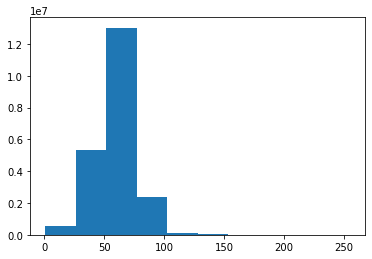

Fat Segmentation


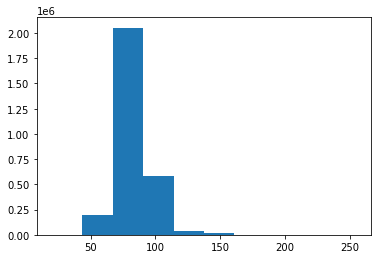

mean
59.65636476818731
standard dev
16.139751258476366
Muscle Threshold
91
before


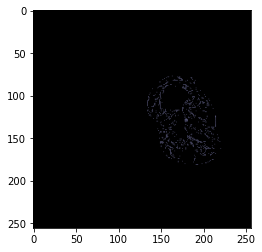

after


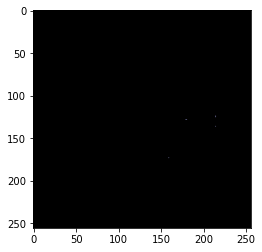

In [55]:
def correction(SegmentedFatROI,ROIArray):
    print('Muscle Segmentation')
    plt.hist([x for x in ROIArray.flatten() if x > 0])
    plt.show()
    print('Fat Segmentation')
    plt.hist([x for x in SegmentedFatROI.flatten() if x > 0])
    plt.show()
    
    musclemean=np.mean([x for x in ROIArray.flatten() if x > 0])
    musclestd=np.std([x for x in ROIArray.flatten() if x > 0])
    print("mean")
    print(musclemean)
    print("standard dev")
    print(musclestd)

    MUSCLETHRES = int(musclemean+(2*musclestd))
    print('Muscle Threshold')
    print(MUSCLETHRES)
    fatseg2 = np.where(SegmentedFatROI > MUSCLETHRES, SegmentedFatROI, 0) 
    
    print("before")
    plt.imshow(SegmentedFatROI[1],cmap='bone',vmin=0,vmax=256)
    plt.show()
    print("after")
    plt.imshow(fatseg2[1],cmap='bone',vmin=0,vmax=256)
    plt.show()
    
    return fatseg2

CorrectedFatSegmentation=np.zeros([thigharray.shape[0], thigharray.shape[1], thigharray.shape[2]], dtype='uint8')
print('Correcting Potential Segmentation Errors... Please Wait...')

CorrectedFatSegmentation=correction(fatsegR2,fleROI_R1)
FatSeg2 = fatseg+CorrectedFatSegmentation
ROI_FLE2 = ROI_FLE - FatSeg2

<ipython-input-38-c2f7cde2ea24>:29: UserWarning: Only one label was provided to `remove_small_objects`. Did you mean to use a boolean array?
  nonZ_keep = (morphology.remove_small_objects(nonZ,min_size=8, connectivity=1))


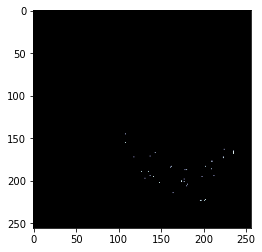

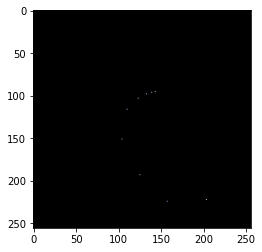

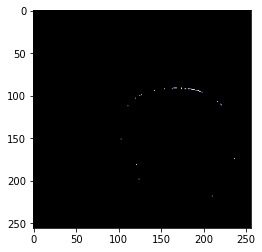

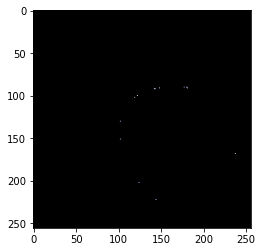

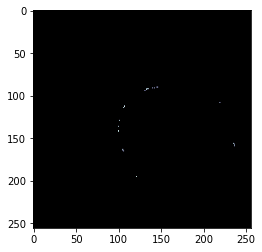

...

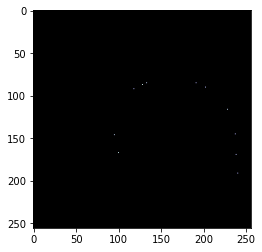

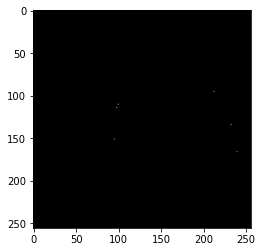

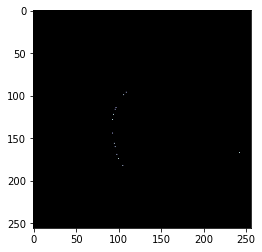

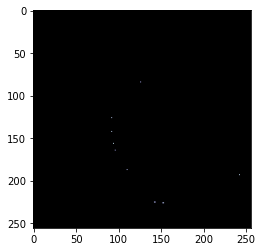

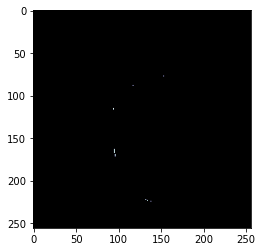

<ipython-input-42-18763098d59d>:2: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  fig, axs=plt.subplots (1,2, figsize=(15,10))


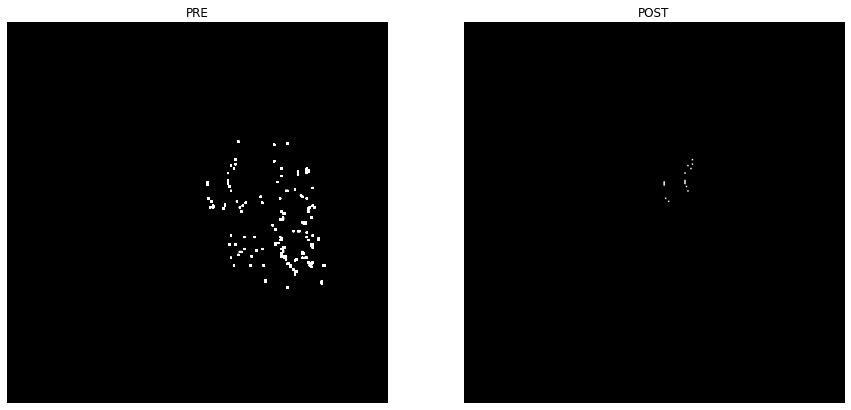

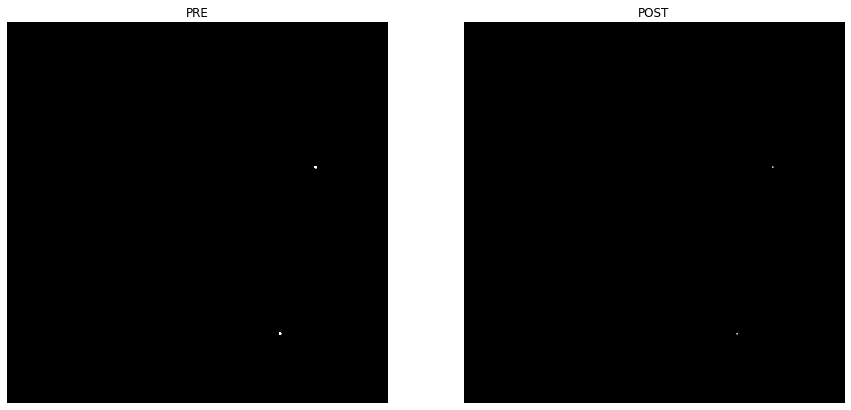

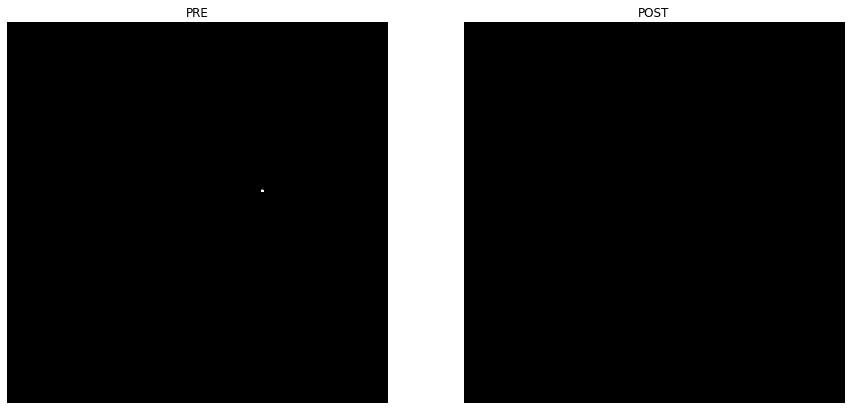

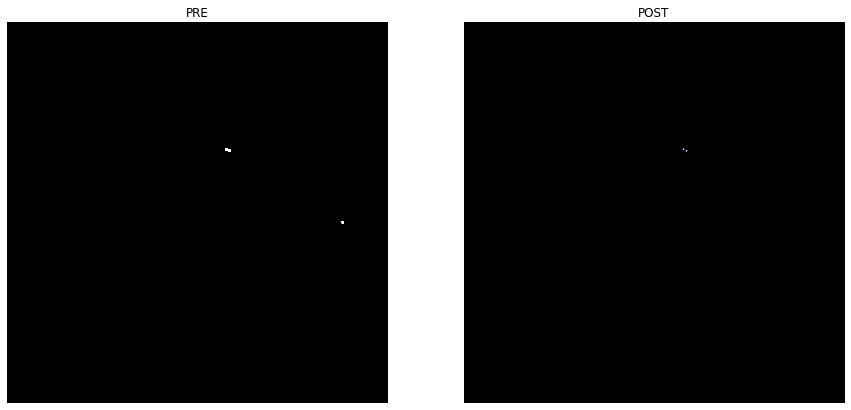

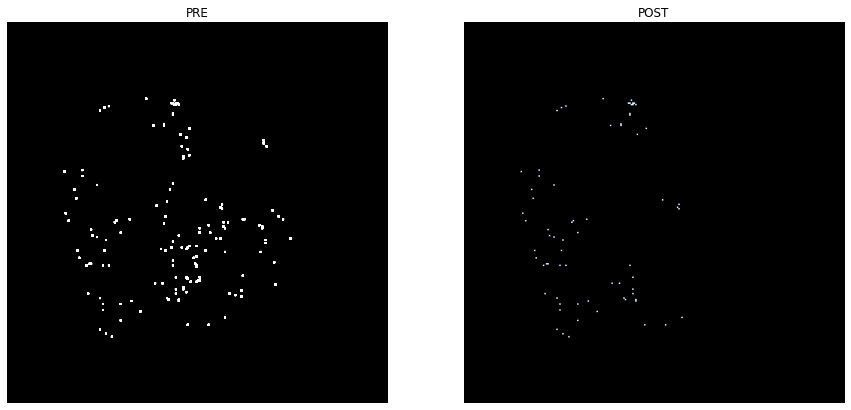

...

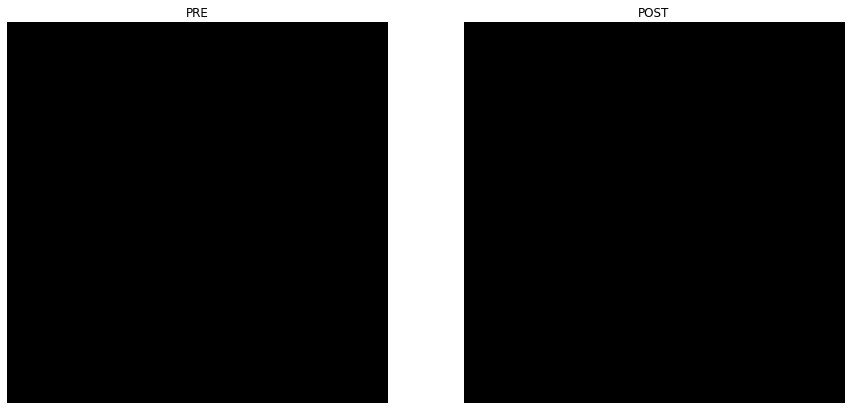

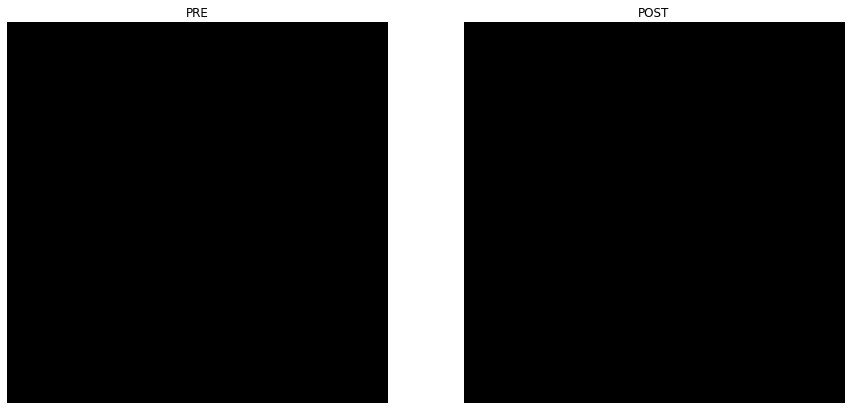

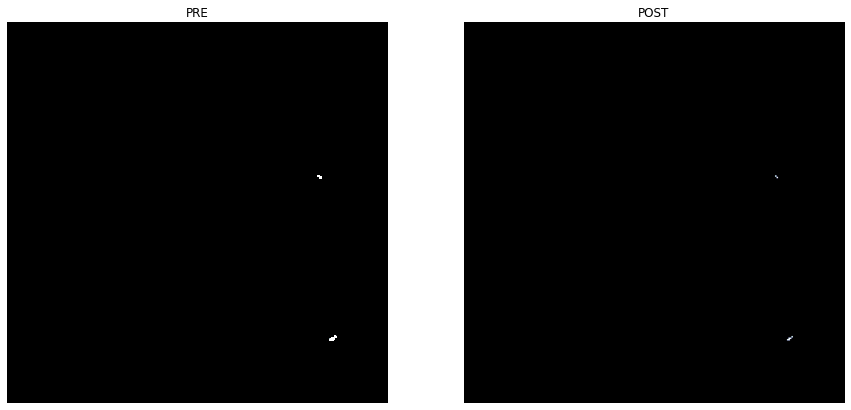

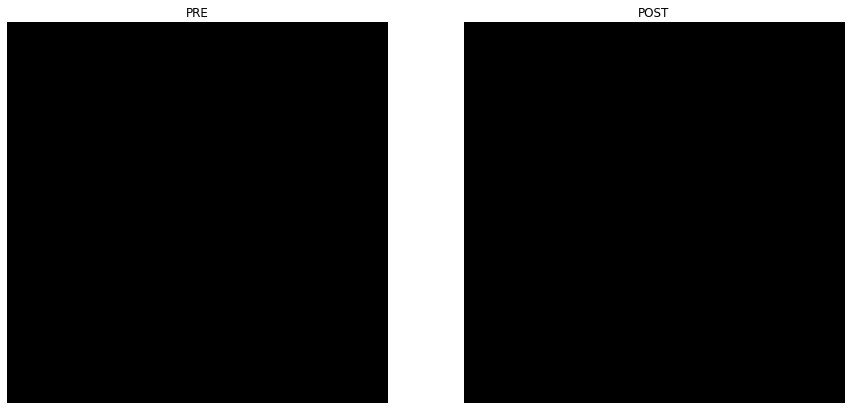

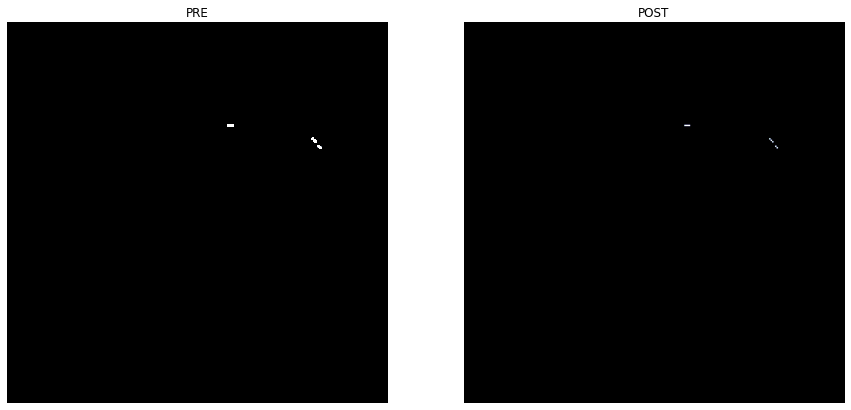

In [42]:
for i in range (0,2010,15):
    fig, axs=plt.subplots (1,2, figsize=(15,10))
    axs[0].imshow(CorrectedFatSegmentation[i],"bone",vmin=0,vmax=1)
    axs[0].set_title("PRE")
    axs[0].axis("off")
    axs[1].imshow(Post3D[i],"bone",vmin=0,vmax=1)
    axs[1].set_title('POST')
    axs[1].axis("off")

<ipython-input-16-b76651ab4edf>:4: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  fig, axs=plt.subplots (1,3, figsize=(15,10))


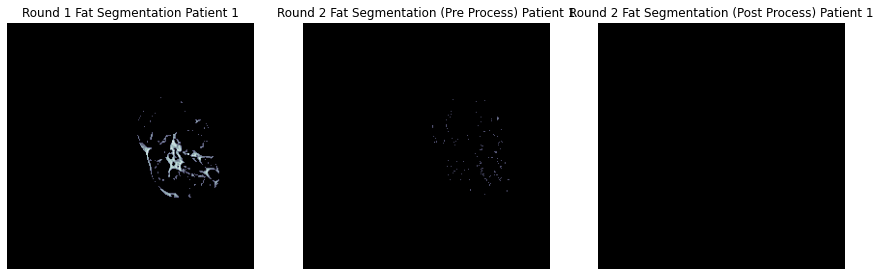

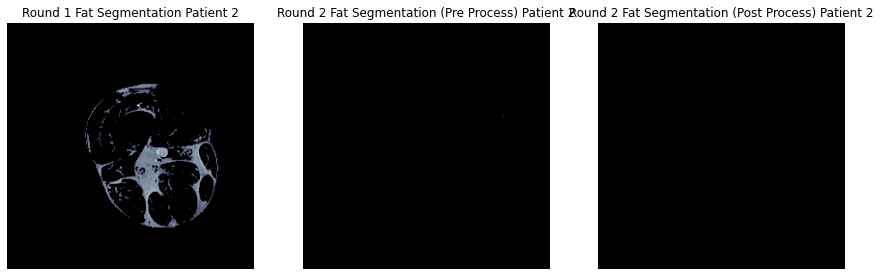

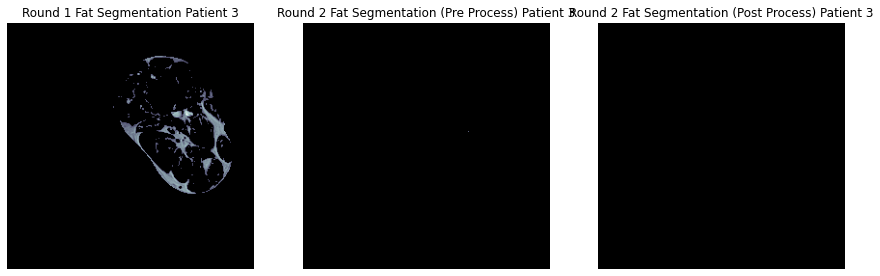

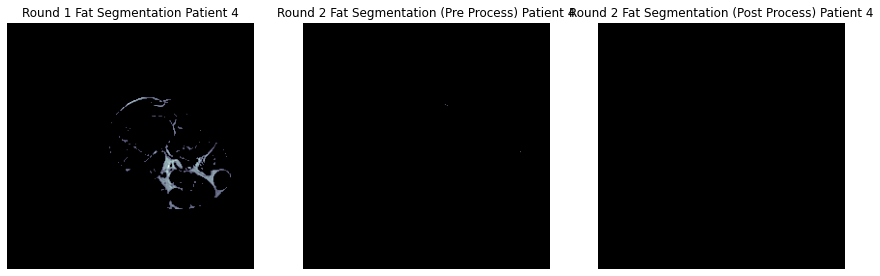

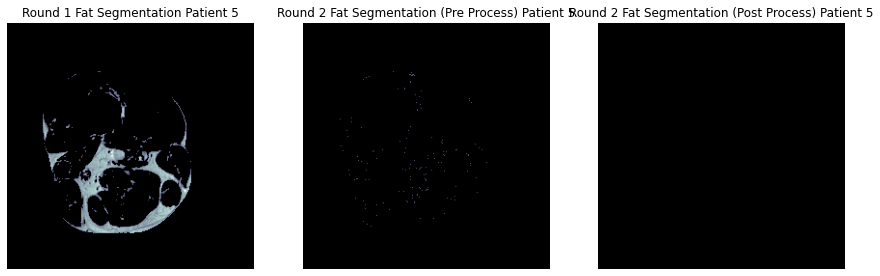

...

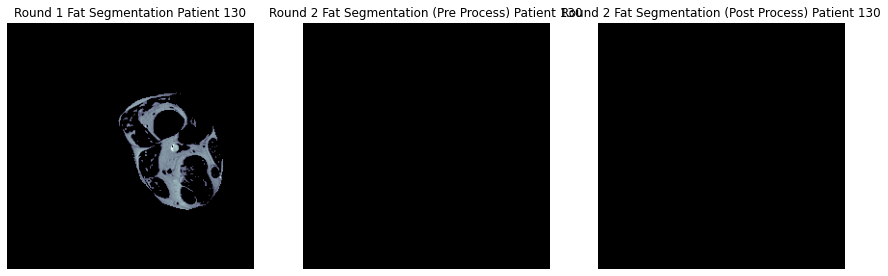

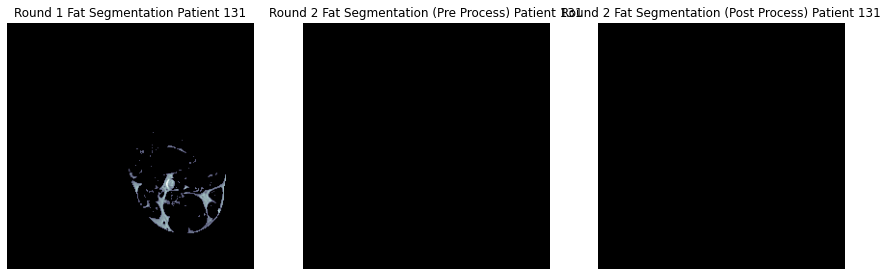

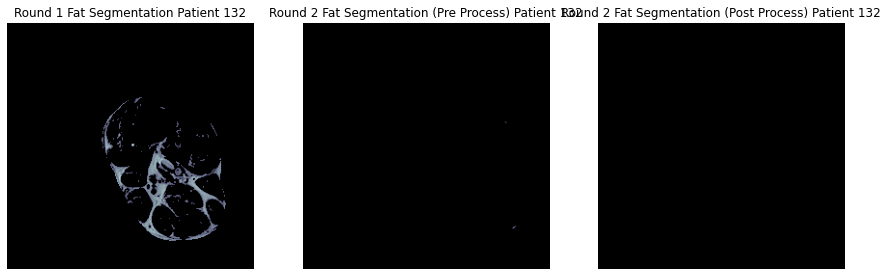

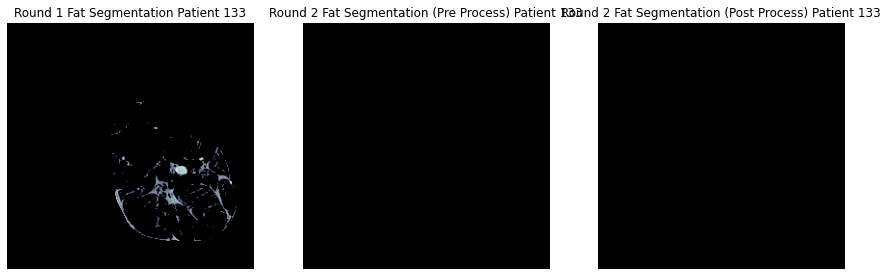

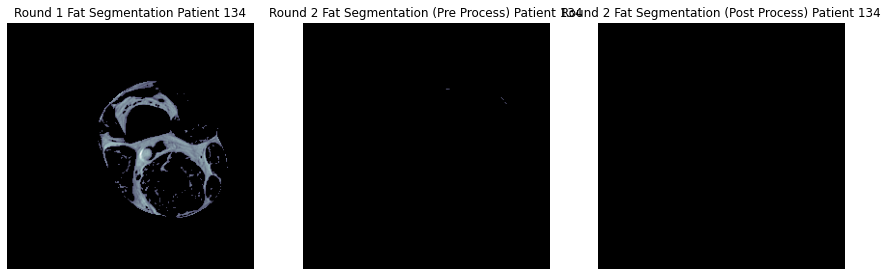

In [39]:

PatientViewer(fatseg,"Round 1 Fat Segmentation",FinalFatSegmentation,"Round 2 Fat Segmentation (Pre Process)",Post3D,"Round 2 Fat Segmentation (Post Process)")

<ipython-input-16-b76651ab4edf>:4: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  fig, axs=plt.subplots (1,3, figsize=(15,10))


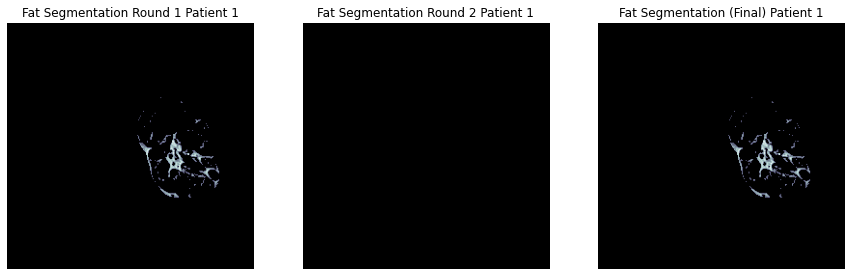

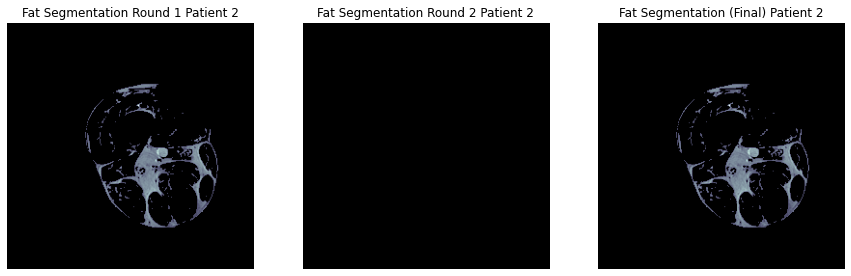

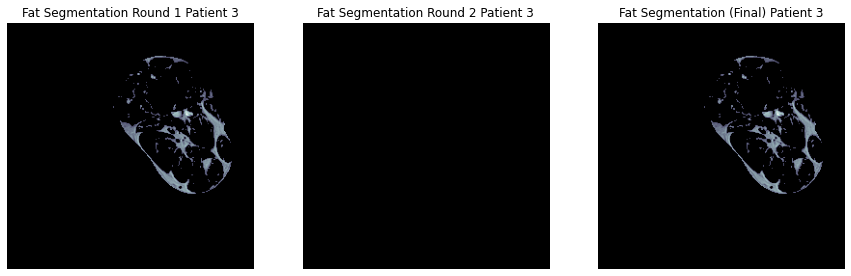

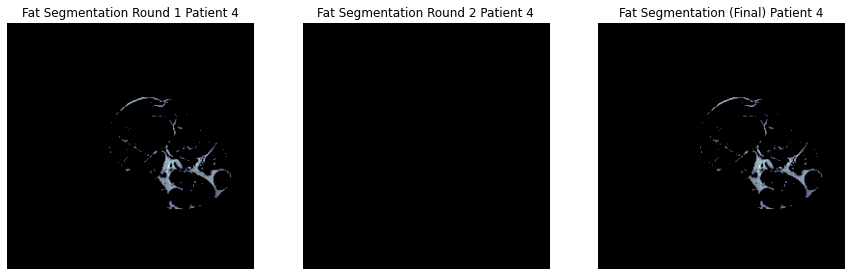

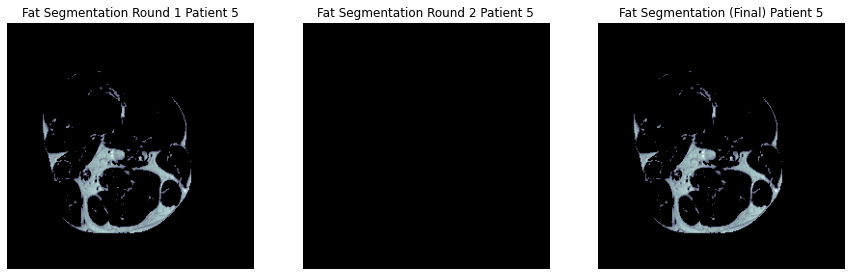

...

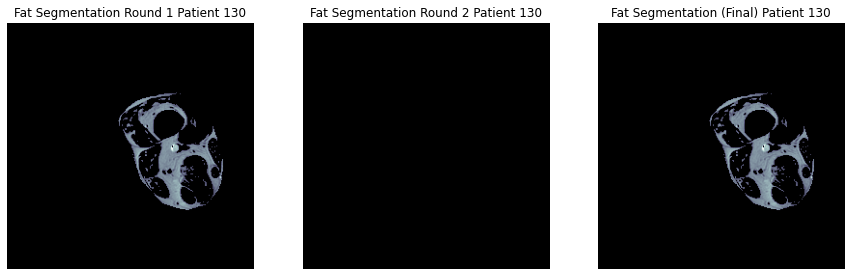

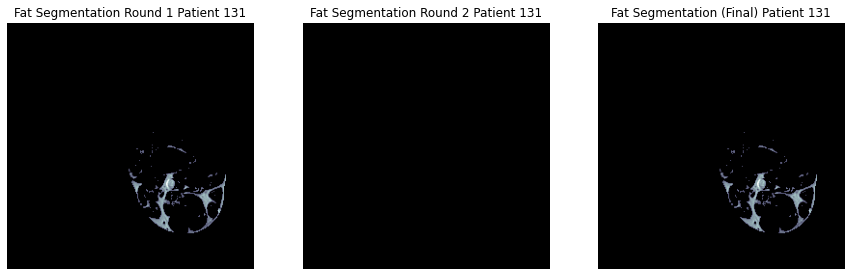

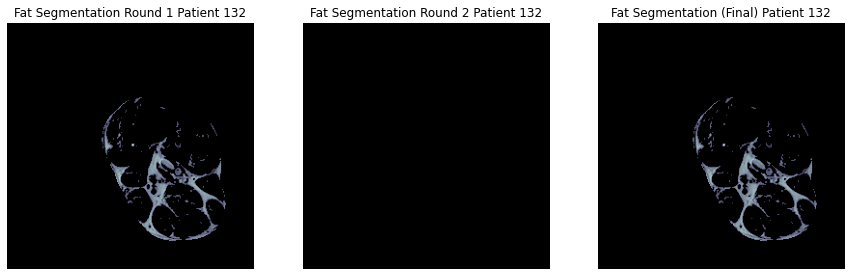

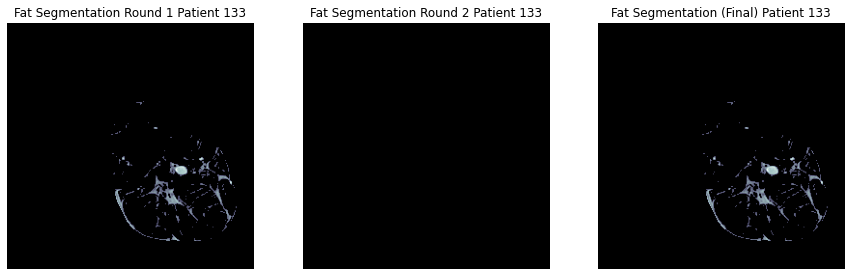

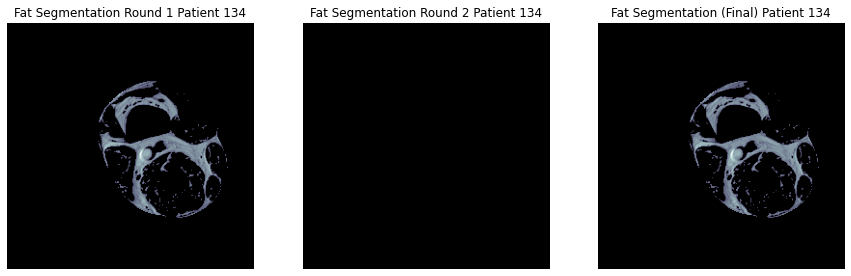

In [43]:
FinalFatSegmentation=fatseg+Post3D
FinalMuscleSegmentation=ROI_FLE-FinalFatSegmentation
PatientViewer(fatseg,"Fat Segmentation Round 1",Post3D,"Fat Segmentation Round 2",FinalFatSegmentation,"Fat Segmentation (Final)")

In [44]:
def dataexport(ROIimage,FatSegmentation,MRImage):
    muscfatarea=np.empty([num_patients,1])
    fatarea=np.empty([num_patients,1])
    muscarea=np.empty([num_patients,1])
    fatperc=np.empty([num_patients,1])
    muscfatvol=np.empty([num_patients,1])
    fatvol=np.empty([num_patients,1])
    muscvol=np.empty([num_patients,1])
    muscleroi=ROIimage-FatSegmentation
    s=0
    for i in range (0,totalslices,slicesperpatient):
        MuscFatAreaPix=0
        FatAreaPix=0
        MuscAreaPix=0
        MuscFatAreaCM=0
        FatAreaCM=0
        MuscAreaCM=0
        for x in range (0,slicesperpatient,1):
            MuscFatAreaPix+=np.sum(ROIimage[i+x]>0)
            FatAreaPix+=np.sum(FatSegmentation[i+x]>0)

        MuscFatAreaCM=MuscFatAreaPix*((MRImage.GetSpacing()[0]*MRImage.GetSpacing()[0])/100) #(InputImage.GetSpacing()[0]*InputImage.GetSpacing()[0])/10#
        FatAreaCM=FatAreaPix*((MRImage.GetSpacing()[0]*MRImage.GetSpacing()[0])/100)

        muscfatarea[s] = MuscFatAreaCM
        fatarea[s] = FatAreaCM
        muscarea[s] = MuscFatAreaCM - FatAreaCM
        
        muscfatvol[s] = muscfatarea[s]*(MRImage.GetSpacing()[2]/10)
        fatvol[s] = fatarea[s]*(MRImage.GetSpacing()[2]/10)
        muscvol[s] = muscarea[s]*(MRImage.GetSpacing()[2]/10)
        fatperc[s] = (fatarea[s]/muscfatarea[s])*100
        print(f'__________________________________________________Patient #{s+1}')
        print(tabulate([[' MUSCLE & FAT AREA', muscfatarea[s], '∑(cm^2)'] , ['FAT AREA', fatarea[s], '∑(cm^2)'],[' MUSCLE AREA', muscarea[s], '∑(cm^2)'],['FAT PERCENTAGE', fatperc[s], '%'],[' MUSCLE & FAT VOLUME', muscfatvol[s], '∑(cm^3)'],['FAT VOLUME',fatvol[s], '∑(cm^3)'],['MUSCLE VOLUME', muscvol[s], '∑(cm^3)']],     headers=['Data', 'Value','Units']))
        s+=1

    PDF=np.empty([num_patients,1])
    PDF=np.append(muscfatarea,fatarea,axis=1)
    PDF=np.append(PDF,muscarea,axis=1)
    PDF=np.append(PDF,fatperc,axis=1)
    PDF=np.append(PDF,muscfatvol,axis=1)
    PDF=np.append(PDF,fatvol,axis=1)
    PDF=np.append(PDF,muscvol,axis=1)
    return PDF

In [45]:
"ROUND 1 ITSA DATA"
PDFTHR=np.empty([num_patients,1])
PDFTHR=dataexport(ROI_FLE,fatseg,InputImage)

__________________________________________________Patient #1
Data                     Value  Units
-------------------  ---------  -------
MUSCLE & FAT AREA    1000.5     ∑(cm^2)
FAT AREA              149.794   ∑(cm^2)
MUSCLE AREA           850.706   ∑(cm^2)
FAT PERCENTAGE         14.9719  %
MUSCLE & FAT VOLUME   500.25    ∑(cm^3)
FAT VOLUME             74.8968  ∑(cm^3)
MUSCLE VOLUME         425.353   ∑(cm^3)
__________________________________________________Patient #2
Data                     Value  Units
-------------------  ---------  -------
MUSCLE & FAT AREA    2555.24    ∑(cm^2)
FAT AREA              457.23    ∑(cm^2)
MUSCLE AREA          2098.01    ∑(cm^2)
FAT PERCENTAGE         17.8938  %
MUSCLE & FAT VOLUME  1277.62    ∑(cm^3)
FAT VOLUME            228.615   ∑(cm^3)
MUSCLE VOLUME        1049       ∑(cm^3)
__________________________________________________Patient #3
Data                     Value  Units
-------------------  ---------  -------
MUSCLE & FAT AREA    1782.46    ∑(c

__________________________________________________Patient #54
Data                      Value  Units
-------------------  ----------  -------
MUSCLE & FAT AREA    1311.12     ∑(cm^2)
FAT AREA               78.907    ∑(cm^2)
MUSCLE AREA          1232.21     ∑(cm^2)
FAT PERCENTAGE          6.01829  %
MUSCLE & FAT VOLUME   655.56     ∑(cm^3)
FAT VOLUME             39.4535   ∑(cm^3)
MUSCLE VOLUME         616.107    ∑(cm^3)
__________________________________________________Patient #55
Data                     Value  Units
-------------------  ---------  -------
MUSCLE & FAT AREA    2356.96    ∑(cm^2)
FAT AREA              357.876   ∑(cm^2)
MUSCLE AREA          1999.08    ∑(cm^2)
FAT PERCENTAGE         15.1838  %
MUSCLE & FAT VOLUME  1178.48    ∑(cm^3)
FAT VOLUME            178.938   ∑(cm^3)
MUSCLE VOLUME         999.541   ∑(cm^3)
__________________________________________________Patient #56
Data                     Value  Units
-------------------  ---------  -------
MUSCLE & FAT AREA    22

__________________________________________________Patient #102
Data                     Value  Units
-------------------  ---------  -------
MUSCLE & FAT AREA    1266.79    ∑(cm^2)
FAT AREA              298.09    ∑(cm^2)
MUSCLE AREA           968.704   ∑(cm^2)
FAT PERCENTAGE         23.5311  %
MUSCLE & FAT VOLUME   633.397   ∑(cm^3)
FAT VOLUME            149.045   ∑(cm^3)
MUSCLE VOLUME         484.352   ∑(cm^3)
__________________________________________________Patient #103
Data                      Value  Units
-------------------  ----------  -------
MUSCLE & FAT AREA    2252.72     ∑(cm^2)
FAT AREA              189.772    ∑(cm^2)
MUSCLE AREA          2062.95     ∑(cm^2)
FAT PERCENTAGE          8.42411  %
MUSCLE & FAT VOLUME  1126.36     ∑(cm^3)
FAT VOLUME             94.8858   ∑(cm^3)
MUSCLE VOLUME        1031.48     ∑(cm^3)
__________________________________________________Patient #104
Data                     Value  Units
-------------------  ---------  -------
MUSCLE & FAT AREA   

In [46]:
"FINAL ROUND 2 ITSA DATA"
PDFTHR2=np.empty([num_patients,1])
PDFTHR2=dataexport(ROI_FLE,FinalFatSegmentation,InputImage)

__________________________________________________Patient #1
Data                     Value  Units
-------------------  ---------  -------
MUSCLE & FAT AREA    1000.5     ∑(cm^2)
FAT AREA              150.509   ∑(cm^2)
MUSCLE AREA           849.991   ∑(cm^2)
FAT PERCENTAGE         15.0434  %
MUSCLE & FAT VOLUME   500.25    ∑(cm^3)
FAT VOLUME             75.2544  ∑(cm^3)
MUSCLE VOLUME         424.995   ∑(cm^3)
__________________________________________________Patient #2
Data                     Value  Units
-------------------  ---------  -------
MUSCLE & FAT AREA    2555.24    ∑(cm^2)
FAT AREA              459.566   ∑(cm^2)
MUSCLE AREA          2095.67    ∑(cm^2)
FAT PERCENTAGE         17.9853  %
MUSCLE & FAT VOLUME  1277.62    ∑(cm^3)
FAT VOLUME            229.783   ∑(cm^3)
MUSCLE VOLUME        1047.84    ∑(cm^3)
__________________________________________________Patient #3
Data                    Value  Units
-------------------  --------  -------
MUSCLE & FAT AREA    1782.46   ∑(cm^2

__________________________________________________Patient #51
Data                     Value  Units
-------------------  ---------  -------
MUSCLE & FAT AREA    2413.38    ∑(cm^2)
FAT AREA              657.845   ∑(cm^2)
MUSCLE AREA          1755.53    ∑(cm^2)
FAT PERCENTAGE         27.2582  %
MUSCLE & FAT VOLUME  1206.69    ∑(cm^3)
FAT VOLUME            328.922   ∑(cm^3)
MUSCLE VOLUME         877.767   ∑(cm^3)
__________________________________________________Patient #52
Data                     Value  Units
-------------------  ---------  -------
MUSCLE & FAT AREA    2784.81    ∑(cm^2)
FAT AREA              793.228   ∑(cm^2)
MUSCLE AREA          1991.58    ∑(cm^2)
FAT PERCENTAGE         28.4842  %
MUSCLE & FAT VOLUME  1392.4     ∑(cm^3)
FAT VOLUME            396.614   ∑(cm^3)
MUSCLE VOLUME         995.789   ∑(cm^3)
__________________________________________________Patient #53
Data                     Value  Units
-------------------  ---------  -------
MUSCLE & FAT AREA    1623.54    

__________________________________________________Patient #97
Data                     Value  Units
-------------------  ---------  -------
MUSCLE & FAT AREA    1938.12    ∑(cm^2)
FAT AREA              504.265   ∑(cm^2)
MUSCLE AREA          1433.86    ∑(cm^2)
FAT PERCENTAGE         26.0182  %
MUSCLE & FAT VOLUME   969.062   ∑(cm^3)
FAT VOLUME            252.132   ∑(cm^3)
MUSCLE VOLUME         716.929   ∑(cm^3)
__________________________________________________Patient #98
Data                     Value  Units
-------------------  ---------  -------
MUSCLE & FAT AREA    1559.72    ∑(cm^2)
FAT AREA              290.689   ∑(cm^2)
MUSCLE AREA          1269.03    ∑(cm^2)
FAT PERCENTAGE         18.6373  %
MUSCLE & FAT VOLUME   779.858   ∑(cm^3)
FAT VOLUME            145.345   ∑(cm^3)
MUSCLE VOLUME         634.513   ∑(cm^3)
__________________________________________________Patient #99
Data                    Value  Units
-------------------  --------  -------
MUSCLE & FAT AREA    1976.52   ∑(c

In [47]:
"Rectus Femoris"
ROIrf=ROI_FLE*mskoutputs[:,:,:,0]
finalfatsegRF=FinalFatSegmentation*mskoutputs[:,:,:,0]
PDFRF=np.empty([num_patients,1])
PDFRF=dataexport(ROIrf,finalfatsegRF,InputImage)

__________________________________________________Patient #1
Data                     Value  Units
-------------------  ---------  -------
MUSCLE & FAT AREA    41.7709    ∑(cm^2)
FAT AREA              0.553131  ∑(cm^2)
MUSCLE AREA          41.2178    ∑(cm^2)
FAT PERCENTAGE        1.3242    %
MUSCLE & FAT VOLUME  20.8855    ∑(cm^3)
FAT VOLUME            0.276566  ∑(cm^3)
MUSCLE VOLUME        20.6089    ∑(cm^3)
__________________________________________________Patient #2
Data                    Value  Units
-------------------  --------  -------
MUSCLE & FAT AREA    38.9385   ∑(cm^2)
FAT AREA              3.69072  ∑(cm^2)
MUSCLE AREA          35.2478   ∑(cm^2)
FAT PERCENTAGE        9.47832  %
MUSCLE & FAT VOLUME  19.4693   ∑(cm^3)
FAT VOLUME            1.84536  ∑(cm^3)
MUSCLE VOLUME        17.6239   ∑(cm^3)
__________________________________________________Patient #3
Data                    Value  Units
-------------------  --------  -------
MUSCLE & FAT AREA    61.0065   ∑(cm^2)
FAT ARE

MUSCLE VOLUME        18.096    ∑(cm^3)
__________________________________________________Patient #23
Data                      Value  Units
-------------------  ----------  -------
MUSCLE & FAT AREA    48.7804     ∑(cm^2)
FAT AREA              0.190735   ∑(cm^2)
MUSCLE AREA          48.5897     ∑(cm^2)
FAT PERCENTAGE        0.391007   %
MUSCLE & FAT VOLUME  24.3902     ∑(cm^3)
FAT VOLUME            0.0953674  ∑(cm^3)
MUSCLE VOLUME        24.2949     ∑(cm^3)
__________________________________________________Patient #24
Data                     Value  Units
-------------------  ---------  -------
MUSCLE & FAT AREA    30.2505    ∑(cm^2)
FAT AREA              1.297     ∑(cm^2)
MUSCLE AREA          28.9536    ∑(cm^2)
FAT PERCENTAGE        4.28752   %
MUSCLE & FAT VOLUME  15.1253    ∑(cm^3)
FAT VOLUME            0.648499  ∑(cm^3)
MUSCLE VOLUME        14.4768    ∑(cm^3)
__________________________________________________Patient #25
Data                     Value  Units
-------------------  ---

MUSCLE VOLUME         5.6982    ∑(cm^3)
__________________________________________________Patient #59
Data                     Value  Units
-------------------  ---------  -------
MUSCLE & FAT AREA    46.2818    ∑(cm^2)
FAT AREA              0.200272  ∑(cm^2)
MUSCLE AREA          46.0815    ∑(cm^2)
FAT PERCENTAGE        0.432722  %
MUSCLE & FAT VOLUME  23.1409    ∑(cm^3)
FAT VOLUME            0.100136  ∑(cm^3)
MUSCLE VOLUME        23.0408    ∑(cm^3)
__________________________________________________Patient #60
Data                     Value  Units
-------------------  ---------  -------
MUSCLE & FAT AREA    39.2056    ∑(cm^2)
FAT AREA              0.295639  ∑(cm^2)
MUSCLE AREA          38.9099    ∑(cm^2)
FAT PERCENTAGE        0.754074  %
MUSCLE & FAT VOLUME  19.6028    ∑(cm^3)
FAT VOLUME            0.14782   ∑(cm^3)
MUSCLE VOLUME        19.455     ∑(cm^3)
__________________________________________________Patient #61
Data                     Value  Units
-------------------  ---------  

__________________________________________________Patient #95
Data                      Value  Units
-------------------  ----------  -------
MUSCLE & FAT AREA    42.3241     ∑(cm^2)
FAT AREA              0.152588   ∑(cm^2)
MUSCLE AREA          42.1715     ∑(cm^2)
FAT PERCENTAGE        0.360523   %
MUSCLE & FAT VOLUME  21.162      ∑(cm^3)
FAT VOLUME            0.0762939  ∑(cm^3)
MUSCLE VOLUME        21.0857     ∑(cm^3)
__________________________________________________Patient #96
Data                     Value  Units
-------------------  ---------  -------
MUSCLE & FAT AREA    46.6537    ∑(cm^2)
FAT AREA              0.762939  ∑(cm^2)
MUSCLE AREA          45.8908    ∑(cm^2)
FAT PERCENTAGE        1.63532   %
MUSCLE & FAT VOLUME  23.3269    ∑(cm^3)
FAT VOLUME            0.38147   ∑(cm^3)
MUSCLE VOLUME        22.9454    ∑(cm^3)
__________________________________________________Patient #97
Data                     Value  Units
-------------------  ---------  -------
MUSCLE & FAT AREA    35

In [48]:
"Vastus Group"
ROIvg=ROI_FLE*mskoutputs[:,:,:,1]
finalfatsegVG=FinalFatSegmentation*mskoutputs[:,:,:,1]
PDFVG=np.empty([num_patients,1])
PDFVG=dataexport(ROIvg,finalfatsegVG,InputImage)

__________________________________________________Patient #1
Data                     Value  Units
-------------------  ---------  -------
MUSCLE & FAT AREA    369.816    ∑(cm^2)
FAT AREA              25.301    ∑(cm^2)
MUSCLE AREA          344.515    ∑(cm^2)
FAT PERCENTAGE         6.84151  %
MUSCLE & FAT VOLUME  184.908    ∑(cm^3)
FAT VOLUME            12.6505   ∑(cm^3)
MUSCLE VOLUME        172.257    ∑(cm^3)
__________________________________________________Patient #2
Data                      Value  Units
-------------------  ----------  -------
MUSCLE & FAT AREA    1066.42     ∑(cm^2)
FAT AREA               56.2477   ∑(cm^2)
MUSCLE AREA          1010.17     ∑(cm^2)
FAT PERCENTAGE          5.27445  %
MUSCLE & FAT VOLUME   533.209    ∑(cm^3)
FAT VOLUME             28.1239   ∑(cm^3)
MUSCLE VOLUME         505.085    ∑(cm^3)
__________________________________________________Patient #3
Data                     Value  Units
-------------------  ---------  -------
MUSCLE & FAT AREA    590.0

__________________________________________________Patient #35
Data                     Value  Units
-------------------  ---------  -------
MUSCLE & FAT AREA    744.305    ∑(cm^2)
FAT AREA              19.4073   ∑(cm^2)
MUSCLE AREA          724.897    ∑(cm^2)
FAT PERCENTAGE         2.60744  %
MUSCLE & FAT VOLUME  372.152    ∑(cm^3)
FAT VOLUME             9.70364  ∑(cm^3)
MUSCLE VOLUME        362.449    ∑(cm^3)
__________________________________________________Patient #36
Data                     Value  Units
-------------------  ---------  -------
MUSCLE & FAT AREA    634.279    ∑(cm^2)
FAT AREA              55.2845   ∑(cm^2)
MUSCLE AREA          578.995    ∑(cm^2)
FAT PERCENTAGE         8.71611  %
MUSCLE & FAT VOLUME  317.14     ∑(cm^3)
FAT VOLUME            27.6423   ∑(cm^3)
MUSCLE VOLUME        289.497    ∑(cm^3)
__________________________________________________Patient #37
Data                    Value  Units
-------------------  --------  -------
MUSCLE & FAT AREA    502.138   ∑(c

__________________________________________________Patient #73
Data                     Value  Units
-------------------  ---------  -------
MUSCLE & FAT AREA    410.604    ∑(cm^2)
FAT AREA              23.2029   ∑(cm^2)
MUSCLE AREA          387.402    ∑(cm^2)
FAT PERCENTAGE         5.65091  %
MUSCLE & FAT VOLUME  205.302    ∑(cm^3)
FAT VOLUME            11.6014   ∑(cm^3)
MUSCLE VOLUME        193.701    ∑(cm^3)
__________________________________________________Patient #74
Data                      Value  Units
-------------------  ----------  -------
MUSCLE & FAT AREA    1240.37     ∑(cm^2)
FAT AREA               78.5828   ∑(cm^2)
MUSCLE AREA          1161.79     ∑(cm^2)
FAT PERCENTAGE          6.33544  %
MUSCLE & FAT VOLUME   620.184    ∑(cm^3)
FAT VOLUME             39.2914   ∑(cm^3)
MUSCLE VOLUME         580.893    ∑(cm^3)
__________________________________________________Patient #75
Data                     Value  Units
-------------------  ---------  -------
MUSCLE & FAT AREA    58

__________________________________________________Patient #113
Data                      Value  Units
-------------------  ----------  -------
MUSCLE & FAT AREA    1274.39     ∑(cm^2)
FAT AREA               69.2844   ∑(cm^2)
MUSCLE AREA          1205.11     ∑(cm^2)
FAT PERCENTAGE          5.43665  %
MUSCLE & FAT VOLUME   637.197    ∑(cm^3)
FAT VOLUME             34.6422   ∑(cm^3)
MUSCLE VOLUME         602.555    ∑(cm^3)
__________________________________________________Patient #114
Data                     Value  Units
-------------------  ---------  -------
MUSCLE & FAT AREA    679.379    ∑(cm^2)
FAT AREA              37.4031   ∑(cm^2)
MUSCLE AREA          641.975    ∑(cm^2)
FAT PERCENTAGE         5.50549  %
MUSCLE & FAT VOLUME  339.689    ∑(cm^3)
FAT VOLUME            18.7016   ∑(cm^3)
MUSCLE VOLUME        320.988    ∑(cm^3)
__________________________________________________Patient #115
Data                     Value  Units
-------------------  ---------  -------
MUSCLE & FAT AREA   

In [49]:
"Gracilis"
ROIgr=ROI_FLE*mskoutputs[:,:,:,3]
finalfatsegGR=FinalFatSegmentation*mskoutputs[:,:,:,3]
PDFGR=np.empty([num_patients,1])
PDFGR=dataexport(ROIgr,finalfatsegGR,InputImage)

__________________________________________________Patient #1
Data                    Value  Units
-------------------  --------  -------
MUSCLE & FAT AREA    26.3023   ∑(cm^2)
FAT AREA              2.25067  ∑(cm^2)
MUSCLE AREA          24.0517   ∑(cm^2)
FAT PERCENTAGE        8.55693  %
MUSCLE & FAT VOLUME  13.1512   ∑(cm^3)
FAT VOLUME            1.12534  ∑(cm^3)
MUSCLE VOLUME        12.0258   ∑(cm^3)
__________________________________________________Patient #2
Data                    Value  Units
-------------------  --------  -------
MUSCLE & FAT AREA    67.1768   ∑(cm^2)
FAT AREA              5.5027   ∑(cm^2)
MUSCLE AREA          61.6741   ∑(cm^2)
FAT PERCENTAGE        8.19137  %
MUSCLE & FAT VOLUME  33.5884   ∑(cm^3)
FAT VOLUME            2.75135  ∑(cm^3)
MUSCLE VOLUME        30.8371   ∑(cm^3)
__________________________________________________Patient #3
Data                    Value  Units
-------------------  --------  -------
MUSCLE & FAT AREA    61.0733   ∑(cm^2)
FAT AREA        

__________________________________________________Patient #43
Data                    Value  Units
-------------------  --------  -------
MUSCLE & FAT AREA    27.2942   ∑(cm^2)
FAT AREA              2.35558  ∑(cm^2)
MUSCLE AREA          24.9386   ∑(cm^2)
FAT PERCENTAGE        8.63033  %
MUSCLE & FAT VOLUME  13.6471   ∑(cm^3)
FAT VOLUME            1.17779  ∑(cm^3)
MUSCLE VOLUME        12.4693   ∑(cm^3)
__________________________________________________Patient #44
Data                    Value  Units
-------------------  --------  -------
MUSCLE & FAT AREA    41.6183   ∑(cm^2)
FAT AREA              8.05855  ∑(cm^2)
MUSCLE AREA          33.5598   ∑(cm^2)
FAT PERCENTAGE       19.363    %
MUSCLE & FAT VOLUME  20.8092   ∑(cm^3)
FAT VOLUME            4.02927  ∑(cm^3)
MUSCLE VOLUME        16.7799   ∑(cm^3)
__________________________________________________Patient #45
Data                       Value  Units
-------------------  -----------  -------
MUSCLE & FAT AREA     17.8814     ∑(cm^2)
FAT 

__________________________________________________Patient #86
Data                    Value  Units
-------------------  --------  -------
MUSCLE & FAT AREA    72.4792   ∑(cm^2)
FAT AREA              2.68936  ∑(cm^2)
MUSCLE AREA          69.7899   ∑(cm^2)
FAT PERCENTAGE        3.71053  %
MUSCLE & FAT VOLUME  36.2396   ∑(cm^3)
FAT VOLUME            1.34468  ∑(cm^3)
MUSCLE VOLUME        34.8949   ∑(cm^3)
__________________________________________________Patient #87
Data                    Value  Units
-------------------  --------  -------
MUSCLE & FAT AREA    56.3431   ∑(cm^2)
FAT AREA              3.84331  ∑(cm^2)
MUSCLE AREA          52.4998   ∑(cm^2)
FAT PERCENTAGE        6.82126  %
MUSCLE & FAT VOLUME  28.1715   ∑(cm^3)
FAT VOLUME            1.92165  ∑(cm^3)
MUSCLE VOLUME        26.2499   ∑(cm^3)
__________________________________________________Patient #88
Data                    Value  Units
-------------------  --------  -------
MUSCLE & FAT AREA    39.3867   ∑(cm^2)
FAT AREA     

__________________________________________________Patient #120
Data                    Value  Units
-------------------  --------  -------
MUSCLE & FAT AREA    43.7069   ∑(cm^2)
FAT AREA              5.72205  ∑(cm^2)
MUSCLE AREA          37.9848   ∑(cm^2)
FAT PERCENTAGE       13.0919   %
MUSCLE & FAT VOLUME  21.8534   ∑(cm^3)
FAT VOLUME            2.86102  ∑(cm^3)
MUSCLE VOLUME        18.9924   ∑(cm^3)
__________________________________________________Patient #121
Data                    Value  Units
-------------------  --------  -------
MUSCLE & FAT AREA    56.4957   ∑(cm^2)
FAT AREA              5.31197  ∑(cm^2)
MUSCLE AREA          51.1837   ∑(cm^2)
FAT PERCENTAGE        9.40243  %
MUSCLE & FAT VOLUME  28.2478   ∑(cm^3)
FAT VOLUME            2.65598  ∑(cm^3)
MUSCLE VOLUME        25.5919   ∑(cm^3)
__________________________________________________Patient #122
Data                    Value  Units
-------------------  --------  -------
MUSCLE & FAT AREA    28.8963   ∑(cm^2)
FAT AREA  

In [50]:
"Sartorius"
ROIsr=ROI_FLE*mskoutputs[:,:,:,4]
finalfatsegSR=FinalFatSegmentation*mskoutputs[:,:,:,4]
PDFSR=np.empty([num_patients,1])
PDFSR=dataexport(ROIsr,finalfatsegSR,InputImage)

__________________________________________________Patient #1
Data                    Value  Units
-------------------  --------  -------
MUSCLE & FAT AREA    22.8214   ∑(cm^2)
FAT AREA              4.37737  ∑(cm^2)
MUSCLE AREA          18.4441   ∑(cm^2)
FAT PERCENTAGE       19.1809   %
MUSCLE & FAT VOLUME  11.4107   ∑(cm^3)
FAT VOLUME            2.18868  ∑(cm^3)
MUSCLE VOLUME         9.22203  ∑(cm^3)
__________________________________________________Patient #2
Data                    Value  Units
-------------------  --------  -------
MUSCLE & FAT AREA    62.7995   ∑(cm^2)
FAT AREA              7.47681  ∑(cm^2)
MUSCLE AREA          55.3226   ∑(cm^2)
FAT PERCENTAGE       11.9058   %
MUSCLE & FAT VOLUME  31.3997   ∑(cm^3)
FAT VOLUME            3.7384   ∑(cm^3)
MUSCLE VOLUME        27.6613   ∑(cm^3)
__________________________________________________Patient #3
Data                    Value  Units
-------------------  --------  -------
MUSCLE & FAT AREA    43.3445   ∑(cm^2)
FAT AREA        

__________________________________________________Patient #41
Data                    Value  Units
-------------------  --------  -------
MUSCLE & FAT AREA    38.0516   ∑(cm^2)
FAT AREA              2.82288  ∑(cm^2)
MUSCLE AREA          35.2287   ∑(cm^2)
FAT PERCENTAGE        7.41855  %
MUSCLE & FAT VOLUME  19.0258   ∑(cm^3)
FAT VOLUME            1.41144  ∑(cm^3)
MUSCLE VOLUME        17.6144   ∑(cm^3)
__________________________________________________Patient #42
Data                    Value  Units
-------------------  --------  -------
MUSCLE & FAT AREA    80.6236   ∑(cm^2)
FAT AREA             12.4454   ∑(cm^2)
MUSCLE AREA          68.1782   ∑(cm^2)
FAT PERCENTAGE       15.4365   %
MUSCLE & FAT VOLUME  40.3118   ∑(cm^3)
FAT VOLUME            6.22272  ∑(cm^3)
MUSCLE VOLUME        34.0891   ∑(cm^3)
__________________________________________________Patient #43
Data                    Value  Units
-------------------  --------  -------
MUSCLE & FAT AREA    32.053    ∑(cm^2)
FAT AREA     

__________________________________________________Patient #78
Data                    Value  Units
-------------------  --------  -------
MUSCLE & FAT AREA    58.4984   ∑(cm^2)
FAT AREA              3.15666  ∑(cm^2)
MUSCLE AREA          55.3417   ∑(cm^2)
FAT PERCENTAGE        5.39615  %
MUSCLE & FAT VOLUME  29.2492   ∑(cm^3)
FAT VOLUME            1.57833  ∑(cm^3)
MUSCLE VOLUME        27.6709   ∑(cm^3)
__________________________________________________Patient #79
Data                    Value  Units
-------------------  --------  -------
MUSCLE & FAT AREA    37.5175   ∑(cm^2)
FAT AREA              2.19345  ∑(cm^2)
MUSCLE AREA          35.3241   ∑(cm^2)
FAT PERCENTAGE        5.84647  %
MUSCLE & FAT VOLUME  18.7588   ∑(cm^3)
FAT VOLUME            1.09673  ∑(cm^3)
MUSCLE VOLUME        17.662    ∑(cm^3)
__________________________________________________Patient #80
Data                    Value  Units
-------------------  --------  -------
MUSCLE & FAT AREA    40.102    ∑(cm^2)
FAT AREA     

__________________________________________________Patient #112
Data                    Value  Units
-------------------  --------  -------
MUSCLE & FAT AREA    61.0638   ∑(cm^2)
FAT AREA             10.2329   ∑(cm^2)
MUSCLE AREA          50.8308   ∑(cm^2)
FAT PERCENTAGE       16.7578   %
MUSCLE & FAT VOLUME  30.5319   ∑(cm^3)
FAT VOLUME            5.11646  ∑(cm^3)
MUSCLE VOLUME        25.4154   ∑(cm^3)
__________________________________________________Patient #113
Data                    Value  Units
-------------------  --------  -------
MUSCLE & FAT AREA    82.0732   ∑(cm^2)
FAT AREA             11.8065   ∑(cm^2)
MUSCLE AREA          70.2667   ∑(cm^2)
FAT PERCENTAGE       14.3853   %
MUSCLE & FAT VOLUME  41.0366   ∑(cm^3)
FAT VOLUME            5.90324  ∑(cm^3)
MUSCLE VOLUME        35.1334   ∑(cm^3)
__________________________________________________Patient #114
Data                    Value  Units
-------------------  --------  -------
MUSCLE & FAT AREA    52.2041   ∑(cm^2)
FAT AREA  

In [51]:
"Adductors"
ROIad=ROI_FLE*mskoutputs[:,:,:,5]
finalfatsegAD=FinalFatSegmentation*mskoutputs[:,:,:,5]
PDFAD=np.empty([num_patients,1])
PDFAD=dataexport(ROIad,finalfatsegAD,InputImage)

__________________________________________________Patient #1
Data                     Value  Units
-------------------  ---------  -------
MUSCLE & FAT AREA    132.284    ∑(cm^2)
FAT AREA              12.6076   ∑(cm^2)
MUSCLE AREA          119.677    ∑(cm^2)
FAT PERCENTAGE         9.53068  %
MUSCLE & FAT VOLUME   66.1421   ∑(cm^3)
FAT VOLUME             6.30379  ∑(cm^3)
MUSCLE VOLUME         59.8383   ∑(cm^3)
__________________________________________________Patient #2
Data                    Value  Units
-------------------  --------  -------
MUSCLE & FAT AREA    237.761   ∑(cm^2)
FAT AREA              34.3609  ∑(cm^2)
MUSCLE AREA          203.4     ∑(cm^2)
FAT PERCENTAGE        14.4519  %
MUSCLE & FAT VOLUME  118.88    ∑(cm^3)
FAT VOLUME            17.1804  ∑(cm^3)
MUSCLE VOLUME        101.7     ∑(cm^3)
__________________________________________________Patient #3
Data                    Value  Units
-------------------  --------  -------
MUSCLE & FAT AREA    374.336   ∑(cm^2)
FAT ARE

<ipython-input-44-5ac46dd8b307>:32: RuntimeWarning: invalid value encountered in true_divide
  fatperc[s] = (fatarea[s]/muscfatarea[s])*100


__________________________________________________Patient #30
Data                     Value  Units
-------------------  ---------  -------
MUSCLE & FAT AREA     8.91685   ∑(cm^2)
FAT AREA              1.77383   ∑(cm^2)
MUSCLE AREA           7.14302   ∑(cm^2)
FAT PERCENTAGE       19.893     %
MUSCLE & FAT VOLUME   4.45843   ∑(cm^3)
FAT VOLUME            0.886917  ∑(cm^3)
MUSCLE VOLUME         3.57151   ∑(cm^3)
__________________________________________________Patient #31
Data                    Value  Units
-------------------  --------  -------
MUSCLE & FAT AREA    66.2994   ∑(cm^2)
FAT AREA             11.0912   ∑(cm^2)
MUSCLE AREA          55.2082   ∑(cm^2)
FAT PERCENTAGE       16.729    %
MUSCLE & FAT VOLUME  33.1497   ∑(cm^3)
FAT VOLUME            5.54562  ∑(cm^3)
MUSCLE VOLUME        27.6041   ∑(cm^3)
__________________________________________________Patient #32
Data                     Value  Units
-------------------  ---------  -------
MUSCLE & FAT AREA    150.48     ∑(cm^2)
F

__________________________________________________Patient #57
Data                     Value  Units
-------------------  ---------  -------
MUSCLE & FAT AREA    169.373    ∑(cm^2)
FAT AREA              13.5136   ∑(cm^2)
MUSCLE AREA          155.859    ∑(cm^2)
FAT PERCENTAGE         7.9786   %
MUSCLE & FAT VOLUME   84.6863   ∑(cm^3)
FAT VOLUME             6.75678  ∑(cm^3)
MUSCLE VOLUME         77.9295   ∑(cm^3)
__________________________________________________Patient #58
Data                    Value  Units
-------------------  --------  -------
MUSCLE & FAT AREA    31.3759   ∑(cm^2)
FAT AREA             12.7029   ∑(cm^2)
MUSCLE AREA          18.6729   ∑(cm^2)
FAT PERCENTAGE       40.4863   %
MUSCLE & FAT VOLUME  15.6879   ∑(cm^3)
FAT VOLUME            6.35147  ∑(cm^3)
MUSCLE VOLUME         9.33647  ∑(cm^3)
__________________________________________________Patient #59
Data                    Value  Units
-------------------  --------  -------
MUSCLE & FAT AREA    64.6019   ∑(cm^2)
FAT 

__________________________________________________Patient #86
Data                     Value  Units
-------------------  ---------  -------
MUSCLE & FAT AREA    128.241    ∑(cm^2)
FAT AREA               6.47545  ∑(cm^2)
MUSCLE AREA          121.765    ∑(cm^2)
FAT PERCENTAGE         5.04945  %
MUSCLE & FAT VOLUME   64.1203   ∑(cm^3)
FAT VOLUME             3.23772  ∑(cm^3)
MUSCLE VOLUME         60.8826   ∑(cm^3)
__________________________________________________Patient #87
Data                     Value  Units
-------------------  ---------  -------
MUSCLE & FAT AREA    256.5      ∑(cm^2)
FAT AREA               9.64165  ∑(cm^2)
MUSCLE AREA          246.859    ∑(cm^2)
FAT PERCENTAGE         3.75892  %
MUSCLE & FAT VOLUME  128.25     ∑(cm^3)
FAT VOLUME             4.82082  ∑(cm^3)
MUSCLE VOLUME        123.429    ∑(cm^3)
__________________________________________________Patient #88
Data                    Value  Units
-------------------  --------  -------
MUSCLE & FAT AREA    23.1266   ∑(c

__________________________________________________Patient #127
Data                    Value  Units
-------------------  --------  -------
MUSCLE & FAT AREA    68.7027   ∑(cm^2)
FAT AREA             13.7711   ∑(cm^2)
MUSCLE AREA          54.9316   ∑(cm^2)
FAT PERCENTAGE       20.0444   %
MUSCLE & FAT VOLUME  34.3513   ∑(cm^3)
FAT VOLUME            6.88553  ∑(cm^3)
MUSCLE VOLUME        27.4658   ∑(cm^3)
__________________________________________________Patient #128
Data                     Value  Units
-------------------  ---------  -------
MUSCLE & FAT AREA    177.24     ∑(cm^2)
FAT AREA               9.04083  ∑(cm^2)
MUSCLE AREA          168.2      ∑(cm^2)
FAT PERCENTAGE         5.10089  %
MUSCLE & FAT VOLUME   88.6202   ∑(cm^3)
FAT VOLUME             4.52042  ∑(cm^3)
MUSCLE VOLUME         84.0998   ∑(cm^3)
__________________________________________________Patient #129
Data                     Value  Units
-------------------  ---------  -------
MUSCLE & FAT AREA     3.14713   ∑(cm^2

In [52]:
"bicepsfemoris"
ROIbf=ROI_FLE*mskoutputs[:,:,:,6]
finalfatsegBF=FinalFatSegmentation*mskoutputs[:,:,:,6]
PDFBF=np.empty([num_patients,1])
PDFBF=dataexport(ROIbf,finalfatsegBF,InputImage)

__________________________________________________Patient #1
Data                     Value  Units
-------------------  ---------  -------
MUSCLE & FAT AREA    130.529    ∑(cm^2)
FAT AREA              17.5095   ∑(cm^2)
MUSCLE AREA          113.02     ∑(cm^2)
FAT PERCENTAGE        13.4142   %
MUSCLE & FAT VOLUME   65.2647   ∑(cm^3)
FAT VOLUME             8.75473  ∑(cm^3)
MUSCLE VOLUME         56.51     ∑(cm^3)
__________________________________________________Patient #2
Data                    Value  Units
-------------------  --------  -------
MUSCLE & FAT AREA    358.915   ∑(cm^2)
FAT AREA              37.7274  ∑(cm^2)
MUSCLE AREA          321.188   ∑(cm^2)
FAT PERCENTAGE        10.5115  %
MUSCLE & FAT VOLUME  179.458   ∑(cm^3)
FAT VOLUME            18.8637  ∑(cm^3)
MUSCLE VOLUME        160.594   ∑(cm^3)
__________________________________________________Patient #3
Data                    Value  Units
-------------------  --------  -------
MUSCLE & FAT AREA    190.268   ∑(cm^2)
FAT ARE

__________________________________________________Patient #38
Data                    Value  Units
-------------------  --------  -------
MUSCLE & FAT AREA    396.28    ∑(cm^2)
FAT AREA              44.3554  ∑(cm^2)
MUSCLE AREA          351.925   ∑(cm^2)
FAT PERCENTAGE        11.1929  %
MUSCLE & FAT VOLUME  198.14    ∑(cm^3)
FAT VOLUME            22.1777  ∑(cm^3)
MUSCLE VOLUME        175.962   ∑(cm^3)
__________________________________________________Patient #39
Data                     Value  Units
-------------------  ---------  -------
MUSCLE & FAT AREA    235.224    ∑(cm^2)
FAT AREA              19.2547   ∑(cm^2)
MUSCLE AREA          215.969    ∑(cm^2)
FAT PERCENTAGE         8.18569  %
MUSCLE & FAT VOLUME  117.612    ∑(cm^3)
FAT VOLUME             9.62734  ∑(cm^3)
MUSCLE VOLUME        107.985    ∑(cm^3)
__________________________________________________Patient #40
Data                    Value  Units
-------------------  --------  -------
MUSCLE & FAT AREA    139.894   ∑(cm^2)
FAT 

__________________________________________________Patient #60
Data                    Value  Units
-------------------  --------  -------
MUSCLE & FAT AREA    446.491   ∑(cm^2)
FAT AREA              58.279   ∑(cm^2)
MUSCLE AREA          388.212   ∑(cm^2)
FAT PERCENTAGE        13.0527  %
MUSCLE & FAT VOLUME  223.246   ∑(cm^3)
FAT VOLUME            29.1395  ∑(cm^3)
MUSCLE VOLUME        194.106   ∑(cm^3)
__________________________________________________Patient #61
Data                    Value  Units
-------------------  --------  -------
MUSCLE & FAT AREA    143.051   ∑(cm^2)
FAT AREA              10.0708  ∑(cm^2)
MUSCLE AREA          132.98    ∑(cm^2)
FAT PERCENTAGE         7.04    %
MUSCLE & FAT VOLUME   71.5256  ∑(cm^3)
FAT VOLUME             5.0354  ∑(cm^3)
MUSCLE VOLUME         66.4902  ∑(cm^3)
__________________________________________________Patient #62
Data                     Value  Units
-------------------  ---------  -------
MUSCLE & FAT AREA    162.849    ∑(cm^2)
FAT AREA  

__________________________________________________Patient #102
Data                    Value  Units
-------------------  --------  -------
MUSCLE & FAT AREA    162.258   ∑(cm^2)
FAT AREA              24.147   ∑(cm^2)
MUSCLE AREA          138.111   ∑(cm^2)
FAT PERCENTAGE        14.8819  %
MUSCLE & FAT VOLUME   81.1291  ∑(cm^3)
FAT VOLUME            12.0735  ∑(cm^3)
MUSCLE VOLUME         69.0556  ∑(cm^3)
__________________________________________________Patient #103
Data                     Value  Units
-------------------  ---------  -------
MUSCLE & FAT AREA    268.974    ∑(cm^2)
FAT AREA               8.59261  ∑(cm^2)
MUSCLE AREA          260.382    ∑(cm^2)
FAT PERCENTAGE         3.19458  %
MUSCLE & FAT VOLUME  134.487    ∑(cm^3)
FAT VOLUME             4.2963   ∑(cm^3)
MUSCLE VOLUME        130.191    ∑(cm^3)
__________________________________________________Patient #104
Data                    Value  Units
-------------------  --------  -------
MUSCLE & FAT AREA    298.319   ∑(cm^2)
F

__________________________________________________Patient #130
Data                    Value  Units
-------------------  --------  -------
MUSCLE & FAT AREA    184.021   ∑(cm^2)
FAT AREA              22.1062  ∑(cm^2)
MUSCLE AREA          161.915   ∑(cm^2)
FAT PERCENTAGE        12.0129  %
MUSCLE & FAT VOLUME   92.0105  ∑(cm^3)
FAT VOLUME            11.0531  ∑(cm^3)
MUSCLE VOLUME         80.9574  ∑(cm^3)
__________________________________________________Patient #131
Data                     Value  Units
-------------------  ---------  -------
MUSCLE & FAT AREA    162.134    ∑(cm^2)
FAT AREA              15.9836   ∑(cm^2)
MUSCLE AREA          146.151    ∑(cm^2)
FAT PERCENTAGE         9.85824  %
MUSCLE & FAT VOLUME   81.0671   ∑(cm^3)
FAT VOLUME             7.99179  ∑(cm^3)
MUSCLE VOLUME         73.0753   ∑(cm^3)
__________________________________________________Patient #132
Data                     Value  Units
-------------------  ---------  -------
MUSCLE & FAT AREA    293.703    ∑(cm^2

In [53]:
"semitendinosus"
ROIst=ROI_FLE*mskoutputs[:,:,:,7]
finalfatsegST=FinalFatSegmentation*mskoutputs[:,:,:,7]
PDFST=np.empty([num_patients,1])
PDFST=dataexport(ROIst,finalfatsegST,InputImage)

__________________________________________________Patient #1
Data                    Value  Units
-------------------  --------  -------
MUSCLE & FAT AREA    84.9056   ∑(cm^2)
FAT AREA              9.59396  ∑(cm^2)
MUSCLE AREA          75.3117   ∑(cm^2)
FAT PERCENTAGE       11.2996   %
MUSCLE & FAT VOLUME  42.4528   ∑(cm^3)
FAT VOLUME            4.79698  ∑(cm^3)
MUSCLE VOLUME        37.6558   ∑(cm^3)
__________________________________________________Patient #2
Data                     Value  Units
-------------------  ---------  -------
MUSCLE & FAT AREA    135.193    ∑(cm^2)
FAT AREA               9.93729  ∑(cm^2)
MUSCLE AREA          125.256    ∑(cm^2)
FAT PERCENTAGE         7.35045  %
MUSCLE & FAT VOLUME   67.5964   ∑(cm^3)
FAT VOLUME             4.96864  ∑(cm^3)
MUSCLE VOLUME         62.6278   ∑(cm^3)
__________________________________________________Patient #3
Data                    Value  Units
-------------------  --------  -------
MUSCLE & FAT AREA    58.5651   ∑(cm^2)
FAT ARE

__________________________________________________Patient #45
Data                     Value  Units
-------------------  ---------  -------
MUSCLE & FAT AREA    28.038     ∑(cm^2)
FAT AREA             26.6266    ∑(cm^2)
MUSCLE AREA           1.41144   ∑(cm^2)
FAT PERCENTAGE       94.966     %
MUSCLE & FAT VOLUME  14.019     ∑(cm^3)
FAT VOLUME           13.3133    ∑(cm^3)
MUSCLE VOLUME         0.705719  ∑(cm^3)
__________________________________________________Patient #46
Data                     Value  Units
-------------------  ---------  -------
MUSCLE & FAT AREA    104.589    ∑(cm^2)
FAT AREA               9.27925  ∑(cm^2)
MUSCLE AREA           95.3102   ∑(cm^2)
FAT PERCENTAGE         8.87207  %
MUSCLE & FAT VOLUME   52.2947   ∑(cm^3)
FAT VOLUME             4.63963  ∑(cm^3)
MUSCLE VOLUME         47.6551   ∑(cm^3)
__________________________________________________Patient #47
Data                    Value  Units
-------------------  --------  -------
MUSCLE & FAT AREA    66.6523   ∑(c

__________________________________________________Patient #88
Data                     Value  Units
-------------------  ---------  -------
MUSCLE & FAT AREA    49.9058    ∑(cm^2)
FAT AREA              1.63078   ∑(cm^2)
MUSCLE AREA          48.275     ∑(cm^2)
FAT PERCENTAGE        3.26772   %
MUSCLE & FAT VOLUME  24.9529    ∑(cm^3)
FAT VOLUME            0.815392  ∑(cm^3)
MUSCLE VOLUME        24.1375    ∑(cm^3)
__________________________________________________Patient #89
Data                    Value  Units
-------------------  --------  -------
MUSCLE & FAT AREA    66.7858   ∑(cm^2)
FAT AREA              7.15256  ∑(cm^2)
MUSCLE AREA          59.6333   ∑(cm^2)
FAT PERCENTAGE       10.7097   %
MUSCLE & FAT VOLUME  33.3929   ∑(cm^3)
FAT VOLUME            3.57628  ∑(cm^3)
MUSCLE VOLUME        29.8166   ∑(cm^3)
__________________________________________________Patient #90
Data                     Value  Units
-------------------  ---------  -------
MUSCLE & FAT AREA    103.96     ∑(cm^2)
F

__________________________________________________Patient #131
Data                    Value  Units
-------------------  --------  -------
MUSCLE & FAT AREA    55.6564   ∑(cm^2)
FAT AREA              4.09126  ∑(cm^2)
MUSCLE AREA          51.5652   ∑(cm^2)
FAT PERCENTAGE        7.35093  %
MUSCLE & FAT VOLUME  27.8282   ∑(cm^3)
FAT VOLUME            2.04563  ∑(cm^3)
MUSCLE VOLUME        25.7826   ∑(cm^3)
__________________________________________________Patient #132
Data                     Value  Units
-------------------  ---------  -------
MUSCLE & FAT AREA    107.613    ∑(cm^2)
FAT AREA               7.13348  ∑(cm^2)
MUSCLE AREA          100.479    ∑(cm^2)
FAT PERCENTAGE         6.62886  %
MUSCLE & FAT VOLUME   53.8063   ∑(cm^3)
FAT VOLUME             3.56674  ∑(cm^3)
MUSCLE VOLUME         50.2396   ∑(cm^3)
__________________________________________________Patient #133
Data                     Value  Units
-------------------  ---------  -------
MUSCLE & FAT AREA    157.576    ∑(cm^2

In [54]:
"Semimembranosus"
ROIsm=ROI_FLE*mskoutputs[:,:,:,8]
finalfatsegSM=FinalFatSegmentation*mskoutputs[:,:,:,8]
PSFSM=np.empty([num_patients,1])
PDFSM=dataexport(ROIsm,finalfatsegSM,InputImage)

__________________________________________________Patient #1
Data                    Value  Units
-------------------  --------  -------
MUSCLE & FAT AREA    80.4424   ∑(cm^2)
FAT AREA             10.1662   ∑(cm^2)
MUSCLE AREA          70.2763   ∑(cm^2)
FAT PERCENTAGE       12.6378   %
MUSCLE & FAT VOLUME  40.2212   ∑(cm^3)
FAT VOLUME            5.08308  ∑(cm^3)
MUSCLE VOLUME        35.1381   ∑(cm^3)
__________________________________________________Patient #2
Data                    Value  Units
-------------------  --------  -------
MUSCLE & FAT AREA    247.507   ∑(cm^2)
FAT AREA              32.3391  ∑(cm^2)
MUSCLE AREA          215.168   ∑(cm^2)
FAT PERCENTAGE        13.0659  %
MUSCLE & FAT VOLUME  123.754   ∑(cm^3)
FAT VOLUME            16.1695  ∑(cm^3)
MUSCLE VOLUME        107.584   ∑(cm^3)
__________________________________________________Patient #3
Data                     Value  Units
-------------------  ---------  -------
MUSCLE & FAT AREA    103.35     ∑(cm^2)
FAT AREA     

__________________________________________________Patient #41
Data                     Value  Units
-------------------  ---------  -------
MUSCLE & FAT AREA    107.126    ∑(cm^2)
FAT AREA               6.19888  ∑(cm^2)
MUSCLE AREA          100.927    ∑(cm^2)
FAT PERCENTAGE         5.78652  %
MUSCLE & FAT VOLUME   53.5631   ∑(cm^3)
FAT VOLUME             3.09944  ∑(cm^3)
MUSCLE VOLUME         50.4637   ∑(cm^3)
__________________________________________________Patient #42
Data                    Value  Units
-------------------  --------  -------
MUSCLE & FAT AREA    431.261   ∑(cm^2)
FAT AREA              95.2721  ∑(cm^2)
MUSCLE AREA          335.989   ∑(cm^2)
FAT PERCENTAGE        22.0915  %
MUSCLE & FAT VOLUME  215.631   ∑(cm^3)
FAT VOLUME            47.636   ∑(cm^3)
MUSCLE VOLUME        167.994   ∑(cm^3)
__________________________________________________Patient #43
Data                     Value  Units
-------------------  ---------  -------
MUSCLE & FAT AREA    127.573    ∑(cm^2)
F

__________________________________________________Patient #83
Data                    Value  Units
-------------------  --------  -------
MUSCLE & FAT AREA    222.063   ∑(cm^2)
FAT AREA              48.7041  ∑(cm^2)
MUSCLE AREA          173.359   ∑(cm^2)
FAT PERCENTAGE        21.9326  %
MUSCLE & FAT VOLUME  111.032   ∑(cm^3)
FAT VOLUME            24.3521  ∑(cm^3)
MUSCLE VOLUME         86.6795  ∑(cm^3)
__________________________________________________Patient #84
Data                    Value  Units
-------------------  --------  -------
MUSCLE & FAT AREA    155.306   ∑(cm^2)
FAT AREA              23.8132  ∑(cm^2)
MUSCLE AREA          131.493   ∑(cm^2)
FAT PERCENTAGE        15.3331  %
MUSCLE & FAT VOLUME   77.6529  ∑(cm^3)
FAT VOLUME            11.9066  ∑(cm^3)
MUSCLE VOLUME         65.7463  ∑(cm^3)
__________________________________________________Patient #85
Data                     Value  Units
-------------------  ---------  -------
MUSCLE & FAT AREA    184.345    ∑(cm^2)
FAT AREA  

__________________________________________________Patient #128
Data                     Value  Units
-------------------  ---------  -------
MUSCLE & FAT AREA    230.398    ∑(cm^2)
FAT AREA               9.53674  ∑(cm^2)
MUSCLE AREA          220.861    ∑(cm^2)
FAT PERCENTAGE         4.13924  %
MUSCLE & FAT VOLUME  115.199    ∑(cm^3)
FAT VOLUME             4.76837  ∑(cm^3)
MUSCLE VOLUME        110.431    ∑(cm^3)
__________________________________________________Patient #129
Data                    Value  Units
-------------------  --------  -------
MUSCLE & FAT AREA    195.112   ∑(cm^2)
FAT AREA              28.1239  ∑(cm^2)
MUSCLE AREA          166.988   ∑(cm^2)
FAT PERCENTAGE        14.4142  %
MUSCLE & FAT VOLUME   97.5561  ∑(cm^3)
FAT VOLUME            14.0619  ∑(cm^3)
MUSCLE VOLUME         83.4942  ∑(cm^3)
__________________________________________________Patient #130
Data                    Value  Units
-------------------  --------  -------
MUSCLE & FAT AREA    170.86    ∑(cm^2)
F

In [139]:
FINALPDF=np.empty([num_patients,0])
FINALPDF=np.append(FINALPDF,PDFTHR,axis=1)
FINALPDF=np.append(FINALPDF,PDFTHR2,axis=1)
FINALPDF=np.append(FINALPDF,PDFRF,axis=1)
FINALPDF=np.append(FINALPDF,PDFVG,axis=1)
FINALPDF=np.append(FINALPDF,PDFGR,axis=1)
FINALPDF=np.append(FINALPDF,PDFSR,axis=1)
FINALPDF=np.append(FINALPDF,PDFAD,axis=1)
FINALPDF=np.append(FINALPDF,PDFBF,axis=1)
FINALPDF=np.append(FINALPDF,PDFST,axis=1)
FINALPDF=np.append(FINALPDF,PDFSM,axis=1)

In [142]:
msk = ["Thigh R1 ","Thigh R2 (ΣR1&2) ", "Rectus Femoris ", "Vastus Group ", "Gracilis ", "Sartorius ", "Adductors ", "Biceps Femoris ", "Semitendinosus ", "Semimembranosus "]
var = ["MUSCLE & FAT AREA (CM^2)", "FAT AREA (CM^2)","MUSCLE AREA (CM^2)", "FAT PERCENTAGE (%)", "MUSCLE & FAT VOL (CM^3)", "FAT VOL (CM^3)", "MUSCLE VOL (CM^3)" ]
for j in (msk):
    for k in (var):
        lst = [(j + k) for j in msk for k in var]
df = pd.DataFrame(FINALPDF, index=sorted(os.listdir(folder_path)), columns=lst)
df.to_csv('ITSAOAITHIGHDATA.csv')


In [213]:
OG_VOL.shape

(2010, 256, 256)

In [239]:
ImportedArray.shape

(2010, 256, 256, 1)

In [240]:
def get_snakeim():
    snake_im=np.zeros([thigharray.shape[0], thigharray.shape[1], thigharray.shape[2]], dtype='uint8')
    snake_im=ImportedArray[:,:,:,0]
    for i in range(5):
        snake_im[i] = np.where(OG_VOL[i]==1,255,snake_im[i]) #where the coordinates on white=1 (vessels), on snake_im make it make those coordaintes it 255 (make the vessel coordinates white to remove them)
    return snake_im

snake_im=get_snakeim()

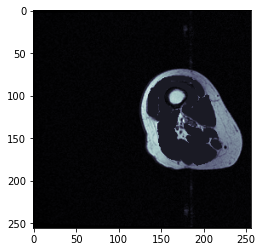

In [241]:
plt.imshow(snake_im[1],cmap='bone')

In [248]:
prefloodfill = np.empty((num_patients * InputImage.GetSize()[2], int(InputImage.GetSize()[0]/2), int(InputImage.GetSize()[1]), 1))
prefloodfill = npnormalization (snake_im)
prefloodfill = prefloodfill[:,:,:,0]


5/2010 Slices |0%|
Normalization Complete


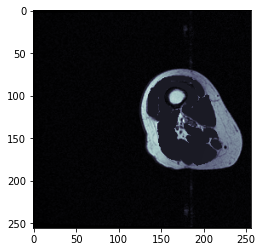

In [249]:
plt.imshow(prefloodfill[1],cmap='bone')

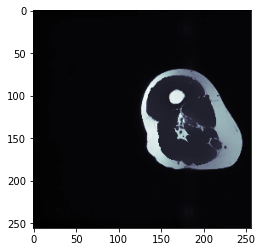

In [264]:

def bilat_fil_snake_im(image):
    bilateral_t=np.zeros([inputs.shape[0], inputs.shape[1], inputs.shape[2]], dtype='uint8')
    for i in range(5):
        bilateral_t[i] = cv2.bilateralFilter(image[i],20,35,35)
    return bilateral_t

bilateral_t=bilat_fil_snake_im(np.uint8(snake_im))
plt.imshow(bilateral_t[1],cmap='bone')

In [269]:
j=5

In [286]:
contoursvol=[]
hiercvol=[]
contour_listvol=[]
maskoutlinevol=[]

r=np.zeros([inputs.shape[0], inputs.shape[1], inputs.shape[2]], dtype='uint8')

OG_VOL2=cv2.convertTo(OG_VOL,OG_VOL2,CV_BGR2GRAY)
for i in range(j):
    contoursvol.append([])
    hiercvol.append([])
    contour_listvol.append([])
    maskoutlinevol.append([])
    
for i in range (j):
    a, b =  cv2.findContours(OG_VOL[i], cv2.RETR_TREE, cv2.CHAIN_APPROX_SIMPLE)
    contoursvol[i].append(a)
x    hiercvol[i].append(b)
    
    for contour in contoursvol[i][0]:      
        contour_listvol[i].append(contour)

    maskoutlinevol[i] = cv2.drawContours(r[i], contour_listvol[i],  -1, (1,0,0), 1)

AttributeError: module 'cv2.cv2' has no attribute 'convertTo'

In [343]:
# Find contours at a constant value of 0.8
contours = measure.find_contours(ROI_MSK[1,:,:],0)
plt.imshow(contours[90])
plt.show()

IndexError: list index out of range

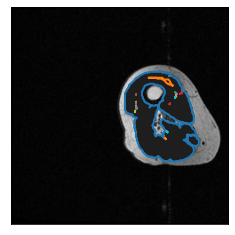

In [310]:
# Find contours at a constant value of 0.8
contours = measure.find_contours(ROI_MSK[1],0)
plt.imshow
# Display the image and plot all contours found
fig, ax = plt.subplots()
ax.imshow(inputs[1], cmap=plt.cm.gray)

for contour in contours:
    ax.plot(contour[:, 1], contour[:, 0], linewidth=2)

ax.axis('image')
ax.set_xticks([])
ax.set_yticks([])
plt.show()

In [346]:
inpus=np.zeros([inputs.shape[0], inputs.shape[1], inputs.shape[2]], dtype='object')
inpus=np.where(contours,1,0)

SystemError: <built-in function where> returned a result with an error set

In [344]:
contour_listvol=[]
maskoutlinevol=[]
contoursvol=[]
r=np.zeros([inputs.shape[0], inputs.shape[1], inputs.shape[2]], dtype='uint8')
for i in range(10):
    contoursvol.append([])
    contour_listvol.append([])
    maskoutlinevol.append([])
    
maskoutlinevol[1] = cv2.drawContours(r[1], contours[1],  -1, (1,0,0), 1)

error: OpenCV(4.5.1) /private/var/folders/nz/vv4_9tw56nv9k3tkvyszvwg80000gn/T/pip-req-build-39p1qqfs/opencv/modules/imgproc/src/drawing.cpp:2501: error: (-215:Assertion failed) npoints > 0 in function 'drawContours'


In [350]:
def fill_contours(arr):
    return np.maximum.accumulate(arr,1) & \
           np.maximum.accumulate(arr[:,::-1],1)[:,::-1]

fill_contours(OG_VOL[1])

TypeError: ufunc 'bitwise_and' not supported for the input types, and the inputs could not be safely coerced to any supported types according to the casting rule ''safe''

In [349]:
hull2vol=[]

for i in range(5):
    hull2vol.append([])
    for i2 in range(len(OG_VOL[i][0][0])):
        hull2vol[i].append(OG_VOL[i][0][0][i2][0])
        

    hull2vol[i]=np.array(hull2vol[i])
    hull2vol[i]=hull2vol[i].astype(float)

TypeError: object of type 'numpy.float64' has no len()

In [266]:
#primary
def primary_snake():

    snakevol_p=[]
    for i in range(5):
        snakevol_p.append([])
        snakevol_p[i]= active_contour(bilateral_t[i], hull2vol[i],alpha=0.0001,gamma=10,beta=0.05,w_edge=2,w_line=-5,convergence=0.5)
        
        #hull2vol[i] = coordinates for snake initiation 
        #alpha=snakes energy, tendency to move away from OG initiator (higher alpha=more freedom to move)-small here cus initiated snake close to fascia already 
        #beta= smoothness (higher beta = smoother) w_line = attraction the dark/white (- means attracted to DARK pixels, + to white pixels) w_edge - attraction to edges (higher=more attraction

    return snakevol_p #LIST of coordinates

snakevol_p=primary_snake()

fig, axs = plt.subplots(5, 3, figsize=(18,80))   
for i in range(5):
    axs[i,0].set_title(f"slice {i+1}", fontsize=14)
    axs[i,0].imshow(bilateral_t[i], cmap='bone')

    axs[i,1].imshow(bilateral_t[i], cmap='bone')
    axs[i,1].plot(hull2vol[i][:, 0], hull2vol[i][:, 1], '--r', lw=1)

    axs[i,2].imshow(bilateral_t[i], cmap='bone')
    axs[i,2].plot(snakevol_p[i][:, 0], snakevol_p[i][:, 1], '-b', lw=1)

NameError: name 'hull2vol' is not defined